# 기타 테스트

In [ ]:
model_path = './yolo11l-seg.pt'
model = YOLO(model_path)
print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")

YOLOv11-seg 모델 './yolo11l-seg.pt'을(를) 로드했습니다.


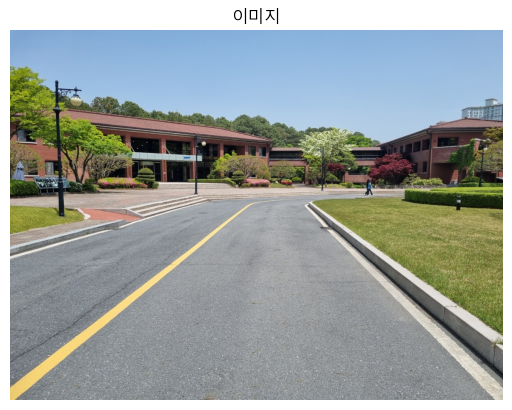

In [ ]:
# 2. 이미지 로드
img_path = './image/test_image_13.jpg'
img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# RGB로 변환 후 시각화
plt.imshow(img_rgb)
plt.title('이미지')
plt.axis('off')
plt.show()

In [ ]:
# 3. 추론
results = model(img_rgb)
res = results[0]
print(f"추론 결과: {res}")


0: 768x1024 5 cracks, 1065.0ms
Speed: 8.3ms preprocess, 1065.0ms inference, 14.4ms postprocess per image at shape (1, 3, 768, 1024)
추론 결과: ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: ultralytics.engine.results.Masks object
names: {0: 'crack', 1: 'pothole'}
obb: None
orig_img: array([[[128, 171, 214],
        [128, 171, 214],
        [126, 169, 212],
        ...,
        [143, 178, 218],
        [144, 179, 219],
        [143, 178, 218]],

       [[126, 169, 212],
        [128, 171, 214],
        [128, 171, 214],
        ...,
        [144, 179, 219],
        [145, 180, 220],
        [144, 179, 219]],

       [[127, 170, 213],
        [128, 171, 214],
        [128, 171, 214],
        ...,
        [139, 174, 214],
        [141, 176, 216],
        [142, 177, 217]],

       ...,

       [[233, 202, 111],
        [234, 203, 112],
        [227, 196, 105],
        ...,
        [207, 201, 185],
        [202, 1

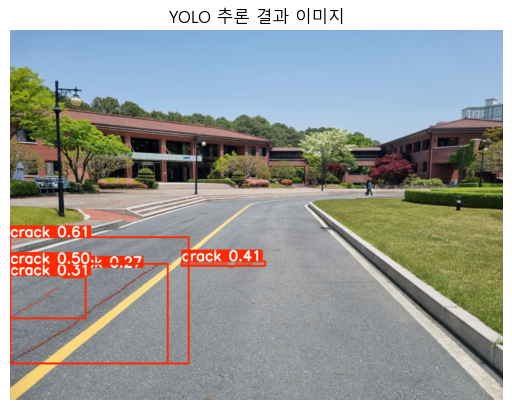

In [ ]:
res_plotted = res.plot()

plt.imshow(res_plotted)
plt.title('YOLO 추론 결과 이미지')
plt.axis('off')
plt.show()

In [ ]:
print(res.boxes)

ultralytics.engine.results.Boxes object with attributes:

cls: tensor([0., 0., 0., 0., 0.])
conf: tensor([0.6062, 0.4956, 0.4093, 0.3071, 0.2729])
data: tensor([[8.3042e-01, 5.9251e+02, 5.1103e+02, 9.5373e+02, 6.0615e-01, 0.0000e+00],
        [0.0000e+00, 6.6853e+02, 4.5142e+02, 9.5300e+02, 4.9559e-01, 0.0000e+00],
        [4.9104e+02, 6.6169e+02, 7.3099e+02, 6.7437e+02, 4.0935e-01, 0.0000e+00],
        [8.0831e-01, 7.0149e+02, 2.1609e+02, 8.2419e+02, 3.0709e-01, 0.0000e+00],
        [1.5099e+02, 6.7952e+02, 2.0953e+02, 7.0723e+02, 2.7291e-01, 0.0000e+00]])
id: None
is_track: False
orig_shape: (1058, 1411)
shape: torch.Size([5, 6])
xywh: tensor([[255.9308, 773.1195, 510.2009, 361.2161],
        [225.7078, 810.7660, 451.4155, 284.4709],
        [611.0179, 668.0295, 239.9485,  12.6740],
        [108.4471, 762.8412, 215.2777, 122.6986],
        [180.2593, 693.3718,  58.5475,  27.7125]])
xywhn: tensor([[0.1814, 0.7307, 0.3616, 0.3414],
        [0.1600, 0.7663, 0.3199, 0.2689],
        [0.4

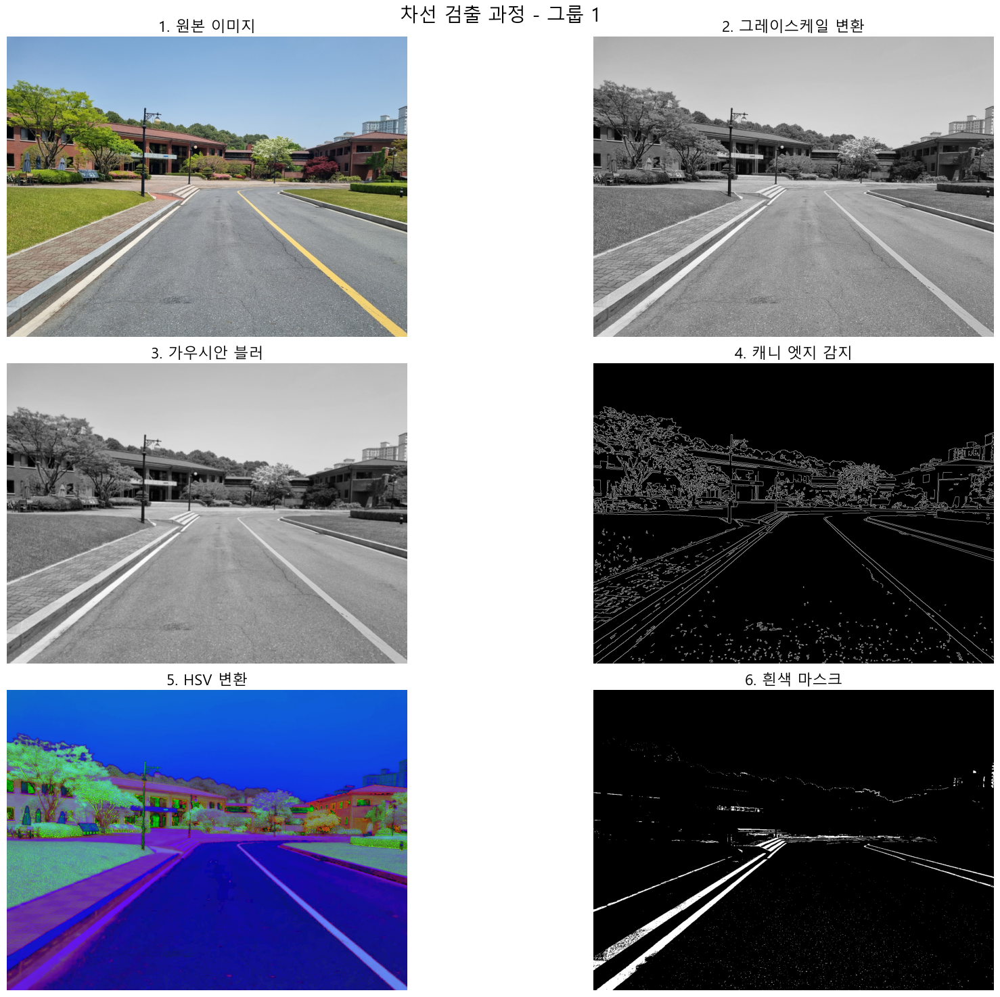

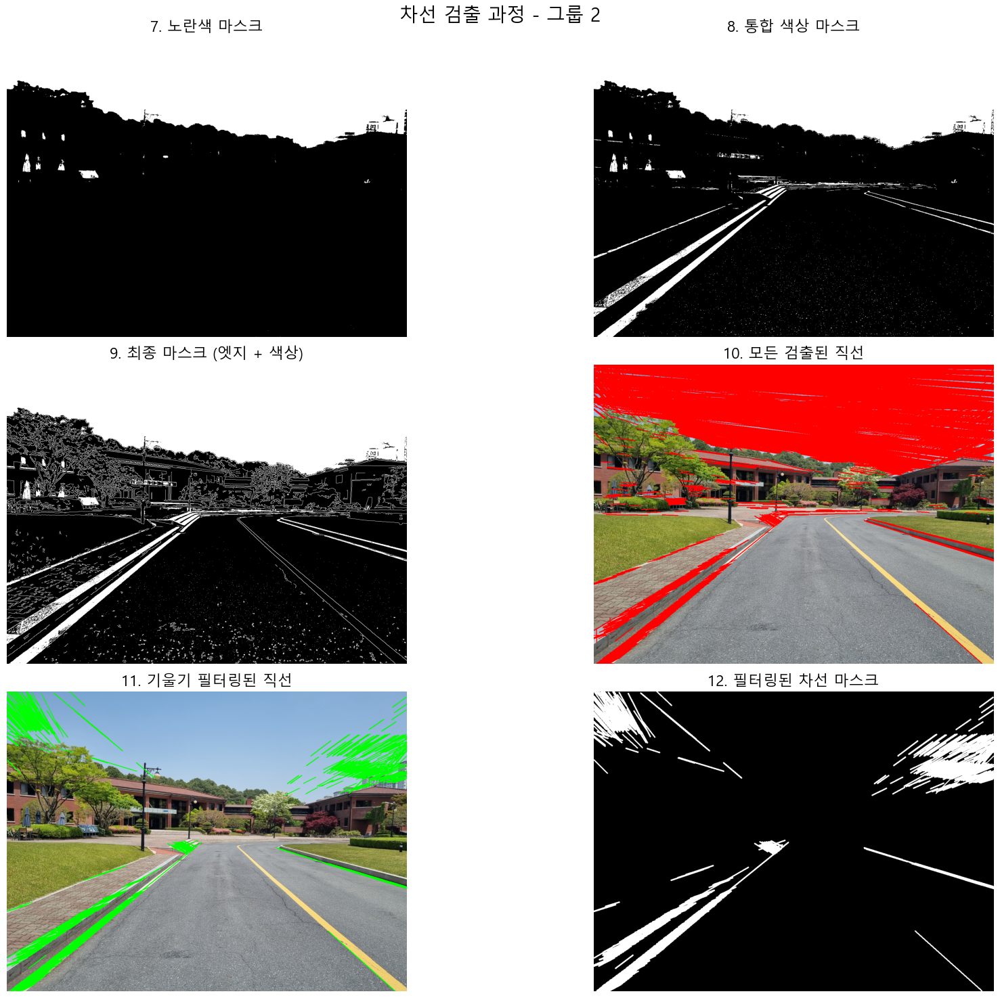

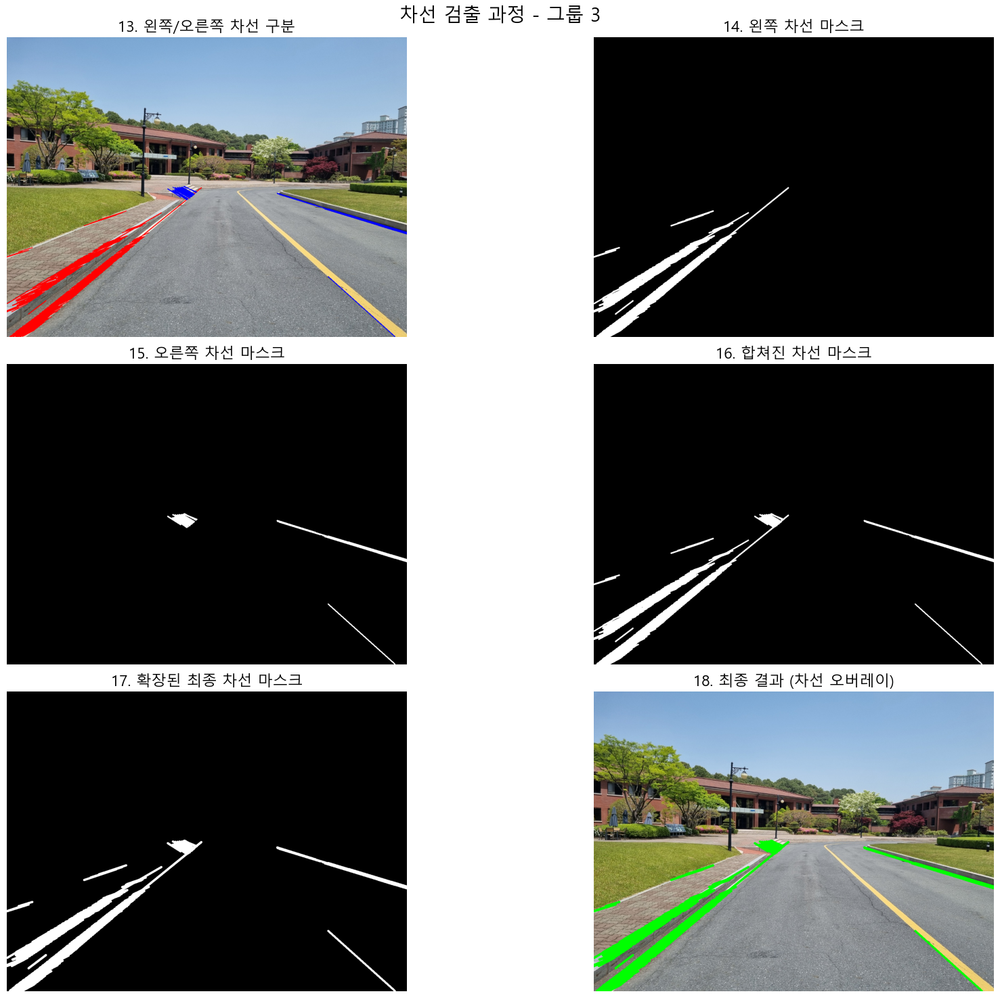

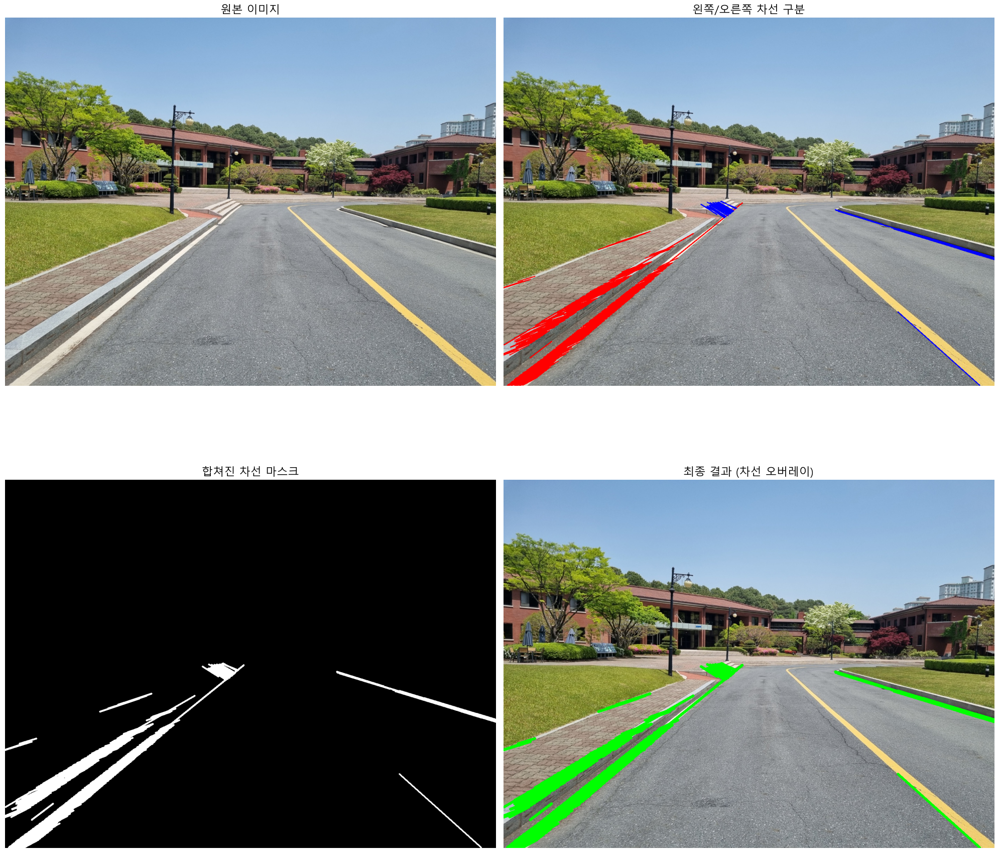

In [ ]:
# 2. 이미지 로드
img_path = './image/test_image_14.jpg'
img_bgr = cv2.imread(img_path)
img = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
img_height, img_width = img.shape[:2]

# 시각화 결과를 저장할 딕셔너리
viz_results = {}
viz_results['1. 원본 이미지'] = img.copy()

# 그레이스케일 변환
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
viz_results['2. 그레이스케일 변환'] = gray.copy()

# 가우시안 블러
blur = cv2.GaussianBlur(gray, (5, 5), 0)
viz_results['3. 가우시안 블러'] = blur.copy()

# 캐니 엣지 감지 - 더 엄격한 임계값 적용
edges = cv2.Canny(blur, 70, 150)
viz_results['4. 캐니 엣지 감지'] = edges.copy()

# 색상 기반 차선 추출 (흰색/노란색)
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
viz_results['5. HSV 변환'] = hsv.copy()

# 흰색 범위 - 더 엄격한 범위 설정
lower_white = np.array([0, 0, 200])
upper_white = np.array([180, 30, 255])
white_mask = cv2.inRange(hsv, lower_white, upper_white)
viz_results['6. 흰색 마스크'] = white_mask.copy()

# 노란색 범위 - 더 넓은 범위 설정
lower_yellow = np.array([10, 40, 60])
upper_yellow = np.array([40, 255, 255])
yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
viz_results['7. 노란색 마스크'] = yellow_mask.copy()

# 색상 마스크 통합
color_mask = cv2.bitwise_or(white_mask, yellow_mask)
viz_results['8. 통합 색상 마스크'] = color_mask.copy()

# 최종 마스크 (엣지 + 색상)
final_mask = cv2.bitwise_or(edges, color_mask)
viz_results['9. 최종 마스크 (엣지 + 색상)'] = final_mask.copy()

# 호프 변환으로 직선 검출 - 파라미터 조정
lines = cv2.HoughLinesP(
    final_mask, 
    rho=1, 
    theta=np.pi/180, 
    threshold=40,  # 임계값 증가
    minLineLength=40,  # 최소 선 길이 증가
    maxLineGap=5  # 최대 간격 감소
)

# 모든 직선 시각화
all_lines_img = img.copy()
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(all_lines_img, (x1, y1), (x2, y2), (255, 0, 0), 2)  # 모든 선을 파란색으로 표시
viz_results['10. 모든 검출된 직선'] = all_lines_img.copy()

# 차선 마스크 생성
lane_mask = np.zeros_like(gray)

# 기울기 기반 필터링을 추가하여 수직/수평선 제거
filtered_lines_img = img.copy()
if lines is not None:
    filtered_lines = []
    for line in lines:
        x1, y1, x2, y2 = line[0]
        
        # 선의 길이가 너무 짧으면 무시
        if np.sqrt((x2 - x1)**2 + (y2 - y1)**2) < 30:
            continue
            
        # 기울기 계산
        if x2 - x1 == 0:  # 수직선 방지
            slope = 999  # 큰 값으로 설정
        else:
            slope = (y2 - y1) / (x2 - x1)
        
        # 적절한 기울기 범위만 선택 (차선은 대개 특정 각도 범위 내에 있음)
        if 0.3 < abs(slope) < 2:  # 약 15도 ~ 65도 범위
            filtered_lines.append(line)
            cv2.line(lane_mask, (x1, y1), (x2, y2), 255, 3)  # 선 두께 감소
            cv2.line(filtered_lines_img, (x1, y1), (x2, y2), (0, 255, 0), 2)  # 필터링된 선을 녹색으로 표시

viz_results['11. 기울기 필터링된 직선'] = filtered_lines_img.copy()
viz_results['12. 필터링된 차선 마스크'] = lane_mask.copy()

# 차선 클러스터링 - 왼쪽/오른쪽 차선 구분
left_line_mask = np.zeros_like(gray)
right_line_mask = np.zeros_like(gray)
left_right_lines_img = img.copy()

if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        
        # 선의 길이가 너무 짧으면 무시
        if np.sqrt((x2 - x1)**2 + (y2 - y1)**2) < 30:
            continue
            
        # 기울기 계산
        if x2 - x1 == 0:  # 수직선 방지
            continue
        else:
            slope = (y2 - y1) / (x2 - x1)
        
        # 왼쪽/오른쪽 차선 구분
        if abs(slope) < 0.3 or abs(slope) > 2:  # 너무 평평하거나 수직인 선 제외
            continue
            
        # 중앙선 기준으로 왼쪽/오른쪽 구분
        mid_x = width // 2
        line_mid_x = (x1 + x2) // 2
        
        if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
            cv2.line(left_line_mask, (x1, y1), (x2, y2), 255, 3)
            cv2.line(left_right_lines_img, (x1, y1), (x2, y2), (255, 0, 0), 2)  # 왼쪽 차선을 빨간색으로 표시
        elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
            cv2.line(right_line_mask, (x1, y1), (x2, y2), 255, 3)
            cv2.line(left_right_lines_img, (x1, y1), (x2, y2), (0, 0, 255), 2)  # 오른쪽 차선을 파란색으로 표시

viz_results['13. 왼쪽/오른쪽 차선 구분'] = left_right_lines_img.copy()
viz_results['14. 왼쪽 차선 마스크'] = left_line_mask.copy()
viz_results['15. 오른쪽 차선 마스크'] = right_line_mask.copy()

# 왼쪽/오른쪽 차선 합치기
combined_lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
viz_results['16. 합쳐진 차선 마스크'] = combined_lane_mask.copy()

# 차선 마스크 최소한의 확장만 수행
kernel = np.ones((3, 3), np.uint8)
dilated_lane_mask = cv2.dilate(combined_lane_mask, kernel, iterations=1)
viz_results['17. 확장된 최종 차선 마스크'] = dilated_lane_mask.copy()

# 원본 이미지에 최종 차선 마스크 오버레이
final_overlay = img.copy()
final_overlay[dilated_lane_mask == 255] = [0, 255, 0]  # 차선을 녹색으로 표시
viz_results['18. 최종 결과 (차선 오버레이)'] = final_overlay.copy()

# 시각화를 위해 이미지 세트를 그룹으로 나누기
# 각 그룹을 별도의 큰 플롯으로 표시
# 총 18개 이미지를 3개의 그룹으로 나누면 각 그룹에 6개 이미지

groups = [
    ['1. 원본 이미지', '2. 그레이스케일 변환', '3. 가우시안 블러', '4. 캐니 엣지 감지', '5. HSV 변환', '6. 흰색 마스크'],
    ['7. 노란색 마스크', '8. 통합 색상 마스크', '9. 최종 마스크 (엣지 + 색상)', '10. 모든 검출된 직선', '11. 기울기 필터링된 직선', '12. 필터링된 차선 마스크'],
    ['13. 왼쪽/오른쪽 차선 구분', '14. 왼쪽 차선 마스크', '15. 오른쪽 차선 마스크', '16. 합쳐진 차선 마스크', '17. 확장된 최종 차선 마스크', '18. 최종 결과 (차선 오버레이)']
]

# 각 그룹을 큰 이미지로 시각화
for group_idx, group in enumerate(groups):
    plt.figure(figsize=(20, 15))  # 매우 큰 크기의 그림
    
    for i, img_title in enumerate(group):
        # 2열 레이아웃
        plt.subplot(3, 2, i+1)
        
        img_viz = viz_results[img_title]
        if len(img_viz.shape) == 3:  # 컬러 이미지
            plt.imshow(img_viz)
        else:  # 그레이스케일 이미지 또는 마스크
            plt.imshow(img_viz, cmap='gray')
            
        plt.title(img_title, fontsize=16)
        plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle(f"차선 검출 과정 - 그룹 {group_idx+1}", fontsize=20)
    plt.subplots_adjust(top=0.95)
    plt.show()

# 주요 결과만 따로 큰 이미지로 비교
plt.figure(figsize=(20, 20))

plt.subplot(2, 2, 1)
plt.imshow(viz_results['1. 원본 이미지'])
plt.title('원본 이미지', fontsize=16)
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(viz_results['13. 왼쪽/오른쪽 차선 구분'])
plt.title('왼쪽/오른쪽 차선 구분', fontsize=16)
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(viz_results['16. 합쳐진 차선 마스크'], cmap='gray')
plt.title('합쳐진 차선 마스크', fontsize=16)
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(viz_results['18. 최종 결과 (차선 오버레이)'])
plt.title('최종 결과 (차선 오버레이)', fontsize=16)
plt.axis('off')

plt.tight_layout()
plt.show()

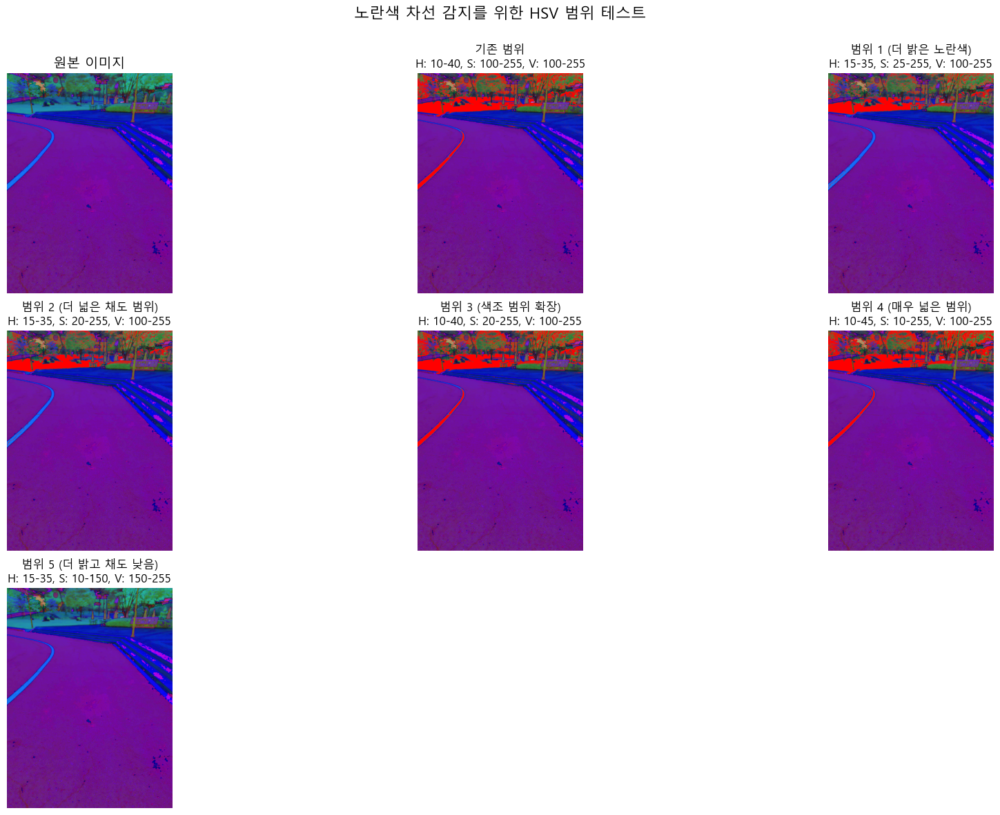

In [ ]:
# 2. 이미지 로드
img_path = './image/test_image_07.jpg'  # 이미지 경로 확인
img_bgr = cv2.imread(img_path)
img = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)
img_height, img_width = img.shape[:2]

# HSV로 변환
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# 다양한 노란색 범위 테스트
yellow_ranges = [
    {"name": "기존 범위", "lower": np.array([10, 100, 100]), "upper": np.array([40, 255, 255])},
    {"name": "범위 1 (더 밝은 노란색)", "lower": np.array([15, 25, 100]), "upper": np.array([35, 255, 255])},
    {"name": "범위 2 (더 넓은 채도 범위)", "lower": np.array([15, 20, 100]), "upper": np.array([35, 255, 255])},
    {"name": "범위 3 (색조 범위 확장)", "lower": np.array([10, 20, 100]), "upper": np.array([40, 255, 255])},
    {"name": "범위 4 (매우 넓은 범위)", "lower": np.array([10, 10, 100]), "upper": np.array([45, 255, 255])},
    {"name": "범위 5 (더 밝고 채도 낮음)", "lower": np.array([15, 10, 150]), "upper": np.array([35, 150, 255])}
]

# 결과 시각화
plt.figure(figsize=(18, 12))

# 원본 이미지
plt.subplot(3, 3, 1)
plt.imshow(img)
plt.title("원본 이미지", fontsize=14)
plt.axis('off')

# 각 범위별 마스크 및 결과 시각화
for i, range_info in enumerate(yellow_ranges):
    yellow_mask = cv2.inRange(hsv, range_info["lower"], range_info["upper"])
    
    # 마스크 시각화
    plt.subplot(3, 3, i+2)
    
    # 원본 이미지에 마스크 오버레이
    overlay = img.copy()
    overlay[yellow_mask > 0] = [255, 0, 0]
    
    plt.imshow(overlay)
    plt.title(f"{range_info['name']}\nH: {range_info['lower'][0]}-{range_info['upper'][0]}, " +
              f"S: {range_info['lower'][1]}-{range_info['upper'][1]}, " +
              f"V: {range_info['lower'][2]}-{range_info['upper'][2]}", 
              fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.suptitle("노란색 차선 감지를 위한 HSV 범위 테스트", fontsize=16)
plt.subplots_adjust(top=0.9)
plt.show()

# 라이브러리 불러오기

In [ ]:
"""
필요한 라이브러리 및 모듈 가져오기

1. OpenCV (cv2): 이미지 처리 및 컴퓨터 비전 기능 제공
  - 이미지 읽기/쓰기, 필터링, 색상 변환, 모양 감지, 윤곽선 추출 등
2. PyTorch (torch): 딥러닝 프레임워크
  - 텐서 연산, 신경망 모델 구축 및 학습, GPU 가속 등
3. NumPy (np): 과학적 컴퓨팅을 위한 수치 연산 라이브러리
  - 다차원 배열, 벡터화 연산, 수학 함수 등
4. OS (os): 운영체제와 상호작용하는 기능 제공
  - 파일 및 디렉토리 조작, 경로 처리, 환경 변수 접근 등
5. Matplotlib (pyplot): 데이터 시각화 라이브러리
  - 그래프, 차트, 이미지 시각화, 다중 패널 그림 등
6. PIL (Image, ImageDraw, ImageFont): Python 이미지 처리 라이브러리
  - 이미지 생성, 편집, 텍스트 추가, 이미지 형식 변환 등
  - 특히 한글 텍스트를 이미지에 추가하는 데 사용
7. Ultralytics YOLO: 객체 검출 및 세그멘테이션 모델
  - YOLOv11-seg 모델 로드 및 추론에 사용
8. Matplotlib 폰트 관리자 (fm): 폰트 관리 기능 제공
  - 한글 폰트 설정을 위한 폰트 속성 및 경로 관리
9. Platform: 현재 시스템 환경 정보 제공
  - 운영체제 판별(Windows, macOS, Linux 등)하여 적절한 폰트 경로 설정
"""

import cv2
import torch
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO

# matplotlib 한글 폰트 설정
import matplotlib.font_manager as fm
import platform

# 운영체제별 matplotlib 한글 기본 폰트 설정 함수

In [ ]:
def setup_matplotlib_font():
    """
    운영체제별 matplotlib 한글 기본 폰트 설정 함수
    
    1. 운영체제 감지 : platform.system()을 사용하여 현재 운영체제 확인
    2. 운영체제별 폰트 경로 설정 : 
        - Windows: 맑은 고딕(malgun.ttf)
        - macOS: Apple SD Gothic Neo
        - Linux: 나눔고딕(Ubuntu 기준)
    3. 폰트 로드 시도 : 지정된 경로에서 폰트를 로드하고 matplotlib 기본 폰트로 설정
    4. 예외 처리 : 폰트 로드 실패 시 기본 폰트(NanumGothic)를 대체 폰트로 시도
    5. 마이너스 기호 깨짐 방지 : axes.unicode_minus 옵션을 False로 설정하여 
        그래프에서 음수 표시 시 유니코드 마이너스 기호의 깨짐 방지
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

# 한글 텍스트를 이미지에 표시하는 함수

In [ ]:
def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    한글 텍스트를 이미지에 표시하는 함수
    
    1. PIL 이미지 변환 : OpenCV 이미지(NumPy 배열)를 PIL 이미지 객체로 변환
    2. 그리기 객체 생성 : PIL의 ImageDraw.Draw를 사용하여 이미지에 그리기 위한 객체 생성
    3. 운영체제 감지 : platform.system()으로 현재 운영체제 확인
    4. 운영체제별 폰트 설정 : 
        - Windows: 맑은 고딕(malgun.ttf)
        - macOS: Apple SD Gothic Neo
        - Linux: 나눔고딕(Ubuntu 기준)
    5. 폰트 로드 시도 : 지정된 경로에서 폰트를 로드하고 크기 설정(font_size * 20)
    6. 예외 처리 : 폰트 로드 실패 시 PIL 기본 폰트 사용
    7. 텍스트 그리기 : 지정된 위치에 설정된 폰트와 색상으로 텍스트 그리기(색상은 BGR->RGB 변환)
    8. NumPy 배열 변환 : 처리된 PIL 이미지를 다시 NumPy 배열로 변환하여 OpenCV 호환성 유지
    
    Parameters:
        - img : OpenCV 이미지(NumPy 배열)
        - text : 그릴 텍스트(한글 지원)
        - position : 텍스트 위치 좌표 (x, y)
        - font_size : 폰트 크기 배율(기본값: 1)
        - color : 텍스트 색상(BGR 형식, 기본값: 빨간색)
        - thickness : 사용되지 않음(OpenCV 호환성을 위한 파라미터)
        
    Returns:
        - 텍스트가 추가된 OpenCV 이미지(NumPy 배열)
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

# 도로 영역 추출 함수

In [ ]:
def extract_road_mask(img):
    """
    도로 영역 추출 함수
    
    1. 가우시안 블러: 노이즈 제거를 통해 이미지의 세부 잡음을 감소시키고 필터링 효과 향상
    2. HSV 변환: 색상(H), 채도(S), 명도(V)로 분리하여 색상 기반 필터링에 적합한 색상 공간으로 변환
    3. 도로 색상 범위 마스크 생성: 회색, 어두운 아스팔트, 밝은 콘크리트 등 다양한 도로 색상 범위를 포괄하는 마스크 생성
    4. 마스크 결합: 여러 색상 범위의 마스크를 논리합(OR)으로 결합하여 다양한 도로 유형 포함
    5. 열기 연산 적용: 작은 노이즈 제거를 위해 침식 후 팽창 연산을 수행하여 작은 불필요한 영역 제거
    6. 닫기 연산 적용: 도로 영역 내부의 작은 구멍을 메우기 위해 팽창 후 침식 연산 수행
    7. 큰 커널 닫기 연산: 더 넓은 영역에 닫기 연산을 적용하여 도로 틈새와 불연속 부분 메우기
    8. 연결 요소 분석: 마스크에서 연결된 영역(객체)을 찾고 면적 기준으로 정렬
    9. 유의미한 크기 선택: 전체 이미지의 5% 이상 크기를 가진 상위 연결 요소만 선택하여 세부 필터링
    10. 홍수 채우기: 이미지 하단 중앙(도로일 가능성이 높은 지점)에서 시작하여 연결된 영역 채우기
    11. 결과 결합: 면적 기반으로 선택된 영역과 홍수 채우기 결과를 결합하여 최종 도로 마스크 생성
    
    Parameters:
        - img (numpy.ndarray): 도로 영역을 추출할 BGR 형식의 입력 이미지
    
    Returns:
        - numpy.ndarray: 도로 영역을 나타내는 이진 마스크 이미지(255: 도로 영역, 0: 비도로 영역
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색, 어두운 회색, 밝은 회색 포함)
    # 넓은 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 60])
    upper_gray_road = np.array([180, 50, 200])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 30])
    upper_dark_road = np.array([180, 30, 120])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 130])
    upper_light_road = np.array([180, 40, 255])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

SyntaxError: incomplete input (1269285405.py, line 2)

# 차선 감지 및 마스크 생성 함수

In [ ]:
def detect_lane_lines(img):
    """
    차선 감지 및 마스크 생성 함수

    1. 그레이스케일 변환: 이미지를 흑백으로 변환하여 색상 복잡성 감소 및 처리 속도 향상
    2. 가우시안 블러: 노이즈 제거를 통해 엣지 검출의 정확도 향상
    3. 캐니 엣지 검출: 이미지의 모든 엣지(가장자리)를 검출하여 차선 후보 식별
    4. ROI(관심 영역) 설정: 도로 영역에서 상단 25% 영역 제외(주석 처리됨)하여 불필요한 영역 제거
    5. 색상 기반 차선 추출: HSV 색상 공간에서 흰색과 노란색(일반적인 차선 색상) 범위만 필터링
    6. 마스크 통합: 엣지 기반 마스크와 색상 기반 마스크를 결합하여 차선 후보 강화
    7. 호프 변환 적용: 직선 성분 검출 알고리즘을 사용하여 마스크에서 직선 성분 추출
    8. 차선 필터링: 선분 길이, 기울기 등의 조건을 적용하여 유효한 차선 후보만 선택
    9. 차선 분류: 기울기와 위치에 따라 왼쪽(음수 기울기) 및 오른쪽(양수 기울기) 차선으로 분류
    10. 차선 연장: 검출된 차선을 화면 상단과 하단까지 연장하여, 부분적으로 보이는 차선을 완전한 형태로 복원
    11. 범위 검증: 연장된 차선이 이미지 경계를 벗어나지 않도록 범위 검증 및 조정
    12. 최종 마스크 생성: 왼쪽과 오른쪽 차선 마스크를 통합하고 확장하여 최종 차선 마스크 반환

    Parameters:
        - img (numpy.ndarray): 차선을 검출할 BGR 형식의 입력 이미지

    Returns:
    tuple: 
        - lane_mask (numpy.ndarray): 전체 차선 마스크
        - left_line_mask (numpy.ndarray): 왼쪽 차선 마스크
        - right_line_mask (numpy.ndarray): 오른쪽 차선 마스크
        - edges (numpy.ndarray): 원본 캐니 엣지 검출 결과
        - masked_edges (numpy.ndarray): ROI 적용된 캐니 엣지 검출 결과
    """
    # 그레이스케일 변환
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # 가우시안 블러 및 엣지 감지
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정 - 상단 25%를 제외한 영역만 고려
    height, width = edges.shape
    roi_mask = np.ones_like(edges)
    # roi_mask[:int(height * 0.25), :] = 0
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    color_mask = cv2.bitwise_and(color_mask, color_mask, mask=roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_lines = []
    right_lines = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                cv2.line(lane_mask, (x1, y1), (x2, y2), 255, 3)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    cv2.line(left_line_mask, (x1, y1), (x2, y2), 255, 3)
                    left_lines.append((x1, y1, x2, y2, slope, line_length))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    cv2.line(right_line_mask, (x1, y1), (x2, y2), 255, 3)
                    right_lines.append((x1, y1, x2, y2, slope, line_length))
    
    # 확장된 차선 마스크 생성
    extended_left_mask = np.zeros_like(gray)
    extended_right_mask = np.zeros_like(gray)
    
    # 왼쪽 차선 처리 - 가장 긴 선분 선택
    if left_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_left = sorted(left_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_left
        
        # 차선 연장을 위한 직선 방정식 계산
        # y = m*x + b, b = y - m*x
        b = y1 - slope * x1
        
        # 화면 하단에서의 x 좌표 계산
        bottom_y = height
        bottom_x = int((bottom_y - b) / slope)
        
        # 화면 상단(또는 ROI 상단)에서의 x 좌표 계산
        top_y = 0  # 화면 상단
        top_x = int((top_y - b) / slope)
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 왼쪽 차선 그리기
        cv2.line(extended_left_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
    
    # 오른쪽 차선 처리 - 가장 긴 선분 선택
    if right_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_right = sorted(right_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_right
        
        # 차선 연장을 위한 직선 방정식 계산
        b = y1 - slope * x1
        
        # 화면 하단에서의 x 좌표 계산
        bottom_y = height
        bottom_x = int((bottom_y - b) / slope)
        
        # 화면 상단(또는 ROI 상단)에서의 x 좌표 계산
        top_y = 0  # 화면 상단
        top_x = int((top_y - b) / slope)
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 오른쪽 차선 그리기
        cv2.line(extended_right_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
    
    # 왼쪽/오른쪽 차선 마스크 각각 업데이트
    left_line_mask = cv2.bitwise_or(left_line_mask, extended_left_mask)
    right_line_mask = cv2.bitwise_or(right_line_mask, extended_right_mask)
    
    # 전체 차선 마스크 통합
    lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    lane_mask = cv2.dilate(lane_mask, kernel, iterations=1)
    
    return lane_mask, left_line_mask, right_line_mask, edges, masked_edges

## RANSAC 알고리즘 적용

In [ ]:
import cv2
import numpy as np
from sklearn.linear_model import LinearRegression, RANSACRegressor

def detect_lane_lines(img):
    """
    차선 감지 및 마스크 생성 함수

    1. 그레이스케일 변환: 이미지를 흑백으로 변환하여 색상 복잡성 감소 및 처리 속도 향상
    2. 가우시안 블러: 노이즈 제거를 통해 엣지 검출의 정확도 향상
    3. 캐니 엣지 검출: 이미지의 모든 엣지(가장자리)를 검출하여 차선 후보 식별
    4. ROI(관심 영역) 설정: 도로 영역에서 상단 25% 영역 제외(주석 처리됨)하여 불필요한 영역 제거
    5. 색상 기반 차선 추출: HSV 색상 공간에서 흰색과 노란색(일반적인 차선 색상) 범위만 필터링
    6. 마스크 통합: 엣지 기반 마스크와 색상 기반 마스크를 결합하여 차선 후보 강화
    7. 호프 변환 적용: 직선 성분 검출 알고리즘을 사용하여 마스크에서 직선 성분 추출
    8. RANSAC 원리 적용: 길이, 기울기 등의 조건을 사용해 이상치(outlier) 제거 및 최적 차선 모델 선택
        - 최소 길이 필터링으로 노이즈 제거
        - 적절한 기울기 범위 선택(0.3~2.0)으로 유효한 차선만 유지
        - 각 차선별로 가장 긴 선분 선택하여 대표 모델로 사용
    9. 차선 분류: 기울기와 위치에 따라 왼쪽(음수 기울기) 및 오른쪽(양수 기울기) 차선으로 분류
    10. 차선 모델 생성 및 연장: 선형 모델(직선 방정식)을 통해 차선을 화면 경계까지 연장
    11. 범위 검증: 연장된 차선이 이미지 경계를 벗어나지 않도록 범위 검증 및 조정
    12. 최종 마스크 생성: 왼쪽과 오른쪽 차선 마스크를 통합하고 확장하여 최종 차선 마스크 반환

    Parameters:
        - img (numpy.ndarray): 차선을 검출할 BGR 형식의 입력 이미지

    Returns:
        tuple: 
            - lane_mask (numpy.ndarray): 전체 차선 마스크
            - left_line_mask (numpy.ndarray): 왼쪽 차선 마스크
            - right_line_mask (numpy.ndarray): 오른쪽 차선 마스크
            - edges (numpy.ndarray): 원본 캐니 엣지 검출 결과
            - masked_edges (numpy.ndarray): ROI 적용된 캐니 엣지 검출 결과
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    roi_mask = np.ones_like(edges)
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    color_mask = cv2.bitwise_and(color_mask, color_mask, mask=roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_points = []
    right_points = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                # 각 선분의 두 점을 모두 저장 (RANSAC에 사용)
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    left_points.append((x1, y1))
                    left_points.append((x2, y2))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    right_points.append((x1, y1))
                    right_points.append((x2, y2))
    
    # 확장된 차선 마스크 생성
    extended_left_mask = np.zeros_like(gray)
    extended_right_mask = np.zeros_like(gray)
    
    # RANSAC 알고리즘 적용하여 차선 모델 추정
    # 왼쪽 차선 RANSAC 적용
    if len(left_points) >= 5:  # RANSAC을 적용하기 위한 최소 포인트 수
        left_points = np.array(left_points)
        left_x = left_points[:, 0]
        left_y = left_points[:, 1]
        
        # RANSAC 파라미터 설정
        ransac = RANSACRegressor(
            estimator=LinearRegression(),
            min_samples=5,           # 모델 추정에 사용할 최소 샘플 수
            max_trials=100,          # RANSAC 최대 반복 횟수
            residual_threshold=10.0, # 이상치 판별 임계값
            random_state=42
        )
        
        # 모델 피팅 (y=f(x)가 아닌 x=f(y)로 피팅하여 수직에 가까운 선도 처리)
        try:
            ransac.fit(left_y.reshape(-1, 1), left_x)
            
            # 모델의 신뢰도 확인
            inlier_mask = ransac.inlier_mask_
            if np.sum(inlier_mask) > 5:  # 최소 5개 이상의 인라이어가 있어야 함
                # 차선 연장을 위한 직선 방정식 계산
                # x = m*y + b
                left_slope = ransac.estimator_.coef_[0]
                left_intercept = ransac.estimator_.intercept_
                
                # 화면 하단과 상단에서의 x 좌표 계산
                bottom_y = height
                bottom_x = int(left_slope * bottom_y + left_intercept)
                
                top_y = 0
                top_x = int(left_slope * top_y + left_intercept)
                
                # x 좌표가 화면 범위를 벗어나는지 확인
                if top_x < 0:
                    # x가 0일 때의 y 계산 (역으로 계산)
                    top_y = int((0 - left_intercept) / left_slope)
                    top_x = 0
                elif top_x >= width:
                    top_y = int(((width-1) - left_intercept) / left_slope)
                    top_x = width - 1
                    
                if bottom_x < 0:
                    bottom_y = int((0 - left_intercept) / left_slope)
                    bottom_x = 0
                elif bottom_x >= width:
                    bottom_y = int(((width-1) - left_intercept) / left_slope)
                    bottom_x = width - 1
                
                # 연장된 왼쪽 차선 그리기
                cv2.line(extended_left_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
                
                # 인라이어 포인트 시각화 (선택 사항)
                for i in range(len(left_points)):
                    if inlier_mask[i]:
                        cv2.circle(left_line_mask, (left_x[i], left_y[i]), 3, 127, -1)
        except:
            # RANSAC 피팅 실패 시 기존 방식으로 대체
            pass
    
    # 오른쪽 차선 RANSAC 적용
    if len(right_points) >= 5:
        right_points = np.array(right_points)
        right_x = right_points[:, 0]
        right_y = right_points[:, 1]
        
        # RANSAC 파라미터 설정
        ransac = RANSACRegressor(
            estimator=LinearRegression(),
            min_samples=5,
            max_trials=100,
            residual_threshold=10.0,
            random_state=42
        )
        
        # 모델 피팅
        try:
            ransac.fit(right_y.reshape(-1, 1), right_x)
            
            # 모델의 신뢰도 확인
            inlier_mask = ransac.inlier_mask_
            if np.sum(inlier_mask) > 5:  # 최소 5개 이상의 인라이어가 있어야 함
                # 차선 연장을 위한 직선 방정식 계산
                right_slope = ransac.estimator_.coef_[0]
                right_intercept = ransac.estimator_.intercept_
                
                # 화면 하단과 상단에서의 x 좌표 계산
                bottom_y = height
                bottom_x = int(right_slope * bottom_y + right_intercept)
                
                top_y = 0
                top_x = int(right_slope * top_y + right_intercept)
                
                # x 좌표가 화면 범위를 벗어나는지 확인
                if top_x < 0:
                    top_y = int((0 - right_intercept) / right_slope)
                    top_x = 0
                elif top_x >= width:
                    top_y = int(((width-1) - right_intercept) / right_slope)
                    top_x = width - 1
                    
                if bottom_x < 0:
                    bottom_y = int((0 - right_intercept) / right_slope)
                    bottom_x = 0
                elif bottom_x >= width:
                    bottom_y = int(((width-1) - right_intercept) / right_slope)
                    bottom_x = width - 1
                
                # 연장된 오른쪽 차선 그리기
                cv2.line(extended_right_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
                
                # 인라이어 포인트 시각화 (선택 사항)
                for i in range(len(right_points)):
                    if inlier_mask[i]:
                        cv2.circle(right_line_mask, (right_x[i], right_y[i]), 3, 127, -1)
        except:
            # RANSAC 피팅 실패 시 기존 방식으로 대체
            pass
    
    # 왼쪽/오른쪽 차선 마스크 각각 업데이트
    left_line_mask = cv2.bitwise_or(left_line_mask, extended_left_mask)
    right_line_mask = cv2.bitwise_or(right_line_mask, extended_right_mask)
    
    # 전체 차선 마스크 통합
    lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    lane_mask = cv2.dilate(lane_mask, kernel, iterations=1)
    
    return lane_mask, left_line_mask, right_line_mask, edges, masked_edges

# 차선 내부의 도로 영역 추출 함수

In [ ]:
def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역 추출 함수

    1. 차선 윤곽선 찾기: 왼쪽과 오른쪽 차선 마스크에서 각각 윤곽선 검출
    2. 차선 확인: 충분한 차선이 감지되지 않을 경우 기본 도로 마스크 반환
    3. 대표 윤곽선 선택: 각 차선에서 면적이 가장 큰 윤곽선을 대표 차선으로 선택
    4. 윤곽선 포인트 추출: 선택된 윤곽선에서 모든 점의 좌표 추출
    5. 주요 경계점 찾기: 각 차선에서 가장 상단(y좌표 최소)과 하단(y좌표 최대) 지점 추출
    6. 신뢰성 검증: 차선의 길이가 충분하지 않은 경우(50픽셀 미만) 대체 포인트로 보정
    7. 하단 경계 좌표 추가: 이미지 하단 좌/우 모서리 좌표를 추가하여 폴리곤 완성
    8. 도로 폴리곤 생성: 검출된 좌표를 사용하여 차선 내부와 차선 아래 영역을 포함하는 폴리곤 정의
    9. 폴리곤 마스크 생성: 정의된 폴리곤으로 빈 마스크에 영역 채우기
    10. 최종 마스크 생성: 생성된 폴리곤 마스크와 원래 도로 마스크의 교집합으로 차선 내부 도로 영역 추출

    Parameters:
        - img (numpy.ndarray): 원본 이미지
        - road_mask (numpy.ndarray): 도로 영역 마스크
        - left_lane_mask (numpy.ndarray): 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray): 오른쪽 차선 마스크

    Returns:
    tuple:
        - final_road_mask (numpy.ndarray): 차선 내부의 도로 영역 마스크
        - road_polygon (numpy.ndarray): 도로 영역을 정의하는 폴리곤 좌표
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

# 원근 변환을 위한 기본 포인트 설정 함수

In [ ]:
def get_default_perspective_points(road_polygon, height, width):
    """
    원근 변환을 위한 기본 포인트 설정 함수

    1. 입력 검증: road_polygon이 유효한 경우(None이 아니고 충분한 포인트 보유) 사용
    2. 폴리곤 포인트 추출: road_polygon에서 원근 변환에 필요한 주요 4개 포인트 추출
        - 왼쪽 차선 하단: road_polygon[1]
        - 오른쪽 차선 하단: road_polygon[4]
        - 왼쪽 차선 상단: road_polygon[2]
        - 오른쪽 차선 상단: road_polygon[3]
    3. 기본값 설정: 유효한 road_polygon이 없는 경우 이미지 크기에 기반한 기본 포인트 사용
        - 좌하단: 이미지 좌하단 모서리 (0, height-1)
        - 우하단: 이미지 우하단 모서리 (width-1, height-1)
        - 좌상단: 이미지 좌측 1/4 지점, 높이 1/3 지점 (width/4, height/3)
        - 우상단: 이미지 우측 3/4 지점, 높이 1/3 지점 (width*3/4, height/3)
    4. 반환: 원근 변환에 사용할 4개의 포인트를 float32 형식으로 변환하여 반환

    Parameters:
        - road_polygon (numpy.ndarray or None): 도로 영역을 정의하는 폴리곤 좌표
        - height (int): 이미지 높이
        - width (int): 이미지 너비

    Returns:
        - numpy.ndarray: 원근 변환에 사용할 소스 포인트 좌표(4개 점의 좌표, float32 형식)
    """
    if road_polygon is not None and len(road_polygon) >= 6:
        # road_polygon에서 필요한 포인트 추출
        left_bottom = road_polygon[1]  # 왼쪽 차선 하단
        right_bottom = road_polygon[4] # 오른쪽 차선 하단
        left_top = road_polygon[2]     # 왼쪽 차선 상단
        right_top = road_polygon[3]    # 오른쪽 차선 상단
        
        # 사용할 코너 포인트
        return np.float32([left_bottom, right_bottom, left_top, right_top])
    else:
        # 기본값 설정
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
        
        return np.float32([bottom_left, bottom_right, top_left, top_right])

# 코너 검출이 실패했을 때 사용하는 대체 원근 변환 함수

In [ ]:
def fallback_perspective_transform(img, mask, road_polygon=None):
    """
    코너 검출이 실패했을 때 사용하는 대체 원근 변환 함수

    1. 윤곽선 검출: 도로 마스크에서 외부 윤곽선 찾기
    2. 윤곽선 선택: 가장 큰 면적을 가진 윤곽선을 대표 윤곽선으로 선택
    3. 하단 포인트 검출: 
        - 좌하단: x값이 가장 작고 y값이 가장 큰 포인트 선택
        - 우하단: x값이 가장 크고 y값이 가장 큰 포인트 선택
    4. 상단 포인트 추출: y좌표가 하위 10% 이내인 포인트들을 상단 후보로 선택
    5. 상단 포인트 검출(기본): 
        - 좌상단: 상단 후보 중 x값이 가장 작은 포인트
        - 우상단: 상단 후보 중 x값이 가장 큰 포인트
    6. 상단 포인트 대체 로직: 
        - 상단 후보가 부족한 경우 y값 기준 정렬 후 상위 10%(또는 최소 5개) 포인트 중에서 선택
        - 이 중 x좌표 최소/최대 값을 각각 좌/우 상단으로 선택
    7. 기본 포인트 사용: 윤곽선이 없거나 포인트가 부족한 경우 기본 포인트 설정 함수 호출
    8. 타겟 포인트 설정: 변환 후 이미지에서의 위치 좌표 설정
        - 좌하단: (0, height-1)
        - 우하단: (width-1, height-1)
        - 좌상단: (0, 0)
        - 우상단: (width-1, 0)
    9. 원근 변환 적용: 소스 포인트와 타겟 포인트를 기반으로 변환 행렬 계산 및 적용

    Parameters:
        - img (numpy.ndarray): 원근 변환을 적용할 원본 이미지
        - mask (numpy.ndarray): 도로 영역 마스크
        - road_polygon (numpy.ndarray or None): 도로 영역을 정의하는 폴리곤 좌표(기본값으로 사용)

    Returns:
    tuple:
        - warped_img (numpy.ndarray): 원근 변환된 이미지
        - warped_mask (numpy.ndarray): 원근 변환된 마스크
        - M (numpy.ndarray): 원근 변환 행렬
        - src_points (numpy.ndarray): 원근 변환에 사용된 소스 포인트
    """
    height, width = mask.shape
    
    # 도로 마스크에서 윤곽선 찾기
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours and len(contours) > 0:
        # 가장 큰 윤곽선 선택
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) > 0:
            # 왼쪽 하단: x값 최소, y값 최대
            left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
            left_bottom = all_points[left_bottom_idx]
            
            # 오른쪽 하단: x값 최대, y값 최대
            right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
            right_bottom = all_points[right_bottom_idx]
            
            # 상단 부분의 포인트 추출 (y값이 하위 10% 이내인 점들)
            y_threshold = np.percentile(all_points[:, 1], 10)
            top_points = all_points[all_points[:, 1] <= y_threshold]
            
            if len(top_points) > 0:
                # 왼쪽 상단: 상단 부분에서 x값이 가장 작은 점
                left_top_idx = np.argmin(top_points[:, 0])
                left_top = top_points[left_top_idx]
                
                # 오른쪽 상단: 상단 부분에서 x값이 가장 큰 점
                right_top_idx = np.argmax(top_points[:, 0])
                right_top = top_points[right_top_idx]
            else:
                # 상단 부분 포인트가 부족한 경우, y값을 우선 정렬하여 가장 작은 y값을 가진 포인트 중에서 선택
                sorted_by_y = all_points[np.argsort(all_points[:, 1])]
                top_n_points = sorted_by_y[:max(5, len(sorted_by_y) // 10)]  # 상위 10% 또는 최소 5개
                
                # 이 포인트들 중에서 왼쪽/오른쪽 구분
                left_top_idx = np.argmin(top_n_points[:, 0])
                left_top = top_n_points[left_top_idx]
                
                right_top_idx = np.argmax(top_n_points[:, 0])
                right_top = top_n_points[right_top_idx]
            
            src_points = np.float32([left_bottom, right_bottom, left_top, right_top])
        else:
            # 포인트가 없는 경우 기본값 사용
            src_points = get_default_perspective_points(road_polygon, height, width)
    else:
        # 윤곽선이 없는 경우 기본값 사용
        src_points = get_default_perspective_points(road_polygon, height, width)
    
    # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

# 원근 변환 함수(with. 포인트 설정)

In [ ]:
def perspective_transform(img, mask, road_polygon=None):
    """
    원근 변환 함수 - 하이브리드 접근법 사용

    1. 마스크 전처리: 가우시안 블러로 노이즈 제거 및 코너 검출을 위한 준비
    2. Harris 코너 검출: 도로 마스크에서 코너점 감지 (코너는 방향이 급격히 변하는 지점)
    3. 코너 후처리: 결과 이진화 및 팽창을 통해 코너 강조
    4. 코너 좌표 추출: 검출된 모든 코너 포인트의 좌표 추출
    5. 코너 충분성 검증: 최소 10개 이상의 코너가 검출되지 않으면 대체 알고리즘 호출
    6. 이미지 영역 분할: 이미지를 4등분하여 각 영역별 코너 포인트 분류
        - 좌상단, 우상단, 좌하단, 우하단 영역으로 구분
    7. 상단 포인트 검증: 상단 영역에 충분한 코너가 없으면 대체 알고리즘 호출
    8. 상단 포인트 선택: 
        - 좌상단: 이미지 중앙 상단(w_mid, 0)에서 가장 가까운 코너점
        - 우상단: 이미지 중앙 상단(w_mid, 0)에서 가장 가까운 코너점
    9. 하단 포인트 선택: 
        - 코너 검출 결과가 충분한 경우: 이미지 코너에 가장 가까운 포인트 선택
        - 좌하단: (0, height)에 가장 가까운 코너
        - 우하단: (width, height)에 가장 가까운 코너
    10. 대체 하단 포인트 검출: 
        - 하단 영역에 코너가 부족한 경우, 윤곽선 기반 방식으로 포인트 탐색
    11. 포인트 검증: 선택된 포인트의 상대적 위치 관계 검증(상단이 하단보다 y값이 작아야 함)
    12. 변환 포인트 설정: 검증된 네 포인트로 원근 변환 소스 포인트 구성
    13. 타겟 포인트 설정: 직사각형 형태의 타겟 포인트 정의
    14. 원근 변환 적용: 변환 행렬 계산 및 이미지와 마스크에 변환 적용

    Parameters:
        - img (numpy.ndarray): 원근 변환을 적용할 원본 이미지
        - mask (numpy.ndarray): 도로 영역 마스크
        - road_polygon (numpy.ndarray or None): 도로 영역을 정의하는 폴리곤 좌표(선택 사항)

    Returns:
    tuple:
        - warped_img (numpy.ndarray): 원근 변환된 이미지
        - warped_mask (numpy.ndarray): 원근 변환된 마스크
        - M (numpy.ndarray): 원근 변환 행렬
        - src_points (numpy.ndarray): 원근 변환에 사용된 소스 포인트
    """
    height, width = mask.shape
    ""
    # 상단 포인트용 코너 검출에 적합한 마스크 준비
    mask_smooth = cv2.GaussianBlur(mask, (5, 5), 0)
    
    # Harris 코너 검출
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 코너 검출 결과를 이진화하고 팽창 (더 뚜렷하게)
    corners_dilated = cv2.dilate(corners, None)
    _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
    corners_binary = np.uint8(corners_binary)

    # 코너 포인트 좌표 추출
    corner_coords = np.where(corners_binary > 0)
    corner_y = corner_coords[0]
    corner_x = corner_coords[1]
    
    # 모든 코너 좌표를 리스트로 변환
    all_corners = []
    for i in range(len(corner_y)):
        all_corners.append([corner_x[i], corner_y[i]])
    
    # 코너가 충분히 많지 않으면 대체 방식 사용
    if len(all_corners) < 10:
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 이미지를 4분할하여 영역별 코너점 찾기
    h_mid = height // 2
    w_mid = width // 2
    
    # 각 영역의 코너 포인트
    top_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] < h_mid]
    top_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] < h_mid]
    bottom_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] >= h_mid]
    bottom_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] >= h_mid]
    
    # 상단 영역에 코너가 없는 경우 대체 방법 사용
    if not (top_left_corners and top_right_corners):
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 좌상단과 우상단은 기존 방식 유지
    top_left = min(top_left_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
    top_right = min(top_right_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
    
    # 하단 포인트들은 이미지 코너에 가장 가까운 포인트로 선택
    if bottom_left_corners and bottom_right_corners:
        bottom_left = min(bottom_left_corners, key=lambda p: p[0]**2 + (p[1]-height)**2)
        bottom_right = min(bottom_right_corners, key=lambda p: (p[0]-width)**2 + (p[1]-height)**2)
    else:
        # 하단 코너가 충분하지 않으면 기존 방식 사용
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        if not contours or len(contours) == 0:
            return fallback_perspective_transform(img, mask, road_polygon)
        
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) == 0:
            return fallback_perspective_transform(img, mask, road_polygon)
        
        # 왼쪽/오른쪽 하단 포인트 찾기
        left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
        right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
        bottom_left = all_points[left_bottom_idx]
        bottom_right = all_points[right_bottom_idx]
    
    # 포인트 검증: y 좌표와 x 좌표가 적절한지 확인
    if (top_left[1] > bottom_left[1] or top_right[1] > bottom_right[1] or
        top_left[0] > top_right[0] or bottom_left[0] > bottom_right[0]):
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 원근 변환에 사용할 소스 포인트
    src_points = np.float32([
        bottom_left,    # 좌하단
        bottom_right,   # 우하단
        top_left,       # 좌상단
        top_right       # 우상단
    ])
    
    # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [width / 4, height],             # 왼쪽 하단
        [width / 4 * 3, height],         # 오른쪽 하단
        [width / 4, 0],                  # 왼쪽 상단
        [width / 4 * 3, 0]               # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

# 마스크된 영역에서 YOLO 추론 수행 함수

In [ ]:
def apply_yolo_on_masked_area(model, img, mask):
    """
    마스크된 영역에서 YOLO 추론 수행 함수

    1. 마스크 채널 확장: 1채널(그레이스케일) 마스크를 3채널(RGB) 형식으로 변환
    2. 마스크 적용: 원본 이미지에 마스크를 적용하여 관심 영역(도로)만 유지
    3. YOLO 추론: 마스크된 이미지에 YOLO 모델 적용하여 객체 및 세그멘테이션 감지
    4. 결과 추출: 첫 번째 결과셋 선택
    5. 클래스별 마스크 초기화: 균열(crack)과 포트홀(pothole) 클래스에 대한 빈 마스크 생성
    6. 결과 처리: 감지된 각 객체에 대해 처리
    7. 클래스 식별: 각 감지 객체의 클래스 ID 추출 (0: crack, 1: pothole)
    8. 마스크 데이터 추출: 세그멘테이션 마스크 데이터를 CPU 메모리로 가져오기
    9. 이진화: 임계값(0.5) 적용하여 마스크를 이진화하고 255로 스케일링
    10. 크기 조정: 이진 마스크를 원본 이미지 크기에 맞게 조정
    11. 클래스별 마스크 통합: 각 클래스(균열/포트홀)에 따라 해당 마스크에 결과 통합

    Parameters:
        - model (YOLO): 추론에 사용할 YOLO 모델
        - img (numpy.ndarray): 원본 RGB 이미지
        - mask (numpy.ndarray): 도로 영역을 나타내는 이진 마스크

    Returns:
    tuple:
        - mask_crack (numpy.ndarray): 균열 영역 이진 마스크
        - mask_pothole (numpy.ndarray): 포트홀 영역 이진 마스크
    """
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

# 분석 결과를 텍스트 파일로 저장하는 함수

In [ ]:
def save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, img_num):
    """
    분석 결과를 텍스트 파일로 저장하는 함수

    1. 결과 디렉토리 설정: 상위 디렉토리의 'result' 폴더를 결과 저장 위치로 지정
    2. 디렉토리 생성: 지정된 결과 디렉토리가 없는 경우 자동 생성
    3. 파일 경로 설정: 이미지 번호를 포함한 분석 결과 파일명 생성
    4. 파일 작성 시작: UTF-8 인코딩으로 텍스트 파일 생성 및 쓰기 모드로 열기
    5. 원본 이미지 분석 결과 저장:
        - 전체 도로 면적(픽셀 단위)
        - 균열 면적(픽셀 및 도로 대비 백분율)
        - 포트홀 면적(픽셀 및 도로 대비 백분율)
        - 총 손상 면적(픽셀 및 도로 대비 백분율)
    6. 원근 보정된 이미지 분석 결과 저장:
        - 보정된 도로 면적(픽셀 단위)
        - 보정된 균열 면적(픽셀 및 도로 대비 백분율)
        - 보정된 포트홀 면적(픽셀 및 도로 대비 백분율)
        - 보정된 총 손상 면적(픽셀 및 도로 대비 백분율)
    7. 저장 완료 알림: 저장된 파일 경로 콘솔 출력

    Parameters:
        - road_area (int): 원본 이미지의 도로 면적(픽셀 수)
        - crack_area (int): 원본 이미지의 균열 면적(픽셀 수)
        - pothole_area (int): 원본 이미지의 포트홀 면적(픽셀 수)
        - warped_road_area (int): 원근 보정된 이미지의 도로 면적(픽셀 수)
        - warped_crack_area (int): 원근 보정된 이미지의 균열 면적(픽셀 수)
        - warped_pothole_area (int): 원근 보정된 이미지의 포트홀 면적(픽셀 수)
        - img_num (str): 분석 중인 이미지 번호 또는 식별자
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'analysis_result_{img_num}.txt')
    
    # 결과 작성
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(f"도로 영역 분석 결과:\n")
        f.write(f"도로 면적: {road_area} 픽셀\n")
        f.write(f"균열 면적: {crack_area} 픽셀 ({crack_area/road_area*100:.2f}%)\n")
        f.write(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_area/road_area*100:.2f}%)\n")
        f.write(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_area + pothole_area)/road_area*100:.2f}%)\n\n")
        
        f.write(f"원근 보정된 도로 영역 분석 결과:\n")
        f.write(f"도로 면적: {warped_road_area} 픽셀\n")
        f.write(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_area/warped_road_area*100:.2f}%)\n")
        f.write(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_area/warped_road_area*100:.2f}%)\n")
        f.write(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_area + warped_pothole_area)/warped_road_area*100:.2f}%)\n")
    
    print(f"분석 결과가 {file_path}에 저장되었습니다.")

# 핵심 이미지 4개를 하나의 이미지 파일로 저장하는 함수

In [ ]:
def save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num):
    """
    핵심 이미지 4개를 하나의 이미지 파일로 저장하는 함수

    1. 결과 디렉토리 설정: 상위 디렉토리의 'result' 폴더를 저장 위치로 지정
    2. 디렉토리 생성: 지정된 결과 디렉토리가 없는 경우 자동 생성
    3. 파일 경로 설정: 이미지 번호를 포함한 핵심 이미지 파일명 생성
    4. 그림 영역 설정: 2x2 그리드 레이아웃으로 15x12 인치 크기의 그림 영역 생성
    5. 이미지 배치:
        - 좌상단(1): 원본 이미지
        - 우상단(2): 손상 감지가 표시된 원본 이미지
        - 좌하단(3): 원근 변환에 사용된 포인트가 표시된 이미지
        - 우하단(4): 원근 보정 후 손상 감지가 표시된 이미지
    6. 레이아웃 최적화: 자동 레이아웃 조정 및 전체 제목 추가
    7. 이미지 저장: 300 DPI 해상도로 JPEG 형식으로 저장
    8. 리소스 정리: 그림 객체 닫기
    9. 저장 완료 알림: 저장된 파일 경로 콘솔 출력

    Parameters:
        - original_img (numpy.ndarray): 원본 입력 이미지
        - overlay_original (numpy.ndarray): 손상 감지 결과가 표시된 원본 이미지
        - img_with_points (numpy.ndarray): 원근 변환 포인트가 표시된 이미지
        - overlay_warped (numpy.ndarray): 원근 보정 후 손상 감지 결과가 표시된 이미지
        - img_num (str): 분석 중인 이미지 번호 또는 식별자
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'key_images_{img_num}.jpg')
    
    # 2x2 그리드로 이미지 배치
    plt.figure(figsize=(15, 12))
    
    plt.subplot(2, 2, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    plt.subplot(2, 2, 2)
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    plt.subplot(2, 2, 3)
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    plt.subplot(2, 2, 4)
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle(f"도로 손상 분석 결과 (이미지 {img_num})", fontsize=16)
    plt.subplots_adjust(top=0.9)
    
    # 이미지 저장
    plt.savefig(file_path, dpi=300, bbox_inches='tight')
    plt.close()
    
    print(f"핵심 이미지가 {file_path}에 저장되었습니다.")

# 코너 검출 과정과 결과를 시각화하는 함수

In [ ]:
def visualize_corner_detection(img, mask):
    """
    코너 검출 과정과 결과를 시각화하는 함수 - 하이브리드 방식 시각화

    1. 마스크 전처리: 가우시안 블러로 노이즈 제거 및 코너 검출을 위한 준비
    2. Harris 코너 검출: 스무딩된 마스크에 코너 검출 알고리즘 적용
    3. 코너 후처리: 팽창 연산과 이진화를 통해 코너 결과 강화 및 명확화
    4. 코너 좌표 추출: 이진화된 코너 이미지에서 모든 코너 좌표(x, y) 추출
    5. 이미지 영역 분할: 이미지를 상/하단으로 나누어 영역별 코너 분류
    6. 상단 코너 분류: 좌/우 상단 영역에 있는 코너 포인트 분류
    7. 최적 상단 포인트 선택: 
        - 좌상단: 중앙 상단에서 가장 가까운 코너 포인트
        - 우상단: 중앙 상단에서 가장 가까운 코너 포인트
    8. 하단 포인트 계산: 윤곽선 기반의 방식을 사용하여 하단 포인트 검출
        - 좌하단: x값이 가장 작고 y값이 가장 큰 윤곽선 포인트
        - 우하단: x값이 가장 크고 y값이 가장 큰 윤곽선 포인트
    9. 시각화 설정: 3x2 그리드로 총 6개의 시각화 패널 구성
    10. 패널 1: 원본 마스크 표시
    11. 패널 2: 스무딩된 마스크 표시
    12. 패널 3: Harris 코너 검출 결과 히트맵 표시
    13. 패널 4: 이진화된 코너 검출 결과 표시
    14. 패널 5: 상단 영역 구분, 윤곽선 및 코너 포인트 시각화
        - 상단 영역: 회색 배경
        - 윤곽선: 녹색 선
        - 좌상단 코너: 빨간색 점
        - 우상단 코너: 초록색 점
    15. 패널 6: 최종 선택된 4개의 코너 포인트 표시 및 라벨링
    16. 레이아웃 완성: 전체 제목 및 레이아웃 조정 후 시각화 표시

    Parameters:
        - img (numpy.ndarray): 원본 RGB 이미지
        - mask (numpy.ndarray): 도로 영역을 나타내는 이진 마스크
    """
    height, width = mask.shape
    
    # 코너 검출에 사용된 마스크 준비
    mask_smooth = cv2.GaussianBlur(mask, (5, 5), 0)
    
    # Harris 코너 검출
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 결과 이진화 및 팽창
    corners_dilated = cv2.dilate(corners, None)
    _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
    corners_binary = np.uint8(corners_binary)

    # 코너 좌표 추출
    corner_coords = np.where(corners_binary > 0)
    all_corners = []
    for i in range(len(corner_coords[0])):
        all_corners.append([corner_coords[1][i], corner_coords[0][i]])  # x, y 순서로 저장
    
    # 이미지 상단/하단 구분
    h_mid = height // 2
    w_mid = width // 2
    
    # 상단 영역의 코너 포인트 분류
    top_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] < h_mid]
    top_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] < h_mid]
    
    # 최적의 상단 코너 포인트 계산
    selected_corners = []
    if top_left_corners:
        top_left = min(top_left_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
        selected_corners.append(top_left)
    
    if top_right_corners:
        top_right = min(top_right_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
        selected_corners.append(top_right)
    
    # 하단 포인트 계산 (기존 방식)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours and len(contours) > 0:
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) > 0:
            # 왼쪽 하단: x값 최소, y값 최대
            left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
            bottom_left = all_points[left_bottom_idx]
            selected_corners.append(bottom_left)
            
            # 오른쪽 하단: x값 최대, y값 최대
            right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
            bottom_right = all_points[right_bottom_idx]
            selected_corners.append(bottom_right)
    
    # 시각화
    plt.figure(figsize=(15, 10))
    
    # 원본 마스크
    plt.subplot(2, 3, 1)
    plt.imshow(mask, cmap='gray')
    plt.title('원본 마스크')
    plt.axis('off')
    
    # 스무딩된 마스크
    plt.subplot(2, 3, 2)
    plt.imshow(mask_smooth, cmap='gray')
    plt.title('스무딩된 마스크')
    plt.axis('off')
    
    # Harris 코너 검출 결과
    plt.subplot(2, 3, 3)
    plt.imshow(corners, cmap='jet')
    plt.title('Harris 코너 검출 결과')
    plt.axis('off')
    
    # 이진화된 코너 결과
    plt.subplot(2, 3, 4)
    plt.imshow(corners_binary, cmap='gray')
    plt.title('이진화된 코너 결과')
    plt.axis('off')
    
    # 상단 코너와 윤곽선 구분
    plt.subplot(2, 3, 5)
    visualization = np.zeros((height, width, 3), dtype=np.uint8)
    
    # 상단 영역 표시 (밝은 회색)
    visualization[:h_mid, :] = [64, 64, 64]
    
    # 윤곽선 표시
    if contours and len(contours) > 0:
        cv2.drawContours(visualization, [main_contour], 0, [0, 128, 0], 2)
    
    # 상단 코너 표시
    for p in top_left_corners:
        cv2.circle(visualization, tuple(p), 2, [255, 0, 0], -1)  # 빨간색
    for p in top_right_corners:
        cv2.circle(visualization, tuple(p), 2, [0, 255, 0], -1)  # 초록색
    
    plt.imshow(visualization)
    plt.title('상단 코너와 전체 윤곽선')
    plt.axis('off')
    
    # 선택된 코너 포인트
    plt.subplot(2, 3, 6)
    img_with_corners = img.copy()
    point_names = ['좌상단(코너)', '우상단(코너)', '좌하단(윤곽선)', '우하단(윤곽선)']
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    
    for i, p in enumerate(selected_corners):
        if i < len(point_names):
            cv2.circle(img_with_corners, tuple(p), 10, colors[i], -1)
            # PIL로 한글 텍스트 추가
            img_with_corners = put_text_on_image(
                img_with_corners, 
                point_names[i], 
                (p[0] + 15, p[1] + 15), 
                font_size=0.7, 
                color=colors[i]
            )
    
    plt.imshow(img_with_corners)
    plt.title('선택된 하이브리드 코너 포인트')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("코너 검출 및 윤곽선 기반 포인트 선택 과정", fontsize=20)
    plt.subplots_adjust(top=0.9)
    plt.show()

# 결과 시각화 및 저장하는 함수

In [ ]:
def visualize_results(original_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     edges, masked_edges, img_num):  # img_num 매개변수 추가
    """
    결과 시각화 함수

    1. 그림 설정: 20x15 인치 크기의 그림 영역 생성
    2. 레이아웃 구성: 3행 4열(총 12개 패널)의 그리드 레이아웃으로 시각화 구성

    첫 번째 행: 기본 이미지와 마스크
    3. 패널 1: 원본 이미지 표시
    4. 패널 2: 도로 마스크 표시(그레이스케일)
    5. 패널 3: 차선 마스크 표시(그레이스케일)
    6. 패널 4: 왼쪽/오른쪽 차선 구분 시각화(왼쪽: 빨간색, 오른쪽: 파란색)

    두 번째 행: 도로 분석
    7. 패널 5: 차선 내 도로 마스크 표시(그레이스케일)
    8. 패널 6: 도로 폴리곤 시각화(녹색 선으로 도로 영역 윤곽 표시)
    9. 패널 7: 손상 감지 시각화(원본 이미지 기준)
        - 도로 영역: 반투명 녹색
        - 균열 영역: 빨간색
        - 포트홀 영역: 파란색
    10. 패널 8: 원근 보정된 이미지 표시

    세 번째 행: 추가 분석
    11. 패널 9: 전체 캐니 엣지 검출 결과 표시
    12. 패널 10: ROI가 적용된 캐니 엣지 검출 결과 표시
    13. 패널 11: 원근 변환에 사용된 포인트 시각화(각 포인트에 색상과 라벨 부여)
    14. 패널 12: 원근 보정된 이미지의 손상 감지 시각화
        - 도로 영역: 반투명 녹색
        - 균열 영역: 빨간색
        - 포트홀 영역: 파란색

    후처리 및 계산:
    15. 레이아웃 조정: 간격 최적화 및 전체 제목 설정
    16. 시각화 표시: 그림 출력
    17. 면적 계산: 원본 이미지에서의 도로, 균열, 포트홀 면적 계산
    18. 손상 비율 계산: 도로 대비 각 손상 유형의 비율(%) 계산
    19. 원본 분석 결과 출력: 도로, 균열, 포트홀, 총 손상 면적 및 비율 콘솔 출력
    20. 원근 보정 분석: 원근 보정된 이미지에서의 도로, 균열, 포트홀 면적 계산
    21. 보정 결과 출력: 보정된 이미지의 도로, 균열, 포트홀, 총 손상 면적 및 비율 콘솔 출력
    22. 결과 저장: 분석 결과를 텍스트 파일로 저장(save_analysis_results 함수 호출)
    23. 핵심 이미지 저장: 중요한 4개 이미지를 하나의 파일로 저장(save_key_images 함수 호출)

    Parameters:
        - original_img (numpy.ndarray): 처리할 원본 RGB 이미지
        - road_mask (numpy.ndarray): 도로 영역을 나타내는 이진 마스크
        - lane_mask (numpy.ndarray): 전체 차선을 나타내는 이진 마스크
        - left_lane_mask (numpy.ndarray): 왼쪽 차선만 나타내는 이진 마스크
        - right_lane_mask (numpy.ndarray): 오른쪽 차선만 나타내는 이진 마스크
        - road_lane_mask (numpy.ndarray): 차선 내 도로 영역을 나타내는 이진 마스크
        - road_polygon (numpy.ndarray): 도로 영역을 정의하는 폴리곤 좌표 배열
        - mask_crack (numpy.ndarray): 균열 영역을 나타내는 이진 마스크
        - mask_pothole (numpy.ndarray): 포트홀 영역을 나타내는 이진 마스크
        - warped_img (numpy.ndarray): 원근 변환이 적용된 RGB 이미지
        - warped_mask (numpy.ndarray): 원근 변환이 적용된 도로 마스크
        - warped_crack (numpy.ndarray): 원근 변환이 적용된 균열 마스크
        - warped_pothole (numpy.ndarray): 원근 변환이 적용된 포트홀 마스크
        - corner_points (numpy.ndarray): 원근 변환에 사용된 4개의 코너 포인트 좌표
        - edges (numpy.ndarray): 캐니 엣지 검출 결과 마스크
        - masked_edges (numpy.ndarray): ROI가 적용된 캐니 엣지 검출 결과 마스크
        - img_num (str): 분석 중인 이미지 번호 또는 식별자(결과 파일명에 사용)
    """
    plt.figure(figsize=(20, 15))
    
    # 첫 번째 행: 기본 이미지와 마스크
    plt.subplot(3, 4, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    plt.subplot(3, 4, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('도로 마스크')
    plt.axis('off')
    
    plt.subplot(3, 4, 3)
    plt.imshow(lane_mask, cmap='gray')
    plt.title('차선 마스크')
    plt.axis('off')
    
    # 왼쪽/오른쪽 차선 구분
    plt.subplot(3, 4, 4)
    lane_combined = np.zeros((original_img.shape[0], original_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('왼쪽/오른쪽 차선 구분')
    plt.axis('off')
    
    # 두 번째 행: 도로 분석
    plt.subplot(3, 4, 5)
    plt.imshow(road_lane_mask, cmap='gray')
    plt.title('차선 내 도로 마스크')
    plt.axis('off')
    
    plt.subplot(3, 4, 6)
    polygon_viz = original_img.copy()
    cv2.polylines(polygon_viz, [road_polygon], True, (0, 255, 0), 3)
    plt.imshow(polygon_viz)
    plt.title('도로 폴리곤')
    plt.axis('off')
    
    # 손상 감지 시각화 (원본)
    plt.subplot(3, 4, 7)
    overlay_original = original_img.copy()
    alpha = 0.5
    road_overlay = overlay_original.copy()
    road_overlay[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    plt.subplot(3, 4, 8)
    plt.imshow(warped_img)
    plt.title('원근 보정 이미지')
    plt.axis('off')
    
    # 세 번째 행: 추가 분석
    plt.subplot(3, 4, 9)
    plt.imshow(edges, cmap='gray')
    plt.title('캐니 엣지 (전체)')
    plt.axis('off')
    
    plt.subplot(3, 4, 10)
    plt.imshow(masked_edges, cmap='gray')
    plt.title('캐니 엣지 (상단 25% 제외)')
    plt.axis('off')
    
    # 원근 변환 포인트 시각화
    plt.subplot(3, 4, 11)
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']
    
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        # PIL로 한글 텍스트 추가
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    # 원근 보정된 손상 감지
    plt.subplot(3, 4, 12)
    overlay_warped = warped_img.copy()
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]
    overlay_warped[warped_pothole == 255] = [0, 0, 255]
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 과정", fontsize=20)
    plt.subplots_adjust(top=0.95)
    plt.show()
    
    # 손상 면적 계산 및 출력
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    print(f"\n도로 영역 분석 결과:")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_area/road_area*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_area/road_area*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_area + pothole_area)/road_area*100:.2f}%)")

    # 원근 보정된 이미지에서의 손상 면적 계산 및 출력
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    print(f"\n원근 보정된 도로 영역 분석 결과:")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_area/warped_road_area*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_area/warped_road_area*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_area + warped_pothole_area)/warped_road_area*100:.2f}%)")

    # 분석 결과 텍스트 파일로 저장
    save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, img_num)
    
    # 핵심 이미지 저장
    save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num)

# 메인 함수

YOLOv11-seg 모델 '../model/best.pt'을(를) 로드했습니다.
이미지 '../image/test_image_22.jpg'을(를) 로드했습니다.


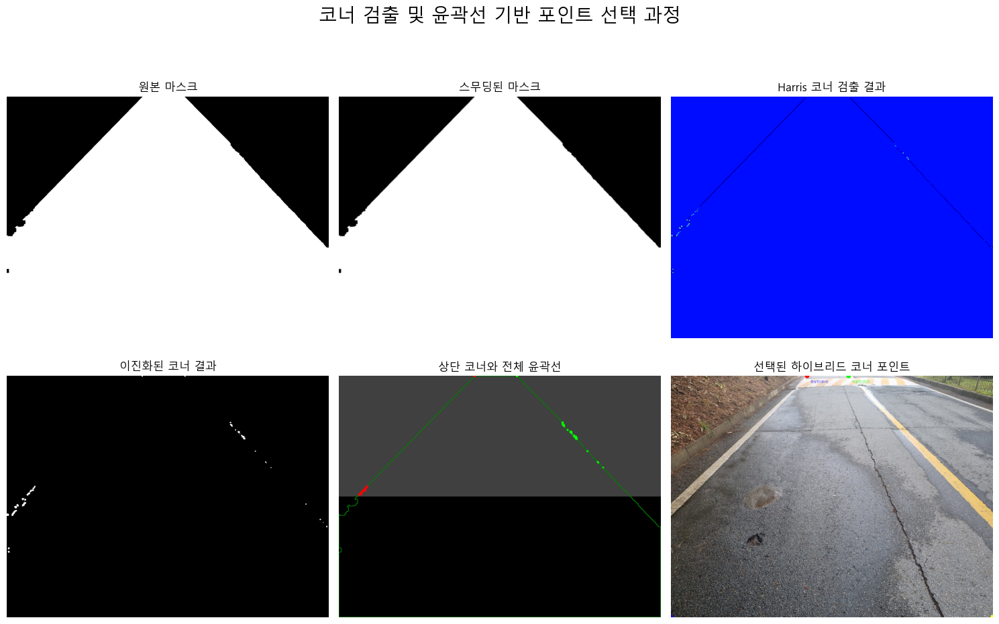


0: 768x1024 4 cracks, 1 pothole, 3510.5ms
Speed: 82.2ms preprocess, 3510.5ms inference, 47.5ms postprocess per image at shape (1, 3, 768, 1024)


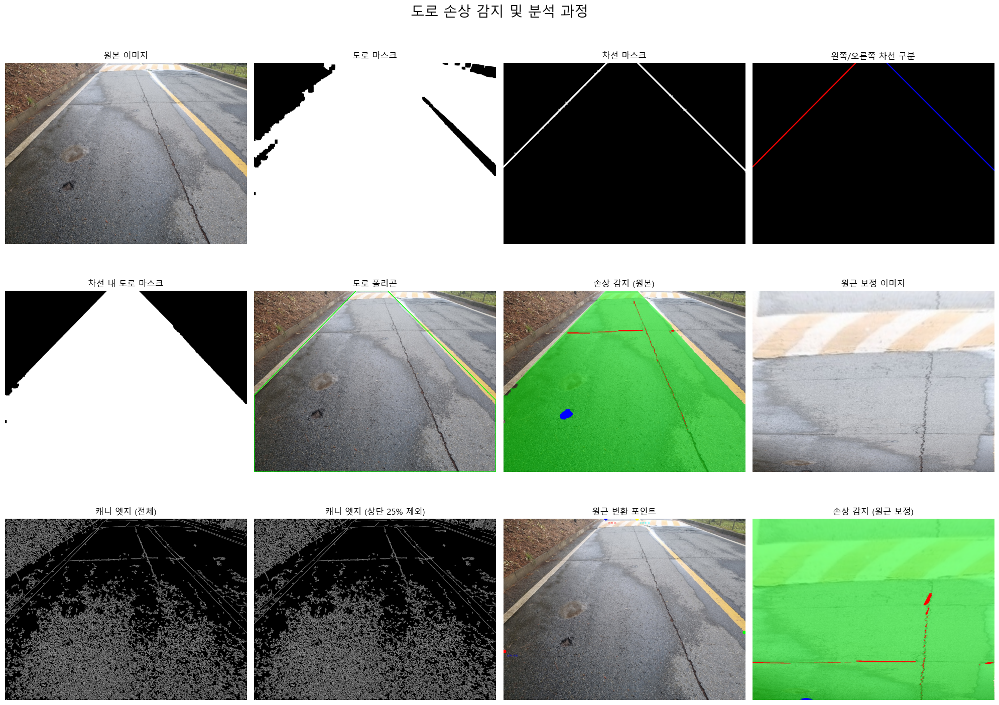


도로 영역 분석 결과:
도로 면적: 1098850 픽셀
균열 면적: 7983 픽셀 (0.73%)
포트홀 면적: 3444 픽셀 (0.31%)
총 손상 면적: 11427 픽셀 (1.04%)

원근 보정된 도로 영역 분석 결과:
도로 면적: 1492789 픽셀
균열 면적: 24581 픽셀 (1.65%)
포트홀 면적: 639 픽셀 (0.04%)
총 손상 면적: 25220 픽셀 (1.69%)
분석 결과가 ../result/analysis_result_22.txt에 저장되었습니다.
핵심 이미지가 ../result/key_images_22.jpg에 저장되었습니다.


In [43]:
def main():
    """
    메인 함수 - 전체 도로 손상 감지 파이프라인을 실행하는 함수

    1. 폰트 설정: 한글 폰트를 matplotlib에 설정하여 한글 텍스트 지원
    2. 모델 로드: YOLOv11-seg 모델을 지정된 경로에서 로드
        - 주석 처리된 대체 모델 경로도 포함
    3. 사용자 입력: 테스트할 이미지 번호를 사용자로부터 입력 받음
    4. 이미지 로드: 입력된 번호에 해당하는 테스트 이미지 파일을 로드
    5. 이미지 변환: BGR 형식의 이미지를 RGB 형식으로 변환(matplotlib 표시용)
    6. 이미지 크기: 처리할 이미지의 높이와 너비 추출
    7. 도로 마스크 생성: extract_road_mask 함수를 사용하여 도로 영역 추출
    8. 차선 마스크 생성: detect_lane_lines 함수를 사용하여 차선 검출 및 마스크 생성
    9. 차선 내 도로 추출: extract_road_between_lanes 함수로 차선 사이의 도로 영역과 도로 폴리곤 추출
    10. 코너 검출 시각화: visualize_corner_detection 함수로 코너 검출 과정 시각화(선택적 단계)
    11. 손상 감지: apply_yolo_on_masked_area 함수로 도로 영역에서 YOLO 모델을 통해 균열과 포트홀 감지
    12. 원근 변환 적용: perspective_transform 함수로 도로 영역에 원근 변환 적용
        - 차선 내 도로 마스크와 도로 폴리곤을 사용하여 더 정확한 변환 수행
    13. 손상 마스크 변환: 감지된 균열과 포트홀 마스크에 동일한 원근 변환 행렬 적용
    14. 결과 시각화: visualize_results 함수로 전체 처리 과정과 결과를 시각화하고 분석 결과 출력

    메인 실행 조건: 
        - 스크립트가 직접 실행될 때만 main() 함수 호출(임포트 시에는 실행 안 함)
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    # model_path = '../model/last.pt'
    # model_path = '../model/yolo11l-seg.pt'
    model_path = '../model/best.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = img_rgb.shape[:2]
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(img_bgr)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, edges, masked_edges = detect_lane_lines(img_bgr)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(img_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 코너 검출 과정 시각화 (선택 사항)
    visualize_corner_detection(img_rgb, road_lane_mask)
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, img_rgb, road_lane_mask)
    
    # 원근 변환 적용 - road_lane_mask를 사용
    warped_img, warped_mask, perspective_matrix, corner_points = perspective_transform(
        img_rgb, road_lane_mask, road_polygon)
    
    # 손상 마스크에도 원근 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
    
    # 결과 시각화 - img_num 인자 추가
    visualize_results(
        img_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
        edges, masked_edges, img_num
    )

if __name__ == "__main__":
    main()

# 합쳐진 코드

In [ ]:
import cv2
import torch
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO

# matplotlib 한글 폰트 설정
import matplotlib.font_manager as fm
import platform

def setup_matplotlib_font():
    """
    운영체제별 matplotlib 한글 기본 폰트 설정 함수
    
    1. 운영체제 감지 : platform.system()을 사용하여 현재 운영체제 확인
    2. 운영체제별 폰트 경로 설정 : 
        - Windows: 맑은 고딕(malgun.ttf)
        - macOS: Apple SD Gothic Neo
        - Linux: 나눔고딕(Ubuntu 기준)
    3. 폰트 로드 시도 : 지정된 경로에서 폰트를 로드하고 matplotlib 기본 폰트로 설정
    4. 예외 처리 : 폰트 로드 실패 시 기본 폰트(NanumGothic)를 대체 폰트로 시도
    5. 마이너스 기호 깨짐 방지 : axes.unicode_minus 옵션을 False로 설정하여 
        그래프에서 음수 표시 시 유니코드 마이너스 기호의 깨짐 방지
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    한글 텍스트를 이미지에 표시하는 함수
    
    1. PIL 이미지 변환 : OpenCV 이미지(NumPy 배열)를 PIL 이미지 객체로 변환
    2. 그리기 객체 생성 : PIL의 ImageDraw.Draw를 사용하여 이미지에 그리기 위한 객체 생성
    3. 운영체제 감지 : platform.system()으로 현재 운영체제 확인
    4. 운영체제별 폰트 설정 : 
        - Windows: 맑은 고딕(malgun.ttf)
        - macOS: Apple SD Gothic Neo
        - Linux: 나눔고딕(Ubuntu 기준)
    5. 폰트 로드 시도 : 지정된 경로에서 폰트를 로드하고 크기 설정(font_size * 20)
    6. 예외 처리 : 폰트 로드 실패 시 PIL 기본 폰트 사용
    7. 텍스트 그리기 : 지정된 위치에 설정된 폰트와 색상으로 텍스트 그리기(색상은 BGR->RGB 변환)
    8. NumPy 배열 변환 : 처리된 PIL 이미지를 다시 NumPy 배열로 변환하여 OpenCV 호환성 유지
    
    Parameters:
        - img : OpenCV 이미지(NumPy 배열)
        - text : 그릴 텍스트(한글 지원)
        - position : 텍스트 위치 좌표 (x, y)
        - font_size : 폰트 크기 배율(기본값: 1)
        - color : 텍스트 색상(BGR 형식, 기본값: 빨간색)
        - thickness : 사용되지 않음(OpenCV 호환성을 위한 파라미터)
        
    Returns:
        - 텍스트가 추가된 OpenCV 이미지(NumPy 배열)
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def extract_road_mask(img):
    """
    도로 영역 추출 함수
    
    1. 가우시안 블러: 노이즈 제거를 통해 이미지의 세부 잡음을 감소시키고 필터링 효과 향상
    2. HSV 변환: 색상(H), 채도(S), 명도(V)로 분리하여 색상 기반 필터링에 적합한 색상 공간으로 변환
    3. 도로 색상 범위 마스크 생성: 회색, 어두운 아스팔트, 밝은 콘크리트 등 다양한 도로 색상 범위를 포괄하는 마스크 생성
    4. 마스크 결합: 여러 색상 범위의 마스크를 논리합(OR)으로 결합하여 다양한 도로 유형 포함
    5. 열기 연산 적용: 작은 노이즈 제거를 위해 침식 후 팽창 연산을 수행하여 작은 불필요한 영역 제거
    6. 닫기 연산 적용: 도로 영역 내부의 작은 구멍을 메우기 위해 팽창 후 침식 연산 수행
    7. 큰 커널 닫기 연산: 더 넓은 영역에 닫기 연산을 적용하여 도로 틈새와 불연속 부분 메우기
    8. 연결 요소 분석: 마스크에서 연결된 영역(객체)을 찾고 면적 기준으로 정렬
    9. 유의미한 크기 선택: 전체 이미지의 5% 이상 크기를 가진 상위 연결 요소만 선택하여 세부 필터링
    10. 홍수 채우기: 이미지 하단 중앙(도로일 가능성이 높은 지점)에서 시작하여 연결된 영역 채우기
    11. 결과 결합: 면적 기반으로 선택된 영역과 홍수 채우기 결과를 결합하여 최종 도로 마스크 생성
    
    Parameters:
        - img (numpy.ndarray): 도로 영역을 추출할 BGR 형식의 입력 이미지
    
    Returns:
        - numpy.ndarray: 도로 영역을 나타내는 이진 마스크 이미지(255: 도로 영역, 0: 비도로 영역
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색, 어두운 회색, 밝은 회색 포함)
    # 넓은 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 60])
    upper_gray_road = np.array([180, 50, 200])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 30])
    upper_dark_road = np.array([180, 30, 120])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 130])
    upper_light_road = np.array([180, 40, 255])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

import cv2
import numpy as np
from sklearn.linear_model import LinearRegression, RANSACRegressor

def detect_lane_lines(img):
    """
    차선 감지 및 마스크 생성 함수

    1. 그레이스케일 변환: 이미지를 흑백으로 변환하여 색상 복잡성 감소 및 처리 속도 향상
    2. 가우시안 블러: 노이즈 제거를 통해 엣지 검출의 정확도 향상
    3. 캐니 엣지 검출: 이미지의 모든 엣지(가장자리)를 검출하여 차선 후보 식별
    4. ROI(관심 영역) 설정: 도로 영역에서 상단 25% 영역 제외(주석 처리됨)하여 불필요한 영역 제거
    5. 색상 기반 차선 추출: HSV 색상 공간에서 흰색과 노란색(일반적인 차선 색상) 범위만 필터링
    6. 마스크 통합: 엣지 기반 마스크와 색상 기반 마스크를 결합하여 차선 후보 강화
    7. 호프 변환 적용: 직선 성분 검출 알고리즘을 사용하여 마스크에서 직선 성분 추출
    8. RANSAC 원리 적용: 길이, 기울기 등의 조건을 사용해 이상치(outlier) 제거 및 최적 차선 모델 선택
        - 최소 길이 필터링으로 노이즈 제거
        - 적절한 기울기 범위 선택(0.3~2.0)으로 유효한 차선만 유지
        - 각 차선별로 가장 긴 선분 선택하여 대표 모델로 사용
    9. 차선 분류: 기울기와 위치에 따라 왼쪽(음수 기울기) 및 오른쪽(양수 기울기) 차선으로 분류
    10. 차선 모델 생성 및 연장: 선형 모델(직선 방정식)을 통해 차선을 화면 경계까지 연장
    11. 범위 검증: 연장된 차선이 이미지 경계를 벗어나지 않도록 범위 검증 및 조정
    12. 최종 마스크 생성: 왼쪽과 오른쪽 차선 마스크를 통합하고 확장하여 최종 차선 마스크 반환

    Parameters:
        - img (numpy.ndarray): 차선을 검출할 BGR 형식의 입력 이미지

    Returns:
        tuple: 
            - lane_mask (numpy.ndarray): 전체 차선 마스크
            - left_line_mask (numpy.ndarray): 왼쪽 차선 마스크
            - right_line_mask (numpy.ndarray): 오른쪽 차선 마스크
            - edges (numpy.ndarray): 원본 캐니 엣지 검출 결과
            - masked_edges (numpy.ndarray): ROI 적용된 캐니 엣지 검출 결과
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    roi_mask = np.ones_like(edges)
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    color_mask = cv2.bitwise_and(color_mask, color_mask, mask=roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_points = []
    right_points = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                # 각 선분의 두 점을 모두 저장 (RANSAC에 사용)
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    left_points.append((x1, y1))
                    left_points.append((x2, y2))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    right_points.append((x1, y1))
                    right_points.append((x2, y2))
    
    # 확장된 차선 마스크 생성
    extended_left_mask = np.zeros_like(gray)
    extended_right_mask = np.zeros_like(gray)
    
    # RANSAC 알고리즘 적용하여 차선 모델 추정
    # 왼쪽 차선 RANSAC 적용
    if len(left_points) >= 5:  # RANSAC을 적용하기 위한 최소 포인트 수
        left_points = np.array(left_points)
        left_x = left_points[:, 0]
        left_y = left_points[:, 1]
        
        # RANSAC 파라미터 설정
        ransac = RANSACRegressor(
            estimator=LinearRegression(),
            min_samples=5,           # 모델 추정에 사용할 최소 샘플 수
            max_trials=100,          # RANSAC 최대 반복 횟수
            residual_threshold=10.0, # 이상치 판별 임계값
            random_state=42
        )
        
        # 모델 피팅 (y=f(x)가 아닌 x=f(y)로 피팅하여 수직에 가까운 선도 처리)
        try:
            ransac.fit(left_y.reshape(-1, 1), left_x)
            
            # 모델의 신뢰도 확인
            inlier_mask = ransac.inlier_mask_
            if np.sum(inlier_mask) > 5:  # 최소 5개 이상의 인라이어가 있어야 함
                # 차선 연장을 위한 직선 방정식 계산
                # x = m*y + b
                left_slope = ransac.estimator_.coef_[0]
                left_intercept = ransac.estimator_.intercept_
                
                # 화면 하단과 상단에서의 x 좌표 계산
                bottom_y = height
                bottom_x = int(left_slope * bottom_y + left_intercept)
                
                top_y = 0
                top_x = int(left_slope * top_y + left_intercept)
                
                # x 좌표가 화면 범위를 벗어나는지 확인
                if top_x < 0:
                    # x가 0일 때의 y 계산 (역으로 계산)
                    top_y = int((0 - left_intercept) / left_slope)
                    top_x = 0
                elif top_x >= width:
                    top_y = int(((width-1) - left_intercept) / left_slope)
                    top_x = width - 1
                    
                if bottom_x < 0:
                    bottom_y = int((0 - left_intercept) / left_slope)
                    bottom_x = 0
                elif bottom_x >= width:
                    bottom_y = int(((width-1) - left_intercept) / left_slope)
                    bottom_x = width - 1
                
                # 연장된 왼쪽 차선 그리기
                cv2.line(extended_left_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
                
                # 인라이어 포인트 시각화 (선택 사항)
                for i in range(len(left_points)):
                    if inlier_mask[i]:
                        cv2.circle(left_line_mask, (left_x[i], left_y[i]), 3, 127, -1)
        except:
            # RANSAC 피팅 실패 시 기존 방식으로 대체
            pass
    
    # 오른쪽 차선 RANSAC 적용
    if len(right_points) >= 5:
        right_points = np.array(right_points)
        right_x = right_points[:, 0]
        right_y = right_points[:, 1]
        
        # RANSAC 파라미터 설정
        ransac = RANSACRegressor(
            estimator=LinearRegression(),
            min_samples=5,
            max_trials=100,
            residual_threshold=10.0,
            random_state=42
        )
        
        # 모델 피팅
        try:
            ransac.fit(right_y.reshape(-1, 1), right_x)
            
            # 모델의 신뢰도 확인
            inlier_mask = ransac.inlier_mask_
            if np.sum(inlier_mask) > 5:  # 최소 5개 이상의 인라이어가 있어야 함
                # 차선 연장을 위한 직선 방정식 계산
                right_slope = ransac.estimator_.coef_[0]
                right_intercept = ransac.estimator_.intercept_
                
                # 화면 하단과 상단에서의 x 좌표 계산
                bottom_y = height
                bottom_x = int(right_slope * bottom_y + right_intercept)
                
                top_y = 0
                top_x = int(right_slope * top_y + right_intercept)
                
                # x 좌표가 화면 범위를 벗어나는지 확인
                if top_x < 0:
                    top_y = int((0 - right_intercept) / right_slope)
                    top_x = 0
                elif top_x >= width:
                    top_y = int(((width-1) - right_intercept) / right_slope)
                    top_x = width - 1
                    
                if bottom_x < 0:
                    bottom_y = int((0 - right_intercept) / right_slope)
                    bottom_x = 0
                elif bottom_x >= width:
                    bottom_y = int(((width-1) - right_intercept) / right_slope)
                    bottom_x = width - 1
                
                # 연장된 오른쪽 차선 그리기
                cv2.line(extended_right_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
                
                # 인라이어 포인트 시각화 (선택 사항)
                for i in range(len(right_points)):
                    if inlier_mask[i]:
                        cv2.circle(right_line_mask, (right_x[i], right_y[i]), 3, 127, -1)
        except:
            # RANSAC 피팅 실패 시 기존 방식으로 대체
            pass
    
    # 왼쪽/오른쪽 차선 마스크 각각 업데이트
    left_line_mask = cv2.bitwise_or(left_line_mask, extended_left_mask)
    right_line_mask = cv2.bitwise_or(right_line_mask, extended_right_mask)
    
    # 전체 차선 마스크 통합
    lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    lane_mask = cv2.dilate(lane_mask, kernel, iterations=1)
    
    return lane_mask, left_line_mask, right_line_mask, edges, masked_edges

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역 추출 함수

    1. 차선 윤곽선 찾기: 왼쪽과 오른쪽 차선 마스크에서 각각 윤곽선 검출
    2. 차선 확인: 충분한 차선이 감지되지 않을 경우 기본 도로 마스크 반환
    3. 대표 윤곽선 선택: 각 차선에서 면적이 가장 큰 윤곽선을 대표 차선으로 선택
    4. 윤곽선 포인트 추출: 선택된 윤곽선에서 모든 점의 좌표 추출
    5. 주요 경계점 찾기: 각 차선에서 가장 상단(y좌표 최소)과 하단(y좌표 최대) 지점 추출
    6. 신뢰성 검증: 차선의 길이가 충분하지 않은 경우(50픽셀 미만) 대체 포인트로 보정
    7. 하단 경계 좌표 추가: 이미지 하단 좌/우 모서리 좌표를 추가하여 폴리곤 완성
    8. 도로 폴리곤 생성: 검출된 좌표를 사용하여 차선 내부와 차선 아래 영역을 포함하는 폴리곤 정의
    9. 폴리곤 마스크 생성: 정의된 폴리곤으로 빈 마스크에 영역 채우기
    10. 최종 마스크 생성: 생성된 폴리곤 마스크와 원래 도로 마스크의 교집합으로 차선 내부 도로 영역 추출

    Parameters:
        - img (numpy.ndarray): 원본 이미지
        - road_mask (numpy.ndarray): 도로 영역 마스크
        - left_lane_mask (numpy.ndarray): 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray): 오른쪽 차선 마스크

    Returns:
    tuple:
        - final_road_mask (numpy.ndarray): 차선 내부의 도로 영역 마스크
        - road_polygon (numpy.ndarray): 도로 영역을 정의하는 폴리곤 좌표
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def get_default_perspective_points(road_polygon, height, width):
    """
    원근 변환을 위한 기본 포인트 설정 함수

    1. 입력 검증: road_polygon이 유효한 경우(None이 아니고 충분한 포인트 보유) 사용
    2. 폴리곤 포인트 추출: road_polygon에서 원근 변환에 필요한 주요 4개 포인트 추출
        - 왼쪽 차선 하단: road_polygon[1]
        - 오른쪽 차선 하단: road_polygon[4]
        - 왼쪽 차선 상단: road_polygon[2]
        - 오른쪽 차선 상단: road_polygon[3]
    3. 기본값 설정: 유효한 road_polygon이 없는 경우 이미지 크기에 기반한 기본 포인트 사용
        - 좌하단: 이미지 좌하단 모서리 (0, height-1)
        - 우하단: 이미지 우하단 모서리 (width-1, height-1)
        - 좌상단: 이미지 좌측 1/4 지점, 높이 1/3 지점 (width/4, height/3)
        - 우상단: 이미지 우측 3/4 지점, 높이 1/3 지점 (width*3/4, height/3)
    4. 반환: 원근 변환에 사용할 4개의 포인트를 float32 형식으로 변환하여 반환

    Parameters:
        - road_polygon (numpy.ndarray or None): 도로 영역을 정의하는 폴리곤 좌표
        - height (int): 이미지 높이
        - width (int): 이미지 너비

    Returns:
        - numpy.ndarray: 원근 변환에 사용할 소스 포인트 좌표(4개 점의 좌표, float32 형식)
    """
    if road_polygon is not None and len(road_polygon) >= 6:
        # road_polygon에서 필요한 포인트 추출
        left_bottom = road_polygon[1]  # 왼쪽 차선 하단
        right_bottom = road_polygon[4] # 오른쪽 차선 하단
        left_top = road_polygon[2]     # 왼쪽 차선 상단
        right_top = road_polygon[3]    # 오른쪽 차선 상단
        
        # 사용할 코너 포인트
        return np.float32([left_bottom, right_bottom, left_top, right_top])
    else:
        # 기본값 설정
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
        
        return np.float32([bottom_left, bottom_right, top_left, top_right])
    
def fallback_perspective_transform(img, mask, road_polygon=None):
    """
    코너 검출이 실패했을 때 사용하는 대체 원근 변환 함수

    1. 윤곽선 검출: 도로 마스크에서 외부 윤곽선 찾기
    2. 윤곽선 선택: 가장 큰 면적을 가진 윤곽선을 대표 윤곽선으로 선택
    3. 하단 포인트 검출: 
        - 좌하단: x값이 가장 작고 y값이 가장 큰 포인트 선택
        - 우하단: x값이 가장 크고 y값이 가장 큰 포인트 선택
    4. 상단 포인트 추출: y좌표가 하위 10% 이내인 포인트들을 상단 후보로 선택
    5. 상단 포인트 검출(기본): 
        - 좌상단: 상단 후보 중 x값이 가장 작은 포인트
        - 우상단: 상단 후보 중 x값이 가장 큰 포인트
    6. 상단 포인트 대체 로직: 
        - 상단 후보가 부족한 경우 y값 기준 정렬 후 상위 10%(또는 최소 5개) 포인트 중에서 선택
        - 이 중 x좌표 최소/최대 값을 각각 좌/우 상단으로 선택
    7. 기본 포인트 사용: 윤곽선이 없거나 포인트가 부족한 경우 기본 포인트 설정 함수 호출
    8. 타겟 포인트 설정: 변환 후 이미지에서의 위치 좌표 설정
        - 좌하단: (0, height-1)
        - 우하단: (width-1, height-1)
        - 좌상단: (0, 0)
        - 우상단: (width-1, 0)
    9. 원근 변환 적용: 소스 포인트와 타겟 포인트를 기반으로 변환 행렬 계산 및 적용

    Parameters:
        - img (numpy.ndarray): 원근 변환을 적용할 원본 이미지
        - mask (numpy.ndarray): 도로 영역 마스크
        - road_polygon (numpy.ndarray or None): 도로 영역을 정의하는 폴리곤 좌표(기본값으로 사용)

    Returns:
    tuple:
        - warped_img (numpy.ndarray): 원근 변환된 이미지
        - warped_mask (numpy.ndarray): 원근 변환된 마스크
        - M (numpy.ndarray): 원근 변환 행렬
        - src_points (numpy.ndarray): 원근 변환에 사용된 소스 포인트
    """
    height, width = mask.shape
    
    # 도로 마스크에서 윤곽선 찾기
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours and len(contours) > 0:
        # 가장 큰 윤곽선 선택
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) > 0:
            # 왼쪽 하단: x값 최소, y값 최대
            left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
            left_bottom = all_points[left_bottom_idx]
            
            # 오른쪽 하단: x값 최대, y값 최대
            right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
            right_bottom = all_points[right_bottom_idx]
            
            # 상단 부분의 포인트 추출 (y값이 하위 10% 이내인 점들)
            y_threshold = np.percentile(all_points[:, 1], 10)
            top_points = all_points[all_points[:, 1] <= y_threshold]
            
            if len(top_points) > 0:
                # 왼쪽 상단: 상단 부분에서 x값이 가장 작은 점
                left_top_idx = np.argmin(top_points[:, 0])
                left_top = top_points[left_top_idx]
                
                # 오른쪽 상단: 상단 부분에서 x값이 가장 큰 점
                right_top_idx = np.argmax(top_points[:, 0])
                right_top = top_points[right_top_idx]
            else:
                # 상단 부분 포인트가 부족한 경우, y값을 우선 정렬하여 가장 작은 y값을 가진 포인트 중에서 선택
                sorted_by_y = all_points[np.argsort(all_points[:, 1])]
                top_n_points = sorted_by_y[:max(5, len(sorted_by_y) // 10)]  # 상위 10% 또는 최소 5개
                
                # 이 포인트들 중에서 왼쪽/오른쪽 구분
                left_top_idx = np.argmin(top_n_points[:, 0])
                left_top = top_n_points[left_top_idx]
                
                right_top_idx = np.argmax(top_n_points[:, 0])
                right_top = top_n_points[right_top_idx]
            
            src_points = np.float32([left_bottom, right_bottom, left_top, right_top])
        else:
            # 포인트가 없는 경우 기본값 사용
            src_points = get_default_perspective_points(road_polygon, height, width)
    else:
        # 윤곽선이 없는 경우 기본값 사용
        src_points = get_default_perspective_points(road_polygon, height, width)
    
    # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def perspective_transform(img, mask, road_polygon=None):
    """
    원근 변환 함수 - 하이브리드 접근법 사용

    1. 마스크 전처리: 가우시안 블러로 노이즈 제거 및 코너 검출을 위한 준비
    2. Harris 코너 검출: 도로 마스크에서 코너점 감지 (코너는 방향이 급격히 변하는 지점)
    3. 코너 후처리: 결과 이진화 및 팽창을 통해 코너 강조
    4. 코너 좌표 추출: 검출된 모든 코너 포인트의 좌표 추출
    5. 코너 충분성 검증: 최소 10개 이상의 코너가 검출되지 않으면 대체 알고리즘 호출
    6. 이미지 영역 분할: 이미지를 4등분하여 각 영역별 코너 포인트 분류
        - 좌상단, 우상단, 좌하단, 우하단 영역으로 구분
    7. 상단 포인트 검증: 상단 영역에 충분한 코너가 없으면 대체 알고리즘 호출
    8. 상단 포인트 선택: 
        - 좌상단: 이미지 중앙 상단(w_mid, 0)에서 가장 가까운 코너점
        - 우상단: 이미지 중앙 상단(w_mid, 0)에서 가장 가까운 코너점
    9. 하단 포인트 선택: 
        - 코너 검출 결과가 충분한 경우: 이미지 코너에 가장 가까운 포인트 선택
        - 좌하단: (0, height)에 가장 가까운 코너
        - 우하단: (width, height)에 가장 가까운 코너
    10. 대체 하단 포인트 검출: 
        - 하단 영역에 코너가 부족한 경우, 윤곽선 기반 방식으로 포인트 탐색
    11. 포인트 검증: 선택된 포인트의 상대적 위치 관계 검증(상단이 하단보다 y값이 작아야 함)
    12. 변환 포인트 설정: 검증된 네 포인트로 원근 변환 소스 포인트 구성
    13. 타겟 포인트 설정: 직사각형 형태의 타겟 포인트 정의
    14. 원근 변환 적용: 변환 행렬 계산 및 이미지와 마스크에 변환 적용

    Parameters:
        - img (numpy.ndarray): 원근 변환을 적용할 원본 이미지
        - mask (numpy.ndarray): 도로 영역 마스크
        - road_polygon (numpy.ndarray or None): 도로 영역을 정의하는 폴리곤 좌표(선택 사항)

    Returns:
    tuple:
        - warped_img (numpy.ndarray): 원근 변환된 이미지
        - warped_mask (numpy.ndarray): 원근 변환된 마스크
        - M (numpy.ndarray): 원근 변환 행렬
        - src_points (numpy.ndarray): 원근 변환에 사용된 소스 포인트
    """
    height, width = mask.shape
    ""
    # 상단 포인트용 코너 검출에 적합한 마스크 준비
    mask_smooth = cv2.GaussianBlur(mask, (5, 5), 0)
    
    # Harris 코너 검출
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 코너 검출 결과를 이진화하고 팽창 (더 뚜렷하게)
    corners_dilated = cv2.dilate(corners, None)
    _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
    corners_binary = np.uint8(corners_binary)

    # 코너 포인트 좌표 추출
    corner_coords = np.where(corners_binary > 0)
    corner_y = corner_coords[0]
    corner_x = corner_coords[1]
    
    # 모든 코너 좌표를 리스트로 변환
    all_corners = []
    for i in range(len(corner_y)):
        all_corners.append([corner_x[i], corner_y[i]])
    
    # 코너가 충분히 많지 않으면 대체 방식 사용
    if len(all_corners) < 10:
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 이미지를 4분할하여 영역별 코너점 찾기
    h_mid = height // 2
    w_mid = width // 2
    
    # 각 영역의 코너 포인트
    top_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] < h_mid]
    top_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] < h_mid]
    bottom_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] >= h_mid]
    bottom_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] >= h_mid]
    
    # 상단 영역에 코너가 없는 경우 대체 방법 사용
    if not (top_left_corners and top_right_corners):
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 좌상단과 우상단은 기존 방식 유지
    top_left = min(top_left_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
    top_right = min(top_right_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
    
    # 하단 포인트들은 이미지 코너에 가장 가까운 포인트로 선택
    if bottom_left_corners and bottom_right_corners:
        bottom_left = min(bottom_left_corners, key=lambda p: p[0]**2 + (p[1]-height)**2)
        bottom_right = min(bottom_right_corners, key=lambda p: (p[0]-width)**2 + (p[1]-height)**2)
    else:
        # 하단 코너가 충분하지 않으면 기존 방식 사용
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        if not contours or len(contours) == 0:
            return fallback_perspective_transform(img, mask, road_polygon)
        
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) == 0:
            return fallback_perspective_transform(img, mask, road_polygon)
        
        # 왼쪽/오른쪽 하단 포인트 찾기
        left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
        right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
        bottom_left = all_points[left_bottom_idx]
        bottom_right = all_points[right_bottom_idx]
    
    # 포인트 검증: y 좌표와 x 좌표가 적절한지 확인
    if (top_left[1] > bottom_left[1] or top_right[1] > bottom_right[1] or
        top_left[0] > top_right[0] or bottom_left[0] > bottom_right[0]):
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 원근 변환에 사용할 소스 포인트
    src_points = np.float32([
        bottom_left,    # 좌하단
        bottom_right,   # 우하단
        top_left,       # 좌상단
        top_right       # 우상단
    ])
    
    # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def apply_yolo_on_masked_area(model, img, mask):
    """
    마스크된 영역에서 YOLO 추론 수행 함수

    1. 마스크 채널 확장: 1채널(그레이스케일) 마스크를 3채널(RGB) 형식으로 변환
    2. 마스크 적용: 원본 이미지에 마스크를 적용하여 관심 영역(도로)만 유지
    3. YOLO 추론: 마스크된 이미지에 YOLO 모델 적용하여 객체 및 세그멘테이션 감지
    4. 결과 추출: 첫 번째 결과셋 선택
    5. 클래스별 마스크 초기화: 균열(crack)과 포트홀(pothole) 클래스에 대한 빈 마스크 생성
    6. 결과 처리: 감지된 각 객체에 대해 처리
    7. 클래스 식별: 각 감지 객체의 클래스 ID 추출 (0: crack, 1: pothole)
    8. 마스크 데이터 추출: 세그멘테이션 마스크 데이터를 CPU 메모리로 가져오기
    9. 이진화: 임계값(0.5) 적용하여 마스크를 이진화하고 255로 스케일링
    10. 크기 조정: 이진 마스크를 원본 이미지 크기에 맞게 조정
    11. 클래스별 마스크 통합: 각 클래스(균열/포트홀)에 따라 해당 마스크에 결과 통합

    Parameters:
        - model (YOLO): 추론에 사용할 YOLO 모델
        - img (numpy.ndarray): 원본 RGB 이미지
        - mask (numpy.ndarray): 도로 영역을 나타내는 이진 마스크

    Returns:
    tuple:
        - mask_crack (numpy.ndarray): 균열 영역 이진 마스크
        - mask_pothole (numpy.ndarray): 포트홀 영역 이진 마스크
    """
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

def save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, img_num):
    """
    분석 결과를 텍스트 파일로 저장하는 함수

    1. 결과 디렉토리 설정: 상위 디렉토리의 'result' 폴더를 결과 저장 위치로 지정
    2. 디렉토리 생성: 지정된 결과 디렉토리가 없는 경우 자동 생성
    3. 파일 경로 설정: 이미지 번호를 포함한 분석 결과 파일명 생성
    4. 파일 작성 시작: UTF-8 인코딩으로 텍스트 파일 생성 및 쓰기 모드로 열기
    5. 원본 이미지 분석 결과 저장:
        - 전체 도로 면적(픽셀 단위)
        - 균열 면적(픽셀 및 도로 대비 백분율)
        - 포트홀 면적(픽셀 및 도로 대비 백분율)
        - 총 손상 면적(픽셀 및 도로 대비 백분율)
    6. 원근 보정된 이미지 분석 결과 저장:
        - 보정된 도로 면적(픽셀 단위)
        - 보정된 균열 면적(픽셀 및 도로 대비 백분율)
        - 보정된 포트홀 면적(픽셀 및 도로 대비 백분율)
        - 보정된 총 손상 면적(픽셀 및 도로 대비 백분율)
    7. 저장 완료 알림: 저장된 파일 경로 콘솔 출력

    Parameters:
        - road_area (int): 원본 이미지의 도로 면적(픽셀 수)
        - crack_area (int): 원본 이미지의 균열 면적(픽셀 수)
        - pothole_area (int): 원본 이미지의 포트홀 면적(픽셀 수)
        - warped_road_area (int): 원근 보정된 이미지의 도로 면적(픽셀 수)
        - warped_crack_area (int): 원근 보정된 이미지의 균열 면적(픽셀 수)
        - warped_pothole_area (int): 원근 보정된 이미지의 포트홀 면적(픽셀 수)
        - img_num (str): 분석 중인 이미지 번호 또는 식별자
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'analysis_result_{img_num}.txt')
    
    # 결과 작성
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(f"도로 영역 분석 결과:\n")
        f.write(f"도로 면적: {road_area} 픽셀\n")
        f.write(f"균열 면적: {crack_area} 픽셀 ({crack_area/road_area*100:.2f}%)\n")
        f.write(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_area/road_area*100:.2f}%)\n")
        f.write(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_area + pothole_area)/road_area*100:.2f}%)\n\n")
        
        f.write(f"원근 보정된 도로 영역 분석 결과:\n")
        f.write(f"도로 면적: {warped_road_area} 픽셀\n")
        f.write(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_area/warped_road_area*100:.2f}%)\n")
        f.write(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_area/warped_road_area*100:.2f}%)\n")
        f.write(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_area + warped_pothole_area)/warped_road_area*100:.2f}%)\n")
    
    print(f"분석 결과가 {file_path}에 저장되었습니다.")

def save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num):
    """
    핵심 이미지 4개를 하나의 이미지 파일로 저장하는 함수

    1. 결과 디렉토리 설정: 상위 디렉토리의 'result' 폴더를 저장 위치로 지정
    2. 디렉토리 생성: 지정된 결과 디렉토리가 없는 경우 자동 생성
    3. 파일 경로 설정: 이미지 번호를 포함한 핵심 이미지 파일명 생성
    4. 그림 영역 설정: 2x2 그리드 레이아웃으로 15x12 인치 크기의 그림 영역 생성
    5. 이미지 배치:
        - 좌상단(1): 원본 이미지
        - 우상단(2): 손상 감지가 표시된 원본 이미지
        - 좌하단(3): 원근 변환에 사용된 포인트가 표시된 이미지
        - 우하단(4): 원근 보정 후 손상 감지가 표시된 이미지
    6. 레이아웃 최적화: 자동 레이아웃 조정 및 전체 제목 추가
    7. 이미지 저장: 300 DPI 해상도로 JPEG 형식으로 저장
    8. 리소스 정리: 그림 객체 닫기
    9. 저장 완료 알림: 저장된 파일 경로 콘솔 출력

    Parameters:
        - original_img (numpy.ndarray): 원본 입력 이미지
        - overlay_original (numpy.ndarray): 손상 감지 결과가 표시된 원본 이미지
        - img_with_points (numpy.ndarray): 원근 변환 포인트가 표시된 이미지
        - overlay_warped (numpy.ndarray): 원근 보정 후 손상 감지 결과가 표시된 이미지
        - img_num (str): 분석 중인 이미지 번호 또는 식별자
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'key_images_{img_num}.jpg')
    
    # 2x2 그리드로 이미지 배치
    plt.figure(figsize=(15, 12))
    
    plt.subplot(2, 2, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    plt.subplot(2, 2, 2)
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    plt.subplot(2, 2, 3)
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    plt.subplot(2, 2, 4)
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle(f"도로 손상 분석 결과 (이미지 {img_num})", fontsize=16)
    plt.subplots_adjust(top=0.9)
    
    # 이미지 저장
    plt.savefig(file_path, dpi=300, bbox_inches='tight')
    plt.close()
    
    print(f"핵심 이미지가 {file_path}에 저장되었습니다.")

def visualize_corner_detection(img, mask):
    """
    코너 검출 과정과 결과를 시각화하는 함수 - 하이브리드 방식 시각화

    1. 마스크 전처리: 가우시안 블러로 노이즈 제거 및 코너 검출을 위한 준비
    2. Harris 코너 검출: 스무딩된 마스크에 코너 검출 알고리즘 적용
    3. 코너 후처리: 팽창 연산과 이진화를 통해 코너 결과 강화 및 명확화
    4. 코너 좌표 추출: 이진화된 코너 이미지에서 모든 코너 좌표(x, y) 추출
    5. 이미지 영역 분할: 이미지를 상/하단으로 나누어 영역별 코너 분류
    6. 상단 코너 분류: 좌/우 상단 영역에 있는 코너 포인트 분류
    7. 최적 상단 포인트 선택: 
        - 좌상단: 중앙 상단에서 가장 가까운 코너 포인트
        - 우상단: 중앙 상단에서 가장 가까운 코너 포인트
    8. 하단 포인트 계산: 윤곽선 기반의 방식을 사용하여 하단 포인트 검출
        - 좌하단: x값이 가장 작고 y값이 가장 큰 윤곽선 포인트
        - 우하단: x값이 가장 크고 y값이 가장 큰 윤곽선 포인트
    9. 시각화 설정: 3x2 그리드로 총 6개의 시각화 패널 구성
    10. 패널 1: 원본 마스크 표시
    11. 패널 2: 스무딩된 마스크 표시
    12. 패널 3: Harris 코너 검출 결과 히트맵 표시
    13. 패널 4: 이진화된 코너 검출 결과 표시
    14. 패널 5: 상단 영역 구분, 윤곽선 및 코너 포인트 시각화
        - 상단 영역: 회색 배경
        - 윤곽선: 녹색 선
        - 좌상단 코너: 빨간색 점
        - 우상단 코너: 초록색 점
    15. 패널 6: 최종 선택된 4개의 코너 포인트 표시 및 라벨링
    16. 레이아웃 완성: 전체 제목 및 레이아웃 조정 후 시각화 표시

    Parameters:
        - img (numpy.ndarray): 원본 RGB 이미지
        - mask (numpy.ndarray): 도로 영역을 나타내는 이진 마스크
    """
    height, width = mask.shape
    
    # 코너 검출에 사용된 마스크 준비
    mask_smooth = cv2.GaussianBlur(mask, (5, 5), 0)
    
    # Harris 코너 검출
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 결과 이진화 및 팽창
    corners_dilated = cv2.dilate(corners, None)
    _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
    corners_binary = np.uint8(corners_binary)

    # 코너 좌표 추출
    corner_coords = np.where(corners_binary > 0)
    all_corners = []
    for i in range(len(corner_coords[0])):
        all_corners.append([corner_coords[1][i], corner_coords[0][i]])  # x, y 순서로 저장
    
    # 이미지 상단/하단 구분
    h_mid = height // 2
    w_mid = width // 2
    
    # 상단 영역의 코너 포인트 분류
    top_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] < h_mid]
    top_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] < h_mid]
    
    # 최적의 상단 코너 포인트 계산
    selected_corners = []
    if top_left_corners:
        top_left = min(top_left_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
        selected_corners.append(top_left)
    
    if top_right_corners:
        top_right = min(top_right_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
        selected_corners.append(top_right)
    
    # 하단 포인트 계산 (기존 방식)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours and len(contours) > 0:
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) > 0:
            # 왼쪽 하단: x값 최소, y값 최대
            left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
            bottom_left = all_points[left_bottom_idx]
            selected_corners.append(bottom_left)
            
            # 오른쪽 하단: x값 최대, y값 최대
            right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
            bottom_right = all_points[right_bottom_idx]
            selected_corners.append(bottom_right)
    
    # 시각화
    plt.figure(figsize=(15, 10))
    
    # 원본 마스크
    plt.subplot(2, 3, 1)
    plt.imshow(mask, cmap='gray')
    plt.title('원본 마스크')
    plt.axis('off')
    
    # 스무딩된 마스크
    plt.subplot(2, 3, 2)
    plt.imshow(mask_smooth, cmap='gray')
    plt.title('스무딩된 마스크')
    plt.axis('off')
    
    # Harris 코너 검출 결과
    plt.subplot(2, 3, 3)
    plt.imshow(corners, cmap='jet')
    plt.title('Harris 코너 검출 결과')
    plt.axis('off')
    
    # 이진화된 코너 결과
    plt.subplot(2, 3, 4)
    plt.imshow(corners_binary, cmap='gray')
    plt.title('이진화된 코너 결과')
    plt.axis('off')
    
    # 상단 코너와 윤곽선 구분
    plt.subplot(2, 3, 5)
    visualization = np.zeros((height, width, 3), dtype=np.uint8)
    
    # 상단 영역 표시 (밝은 회색)
    visualization[:h_mid, :] = [64, 64, 64]
    
    # 윤곽선 표시
    if contours and len(contours) > 0:
        cv2.drawContours(visualization, [main_contour], 0, [0, 128, 0], 2)
    
    # 상단 코너 표시
    for p in top_left_corners:
        cv2.circle(visualization, tuple(p), 2, [255, 0, 0], -1)  # 빨간색
    for p in top_right_corners:
        cv2.circle(visualization, tuple(p), 2, [0, 255, 0], -1)  # 초록색
    
    plt.imshow(visualization)
    plt.title('상단 코너와 전체 윤곽선')
    plt.axis('off')
    
    # 선택된 코너 포인트
    plt.subplot(2, 3, 6)
    img_with_corners = img.copy()
    point_names = ['좌상단(코너)', '우상단(코너)', '좌하단(윤곽선)', '우하단(윤곽선)']
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    
    for i, p in enumerate(selected_corners):
        if i < len(point_names):
            cv2.circle(img_with_corners, tuple(p), 10, colors[i], -1)
            # PIL로 한글 텍스트 추가
            img_with_corners = put_text_on_image(
                img_with_corners, 
                point_names[i], 
                (p[0] + 15, p[1] + 15), 
                font_size=0.7, 
                color=colors[i]
            )
    
    plt.imshow(img_with_corners)
    plt.title('선택된 하이브리드 코너 포인트')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("코너 검출 및 윤곽선 기반 포인트 선택 과정", fontsize=20)
    plt.subplots_adjust(top=0.9)
    plt.show()

def visualize_results(original_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     edges, masked_edges, img_num):  # img_num 매개변수 추가
    """
    결과 시각화 함수

    1. 그림 설정: 20x15 인치 크기의 그림 영역 생성
    2. 레이아웃 구성: 3행 4열(총 12개 패널)의 그리드 레이아웃으로 시각화 구성

    첫 번째 행: 기본 이미지와 마스크
    3. 패널 1: 원본 이미지 표시
    4. 패널 2: 도로 마스크 표시(그레이스케일)
    5. 패널 3: 차선 마스크 표시(그레이스케일)
    6. 패널 4: 왼쪽/오른쪽 차선 구분 시각화(왼쪽: 빨간색, 오른쪽: 파란색)

    두 번째 행: 도로 분석
    7. 패널 5: 차선 내 도로 마스크 표시(그레이스케일)
    8. 패널 6: 도로 폴리곤 시각화(녹색 선으로 도로 영역 윤곽 표시)
    9. 패널 7: 손상 감지 시각화(원본 이미지 기준)
        - 도로 영역: 반투명 녹색
        - 균열 영역: 빨간색
        - 포트홀 영역: 파란색
    10. 패널 8: 원근 보정된 이미지 표시

    세 번째 행: 추가 분석
    11. 패널 9: 전체 캐니 엣지 검출 결과 표시
    12. 패널 10: ROI가 적용된 캐니 엣지 검출 결과 표시
    13. 패널 11: 원근 변환에 사용된 포인트 시각화(각 포인트에 색상과 라벨 부여)
    14. 패널 12: 원근 보정된 이미지의 손상 감지 시각화
        - 도로 영역: 반투명 녹색
        - 균열 영역: 빨간색
        - 포트홀 영역: 파란색

    후처리 및 계산:
    15. 레이아웃 조정: 간격 최적화 및 전체 제목 설정
    16. 시각화 표시: 그림 출력
    17. 면적 계산: 원본 이미지에서의 도로, 균열, 포트홀 면적 계산
    18. 손상 비율 계산: 도로 대비 각 손상 유형의 비율(%) 계산
    19. 원본 분석 결과 출력: 도로, 균열, 포트홀, 총 손상 면적 및 비율 콘솔 출력
    20. 원근 보정 분석: 원근 보정된 이미지에서의 도로, 균열, 포트홀 면적 계산
    21. 보정 결과 출력: 보정된 이미지의 도로, 균열, 포트홀, 총 손상 면적 및 비율 콘솔 출력
    22. 결과 저장: 분석 결과를 텍스트 파일로 저장(save_analysis_results 함수 호출)
    23. 핵심 이미지 저장: 중요한 4개 이미지를 하나의 파일로 저장(save_key_images 함수 호출)

    Parameters:
        - original_img (numpy.ndarray): 처리할 원본 RGB 이미지
        - road_mask (numpy.ndarray): 도로 영역을 나타내는 이진 마스크
        - lane_mask (numpy.ndarray): 전체 차선을 나타내는 이진 마스크
        - left_lane_mask (numpy.ndarray): 왼쪽 차선만 나타내는 이진 마스크
        - right_lane_mask (numpy.ndarray): 오른쪽 차선만 나타내는 이진 마스크
        - road_lane_mask (numpy.ndarray): 차선 내 도로 영역을 나타내는 이진 마스크
        - road_polygon (numpy.ndarray): 도로 영역을 정의하는 폴리곤 좌표 배열
        - mask_crack (numpy.ndarray): 균열 영역을 나타내는 이진 마스크
        - mask_pothole (numpy.ndarray): 포트홀 영역을 나타내는 이진 마스크
        - warped_img (numpy.ndarray): 원근 변환이 적용된 RGB 이미지
        - warped_mask (numpy.ndarray): 원근 변환이 적용된 도로 마스크
        - warped_crack (numpy.ndarray): 원근 변환이 적용된 균열 마스크
        - warped_pothole (numpy.ndarray): 원근 변환이 적용된 포트홀 마스크
        - corner_points (numpy.ndarray): 원근 변환에 사용된 4개의 코너 포인트 좌표
        - edges (numpy.ndarray): 캐니 엣지 검출 결과 마스크
        - masked_edges (numpy.ndarray): ROI가 적용된 캐니 엣지 검출 결과 마스크
        - img_num (str): 분석 중인 이미지 번호 또는 식별자(결과 파일명에 사용)
    """
    plt.figure(figsize=(20, 15))
    
    # 첫 번째 행: 기본 이미지와 마스크
    plt.subplot(3, 4, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    plt.subplot(3, 4, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('도로 마스크')
    plt.axis('off')
    
    plt.subplot(3, 4, 3)
    plt.imshow(lane_mask, cmap='gray')
    plt.title('차선 마스크')
    plt.axis('off')
    
    # 왼쪽/오른쪽 차선 구분
    plt.subplot(3, 4, 4)
    lane_combined = np.zeros((original_img.shape[0], original_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('왼쪽/오른쪽 차선 구분')
    plt.axis('off')
    
    # 두 번째 행: 도로 분석
    plt.subplot(3, 4, 5)
    plt.imshow(road_lane_mask, cmap='gray')
    plt.title('차선 내 도로 마스크')
    plt.axis('off')
    
    plt.subplot(3, 4, 6)
    polygon_viz = original_img.copy()
    cv2.polylines(polygon_viz, [road_polygon], True, (0, 255, 0), 3)
    plt.imshow(polygon_viz)
    plt.title('도로 폴리곤')
    plt.axis('off')
    
    # 손상 감지 시각화 (원본)
    plt.subplot(3, 4, 7)
    overlay_original = original_img.copy()
    alpha = 0.5
    road_overlay = overlay_original.copy()
    road_overlay[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    plt.subplot(3, 4, 8)
    plt.imshow(warped_img)
    plt.title('원근 보정 이미지')
    plt.axis('off')
    
    # 세 번째 행: 추가 분석
    plt.subplot(3, 4, 9)
    plt.imshow(edges, cmap='gray')
    plt.title('캐니 엣지 (전체)')
    plt.axis('off')
    
    plt.subplot(3, 4, 10)
    plt.imshow(masked_edges, cmap='gray')
    plt.title('캐니 엣지 (상단 25% 제외)')
    plt.axis('off')
    
    # 원근 변환 포인트 시각화
    plt.subplot(3, 4, 11)
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']
    
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        # PIL로 한글 텍스트 추가
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    # 원근 보정된 손상 감지
    plt.subplot(3, 4, 12)
    overlay_warped = warped_img.copy()
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]
    overlay_warped[warped_pothole == 255] = [0, 0, 255]
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 과정", fontsize=20)
    plt.subplots_adjust(top=0.95)
    plt.show()
    
    # 손상 면적 계산 및 출력
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    print(f"\n도로 영역 분석 결과:")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_area/road_area*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_area/road_area*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_area + pothole_area)/road_area*100:.2f}%)")

    # 원근 보정된 이미지에서의 손상 면적 계산 및 출력
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    print(f"\n원근 보정된 도로 영역 분석 결과:")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_area/warped_road_area*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_area/warped_road_area*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_area + warped_pothole_area)/warped_road_area*100:.2f}%)")

    # 분석 결과 텍스트 파일로 저장
    save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, img_num)
    
    # 핵심 이미지 저장
    save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num)

def main():
    """
    메인 함수 - 전체 도로 손상 감지 파이프라인을 실행하는 함수

    1. 폰트 설정: 한글 폰트를 matplotlib에 설정하여 한글 텍스트 지원
    2. 모델 로드: YOLOv11-seg 모델을 지정된 경로에서 로드
        - 주석 처리된 대체 모델 경로도 포함
    3. 사용자 입력: 테스트할 이미지 번호를 사용자로부터 입력 받음
    4. 이미지 로드: 입력된 번호에 해당하는 테스트 이미지 파일을 로드
    5. 이미지 변환: BGR 형식의 이미지를 RGB 형식으로 변환(matplotlib 표시용)
    6. 이미지 크기: 처리할 이미지의 높이와 너비 추출
    7. 도로 마스크 생성: extract_road_mask 함수를 사용하여 도로 영역 추출
    8. 차선 마스크 생성: detect_lane_lines 함수를 사용하여 차선 검출 및 마스크 생성
    9. 차선 내 도로 추출: extract_road_between_lanes 함수로 차선 사이의 도로 영역과 도로 폴리곤 추출
    10. 코너 검출 시각화: visualize_corner_detection 함수로 코너 검출 과정 시각화(선택적 단계)
    11. 손상 감지: apply_yolo_on_masked_area 함수로 도로 영역에서 YOLO 모델을 통해 균열과 포트홀 감지
    12. 원근 변환 적용: perspective_transform 함수로 도로 영역에 원근 변환 적용
        - 차선 내 도로 마스크와 도로 폴리곤을 사용하여 더 정확한 변환 수행
    13. 손상 마스크 변환: 감지된 균열과 포트홀 마스크에 동일한 원근 변환 행렬 적용
    14. 결과 시각화: visualize_results 함수로 전체 처리 과정과 결과를 시각화하고 분석 결과 출력

    메인 실행 조건: 
        - 스크립트가 직접 실행될 때만 main() 함수 호출(임포트 시에는 실행 안 함)
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    # model_path = '../model/last.pt'
    # model_path = '../model/yolo11l-seg.pt'
    model_path = '../model/best.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = img_rgb.shape[:2]
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(img_bgr)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, edges, masked_edges = detect_lane_lines(img_bgr)
    
    
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(img_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 코너 검출 과정 시각화 (선택 사항)
    visualize_corner_detection(img_rgb, road_lane_mask)
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, img_rgb, road_lane_mask)
    
    # 원근 변환 적용 - road_lane_mask를 사용
    warped_img, warped_mask, perspective_matrix, corner_points = perspective_transform(
        img_rgb, road_lane_mask, road_polygon)
    
    # 손상 마스크에도 원근 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
    
    # 결과 시각화 - img_num 인자 추가
    visualize_results(
        img_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
        edges, masked_edges, img_num
    )

if __name__ == "__main__":
    main()

## 리팩토링 된 코드(ROI 영역 설정 추가)

YOLOv11-seg 모델 '../model/epoch90.pt'을(를) 로드했습니다.
이미지 '../image/test_image_22.jpg'을(를) 로드했습니다.
ROI를 적용하지 않습니다.

0: 768x1024 3 cracks, 1 pothole, 1095.1ms
Speed: 8.9ms preprocess, 1095.1ms inference, 11.7ms postprocess per image at shape (1, 3, 768, 1024)


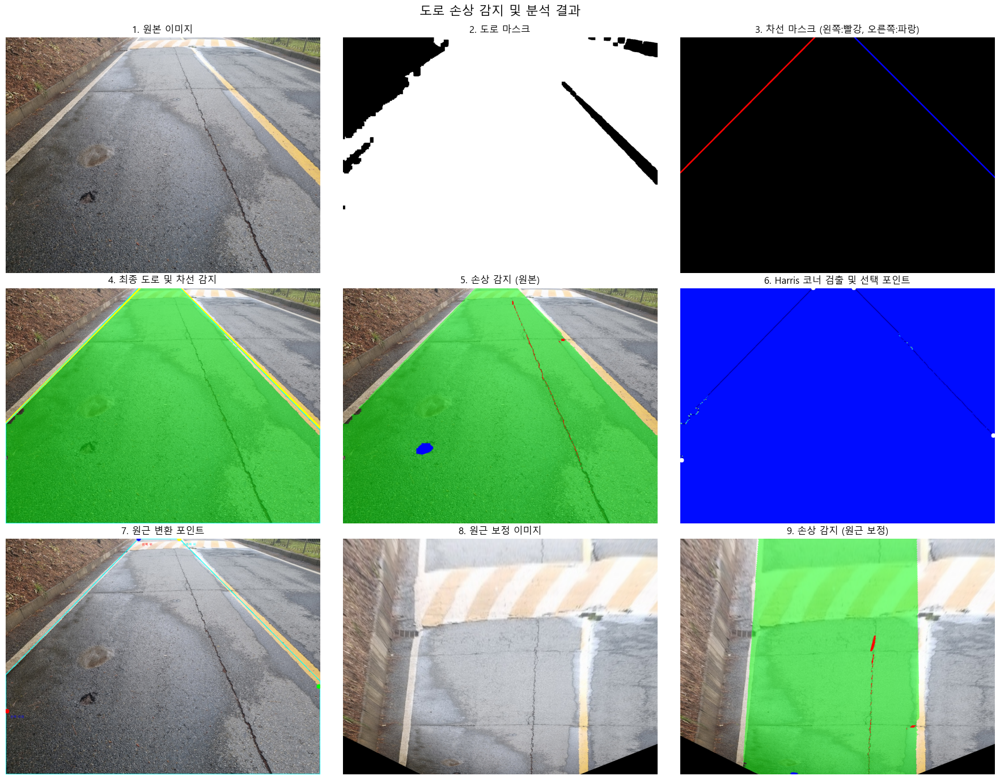


도로 영역 분석 결과:
도로 면적: 1098850 픽셀
균열 면적: 4566 픽셀 (0.42%)
포트홀 면적: 3231 픽셀 (0.29%)
총 손상 면적: 7797 픽셀 (0.71%)

원근 보정된 도로 영역 분석 결과:
도로 면적: 801407 픽셀
균열 면적: 7916 픽셀 (0.99%)
포트홀 면적: 292 픽셀 (0.04%)
총 손상 면적: 8208 픽셀 (1.02%)
분석 결과가 ../result/analysis_result_22.txt에 저장되었습니다.
핵심 이미지가 ../result/key_images_22.jpg에 저장되었습니다.


In [68]:
import cv2
import torch
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO
from sklearn.linear_model import LinearRegression, RANSACRegressor
import matplotlib.font_manager as fm
import platform

def setup_matplotlib_font():
    """
    운영체제별 matplotlib 한글 기본 폰트 설정 함수
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    한글 텍스트를 이미지에 표시하는 함수
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def create_roi_mask(img, use_roi=True, roi_type="trapezoid"):
    """
    관심 영역(ROI) 마스크 생성 함수
    
    Parameters:
        - img (numpy.ndarray): 원본 이미지
        - use_roi (bool): ROI 사용 여부
        - roi_type (str): "trapezoid" 또는 "lower_cut"
        
    Returns:
        - numpy.ndarray: ROI 마스크
    """
    height, width = img.shape[:2]
    roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    if not use_roi:
        return roi_mask
    
    if roi_type == "trapezoid":
        # 사다리꼴 ROI - 일반적인 도로 영역
        roi_points = np.array([
            [width * 0.1, height],              # 좌하단
            [width * 0.9, height],              # 우하단
            [width * 0.7, height * 0.4],        # 우상단
            [width * 0.3, height * 0.4]         # 좌상단
        ], dtype=np.int32)
        
        # 빈 마스크 생성 및 ROI 영역만 255로 채우기
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        cv2.fillPoly(roi_mask, [roi_points], 255)
    
    elif roi_type == "lower_cut":
        # 이미지 하단 30%를 삭제하고 상단 70%만 사용
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        roi_mask[:int(height * 0.7), :] = 255
    
    return roi_mask

def extract_road_mask(img, use_roi=True, roi_mask=None):
    """
    도로 영역 추출 함수
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색, 어두운 회색, 밝은 회색 포함)
    # 넓은 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 60])
    upper_gray_road = np.array([180, 50, 200])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 30])
    upper_dark_road = np.array([180, 30, 120])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 130])
    upper_light_road = np.array([180, 40, 255])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # ROI 적용
    if use_roi:
        road_mask = cv2.bitwise_and(road_mask, roi_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

def detect_lane_lines(img, use_roi=True, roi_mask=None):
    """
    차선 감지 및 마스크 생성 함수
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    color_mask = cv2.bitwise_and(color_mask, color_mask, mask=roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_points = []
    right_points = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                # 각 선분의 두 점을 모두 저장 (RANSAC에 사용)
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    left_points.append((x1, y1))
                    left_points.append((x2, y2))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    right_points.append((x1, y1))
                    right_points.append((x2, y2))
    
    # 확장된 차선 마스크 생성
    extended_left_mask = np.zeros_like(gray)
    extended_right_mask = np.zeros_like(gray)
    
    # RANSAC 알고리즘 적용하여 차선 모델 추정
    # 왼쪽 차선 RANSAC 적용
    if len(left_points) >= 5:  # RANSAC을 적용하기 위한 최소 포인트 수
        left_points = np.array(left_points)
        left_x = left_points[:, 0]
        left_y = left_points[:, 1]
        
        # RANSAC 파라미터 설정
        ransac = RANSACRegressor(
            estimator=LinearRegression(),
            min_samples=5,           # 모델 추정에 사용할 최소 샘플 수
            max_trials=100,          # RANSAC 최대 반복 횟수
            residual_threshold=10.0, # 이상치 판별 임계값
            random_state=42
        )
        
        # 모델 피팅 (y=f(x)가 아닌 x=f(y)로 피팅하여 수직에 가까운 선도 처리)
        try:
            ransac.fit(left_y.reshape(-1, 1), left_x)
            
            # 모델의 신뢰도 확인
            inlier_mask = ransac.inlier_mask_
            if np.sum(inlier_mask) > 5:  # 최소 5개 이상의 인라이어가 있어야 함
                # 차선 연장을 위한 직선 방정식 계산
                # x = m*y + b
                left_slope = ransac.estimator_.coef_[0]
                left_intercept = ransac.estimator_.intercept_
                
                # 화면 하단과 상단에서의 x 좌표 계산
                bottom_y = height
                bottom_x = int(left_slope * bottom_y + left_intercept)
                
                top_y = 0
                top_x = int(left_slope * top_y + left_intercept)
                
                # x 좌표가 화면 범위를 벗어나는지 확인
                if top_x < 0:
                    # x가 0일 때의 y 계산 (역으로 계산)
                    top_y = int((0 - left_intercept) / left_slope)
                    top_x = 0
                elif top_x >= width:
                    top_y = int(((width-1) - left_intercept) / left_slope)
                    top_x = width - 1
                    
                if bottom_x < 0:
                    bottom_y = int((0 - left_intercept) / left_slope)
                    bottom_x = 0
                elif bottom_x >= width:
                    bottom_y = int(((width-1) - left_intercept) / left_slope)
                    bottom_x = width - 1
                
                # 연장된 왼쪽 차선 그리기
                cv2.line(extended_left_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
                
                # 인라이어 포인트 시각화 (선택 사항)
                for i in range(len(left_points)):
                    if inlier_mask[i]:
                        cv2.circle(left_line_mask, (left_x[i], left_y[i]), 3, 127, -1)
        except:
            # RANSAC 피팅 실패 시 기존 방식으로 대체
            pass
    
    # 오른쪽 차선 RANSAC 적용
    if len(right_points) >= 5:
        right_points = np.array(right_points)
        right_x = right_points[:, 0]
        right_y = right_points[:, 1]
        
        # RANSAC 파라미터 설정
        ransac = RANSACRegressor(
            estimator=LinearRegression(),
            min_samples=5,
            max_trials=100,
            residual_threshold=10.0,
            random_state=42
        )
        
        # 모델 피팅
        try:
            ransac.fit(right_y.reshape(-1, 1), right_x)
            
            # 모델의 신뢰도 확인
            inlier_mask = ransac.inlier_mask_
            if np.sum(inlier_mask) > 5:  # 최소 5개 이상의 인라이어가 있어야 함
                # 차선 연장을 위한 직선 방정식 계산
                right_slope = ransac.estimator_.coef_[0]
                right_intercept = ransac.estimator_.intercept_
                
                # 화면 하단과 상단에서의 x 좌표 계산
                bottom_y = height
                bottom_x = int(right_slope * bottom_y + right_intercept)
                
                top_y = 0
                top_x = int(right_slope * top_y + right_intercept)
                
                # x 좌표가 화면 범위를 벗어나는지 확인
                if top_x < 0:
                    top_y = int((0 - right_intercept) / right_slope)
                    top_x = 0
                elif top_x >= width:
                    top_y = int(((width-1) - right_intercept) / right_slope)
                    top_x = width - 1
                    
                if bottom_x < 0:
                    bottom_y = int((0 - right_intercept) / right_slope)
                    bottom_x = 0
                elif bottom_x >= width:
                    bottom_y = int(((width-1) - right_intercept) / right_slope)
                    bottom_x = width - 1
                
                # 연장된 오른쪽 차선 그리기
                cv2.line(extended_right_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
                
                # 인라이어 포인트 시각화 (선택 사항)
                for i in range(len(right_points)):
                    if inlier_mask[i]:
                        cv2.circle(right_line_mask, (right_x[i], right_y[i]), 3, 127, -1)
        except:
            # RANSAC 피팅 실패 시 기존 방식으로 대체
            pass
    
    # 왼쪽/오른쪽 차선 마스크 각각 업데이트
    left_line_mask = cv2.bitwise_or(left_line_mask, extended_left_mask)
    right_line_mask = cv2.bitwise_or(right_line_mask, extended_right_mask)
    
    # 전체 차선 마스크 통합
    lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    lane_mask = cv2.dilate(lane_mask, kernel, iterations=1)
    
    return lane_mask, left_line_mask, right_line_mask, edges, masked_edges

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역 추출 함수
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def get_default_perspective_points(road_polygon, height, width):
    """
    원근 변환을 위한 기본 포인트 설정 함수
    """
    if road_polygon is not None and len(road_polygon) >= 6:
        # road_polygon에서 필요한 포인트 추출
        left_bottom = road_polygon[1]  # 왼쪽 차선 하단
        right_bottom = road_polygon[4] # 오른쪽 차선 하단
        left_top = road_polygon[2]     # 왼쪽 차선 상단
        right_top = road_polygon[3]    # 오른쪽 차선 상단
        
        # 사용할 코너 포인트
        return np.float32([left_bottom, right_bottom, left_top, right_top])
    else:
        # 기본값 설정
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
        
        return np.float32([bottom_left, bottom_right, top_left, top_right])

def perspective_transform(img, mask, road_polygon=None):
    """
    원근 변환 함수
    """
    height, width = mask.shape
    
    # 마스크 전처리: 가우시안 블러로 노이즈 제거 및 코너 검출을 위한 준비
    mask_smooth = cv2.GaussianBlur(mask, (5, 5), 0)
    
    # Harris 코너 검출
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 코너 검출 결과를 이진화하고 팽창 (더 뚜렷하게)
    corners_dilated = cv2.dilate(corners, None)
    _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
    corners_binary = np.uint8(corners_binary)

    # 코너 포인트 좌표 추출
    corner_coords = np.where(corners_binary > 0)
    corner_y = corner_coords[0]
    corner_x = corner_coords[1]
    
    # 모든 코너 좌표를 리스트로 변환
    all_corners = []
    for i in range(len(corner_y)):
        all_corners.append([corner_x[i], corner_y[i]])
    
    # 코너가 충분히 많지 않으면 기본 포인트 사용
    if len(all_corners) < 10:
        src_points = get_default_perspective_points(road_polygon, height, width)
    else:
        # 이미지를 4분할하여 영역별 코너점 찾기
        h_mid = height // 2
        w_mid = width // 2
        
        # 각 영역의 코너 포인트
        top_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] < h_mid]
        top_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] < h_mid]
        bottom_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] >= h_mid]
        bottom_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] >= h_mid]
        
        # 상단 영역에 코너가 없는 경우 기본 포인트 사용
        if not (top_left_corners and top_right_corners):
            src_points = get_default_perspective_points(road_polygon, height, width)
        else:
            # 좌상단과 우상단 선택
            top_left = min(top_left_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
            top_right = min(top_right_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
            
            # 하단 포인트들은 이미지 코너에 가장 가까운 포인트로 선택
            if bottom_left_corners and bottom_right_corners:
                bottom_left = min(bottom_left_corners, key=lambda p: p[0]**2 + (p[1]-height)**2)
                bottom_right = min(bottom_right_corners, key=lambda p: (p[0]-width)**2 + (p[1]-height)**2)
            else:
                # 하단 코너가 충분하지 않으면 윤곽선 기반으로 찾기
                contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                
                if not contours or len(contours) == 0:
                    src_points = get_default_perspective_points(road_polygon, height, width)
                    # dst_points 생성으로 건너뜀
                else:
                    main_contour = max(contours, key=cv2.contourArea)
                    all_points = main_contour.reshape(-1, 2)
                    
                    if len(all_points) == 0:
                        src_points = get_default_perspective_points(road_polygon, height, width)
                        # dst_points 생성으로 건너뜀
                    else:
                        # 왼쪽/오른쪽 하단 포인트 찾기
                        left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
                        right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
                        bottom_left = all_points[left_bottom_idx]
                        bottom_right = all_points[right_bottom_idx]
            
            try:
                # 포인트 검증: y 좌표와 x 좌표가 적절한지 확인
                if (top_left[1] > bottom_left[1] or top_right[1] > bottom_right[1] or
                    top_left[0] > top_right[0] or bottom_left[0] > bottom_right[0]):
                    src_points = get_default_perspective_points(road_polygon, height, width)
                else:
                    # 원근 변환에 사용할 소스 포인트
                    src_points = np.float32([
                        bottom_left,    # 좌하단
                        bottom_right,   # 우하단
                        top_left,       # 좌상단
                        top_right       # 우상단
                    ])
            except:
                src_points = get_default_perspective_points(road_polygon, height, width)
    
    # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [width / 4, height],             # 왼쪽 하단
        [width / 4 * 3, height],         # 오른쪽 하단
        [width / 4, 0],                  # 왼쪽 상단
        [width / 4 * 3, 0]               # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def apply_yolo_on_masked_area(model, img, mask):
    """
    마스크된 영역에서 YOLO 추론 수행 함수
    """
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

def save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, img_num):
    """
    분석 결과를 텍스트 파일로 저장하는 함수
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'analysis_result_{img_num}.txt')
    
    # 결과 작성
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(f"도로 영역 분석 결과:\n")
        f.write(f"도로 면적: {road_area} 픽셀\n")
        f.write(f"균열 면적: {crack_area} 픽셀 ({crack_area/road_area*100:.2f}%)\n")
        f.write(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_area/road_area*100:.2f}%)\n")
        f.write(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_area + pothole_area)/road_area*100:.2f}%)\n\n")
        
        f.write(f"원근 보정된 도로 영역 분석 결과:\n")
        f.write(f"도로 면적: {warped_road_area} 픽셀\n")
        f.write(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_area/warped_road_area*100:.2f}%)\n")
        f.write(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_area/warped_road_area*100:.2f}%)\n")
        f.write(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_area + warped_pothole_area)/warped_road_area*100:.2f}%)\n")
    
    print(f"분석 결과가 {file_path}에 저장되었습니다.")

def save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num):
    """
    핵심 이미지 4개를 하나의 이미지 파일로 저장하는 함수
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'key_images_{img_num}.jpg')
    
    # 2x2 그리드로 이미지 배치
    plt.figure(figsize=(15, 12))
    
    plt.subplot(2, 2, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    plt.subplot(2, 2, 2)
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    plt.subplot(2, 2, 3)
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    plt.subplot(2, 2, 4)
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle(f"도로 손상 분석 결과 (이미지 {img_num})", fontsize=16)
    plt.subplots_adjust(top=0.9)
    
    # 이미지 저장
    plt.savefig(file_path, dpi=300, bbox_inches='tight')
    plt.close()
    
    print(f"핵심 이미지가 {file_path}에 저장되었습니다.")

def visualize_results(original_img, road_mask, lane_mask, left_lane_mask, right_lane_mask, 
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points, 
                     mask_smooth=None, corners=None, img_num=None):
    """
    요청에 맞게 9개 이미지로 결과 시각화 함수
    """
    plt.figure(figsize=(18, 14))
    
    # 1. 원본 이미지
    plt.subplot(3, 3, 1)
    plt.imshow(original_img)
    plt.title('1. 원본 이미지')
    plt.axis('off')
    
    # 2. 도로 마스크
    plt.subplot(3, 3, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('2. 도로 마스크')
    plt.axis('off')
    
    # 3. 차선 마스크(왼쪽, 오른쪽 차선 구분)
    plt.subplot(3, 3, 3)
    lane_combined = np.zeros((original_img.shape[0], original_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('3. 차선 마스크 (왼쪽:빨강, 오른쪽:파랑)')
    plt.axis('off')
    
    # 4. 최종 도로 및 차선 감지
    plt.subplot(3, 3, 4)
    road_overlay = original_img.copy()
    alpha = 0.5
    
    # 도로 영역 반투명 초록색으로 표시
    road_highlight = road_overlay.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    road_overlay = cv2.addWeighted(road_highlight, alpha, road_overlay, 1-alpha, 0)
    
    # 차선 표시
    road_overlay[lane_mask == 255] = [255, 255, 0]  # 차선: 노란색
    
    # 도로 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(road_overlay, [road_polygon], True, (0, 255, 255), 2)
    
    plt.imshow(road_overlay)
    plt.title('4. 최종 도로 및 차선 감지')
    plt.axis('off')
    
    # 5. 손상 감지 (원본)
    plt.subplot(3, 3, 5)
    overlay_original = original_img.copy()
    alpha = 0.5
    road_highlight = overlay_original.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_highlight, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.imshow(overlay_original)
    plt.title('5. 손상 감지 (원본)')
    plt.axis('off')
    
    # 6. Harris 코너 검출 결과 및 선택된 포인트
    plt.subplot(3, 3, 6)
    
    # 코너 검출 결과가 제공되면 표시, 아니면 계산
    if mask_smooth is None or corners is None:
        # 코너 검출 과정 다시 수행
        if road_lane_mask is not None:
            mask_smooth = cv2.GaussianBlur(road_lane_mask, (5, 5), 0)
            corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
            corners_dilated = cv2.dilate(corners, None)
            _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
            corners_binary = np.uint8(corners_binary)
            
            # 코너 시각화
            corner_vis = np.zeros((road_lane_mask.shape[0], road_lane_mask.shape[1], 3), dtype=np.uint8)
            corner_vis[corners_binary > 0] = [0, 255, 255]  # 모든 검출된 코너: 시안색
            
            # 선택된 코너 포인트 강조
            for point in corner_points:
                cv2.circle(corner_vis, (int(point[0]), int(point[1])), 10, [255, 0, 0], -1)
            
            plt.imshow(corner_vis)
        else:
            # road_lane_mask가 없으면 빈 이미지
            plt.imshow(np.zeros_like(original_img))
    else:
        # 제공된 코너 결과 사용
        corners_normalized = cv2.normalize(corners, None, 0, 255, cv2.NORM_MINMAX)
        corners_colored = cv2.applyColorMap(np.uint8(corners_normalized), cv2.COLORMAP_JET)
        
        # 선택된 코너 포인트 강조
        for point in corner_points:
            cv2.circle(corners_colored, (int(point[0]), int(point[1])), 10, [255, 255, 255], -1)
            
        plt.imshow(cv2.cvtColor(corners_colored, cv2.COLOR_BGR2RGB))
    
    plt.title('6. Harris 코너 검출 및 선택 포인트')
    plt.axis('off')
    
    # 7. 원근 변환 포인트
    plt.subplot(3, 3, 7)
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']
    
    # 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(img_with_points, [road_polygon], True, (0, 255, 255), 2)
    
    # 변환 포인트 표시
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    plt.imshow(img_with_points)
    plt.title('7. 원근 변환 포인트')
    plt.axis('off')
    
    # 8. 원근 보정 이미지
    plt.subplot(3, 3, 8)
    plt.imshow(warped_img)
    plt.title('8. 원근 보정 이미지')
    plt.axis('off')
    
    # 9. 손상 감지 (원근 보정)
    plt.subplot(3, 3, 9)
    overlay_warped = warped_img.copy()
    alpha = 0.5
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_warped[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_warped)
    plt.title('9. 손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 결과", fontsize=16)
    plt.subplots_adjust(top=0.94)
    
    # 이미지 번호가 제공된 경우 저장
    if img_num is not None:
        result_dir = '../result/'
        os.makedirs(result_dir, exist_ok=True)
        plt.savefig(os.path.join(result_dir, f'visualization_{img_num}.jpg'), dpi=300, bbox_inches='tight')
    
    plt.show()
    
    # 손상 면적 계산 및 출력
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    print(f"\n도로 영역 분석 결과:")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_area/road_area*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_area/road_area*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_area + pothole_area)/road_area*100:.2f}%)")

    # 원근 보정된 이미지에서의 손상 면적 계산 및 출력
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    print(f"\n원근 보정된 도로 영역 분석 결과:")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_area/warped_road_area*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_area/warped_road_area*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_area + warped_pothole_area)/warped_road_area*100:.2f}%)")

    # 분석 결과 텍스트 파일로 저장
    if img_num is not None:
        save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, img_num)
        
        # 핵심 이미지 저장
        save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num)

def main():
    """
    메인 함수 - 전체 도로 손상 감지 파이프라인을 실행하는 함수
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = '../model/epoch90.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = img_rgb.shape[:2]
    
    # ROI 사용 여부 설정
    use_roi = input("ROI를 사용하시겠습니까? (y/n): ").lower() == 'y'
    
    # ROI 마스크 생성
    if use_roi:
        roi_type = input("ROI 타입을 선택하세요 (1: trapezoid, 2: lower_cut): ")
        roi_type = "trapezoid" if roi_type == "1" else "lower_cut"
        roi_mask = create_roi_mask(img_bgr, use_roi=True, roi_type=roi_type)
        print(f"ROI 타입 '{roi_type}'을(를) 적용했습니다.")
    else:
        roi_mask = None
        print("ROI를 적용하지 않습니다.")
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(img_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, edges, masked_edges = detect_lane_lines(img_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(img_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 코너 검출 결과 계산 (시각화에 사용)
    mask_smooth = cv2.GaussianBlur(road_lane_mask, (5, 5), 0)
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, img_rgb, road_lane_mask)
    
    # 원근 변환 적용 - road_lane_mask를 사용
    warped_img, warped_mask, perspective_matrix, corner_points = perspective_transform(
        img_rgb, road_lane_mask, road_polygon)
    
    # 손상 마스크에도 원근 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
    
    # 결과 시각화 - 코너 검출 결과 포함
    visualize_results(
        img_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, 
        corner_points, mask_smooth, corners, img_num
    )

if __name__ == "__main__":
    main()
    

## 도로 손상 평가 시스템 추가

YOLOv11-seg 모델 '../model/best.pt'을(를) 로드했습니다.
이미지 '../image/test_image_18.jpg'을(를) 로드했습니다.
ROI 타입 'lower_cut'을(를) 적용했습니다.
추정된 픽셀 대 센티미터 비율: 0.2939 cm/pixel

0: 576x1024 7 cracks, 1196.8ms
Speed: 9.9ms preprocess, 1196.8ms inference, 34.2ms postprocess per image at shape (1, 3, 576, 1024)

도로 영역 분석 결과 (원본 이미지):
도로 면적: 1515910 픽셀
균열 면적: 10120 픽셀 (0.67%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 10120 픽셀 (0.67%)

도로 영역 분석 결과 (원근 보정된 이미지):
도로 면적: 1183259 픽셀
균열 면적: 24567 픽셀 (2.08%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 24567 픽셀 (2.08%)
LrPCI 평가 점수: 79.58/100.00 (주의: 경미한 손상 다수, 초기에 균열/요철 발견됨)
최대 포트홀 직경: 0.0cm (응급보수 필요: 아니오)
권장 보수 방법: 예방적 유지관리 및 표층 보수
보수 우선순위: 정기
분석 결과가 ../result/analysis_result_18.txt에 저장되었습니다.
핵심 이미지가 ../result/key_images_18.jpg에 저장되었습니다.
손상 대시보드가 '../result/dashboard_18.jpg'에 저장되었습니다.
종합 평가 보고서가 '../result/report_18.html'에 저장되었습니다.


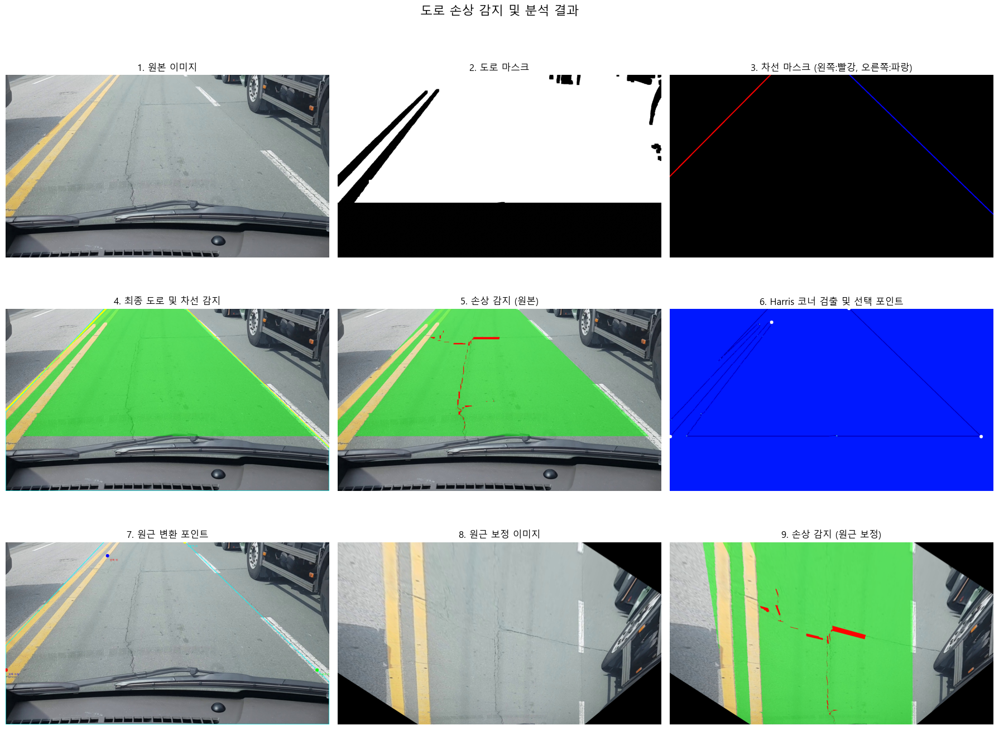

In [ ]:
import cv2
import torch
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO
from sklearn.linear_model import LinearRegression, RANSACRegressor
import matplotlib.font_manager as fm
import platform
from datetime import datetime

def setup_matplotlib_font():
    """
    운영체제별 matplotlib 한글 기본 폰트 설정 함수
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    한글 텍스트를 이미지에 표시하는 함수
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def create_roi_mask(img, use_roi=True, roi_type="trapezoid"):
    """
    관심 영역(ROI) 마스크 생성 함수
    
    Parameters:
        - img (numpy.ndarray): 원본 이미지
        - use_roi (bool): ROI 사용 여부
        - roi_type (str): "trapezoid", "lower_cut", 또는 "middle_strip"
        
    Returns:
        - numpy.ndarray: ROI 마스크
    """
    height, width = img.shape[:2]
    roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    if not use_roi:
        return roi_mask
    
    if roi_type == "trapezoid":
        # 사다리꼴 ROI - 일반적인 도로 영역
        roi_points = np.array([
            [width * 0.1, height],              # 좌하단
            [width * 0.9, height],              # 우하단
            [width * 0.7, height * 0.4],        # 우상단
            [width * 0.3, height * 0.4]         # 좌상단
        ], dtype=np.int32)
        
        # 빈 마스크 생성 및 ROI 영역만 255로 채우기
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        cv2.fillPoly(roi_mask, [roi_points], 255)
    
    elif roi_type == "lower_cut":
        # 이미지 하단 30%를 삭제하고 상단 70%만 사용
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        roi_mask[:int(height * 0.7), :] = 255
    
    elif roi_type == "middle_strip":
        # 상단 40%와 하단 40%를 삭제하고 중간 20%만 사용
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        top_boundary = int(height * 0.4)
        bottom_boundary = int(height * 0.6)
        roi_mask[top_boundary:bottom_boundary, :] = 255
    
    return roi_mask

def extract_road_mask(img, use_roi=True, roi_mask=None):
    """
    도로 영역 추출 함수
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색, 어두운 회색, 밝은 회색 포함)
    # 넓은 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 60])
    upper_gray_road = np.array([180, 50, 200])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 30])
    upper_dark_road = np.array([180, 30, 120])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 130])
    upper_light_road = np.array([180, 40, 255])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # ROI 적용
    if use_roi:
        road_mask = cv2.bitwise_and(road_mask, roi_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

def detect_lane_lines(img, use_roi=True, roi_mask=None):
    """
    차선 감지 및 마스크 생성 함수
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    color_mask = cv2.bitwise_and(color_mask, color_mask, mask=roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_points = []
    right_points = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                # 각 선분의 두 점을 모두 저장 (RANSAC에 사용)
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    left_points.append((x1, y1))
                    left_points.append((x2, y2))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    right_points.append((x1, y1))
                    right_points.append((x2, y2))
    
    # 확장된 차선 마스크 생성
    extended_left_mask = np.zeros_like(gray)
    extended_right_mask = np.zeros_like(gray)
    
    # RANSAC 알고리즘 적용하여 차선 모델 추정
    # 왼쪽 차선 RANSAC 적용
    if len(left_points) >= 5:  # RANSAC을 적용하기 위한 최소 포인트 수
        left_points = np.array(left_points)
        left_x = left_points[:, 0]
        left_y = left_points[:, 1]
        
        # RANSAC 파라미터 설정
        ransac = RANSACRegressor(
            estimator=LinearRegression(),
            min_samples=5,           # 모델 추정에 사용할 최소 샘플 수
            max_trials=100,          # RANSAC 최대 반복 횟수
            residual_threshold=10.0, # 이상치 판별 임계값
            random_state=42
        )
        
        # 모델 피팅 (y=f(x)가 아닌 x=f(y)로 피팅하여 수직에 가까운 선도 처리)
        try:
            ransac.fit(left_y.reshape(-1, 1), left_x)
            
            # 모델의 신뢰도 확인
            inlier_mask = ransac.inlier_mask_
            if np.sum(inlier_mask) > 5:  # 최소 5개 이상의 인라이어가 있어야 함
                # 차선 연장을 위한 직선 방정식 계산
                # x = m*y + b
                left_slope = ransac.estimator_.coef_[0]
                left_intercept = ransac.estimator_.intercept_
                
                # 화면 하단과 상단에서의 x 좌표 계산
                bottom_y = height
                bottom_x = int(left_slope * bottom_y + left_intercept)
                
                top_y = 0
                top_x = int(left_slope * top_y + left_intercept)
                
                # x 좌표가 화면 범위를 벗어나는지 확인
                if top_x < 0:
                    # x가 0일 때의 y 계산 (역으로 계산)
                    top_y = int((0 - left_intercept) / left_slope)
                    top_x = 0
                elif top_x >= width:
                    top_y = int(((width-1) - left_intercept) / left_slope)
                    top_x = width - 1
                    
                if bottom_x < 0:
                    bottom_y = int((0 - left_intercept) / left_slope)
                    bottom_x = 0
                elif bottom_x >= width:
                    bottom_y = int(((width-1) - left_intercept) / left_slope)
                    bottom_x = width - 1
                
                # 연장된 왼쪽 차선 그리기
                cv2.line(extended_left_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
                
                # 인라이어 포인트 시각화 (선택 사항)
                for i in range(len(left_points)):
                    if inlier_mask[i]:
                        cv2.circle(left_line_mask, (left_x[i], left_y[i]), 3, 127, -1)
        except:
            # RANSAC 피팅 실패 시 기존 방식으로 대체
            pass
    
    # 오른쪽 차선 RANSAC 적용
    if len(right_points) >= 5:
        right_points = np.array(right_points)
        right_x = right_points[:, 0]
        right_y = right_points[:, 1]
        
        # RANSAC 파라미터 설정
        ransac = RANSACRegressor(
            estimator=LinearRegression(),
            min_samples=5,
            max_trials=100,
            residual_threshold=10.0,
            random_state=42
        )
        
        # 모델 피팅
        try:
            ransac.fit(right_y.reshape(-1, 1), right_x)
            
            # 모델의 신뢰도 확인
            inlier_mask = ransac.inlier_mask_
            if np.sum(inlier_mask) > 5:  # 최소 5개 이상의 인라이어가 있어야 함
                # 차선 연장을 위한 직선 방정식 계산
                right_slope = ransac.estimator_.coef_[0]
                right_intercept = ransac.estimator_.intercept_
                
                # 화면 하단과 상단에서의 x 좌표 계산
                bottom_y = height
                bottom_x = int(right_slope * bottom_y + right_intercept)
                
                top_y = 0
                top_x = int(right_slope * top_y + right_intercept)
                
                # x 좌표가 화면 범위를 벗어나는지 확인
                if top_x < 0:
                    top_y = int((0 - right_intercept) / right_slope)
                    top_x = 0
                elif top_x >= width:
                    top_y = int(((width-1) - right_intercept) / right_slope)
                    top_x = width - 1
                    
                if bottom_x < 0:
                    bottom_y = int((0 - right_intercept) / right_slope)
                    bottom_x = 0
                elif bottom_x >= width:
                    bottom_y = int(((width-1) - right_intercept) / right_slope)
                    bottom_x = width - 1
                
                # 연장된 오른쪽 차선 그리기
                cv2.line(extended_right_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
                
                # 인라이어 포인트 시각화 (선택 사항)
                for i in range(len(right_points)):
                    if inlier_mask[i]:
                        cv2.circle(right_line_mask, (right_x[i], right_y[i]), 3, 127, -1)
        except:
            # RANSAC 피팅 실패 시 기존 방식으로 대체
            pass
    
    # 왼쪽/오른쪽 차선 마스크 각각 업데이트
    left_line_mask = cv2.bitwise_or(left_line_mask, extended_left_mask)
    right_line_mask = cv2.bitwise_or(right_line_mask, extended_right_mask)
    
    # 전체 차선 마스크 통합
    lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    lane_mask = cv2.dilate(lane_mask, kernel, iterations=1)
    
    return lane_mask, left_line_mask, right_line_mask, edges, masked_edges

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역 추출 함수
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def get_default_perspective_points(road_polygon, height, width):
    """
    원근 변환을 위한 기본 포인트 설정 함수
    """
    if road_polygon is not None and len(road_polygon) >= 6:
        # road_polygon에서 필요한 포인트 추출
        left_bottom = road_polygon[1]  # 왼쪽 차선 하단
        right_bottom = road_polygon[4] # 오른쪽 차선 하단
        left_top = road_polygon[2]     # 왼쪽 차선 상단
        right_top = road_polygon[3]    # 오른쪽 차선 상단
        
        # 사용할 코너 포인트
        return np.float32([left_bottom, right_bottom, left_top, right_top])
    else:
        # 기본값 설정
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
        
        return np.float32([bottom_left, bottom_right, top_left, top_right])

def perspective_transform(img, mask, road_polygon=None):
   """
   원근 변환 함수
   """
   height, width = mask.shape
   
   # 마스크 전처리: 가우시안 블러로 노이즈 제거 및 코너 검출을 위한 준비
   mask_smooth = cv2.GaussianBlur(mask, (5, 5), 0)
   
   # Harris 코너 검출
   corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
   
   # 코너 검출 결과를 이진화하고 팽창 (더 뚜렷하게)
   corners_dilated = cv2.dilate(corners, None)
   _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
   corners_binary = np.uint8(corners_binary)

   # 코너 포인트 좌표 추출
   corner_coords = np.where(corners_binary > 0)
   corner_y = corner_coords[0]
   corner_x = corner_coords[1]
   
   # 모든 코너 좌표를 리스트로 변환
   all_corners = []
   for i in range(len(corner_y)):
       all_corners.append([corner_x[i], corner_y[i]])
   
   # 코너가 충분히 많지 않으면 기본 포인트 사용
   if len(all_corners) < 10:
       src_points = get_default_perspective_points(road_polygon, height, width)
   else:
       # 이미지를 4분할하여 영역별 코너점 찾기
       h_mid = height // 2
       w_mid = width // 2
       
       # 각 영역의 코너 포인트
       top_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] < h_mid]
       top_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] < h_mid]
       bottom_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] >= h_mid]
       bottom_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] >= h_mid]
       
       # 상단 영역에 코너가 없는 경우 기본 포인트 사용
       if not (top_left_corners and top_right_corners):
           src_points = get_default_perspective_points(road_polygon, height, width)
       else:
           # 좌상단과 우상단 선택
           top_left = min(top_left_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
           top_right = min(top_right_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
           
           # 하단 포인트들은 이미지 코너에 가장 가까운 포인트로 선택
           if bottom_left_corners and bottom_right_corners:
               bottom_left = min(bottom_left_corners, key=lambda p: p[0]**2 + (p[1]-height)**2)
               bottom_right = min(bottom_right_corners, key=lambda p: (p[0]-width)**2 + (p[1]-height)**2)
           else:
               # 하단 코너가 충분하지 않으면 윤곽선 기반으로 찾기
               contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
               
               if not contours or len(contours) == 0:
                   src_points = get_default_perspective_points(road_polygon, height, width)
                   # dst_points 생성으로 건너뜀
               else:
                   main_contour = max(contours, key=cv2.contourArea)
                   all_points = main_contour.reshape(-1, 2)
                   
                   if len(all_points) == 0:
                       src_points = get_default_perspective_points(road_polygon, height, width)
                       # dst_points 생성으로 건너뜀
                   else:
                       # 왼쪽/오른쪽 하단 포인트 찾기
                       left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
                       right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
                       bottom_left = all_points[left_bottom_idx]
                       bottom_right = all_points[right_bottom_idx]
           
           try:
               # 포인트 검증: y 좌표와 x 좌표가 적절한지 확인
               if (top_left[1] > bottom_left[1] or top_right[1] > bottom_right[1] or
                   top_left[0] > top_right[0] or bottom_left[0] > bottom_right[0]):
                   src_points = get_default_perspective_points(road_polygon, height, width)
               else:
                   # 원근 변환에 사용할 소스 포인트
                   src_points = np.float32([
                       bottom_left,    # 좌하단
                       bottom_right,   # 우하단
                       top_left,       # 좌상단
                       top_right       # 우상단
                   ])
           except:
               src_points = get_default_perspective_points(road_polygon, height, width)
   
   # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
   dst_points = np.float32([
       [width / 4, height],             # 왼쪽 하단
       [width / 4 * 3, height],         # 오른쪽 하단
       [width / 4, 0],                  # 왼쪽 상단
       [width / 4 * 3, 0]               # 오른쪽 상단
   ])
   
   # 원근 변환 행렬 계산 및 적용
   M = cv2.getPerspectiveTransform(src_points, dst_points)
   warped_img = cv2.warpPerspective(img, M, (width, height))
   warped_mask = cv2.warpPerspective(mask, M, (width, height))
   
   return warped_img, warped_mask, M, src_points

def apply_yolo_on_masked_area(model, img, mask):
   """
   마스크된 영역에서 YOLO 추론 수행 함수
   """
   # 마스크를 3채널로 확장
   mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
   
   # 마스크 적용된 이미지 생성
   masked_img = cv2.bitwise_and(img, mask_3ch)
   
   # YOLO 추론
   results = model(masked_img)
   res = results[0]
   
   # 클래스별 마스크 생성
   mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
   mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
   
   for i, box in enumerate(res.boxes):
       cls = int(box.cls[0])
       if i < len(res.masks):  # 안전하게 인덱스 확인
           single_mask = res.masks.data[i].cpu().numpy()
           binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
           binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
           
           if cls == 0:  # crack
               mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
           elif cls == 1:  # pothole
               mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
   
   return mask_crack, mask_pothole

def calculate_lrpci(crack_ratio, pothole_ratio, crack_severity, crack_type, pothole_info):
    """
    균열율, 포트홀 비율, 균열 심각도 등을 기반으로 LrPCI 계산
    
    Parameters:
        - crack_ratio (float): 0~1 사이의 균열율
        - pothole_ratio (float): 0~1 사이의 포트홀 비율
        - crack_severity (float): 0~1 사이의 균열 심각도
        - crack_type (str): 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_info (dict): 포트홀 정보 (개수, 최대 직경 등)
        
    Returns:
        - float: 0~100 사이의 LrPCI 값
    """
    # 기본값 설정: 완벽한 상태의 도로는 100점에서 시작
    base_score = 100
    
    # 포트홀 감점 계산 (포트홀이 있으면 더 많은 감점)
    pothole_deduction = 0
    if pothole_ratio > 0:
        pothole_count = pothole_info.get('potholes_count', 0)
        max_diameter_cm = pothole_info.get('max_diameter_cm', 0)
        
        # 포트홀 직경에 따른 심각도 분류
        if max_diameter_cm >= 30:  # 심각: 30cm 이상은 심각한 포트홀
            pothole_deduction = 30 + (pothole_count * 2.5)  # 기본 30점 감점, 추가 포트홀당 2.5점 추가 감점
        elif max_diameter_cm >= 15:  # 중간: 15~30cm는 중간 수준
            pothole_deduction = 15 + (pothole_count * 2)    # 기본 15점 감점, 추가 포트홀당 2점 추가 감점
        else:  # 경미: 15cm 미만은 경미한 수준
            pothole_deduction = 5 + (pothole_count * 1.5)   # 기본 5점 감점, 추가 포트홀당 1.5점 추가 감점
            
        # 포트홀 면적 비율이 높으면 추가 감점
        pothole_deduction += pothole_ratio * 100 * 0.3
        
        # 최대 감점은 40점으로 제한
        pothole_deduction = min(pothole_deduction, 40)
    
    # 균열 감점 계산
    crack_deduction = 0
    if crack_ratio > 0:
        # 균열 유형에 따른 가중치 설정
        crack_type_weights = {
            "선형 균열": 1.0,       # 선형 균열은 기본 가중치
            "블록형 균열": 1.5,     # 블록형 균열은 더 심각
            "악어 균열": 2.0,       # 악어 균열은 가장 심각
            "없음": 0
        }
        
        crack_type_weight = crack_type_weights.get(crack_type, 1.0)
        
        # 균열 면적 비율과 심각도, 유형에 따른 감점
        if crack_ratio >= 0.5:  # 50% 이상은 심각
            crack_deduction = 25 * crack_type_weight
        elif crack_ratio >= 0.2:  # 20~50%는 중간
            crack_deduction = 15 * crack_type_weight
        else:  # 20% 미만은 경미
            crack_deduction = 5 * crack_type_weight
            
        # 균열 면적과 심각도에 따른 추가 감점
        crack_deduction += (crack_ratio * 100 * 0.2) + (crack_severity * 10)
        
        # 최대 감점은 25점으로 제한
        crack_deduction = min(crack_deduction, 25)
    
    # 총 감점 계산
    total_deduction = pothole_deduction + crack_deduction
    
    # 최종 LrPCI 계산 (최소값은 0)
    lrpci = max(0, base_score - total_deduction)
    
    return round(lrpci, 2)

def get_lrpci_grade(lrpci):
    """
    LrPCI 점수에 따른 등급 반환
    
    Parameters:
        - lrpci (float): 0~100 사이의 LrPCI 값
        
    Returns:
        - str: 등급 (심각, 위험, 주의, 안전)
        - str: 상세 설명
    """
    if lrpci < 40:
        return "심각", "도로기능 상실, 심한 파손"
    elif lrpci < 60:
        return "위험", "중간 수준 이상 손상, 포트홀 시작, 균열 확산"
    elif lrpci < 80:
        return "주의", "경미한 손상 다수, 초기에 균열/요철 발견됨"
    else:
        return "안전", "양호 상태, 기능 이상 없음"

def determine_repair_method(lrpci, crack_ratio, crack_type, pothole_has_emergency):
    """
    LrPCI와 균열율, 포트홀 응급 상황을 기반으로 보수 방법 결정
    
    Parameters:
        - lrpci (float): 0~100 사이의 LrPCI 값
        - crack_ratio (float): 0~1 사이의 균열율
        - crack_type (str): 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_has_emergency (bool): 응급 보수가 필요한 포트홀이 있는지 여부
        
    Returns:
        - str: 권장 보수 방법
        - str: 보수 우선순위
    """
    # 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    
    # 응급 포트홀이 있는 경우 최우선 처리
    if pothole_has_emergency:
        return "포트홀 응급 보수 후 추가 조사 필요", "최우선(응급)"
    
    # LrPCI 등급 기반 보수 방법
    if grade == "심각":  # 0~39점
        priority = "긴급"
        if crack_type == "악어 균열" or crack_ratio >= 0.5:
            method = "기층까지 20cm 절삭 후 재포장 (구조적 손상 의심)"
        else:
            method = "기층까지 20cm 절삭 후 재포장"
            
    elif grade == "위험":  # 40~59점
        priority = "단기"
        if crack_type == "블록형 균열" or (crack_ratio >= 0.2 and crack_ratio < 0.5):
            method = "중간층 10cm 절삭 후 재포장 (균열 확산 방지 필요)"
        else:
            method = "부분 패치 및 포장 보수"
            
    elif grade == "주의":  # 60~79점
        priority = "정기"
        if crack_type == "선형 균열" and crack_ratio < 0.2:
            method = "균열 실링 및 표층 5cm 절삭 덧씌우기"
        else:
            method = "예방적 유지관리 및 표층 보수"
            
    else:  # 안전, 80~100점
        priority = "모니터링"
        method = "정기 점검 및 모니터링 (현재 보수 불필요)"
    
    return method, priority

def check_pothole_emergency(pothole_mask, pixel_to_cm_ratio=1.0):
    """
    포트홀 마스크를 분석하여 응급 보수가 필요한지 확인
    
    Parameters:
        - pothole_mask (numpy.ndarray): 포트홀 마스크
        - pixel_to_cm_ratio (float): 픽셀 대 센티미터 비율
        
    Returns:
        - bool: 응급 보수 필요 여부
        - dict: 포트홀 정보 (최대 직경, 총 면적 등)
    """
    # 포트홀이 없는 경우
    if np.count_nonzero(pothole_mask) == 0:
        return False, {"max_diameter_cm": 0, "potholes_count": 0, "total_area_cm2": 0}
    
    # 연결 요소 레이블링
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(pothole_mask)
    
    # 배경을 제외한 각 포트홀 분석
    max_diameter_pixels = 0
    total_area_pixels = 0
    potholes_count = num_labels - 1  # 배경 제외
    potholes_data = []
    
    for i in range(1, num_labels):  # 0은 배경
        # 포트홀 너비와 높이
        width = stats[i, cv2.CC_STAT_WIDTH]
        height = stats[i, cv2.CC_STAT_HEIGHT]
        area = stats[i, cv2.CC_STAT_AREA]
        
        # 대략적인 직경 계산 (타원 형태 가정)
        diameter = max(width, height)
        max_diameter_pixels = max(max_diameter_pixels, diameter)
        total_area_pixels += area
        
        # 개별 포트홀 정보 저장
        potholes_data.append({
            "center_x": centroids[i][0],
            "center_y": centroids[i][1],
            "width": width,
            "height": height,
            "area": area,
            "diameter": diameter
        })
    
    # 픽셀을 센티미터로 변환
    max_diameter_cm = max_diameter_pixels * pixel_to_cm_ratio
    total_area_cm2 = total_area_pixels * (pixel_to_cm_ratio ** 2)
    
    # 응급 보수 조건: 직경 30cm 이상 또는 면적이 매우 큰 경우
    is_emergency = max_diameter_cm >= 30 or total_area_cm2 >= 700
    
    # 포트홀 심각도 추정
    if max_diameter_cm >= 30:
        severity = "심각"
    elif max_diameter_cm >= 15:
        severity = "중간"
    else:
        severity = "경미"
    
    return is_emergency, {
        "max_diameter_cm": round(max_diameter_cm, 1),
        "potholes_count": potholes_count,
        "total_area_cm2": round(total_area_cm2, 1),
        "severity": severity,
        "potholes_data": potholes_data
    }

def analyze_crack_severity(crack_mask, pixel_to_cm_ratio=1.0):
    """
    균열 마스크를 분석하여 심각도 평가
    
    Parameters:
        - crack_mask (numpy.ndarray): 균열 마스크
        - pixel_to_cm_ratio (float): 픽셀 대 센티미터 비율
        
    Returns:
        - float: 심각도 점수 (0~1)
        - str: 균열 유형
        - dict: 균열 상세 정보
    """
    # 균열이 없는 경우
    if np.count_nonzero(crack_mask) == 0:
        return 0, "없음", {"total_length_cm": 0, "avg_width_cm": 0, "crack_count": 0}
    
    # 연결 요소 레이블링
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(crack_mask)
    
    # 균열 형태 분석을 위한 변수 초기화
    total_area_pixels = 0
    max_length_pixels = 0
    total_max_length_pixels = 0
    crack_widths_pixels = []
    aspect_ratios = []
    crack_count = num_labels - 1  # 배경 제외
    
    for i in range(1, num_labels):  # 0은 배경
        area = stats[i, cv2.CC_STAT_AREA]
        width = stats[i, cv2.CC_STAT_WIDTH]
        height = stats[i, cv2.CC_STAT_HEIGHT]
        
        total_area_pixels += area
        
        # 균열의 실제 길이 추정 (단순 근사: 긴 쪽이 길이)
        length = max(width, height)
        max_length_pixels = max(max_length_pixels, length)
        total_max_length_pixels += length
        
        # 균열 폭 추정
        aspect_ratio = max(width, height) / (min(width, height) if min(width, height) > 0 else 1)
        aspect_ratios.append(aspect_ratio)
        
        # 선형 균열로 판단되는 경우 폭 추정
        if aspect_ratio > 3:  # 선형 균열로 판단
            est_width = min(width, height)
            crack_widths_pixels.append(est_width)
    
    # 균열의 평균 폭 계산
    avg_width_pixels = np.mean(crack_widths_pixels) if crack_widths_pixels else 1
    
    # 픽셀 단위를 센티미터 단위로 변환
    total_length_cm = total_max_length_pixels * pixel_to_cm_ratio
    max_length_cm = max_length_pixels * pixel_to_cm_ratio
    avg_width_cm = avg_width_pixels * pixel_to_cm_ratio
    
    # 균열 유형 결정
    if len(aspect_ratios) == 0:
        crack_type = "없음"
        severity = 0
    elif np.mean(aspect_ratios) > 5:
        crack_type = "선형 균열"
        # 선형 균열의 심각도는 길이와 폭에 비례
        severity = min(1.0, (max_length_cm / 100) * (avg_width_cm / 2))
    elif np.std(aspect_ratios) < 1.5 and len(aspect_ratios) > 5:
        crack_type = "악어 균열"
        # 악어 균열은 일반적으로 심각도가 높음
        severity = min(1.0, 0.7 + (total_area_pixels * (pixel_to_cm_ratio ** 2) / 2000) * 0.3)
    else:
        crack_type = "블록형 균열"
        # 블록형 균열의 심각도는 균열 간 연결성과 전체 면적에 비례
        severity = min(1.0, 0.4 + (total_area_pixels * (pixel_to_cm_ratio ** 2) / 1000) * 0.6)
    
    # 심각도 등급 분류
    if severity >= 0.7:
        severity_grade = "심각"
    elif severity >= 0.4:
        severity_grade = "중간"
    else:
        severity_grade = "경미"
    
    return severity, crack_type, {
        "total_length_cm": round(total_length_cm, 1),
        "max_length_cm": round(max_length_cm, 1),
        "avg_width_cm": round(avg_width_cm, 2),
        "crack_count": crack_count,
        "severity_grade": severity_grade
    }

def estimate_pixel_to_cm_ratio(left_lane_mask, right_lane_mask, standard_lane_width_cm=350):
   """
   차선 폭을 기반으로 픽셀 대 센티미터 비율 추정
   
   Parameters:
       - left_lane_mask (numpy.ndarray): 왼쪽 차선 마스크
       - right_lane_mask (numpy.ndarray): 오른쪽 차선 마스크
       - standard_lane_width_cm (float): 표준 차선 폭(cm), 기본값 350cm (3.5m)
       
   Returns:
       - float: 픽셀 대 센티미터 비율
   """
   # 차선 마스크가 유효하지 않은 경우
   if np.count_nonzero(left_lane_mask) == 0 or np.count_nonzero(right_lane_mask) == 0:
       return 1.0  # 기본값 반환
   
   # 각 차선의 중심선 추출
   left_indices = np.where(left_lane_mask > 0)
   right_indices = np.where(right_lane_mask > 0)
   
   if len(left_indices[1]) == 0 or len(right_indices[1]) == 0:
       return 1.0
   
   # 각 차선의 중심 좌표 계산
   left_center_x = np.mean(left_indices[1])
   right_center_x = np.mean(right_indices[1])
   
   # 차선 간 거리 계산 (픽셀)
   lane_width_pixels = right_center_x - left_center_x
   
   if lane_width_pixels <= 0:
       return 1.0  # 유효하지 않은 경우 기본값 반환
   
   # 픽셀 대 센티미터 비율 계산
   pixel_to_cm_ratio = standard_lane_width_cm / lane_width_pixels
   
   return pixel_to_cm_ratio

def create_damage_dashboard(lrpci, crack_ratio, pothole_ratio, crack_severity, crack_type, crack_info, pothole_info, repair_method, priority, img_num):
    """
    손상 분석 결과를 시각적으로 표현하는 대시보드 생성
    
    Parameters:
        - lrpci (float): LrPCI 점수 (0~100)
        - crack_ratio (float): 균열율
        - pothole_ratio (float): 포트홀 비율
        - crack_severity (float): 균열 심각도
        - crack_type (str): 균열 유형
        - crack_info (dict): 균열 상세 정보
        - pothole_info (dict): 포트홀 정보
        - repair_method (str): 권장 보수 방법
        - priority (str): 보수 우선순위
        - img_num (str): 이미지 번호
    """
    plt.figure(figsize=(12, 10))
    
    # 1. LrPCI 게이지 차트
    plt.subplot(2, 2, 1)
    gauge_colors = ['#FF4444', '#FFAA44', '#FFDD44', '#44AA44']  # 심각, 위험, 주의, 안전
    
    # 게이지 배경 그리기
    gauge_bg = plt.matplotlib.patches.Wedge(
        center=(0.5, 0.5), r=0.4, 
        theta1=180, theta2=0, 
        width=0.1, 
        facecolor='lightgray',
        edgecolor='gray'
    )
    plt.gca().add_patch(gauge_bg)
    
    # LrPCI 값 기반으로 게이지 그리기
    lrpci_angle = 180 - (lrpci / 100) * 180  # 0~100 범위로 변경
    
    # LrPCI 등급에 따른 색상 선택
    if lrpci < 40:
        lrpci_color = gauge_colors[0]  # 심각
        grade = "심각"
    elif lrpci < 60:
        lrpci_color = gauge_colors[1]  # 위험
        grade = "위험"
    elif lrpci < 80:
        lrpci_color = gauge_colors[2]  # 주의
        grade = "주의"
    else:
        lrpci_color = gauge_colors[3]  # 안전
        grade = "안전"
    
    gauge = plt.matplotlib.patches.Wedge(
        center=(0.5, 0.5), r=0.4, 
        theta1=180, theta2=lrpci_angle, 
        width=0.1, 
        facecolor=lrpci_color,
        edgecolor='none'
    )
    plt.gca().add_patch(gauge)
    
    # 텍스트 추가
    plt.text(0.5, 0.2, f'LrPCI: {lrpci:.2f}/100', 
            horizontalalignment='center', fontsize=14, fontweight='bold')
    
    # 등급에 따른 상태 설명
    status_map = {
        "심각": "심각 (긴급 보수)",
        "위험": "위험 (단기 보수)",
        "주의": "주의 (정기 점검)",
        "안전": "안전 (모니터링)"
    }
    
    plt.text(0.5, 0.1, status_map[grade], horizontalalignment='center', fontsize=12)
    
    # 게이지 눈금 추가
    for i in range(0, 101, 10):  # 0에서 100까지 10 단위로
        angle = 180 - (i / 100) * 180
        rad = np.radians(angle)
        x = 0.5 + 0.45 * np.cos(rad)
        y = 0.5 + 0.45 * np.sin(rad)
        x2 = 0.5 + 0.42 * np.cos(rad)
        y2 = 0.5 + 0.42 * np.sin(rad)
        plt.plot([x, x2], [y, y2], 'k-', linewidth=1)
        
        if i % 20 == 0:  # 20점 단위로 숫자 표시
            x_text = 0.5 + 0.5 * np.cos(rad)
            y_text = 0.5 + 0.5 * np.sin(rad)
            plt.text(x_text, y_text, str(i), horizontalalignment='center', verticalalignment='center', fontsize=8)
    
    # 등급 구분선 표시
    for grade_value in [40, 60, 80]:
        angle = 180 - (grade_value / 100) * 180
        rad = np.radians(angle)
        x = 0.5 + 0.45 * np.cos(rad)
        y = 0.5 + 0.45 * np.sin(rad)
        x2 = 0.5 + 0.42 * np.cos(rad)
        y2 = 0.5 + 0.42 * np.sin(rad)
        plt.plot([x, x2], [y, y2], 'r-', linewidth=2)
    
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.axis('off')
    plt.title('도로 상태 평가', fontsize=14)
    
    # 2. 손상 유형 및 비율 파이 차트
    plt.subplot(2, 2, 2)
    labels = ['정상', '균열', '포트홀']
    sizes = [1 - crack_ratio - pothole_ratio, crack_ratio, pothole_ratio]
    colors = ['#44AA44', '#FF8800', '#FF4444']
    explode = (0, 0.1, 0.1)  # 손상 부분 강조
    
    wedges, texts, autotexts = plt.pie(
        sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%',
        shadow=True, startangle=90)
    
    # 텍스트 스타일 조정
    for text in texts:
        text.set_fontsize(10)
    for autotext in autotexts:
        autotext.set_fontsize(9)
        autotext.set_fontweight('bold')
    
    plt.axis('equal')
    plt.title('손상 유형 및 비율', fontsize=14)
    
    # 3. 균열 분석 정보
    plt.subplot(2, 2, 3)
    plt.axis('off')
    
    crack_info_text = (
        f"균열 분석 정보\n"
        f"------------------------\n"
        f"균열 유형: {crack_type}\n"
        f"균열 면적 비율: {crack_ratio*100:.2f}%\n"
        f"균열 심각도: {crack_severity*100:.1f}% ({crack_info.get('severity_grade', '알 수 없음')})\n"
        f"균열 길이: {crack_info.get('total_length_cm', 0):.1f}cm\n"
        f"균열 평균 폭: {crack_info.get('avg_width_cm', 0):.2f}cm\n\n"
        f"포트홀 정보\n"
        f"------------------------\n"
        f"포트홀 개수: {pothole_info['potholes_count']}개\n"
        f"최대 포트홀 직경: {pothole_info['max_diameter_cm']:.1f}cm\n"
        f"포트홀 면적 비율: {pothole_ratio*100:.2f}%\n"
        f"포트홀 심각도: {pothole_info.get('severity', '알 수 없음')}\n"
        f"응급 보수 필요: {'예' if pothole_info['max_diameter_cm'] >= 30 else '아니오'}"
    )
    
    plt.text(0.1, 0.9, crack_info_text, fontsize=12, va='top', linespacing=1.5)
    
    # 4. 보수 권고사항
    plt.subplot(2, 2, 4)
    plt.axis('off')
    
    repair_info_text = (
        f"보수 권고사항\n"
        f"========================\n"
        f"권장 보수: {repair_method}\n"
        f"우선순위: {priority}\n\n"
        f"LrPCI 등급 기준\n"
        f"------------------------\n"
        f"심각 (0~39): 긴급 보수 필요\n"
        f"위험 (40~59): 단기 유지보수 필요\n"
        f"주의 (60~79): 정기 점검 및 예방정비\n"
        f"안전 (80~100): 정기 모니터링만 수행\n\n"
        f"손상 유형별 감점 기준\n"
        f"------------------------\n"
        f"포트홀(심각): -30~-40점\n"
        f"블록형 균열(중간): -15~-25점\n"
        f"선형 균열(경미): -5~-15점\n"
        f"마모, 박리(경미): -5점 이하"
    )
    
    plt.text(0.1, 0.9, repair_info_text, fontsize=12, va='top', linespacing=1.5)
    
    plt.tight_layout()
    plt.suptitle(f"도로 손상 상태 대시보드 - 이미지 {img_num}", fontsize=16, y=0.98)
    
    # 결과 저장
    result_dir = '../result/'
    os.makedirs(result_dir, exist_ok=True)
    plt.savefig(os.path.join(result_dir, f'dashboard_{img_num}.jpg'), dpi=300, bbox_inches='tight')
    plt.close()
    
    print(f"손상 대시보드가 '../result/dashboard_{img_num}.jpg'에 저장되었습니다.")

def generate_report(img_num, original_img, overlay_original, img_with_points, overlay_warped,
                   lrpci, crack_ratio, pothole_ratio, crack_severity, crack_type,
                   crack_info, pothole_info, repair_method, priority, is_warped_based=True):
    """
    종합 평가 보고서 생성 함수
    
    Parameters:
        - img_num (str): 이미지 번호
        - original_img, overlay_original, img_with_points, overlay_warped: 이미지들
        - lrpci (float): LrPCI 점수
        - crack_ratio (float): 균열율
        - pothole_ratio (float): 포트홀 비율
        - crack_severity (float): 균열 심각도
        - crack_type (str): 균열 유형
        - crack_info (dict): 균열 상세 정보
        - pothole_info (dict): 포트홀 정보
        - repair_method (str): 권장 보수 방법
        - priority (str): 보수 우선순위
        - is_warped_based (bool): 원근 보정 이미지 기반 분석 여부
    """
    # 결과 저장 경로
    result_dir = '../result/'
    os.makedirs(result_dir, exist_ok=True)
    
    # 이미지 파일 경로
    img_paths = {
        'original': os.path.join(result_dir, f'report_original_{img_num}.jpg'),
        'overlay': os.path.join(result_dir, f'report_overlay_{img_num}.jpg'),
        'points': os.path.join(result_dir, f'report_points_{img_num}.jpg'),
        'warped': os.path.join(result_dir, f'report_warped_{img_num}.jpg'),
        'dashboard': os.path.join(result_dir, f'dashboard_{img_num}.jpg')
    }
    
    # 이미지 저장
    cv2.imwrite(img_paths['original'], cv2.cvtColor(original_img, cv2.COLOR_RGB2BGR))
    cv2.imwrite(img_paths['overlay'], cv2.cvtColor(overlay_original, cv2.COLOR_RGB2BGR))
    cv2.imwrite(img_paths['points'], cv2.cvtColor(img_with_points, cv2.COLOR_RGB2BGR))
    cv2.imwrite(img_paths['warped'], cv2.cvtColor(overlay_warped, cv2.COLOR_RGB2BGR))
    
    # 등급 결정
    if lrpci < 40:
        condition_class = "심각"
        condition_color = "#FF4444"
    elif lrpci < 60:
        condition_class = "위험"
        condition_color = "#FFAA44"
    elif lrpci < 80:
        condition_class = "주의"
        condition_color = "#FFDD44"
    else:
        condition_class = "안전"
        condition_color = "#44AA44"
    
    # 현재 날짜
    report_date = datetime.now().strftime("%Y년 %m월 %d일")
    
    # HTML 보고서 생성
    html_content = f"""
    <!DOCTYPE html>
    <html lang="ko">
    <head>
        <meta charset="UTF-8">
        <meta name="viewport" content="width=device-width, initial-scale=1.0">
        <title>도로 손상 평가 보고서 - 이미지 {img_num}</title>
        <style>
            body {{
                font-family: 'Malgun Gothic', Arial, sans-serif;
                max-width: 1200px;
                margin: 0 auto;
                padding: 20px;
                color: #333;
            }}
            .header {{
                text-align: center;
                margin-bottom: 30px;
                border-bottom: 2px solid #ddd;
                padding-bottom: 20px;
            }}
            .report-info {{
                display: flex;
                justify-content: space-between;
                margin-bottom: 20px;
            }}
            .summary-box {{
                border: 1px solid #ddd;
                border-radius: 5px;
                padding: 15px;
                margin-bottom: 20px;
                background-color: #f9f9f9;
            }}
            .condition {{
                font-size: 24px;
                font-weight: bold;
                color: {condition_color};
                border: 2px solid {condition_color};
                border-radius: 5px;
                padding: 5px 10px;
                display: inline-block;
            }}
            .image-section {{
                display: grid;
                grid-template-columns: 1fr 1fr;
                gap: 20px;
                margin: 20px 0;
            }}
            .image-container {{
                border: 1px solid #ddd;
                padding: 10px;
                border-radius: 5px;
            }}
            .image-container img {{
                width: 100%;
                height: auto;
                border-radius: 3px;
            }}
            .image-title {{
                text-align: center;
                font-weight: bold;
                margin-top: 10px;
                font-size: 14px;
            }}
            table {{
                width: 100%;
                border-collapse: collapse;
                margin: 20px 0;
            }}
            table, th, td {{
                border: 1px solid #ddd;
            }}
            th, td {{
                padding: 10px;
                text-align: left;
            }}
            th {{
                background-color: #f2f2f2;
            }}
            .dashboard {{
                margin: 30px 0;
                text-align: center;
            }}
            .dashboard img {{
                max-width: 100%;
                height: auto;
            }}
            .footer {{
                text-align: center;
                margin-top: 40px;
                border-top: 1px solid #ddd;
                padding-top: 20px;
                font-size: 12px;
                color: #777;
            }}
        </style>
    </head>
    <body>
        <div class="header">
            <h1>도로 손상 평가 보고서</h1>
            <p>이미지 ID: {img_num} | 분석 일자: {report_date}</p>
            <p><strong>분석 기준: {'원근 보정된 이미지 기반' if is_warped_based else '원본 이미지 기반'}</strong></p>
        </div>
       
        <div class="report-info">
            <div>
                <h2>평가 결과 요약</h2>
                <p>LrPCI 점수: <strong>{lrpci:.2f}/100.00</strong></p>
            </div>
            <div>
                <h3>도로 상태 등급</h3>
                <div class="condition">{condition_class}</div>
            </div>
        </div>
       
        <div class="summary-box">
            <h3>손상 요약</h3>
            <p>균열 면적 비율: <strong>{crack_ratio*100:.2f}%</strong> | 균열 유형: <strong>{crack_type}</strong> | 균열 심각도: <strong>{crack_severity*100:.1f}%</strong></p>
            <p>균열 길이: <strong>{crack_info.get('total_length_cm', 0):.1f}cm</strong> | 균열 평균 폭: <strong>{crack_info.get('avg_width_cm', 0):.2f}cm</strong></p>
            <p>포트홀 면적 비율: <strong>{pothole_ratio*100:.2f}%</strong> | 포트홀 개수: <strong>{pothole_info['potholes_count']}개</strong> | 최대 직경: <strong>{pothole_info['max_diameter_cm']:.1f}cm</strong></p>
            <p>권장 보수 방법: <strong>{repair_method}</strong></p>
            <p>보수 우선순위: <strong>{priority}</strong></p>
        </div>
       
        <div class="image-section">
            <div class="image-container">
                <img src="{os.path.basename(img_paths['original'])}" alt="원본 이미지">
                <div class="image-title">원본 이미지</div>
            </div>
            <div class="image-container">
                <img src="{os.path.basename(img_paths['overlay'])}" alt="손상 감지 시각화">
                <div class="image-title">손상 감지 (빨강: 균열, 파랑: 포트홀)</div>
            </div>
            <div class="image-container">
                <img src="{os.path.basename(img_paths['points'])}" alt="원근 변환 포인트">
                <div class="image-title">원근 변환 포인트</div>
            </div>
            <div class="image-container">
                <img src="{os.path.basename(img_paths['warped'])}" alt="원근 보정 이미지">
                <div class="image-title">원근 보정된 손상 감지</div>
            </div>
        </div>
       
        <h3>상세 분석 결과</h3>
        <table>
            <tr>
                <th>평가 항목</th>
                <th>수치</th>
                <th>상태</th>
            </tr>
            <tr>
                <td>LrPCI 점수</td>
                <td>{lrpci:.2f}/100.00</td>
                <td>{"심각 (긴급 보수 필요)" if lrpci < 40 else "위험 (단기 보수 필요)" if lrpci < 60 else "주의 (정기 점검 필요)" if lrpci < 80 else "안전 (유지관리)"}</td>
            </tr>
            <tr>
                <td>균열 비율</td>
                <td>{crack_ratio*100:.2f}%</td>
                <td>{"심각 (기층 재포장)" if crack_ratio >= 0.5 else "중간 (중간층 재포장)" if crack_ratio >= 0.2 else "경미 (표층 덧씌우기)"}</td>
            </tr>
            <tr>
                <td>포트홀 상태</td>
                <td>최대 직경 {pothole_info['max_diameter_cm']:.1f}cm</td>
                <td>{"응급 보수 필요" if pothole_info['max_diameter_cm'] >= 30 else "일반 관찰 대상"}</td>
            </tr>
        </table>
       
        <div class="dashboard">
            <h3>손상 상태 대시보드</h3>
            <img src="{os.path.basename(img_paths['dashboard'])}" alt="손상 상태 대시보드">
        </div>
       
        <div class="footer">
            <p>본 보고서는 AI 기반 도로 손상 감지 시스템에 의해 자동 생성되었습니다.</p>
            <p>© 2025 도로 포장 상태 평가 및 관리 시스템</p>
        </div>
    </body>
    </html>
    """
    
    # HTML 파일 저장
    report_path = os.path.join(result_dir, f'report_{img_num}.html')
    with open(report_path, 'w', encoding='utf-8') as f:
        f.write(html_content)
    
    print(f"종합 평가 보고서가 '{report_path}'에 저장되었습니다.")

def save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
                          lrpci, crack_info, pothole_info, repair_method, priority, img_num, is_warped_based=True):
    """
    분석 결과를 텍스트 파일로 저장하는 함수
    
    Parameters:
        - road_area, crack_area, pothole_area: 원본 이미지 영역 크기(픽셀)
        - warped_* : 원근 보정 이미지 영역 크기(픽셀)
        - lrpci (float): LrPCI 점수
        - crack_info (dict): 균열 상세 정보
        - pothole_info (dict): 포트홀 정보
        - repair_method (str): 권장 보수 방법
        - priority (str): 보수 우선순위
        - img_num (str): 이미지 번호
        - is_warped_based (bool): LrPCI 계산 등이 원근 보정 이미지 기반인지 여부
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'analysis_result_{img_num}.txt')
    
    # 균열률과 포트홀 비율 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    
    # 원근 보정된 이미지의 손상 비율 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    
    # LrPCI 등급 획득
    grade, description = get_lrpci_grade(lrpci)
    
    # 결과 작성
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(f"도로 영역 분석 결과 (원본 이미지):\n")
        f.write(f"도로 면적: {road_area} 픽셀\n")
        f.write(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)\n")
        f.write(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)\n")
        f.write(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_ratio + pothole_ratio)*100:.2f}%)\n\n")
        
        f.write(f"도로 영역 분석 결과 (원근 보정된 이미지):\n")
        f.write(f"도로 면적: {warped_road_area} 픽셀\n")
        f.write(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)\n")
        f.write(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)\n")
        f.write(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_ratio + warped_pothole_ratio)*100:.2f}%)\n\n")
        
        f.write(f"평가 결과 - {'원근 보정된 이미지 기반' if is_warped_based else '원본 이미지 기반'}:\n")
        f.write(f"LrPCI 평가 점수: {lrpci}/100.00\n")
        f.write(f"LrPCI 등급: {grade} ({description})\n")
        
        # 균열 정보 출력
        if crack_info:
            f.write(f"균열 길이: {crack_info.get('total_length_cm', 0):.1f}cm\n")
            f.write(f"균열 최대 길이: {crack_info.get('max_length_cm', 0):.1f}cm\n")
            f.write(f"균열 평균 폭: {crack_info.get('avg_width_cm', 0):.2f}cm\n")
            f.write(f"균열 개수: {crack_info.get('crack_count', 0)}개\n")
            f.write(f"균열 심각도 등급: {crack_info.get('severity_grade', '알 수 없음')}\n")
        
        # 포트홀 정보 출력
        f.write(f"최대 포트홀 직경: {pothole_info.get('max_diameter_cm', 0):.1f}cm\n")
        f.write(f"포트홀 개수: {pothole_info.get('potholes_count', 0)}개\n")
        f.write(f"포트홀 총 면적: {pothole_info.get('total_area_cm2', 0):.1f}cm²\n")
        f.write(f"포트홀 심각도: {pothole_info.get('severity', '알 수 없음')}\n\n")
        
        f.write(f"권장 보수 방법: {repair_method}\n")
        f.write(f"보수 우선순위: {priority}\n")
    
    print(f"분석 결과가 {file_path}에 저장되었습니다.")

def save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num):
   """
   핵심 이미지 4개를 하나의 이미지 파일로 저장하는 함수
   """
   # 결과 저장 경로
   result_dir = '../result/'
   
   # 디렉토리가 없으면 생성
   os.makedirs(result_dir, exist_ok=True)
   
   # 파일 경로 설정
   file_path = os.path.join(result_dir, f'key_images_{img_num}.jpg')
   
   # 2x2 그리드로 이미지 배치
   plt.figure(figsize=(15, 12))
   
   plt.subplot(2, 2, 1)
   plt.imshow(original_img)
   plt.title('원본 이미지')
   plt.axis('off')
   
   plt.subplot(2, 2, 2)
   plt.imshow(overlay_original)
   plt.title('손상 감지 (원본)')
   plt.axis('off')
   
   plt.subplot(2, 2, 3)
   plt.imshow(img_with_points)
   plt.title('원근 변환 포인트')
   plt.axis('off')
   
   plt.subplot(2, 2, 4)
   plt.imshow(overlay_warped)
   plt.title('손상 감지 (원근 보정)')
   plt.axis('off')
   
   plt.tight_layout()
   plt.suptitle(f"도로 손상 분석 결과 (이미지 {img_num})", fontsize=16)
   plt.subplots_adjust(top=0.9)
   
   # 이미지 저장
   plt.savefig(file_path, dpi=300, bbox_inches='tight')
   plt.close()
   
   print(f"핵심 이미지가 {file_path}에 저장되었습니다.")

def visualize_results(original_img, road_mask, lane_mask, left_lane_mask, right_lane_mask, 
                    road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                    warped_img, warped_mask, warped_crack, warped_pothole, corner_points, 
                    mask_smooth=None, corners=None, img_num=None, pixel_to_cm_ratio=1.0):
    """
    요청에 맞게 9개 이미지로 결과 시각화 함수
    """
    plt.figure(figsize=(18, 14))
   
    # 1. 원본 이미지
    plt.subplot(3, 3, 1)
    plt.imshow(original_img)
    plt.title('1. 원본 이미지')
    plt.axis('off')
    
    # 2. 도로 마스크
    plt.subplot(3, 3, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('2. 도로 마스크')
    plt.axis('off')
    
    # 3. 차선 마스크(왼쪽, 오른쪽 차선 구분)
    plt.subplot(3, 3, 3)
    lane_combined = np.zeros((original_img.shape[0], original_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('3. 차선 마스크 (왼쪽:빨강, 오른쪽:파랑)')
    plt.axis('off')
    
    # 4. 최종 도로 및 차선 감지
    plt.subplot(3, 3, 4)
    road_overlay = original_img.copy()
    alpha = 0.5
    
    # 도로 영역 반투명 초록색으로 표시
    road_highlight = road_overlay.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    road_overlay = cv2.addWeighted(road_highlight, alpha, road_overlay, 1-alpha, 0)
    
    # 차선 표시
    road_overlay[lane_mask == 255] = [255, 255, 0]  # 차선: 노란색
    
    # 도로 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(road_overlay, [road_polygon], True, (0, 255, 255), 2)
    
    plt.imshow(road_overlay)
    plt.title('4. 최종 도로 및 차선 감지')
    plt.axis('off')
    
    # 5. 손상 감지 (원본)
    plt.subplot(3, 3, 5)
    overlay_original = original_img.copy()
    alpha = 0.5
    road_highlight = overlay_original.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_highlight, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.imshow(overlay_original)
    plt.title('5. 손상 감지 (원본)')
    plt.axis('off')
    
    # 6. Harris 코너 검출 결과 및 선택된 포인트
    plt.subplot(3, 3, 6)
    
    # 코너 검출 결과가 제공되면 표시, 아니면 계산
    if mask_smooth is None or corners is None:
        # 코너 검출 과정 다시 수행
        if road_lane_mask is not None:
            mask_smooth = cv2.GaussianBlur(road_lane_mask, (5, 5), 0)
            corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
            corners_dilated = cv2.dilate(corners, None)
            _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
            corners_binary = np.uint8(corners_binary)
            
            # 코너 시각화
            corner_vis = np.zeros((road_lane_mask.shape[0], road_lane_mask.shape[1], 3), dtype=np.uint8)
            corner_vis[corners_binary > 0] = [0, 255, 255]  # 모든 검출된 코너: 시안색
            
            # 선택된 코너 포인트 강조
            for point in corner_points:
                cv2.circle(corner_vis, (int(point[0]), int(point[1])), 10, [255, 0, 0], -1)
            
            plt.imshow(corner_vis)
        else:
            # road_lane_mask가 없으면 빈 이미지
            plt.imshow(np.zeros_like(original_img))
    else:
        # 제공된 코너 결과 사용
        corners_normalized = cv2.normalize(corners, None, 0, 255, cv2.NORM_MINMAX)
        corners_colored = cv2.applyColorMap(np.uint8(corners_normalized), cv2.COLORMAP_JET)
        
        # 선택된 코너 포인트 강조
        for point in corner_points:
            cv2.circle(corners_colored, (int(point[0]), int(point[1])), 10, [255, 255, 255], -1)
            
        plt.imshow(cv2.cvtColor(corners_colored, cv2.COLOR_BGR2RGB))
    
    plt.title('6. Harris 코너 검출 및 선택 포인트')
    plt.axis('off')
    
    # 7. 원근 변환 포인트
    plt.subplot(3, 3, 7)
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']
    
    # 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(img_with_points, [road_polygon], True, (0, 255, 255), 2)
    
    # 변환 포인트 표시
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    plt.imshow(img_with_points)
    plt.title('7. 원근 변환 포인트')
    plt.axis('off')
    
    # 8. 원근 보정 이미지
    plt.subplot(3, 3, 8)
    plt.imshow(warped_img)
    plt.title('8. 원근 보정 이미지')
    plt.axis('off')
    
    # 9. 손상 감지 (원근 보정)
    plt.subplot(3, 3, 9)
    overlay_warped = warped_img.copy()
    alpha = 0.5
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_warped[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_warped)
    plt.title('9. 손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 결과", fontsize=16)
    plt.subplots_adjust(top=0.94)
    
    # 원본 이미지에서의 손상 면적 계산
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    # 원본 이미지의 손상률 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    total_damage_ratio = crack_ratio + pothole_ratio
    
    # 원근 보정된 이미지에서의 손상 면적 계산
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    # 원근 보정된 이미지의 손상률 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    warped_total_damage_ratio = warped_crack_ratio + warped_pothole_ratio
    
    # 균열 심각도 분석 - 원근 보정된 이미지 사용
    crack_severity, crack_type, crack_info = analyze_crack_severity(
        cv2.bitwise_and(warped_crack, warped_mask), pixel_to_cm_ratio
    )
    
    # 포트홀 응급 상황 확인 - 원근 보정된 이미지 사용
    is_emergency, pothole_info = check_pothole_emergency(
        cv2.bitwise_and(warped_pothole, warped_mask), 
        pixel_to_cm_ratio
    )
    
    # 원근 보정된 이미지 기반으로 LrPCI 계산
    lrpci = calculate_lrpci(warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, pothole_info)
    
    # 보수 방법 결정 - 원근 보정된 이미지 기반 결과 사용
    repair_method, priority = determine_repair_method(lrpci, warped_crack_ratio, crack_type, is_emergency)
    
    # 원본 이미지 분석 결과 출력
    print(f"\n도로 영역 분석 결과 (원본 이미지):")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({total_damage_ratio*100:.2f}%)")
    
    # 원근 보정된 이미지 분석 결과 출력 (LrPCI 포함)
    print(f"\n도로 영역 분석 결과 (원근 보정된 이미지):")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({warped_total_damage_ratio*100:.2f}%)")
    
    # LrPCI 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    print(f"LrPCI 평가 점수: {lrpci}/100.00 ({grade}: {description})")
    print(f"최대 포트홀 직경: {pothole_info['max_diameter_cm']:.1f}cm (응급보수 필요: {'예' if is_emergency else '아니오'})")
    print(f"권장 보수 방법: {repair_method}")
    print(f"보수 우선순위: {priority}")

    # 이미지 번호가 제공된 경우 저장
    if img_num is not None:
        result_dir = '../result/'
        os.makedirs(result_dir, exist_ok=True)
        plt.savefig(os.path.join(result_dir, f'visualization_{img_num}.jpg'), dpi=300, bbox_inches='tight')
        
        # 분석 결과 텍스트 파일로 저장
        save_analysis_results(
            road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
            lrpci, crack_info, pothole_info, repair_method, priority, img_num, 
            is_warped_based=True  # 원근 보정 기반 분석임을 표시
        )
        
        # 핵심 이미지 저장
        save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num)
        
        # 손상 대시보드 생성 (원근 보정 기반)
        create_damage_dashboard(
            lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, 
            crack_info, pothole_info, repair_method, priority, img_num
        )
        
        # 종합 평가 보고서 생성 (원근 보정 기반)
        generate_report(
            img_num, original_img, overlay_original, img_with_points, overlay_warped,
            lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type,
            crack_info, pothole_info, repair_method, priority
        )
    
    plt.show()
    
    return lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, crack_info, pothole_info, repair_method, priority, overlay_original, img_with_points, overlay_warped

def main():
    """
    메인 함수 - 전체 도로 손상 감지 파이프라인을 실행하는 함수
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = '../model/best.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = img_rgb.shape[:2]
    
    # ROI 사용 여부 설정
    use_roi = input("ROI를 사용하시겠습니까? (y/n): ").lower() == 'y'
    
    # ROI 마스크 생성
    if use_roi:
        roi_type = input("ROI 타입을 선택하세요 (1: trapezoid, 2: lower_cut): ")
        roi_type = "trapezoid" if roi_type == "1" else "lower_cut"
        roi_mask = create_roi_mask(img_bgr, use_roi=True, roi_type=roi_type)
        print(f"ROI 타입 '{roi_type}'을(를) 적용했습니다.")
    else:
        roi_mask = None
        print("ROI를 적용하지 않습니다.")
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(img_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, edges, masked_edges = detect_lane_lines(img_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(img_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 픽셀 대 센티미터 비율 추정
    pixel_to_cm_ratio = estimate_pixel_to_cm_ratio(left_lane_mask, right_lane_mask)
    print(f"추정된 픽셀 대 센티미터 비율: {pixel_to_cm_ratio:.4f} cm/pixel")
    
    # 코너 검출 결과 계산 (시각화에 사용)
    mask_smooth = cv2.GaussianBlur(road_lane_mask, (5, 5), 0)
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, img_rgb, road_lane_mask)
    
    # 원근 변환 적용 - road_lane_mask를 사용
    warped_img, warped_mask, perspective_matrix, corner_points = perspective_transform(
        img_rgb, road_lane_mask, road_polygon)
    
    # 손상 마스크에도 원근 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
    
    # 결과 시각화 - 코너 검출 결과 포함
    visualize_results(
        img_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, 
        corner_points, mask_smooth, corners, img_num, pixel_to_cm_ratio
    )

if __name__ == "__main__":
   main()

## 필요한 기능들 추가

1. 픽셀 대 센티미터 비율을 설정할 수 있도록 하고, 미설정 시 추정된 픽셀 대 센티미터 비율을 사용하도록 수정
2. 최종 도로 마스크를 활용해 최상단 좌측 끝, 최상단 우측 끝, 최하단 좌측 끝, 최하단 우측 끝 지점을 원근 변환 포인트로 지정 / 혹은 최종적인 차선 마스크 기준 왼쪽 차선 위쪽 끝, 아래쪽 끝, 오른쪽 차선 위쪽 끝, 아래쪽 끝 부분을 원근 변환 포인트로 지정
3. Harris 코너 검출을 활용한 부분 삭제
4. 도로 손상 평가 보고서에서 손상 상태 대시보드의 이미지 차트 부분 삭제

YOLOv11-seg 모델 '../model/epoch85.pt'을(를) 로드했습니다.
이미지 '../image/test_image_28.jpg'을(를) 로드했습니다.
ROI 타입 'middle_strip'을(를) 적용했습니다.
추정된 픽셀 대 센티미터 비율: 0.7311 cm/pixel

0: 1024x576 1 crack, 1083.2ms
Speed: 5.7ms preprocess, 1083.2ms inference, 6.2ms postprocess per image at shape (1, 3, 1024, 576)

도로 영역 분석 결과 (원본 이미지):
도로 면적: 514493 픽셀
균열 면적: 221 픽셀 (0.04%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 221 픽셀 (0.04%)

도로 영역 분석 결과 (원근 보정된 이미지):
도로 면적: 465813 픽셀
균열 면적: 338 픽셀 (0.07%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 338 픽셀 (0.07%)
LrPCI 평가 점수: 87.4/100.00 (안전: 양호 상태, 기능 이상 없음)
최대 포트홀 직경: 0.0cm (응급보수 필요: 아니오)
권장 보수 방법: 정기 점검 및 모니터링 (현재 보수 불필요)
보수 우선순위: 모니터링
분석 결과가 ../result/analysis_result_28.txt에 저장되었습니다.
핵심 이미지가 ../result/key_images_28.jpg에 저장되었습니다.
손상 대시보드가 '../result/dashboard_28.jpg'에 저장되었습니다.
종합 평가 보고서가 '../result/report_28.html'에 저장되었습니다.


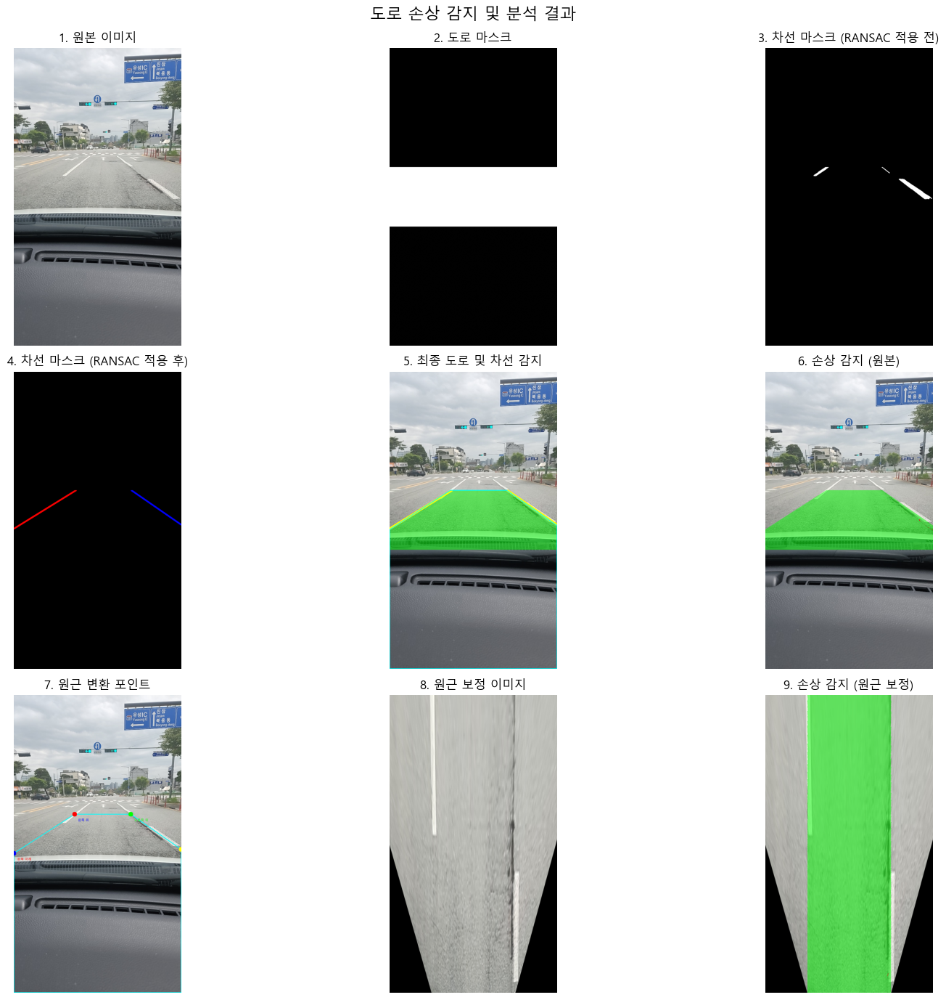

In [ ]:
import cv2
import torch
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO
from sklearn.linear_model import LinearRegression, RANSACRegressor
import matplotlib.font_manager as fm
import platform
from datetime import datetime

def setup_matplotlib_font():
    """
    운영체제별 matplotlib 한글 기본 폰트 설정 함수
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    한글 텍스트를 이미지에 표시하는 함수
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def create_roi_mask(img, use_roi=True, roi_type="trapezoid"):
    """
    관심 영역(ROI) 마스크 생성 함수
    
    Parameters:
        - img (numpy.ndarray): 원본 이미지
        - use_roi (bool): ROI 사용 여부
        - roi_type (str): "trapezoid", "lower_cut" 또는 "middle_strip"
        
    Returns:
        - numpy.ndarray: ROI 마스크
    """
    height, width = img.shape[:2]
    roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    if not use_roi:
        return roi_mask
    
    if roi_type == "trapezoid":
        # 사다리꼴 ROI - 일반적인 도로 영역
        roi_points = np.array([
            [width * 0.1, height],              # 좌하단
            [width * 0.9, height],              # 우하단
            [width * 0.7, height * 0.4],        # 우상단
            [width * 0.3, height * 0.4]         # 좌상단
        ], dtype=np.int32)
        
        # 빈 마스크 생성 및 ROI 영역만 255로 채우기
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        cv2.fillPoly(roi_mask, [roi_points], 255)
    
    elif roi_type == "lower_cut":
        # 이미지 하단 30%를 삭제하고 상단 70%만 사용
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        roi_mask[:int(height * 0.7), :] = 255
    
    elif roi_type == "middle_strip":
        # 상단 40%와 하단 40%를 삭제하고 중간 20%만 사용
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        top_boundary = int(height * 0.4)
        bottom_boundary = int(height * 0.6)
        roi_mask[top_boundary:bottom_boundary, :] = 255
    
    return roi_mask

def extract_road_mask(img, use_roi=True, roi_mask=None):
    """
    도로 영역 추출 함수
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색, 어두운 회색, 밝은 회색 포함)
    # 넓은 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 60])
    upper_gray_road = np.array([180, 50, 200])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 30])
    upper_dark_road = np.array([180, 30, 120])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 130])
    upper_light_road = np.array([180, 40, 255])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # ROI 적용
    if use_roi:
        road_mask = cv2.bitwise_and(road_mask, roi_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

def detect_lane_lines(img, use_roi=True, roi_mask=None):
    """
    차선 감지 및 마스크 생성 함수 - 가장 긴 선분 기준 차선 연장 방식
    (ROI 영역 내에서만 차선 연장)
    연장된 가장 긴 선분만 차선으로 인식하고 결과 반환
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # ROI 마스크가 비어있는지 확인
    if use_roi and np.count_nonzero(roi_mask) == 0:
        print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 사용합니다.")
        roi_mask = create_roi_mask(img, use_roi=True, roi_type="trapezoid")
    
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    if use_roi:
        color_mask = cv2.bitwise_and(color_mask, roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # RANSAC 적용 전 차선 마스크 (시각화 용도)
    original_lane_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_lines = []
    right_lines = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                # 원본 마스크에 모든 유효한 선분 추가
                cv2.line(original_lane_mask, (x1, y1), (x2, y2), 255, 2)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    left_lines.append((x1, y1, x2, y2, slope, line_length))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    right_lines.append((x1, y1, x2, y2, slope, line_length))
    
    # 확장된 차선 마스크 생성 (이 마스크만 최종 결과로 사용)
    extended_lane_mask = np.zeros_like(gray)
    
    # ROI 영역의 y 좌표 범위 계산
    if use_roi:
        roi_indices = np.where(roi_mask > 0)
        if len(roi_indices[0]) > 0:  # ROI 영역이 비어있지 않은 경우
            min_y_roi = np.min(roi_indices[0])
            max_y_roi = np.max(roi_indices[0])
        else:  # ROI 영역이 비어있는 경우
            min_y_roi = 0
            max_y_roi = height - 1
    else:
        min_y_roi = 0
        max_y_roi = height - 1
    
    # 왼쪽 차선 처리 - 가장 긴 선분 선택
    if left_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_left = sorted(left_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_left
        
        # 차선 연장을 위한 직선 방정식 계산
        # y = m*x + b, b = y - m*x
        b = y1 - slope * x1
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 왼쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            left_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            left_line_mask = left_line_mask_roi
        else:
            left_line_mask = temp_mask
    
    # 오른쪽 차선 처리 - 가장 긴 선분 선택
    if right_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_right = sorted(right_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_right
        
        # 차선 연장을 위한 직선 방정식 계산
        b = y1 - slope * x1
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 오른쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            right_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            right_line_mask = right_line_mask_roi
        else:
            right_line_mask = temp_mask
    
    # 전체 차선 마스크 통합
    extended_lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 확장된 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    extended_lane_mask = cv2.dilate(extended_lane_mask, kernel, iterations=1)
    
    # ROI 내에서만 원본 차선 마스크 적용
    if use_roi:
        original_lane_mask = cv2.bitwise_and(original_lane_mask, roi_mask)
    
    # 연장된 가장 긴 선분만을 차선으로 인식하여 반환
    return extended_lane_mask, left_line_mask, right_line_mask, original_lane_mask, masked_edges

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역 추출 함수
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def extract_road_corners(road_mask, roi_mask=None, use_roi=True):
    """
    도로 마스크에서 원근 변환에 사용할 코너 포인트 추출 - ROI 영역 내에서만 포인트 추출
    
    Parameters:
        - road_mask (numpy.ndarray): 도로 마스크
        - roi_mask (numpy.ndarray): ROI 마스크
        - use_roi (bool): ROI 사용 여부
        
    Returns:
        - numpy.ndarray: 변환에 사용할 4개의 포인트 (좌상, 우상, 좌하, 우하)
    """
    height, width = road_mask.shape
    
    # ROI 적용
    if use_roi and roi_mask is not None:
        road_mask_roi = cv2.bitwise_and(road_mask, roi_mask)
    else:
        road_mask_roi = road_mask
    
    # 마스크에서 경계 찾기
    contours, _ = cv2.findContours(road_mask_roi, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if not contours:
        # 기본 값 (전체 이미지 코너)
        return np.float32([
            [0, 0],               # 좌상단
            [width-1, 0],         # 우상단
            [0, height-1],        # 좌하단
            [width-1, height-1]   # 우하단
        ])
    
    # 가장 큰 윤곽선 선택
    main_contour = max(contours, key=cv2.contourArea)
    
    # 윤곽선의 경계 상자(Bounding Box) 구하기
    x, y, w, h = cv2.boundingRect(main_contour)
    
    # ROI 영역 내에서의 도로 마스크 높이가 충분하지 않은 경우
    if h < height * 0.5:
        # 경계 상자를 ROI 하단까지 확장
        if use_roi and roi_mask is not None:
            roi_indices = np.where(roi_mask > 0)
            if len(roi_indices[0]) > 0:
                max_y_roi = np.max(roi_indices[0])
                h = max_y_roi - y
            else:
                h = height - y
        else:
            h = height - y
    
    # 경계 상자의 코너 포인트 (좌상, 우상, 좌하, 우하)
    left_top = np.array([x, y], dtype=np.float32)
    right_top = np.array([x + w, y], dtype=np.float32)
    left_bottom = np.array([x, y + h], dtype=np.float32)
    right_bottom = np.array([x + w, y + h], dtype=np.float32)
    
    # 도로 마스크의 콘벡스 헐(Convex Hull)을 이용하여 더 정확한 코너 찾기 시도
    hull = cv2.convexHull(main_contour)
    
    # 사다리꼴 또는 사각형 모양으로 근사화 시도
    epsilon = 0.02 * cv2.arcLength(hull, True)
    approx = cv2.approxPolyDP(hull, epsilon, True)
    
    # 근사화된 다각형의 점 개수가 4개 이상인 경우
    if len(approx) >= 4:
        # 근사화된 다각형에서 상하좌우 극단 포인트 찾기
        all_points = approx.reshape(-1, 2)
        
        # x, y 좌표의 최소/최대값
        min_x = np.min(all_points[:, 0])
        max_x = np.max(all_points[:, 0])
        min_y = np.min(all_points[:, 1])
        max_y = np.max(all_points[:, 1])
        
        # 각 코너 주변의 포인트 찾기 - ROI 영역 내에서
        lt_points = [p for p in all_points if p[0] < (min_x + width * 0.2) and p[1] < (min_y + height * 0.2)]
        rt_points = [p for p in all_points if p[0] > (max_x - width * 0.2) and p[1] < (min_y + height * 0.2)]
        lb_points = [p for p in all_points if p[0] < (min_x + width * 0.2) and p[1] > (max_y - height * 0.2)]
        rb_points = [p for p in all_points if p[0] > (max_x - width * 0.2) and p[1] > (max_y - height * 0.2)]
        
        # 각 코너 영역에 포인트가 있으면 평균값 계산하여 할당
        if lt_points:
            left_top = np.mean(lt_points, axis=0).astype(np.float32)
        if rt_points:
            right_top = np.mean(rt_points, axis=0).astype(np.float32)
        if lb_points:
            left_bottom = np.mean(lb_points, axis=0).astype(np.float32)
        if rb_points:
            right_bottom = np.mean(rb_points, axis=0).astype(np.float32)
    
    # ROI 영역 내에서의 하단 경계 확인
    if use_roi and roi_mask is not None:
        roi_indices = np.where(roi_mask > 0)
        if len(roi_indices[0]) > 0:
            max_y_roi = np.min([np.max(roi_indices[0]), height - 1])
            left_bottom[1] = min(max_y_roi, left_bottom[1])
            right_bottom[1] = min(max_y_roi, right_bottom[1])
        else:
            left_bottom[1] = min(height - 1, left_bottom[1])
            right_bottom[1] = min(height - 1, right_bottom[1])
    else:
        left_bottom[1] = min(height - 1, left_bottom[1])
        right_bottom[1] = min(height - 1, right_bottom[1])
    
    # ROI 내 하단 너비 조정
    if left_bottom[0] > width * 0.2:
        left_bottom[0] = max(0, left_bottom[0] - width * 0.1)
    if right_bottom[0] < width * 0.8:
        right_bottom[0] = min(width - 1, right_bottom[0] + width * 0.1)
    
    return np.float32([left_top, right_top, left_bottom, right_bottom])

def perspective_transform(img, mask, road_polygon=None, roi_mask=None, use_roi=True):
    """
    원근 변환 함수 - 개선된 버전
    도로 마스크 기반 코너 포인트 추출을 우선적으로 활용 (ROI 영역 내에서만)
    """
    height, width = mask.shape
    
    # 도로 마스크에서 코너 포인트 추출 (우선 적용) - ROI 고려
    src_points = extract_road_corners(mask, roi_mask, use_roi)
    
    # 도로 폴리곤이 제공되었고, 도로 마스크 기반 포인트가 적절하지 않은 경우 고려
    if road_polygon is not None and len(road_polygon) >= 6:
        # 마스크 기반 추출 포인트 검증
        mask_points_valid = True
        
        # 포인트들이 너무 가깝거나 한 선 위에 있는 경우는 유효하지 않음
        points_too_close = False
        for i in range(4):
            for j in range(i+1, 4):
                dist = np.linalg.norm(src_points[i] - src_points[j])
                if dist < width * 0.05:  # 포인트 간 거리가 이미지 너비의 5% 미만인 경우
                    points_too_close = True
                    break
        
        # 모든 점이 한 선 위에 있는지 확인 (면적이 거의 0인 경우)
        area = cv2.contourArea(src_points.astype(np.int32))
        if area < (width * height * 0.01) or points_too_close:  # 면적이 너무 작은 경우
            mask_points_valid = False
        
        # 마스크 기반 포인트가 유효하지 않은 경우, 도로 폴리곤 활용
        if not mask_points_valid:
            left_bottom = road_polygon[1]  # 왼쪽 차선 하단
            right_bottom = road_polygon[4]  # 오른쪽 차선 하단
            left_top = road_polygon[2]  # 왼쪽 차선 상단
            right_top = road_polygon[3]  # 오른쪽 차선 상단
            
            # 유효한 포인트인지 확인
            is_valid = (
                0 <= left_bottom[0] < width and 0 <= left_bottom[1] < height and
                0 <= right_bottom[0] < width and 0 <= right_bottom[1] < height and
                0 <= left_top[0] < width and 0 <= left_top[1] < height and
                0 <= right_top[0] < width and 0 <= right_top[1] < height
            )
            
            if is_valid:
                temp_src_points = np.float32([left_top, right_top, left_bottom, right_bottom])
                
                # ROI 적용 (하지만 이 부분은 복잡할 수 있으므로 생략)
                src_points = temp_src_points
    
    # 변환 대상 포인트 설정 (직사각형)
    dst_points = np.float32([
        [width / 4, 0],                 # 왼쪽 상단
        [width / 4 * 3, 0],             # 오른쪽 상단
        [width / 4, height],            # 왼쪽 하단
        [width / 4 * 3, height]         # 오른쪽 하단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def apply_yolo_on_masked_area(model, img, mask):
   """
   마스크된 영역에서 YOLO 추론 수행 함수
   """
   # 마스크를 3채널로 확장
   mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
   
   # 마스크 적용된 이미지 생성
   masked_img = cv2.bitwise_and(img, mask_3ch)
   
   # YOLO 추론
   results = model(masked_img)
   res = results[0]
   
   # 클래스별 마스크 생성
   mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
   mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
   
   for i, box in enumerate(res.boxes):
       cls = int(box.cls[0])
       if i < len(res.masks):  # 안전하게 인덱스 확인
           single_mask = res.masks.data[i].cpu().numpy()
           binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
           binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
           
           if cls == 0:  # crack
               mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
           elif cls == 1:  # pothole
               mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
   
   return mask_crack, mask_pothole

def calculate_lrpci(crack_ratio, pothole_ratio, crack_severity, crack_type, pothole_info):
    """
    균열율, 포트홀 비율, 균열 심각도 등을 기반으로 LrPCI 계산
    
    Parameters:
        - crack_ratio (float): 0~1 사이의 균열율
        - pothole_ratio (float): 0~1 사이의 포트홀 비율
        - crack_severity (float): 0~1 사이의 균열 심각도
        - crack_type (str): 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_info (dict): 포트홀 정보 (개수, 최대 직경 등)
        
    Returns:
        - float: 0~100 사이의 LrPCI 값
    """
    # 기본값 설정: 완벽한 상태의 도로는 100점에서 시작
    base_score = 100
    
    # 포트홀 감점 계산 (포트홀이 있으면 더 많은 감점)
    pothole_deduction = 0
    if pothole_ratio > 0:
        pothole_count = pothole_info.get('potholes_count', 0)
        max_diameter_cm = pothole_info.get('max_diameter_cm', 0)
        
        # 포트홀 직경에 따른 심각도 분류
        if max_diameter_cm >= 30:  # 심각: 30cm 이상은 심각한 포트홀
            pothole_deduction = 30 + (pothole_count * 2.5)  # 기본 30점 감점, 추가 포트홀당 2.5점 추가 감점
        elif max_diameter_cm >= 15:  # 중간: 15~30cm는 중간 수준
            pothole_deduction = 15 + (pothole_count * 2)    # 기본 15점 감점, 추가 포트홀당 2점 추가 감점
        else:  # 경미: 15cm 미만은 경미한 수준
            pothole_deduction = 5 + (pothole_count * 1.5)   # 기본 5점 감점, 추가 포트홀당 1.5점 추가 감점
            
        # 포트홀 면적 비율이 높으면 추가 감점
        pothole_deduction += pothole_ratio * 100 * 0.3
        
        # 최대 감점은 40점으로 제한
        pothole_deduction = min(pothole_deduction, 40)
    
    # 균열 감점 계산
    crack_deduction = 0
    if crack_ratio > 0:
        # 균열 유형에 따른 가중치 설정
        crack_type_weights = {
            "선형 균열": 1.0,       # 선형 균열은 기본 가중치
            "블록형 균열": 1.5,     # 블록형 균열은 더 심각
            "악어 균열": 2.0,       # 악어 균열은 가장 심각
            "없음": 0
        }
        
        crack_type_weight = crack_type_weights.get(crack_type, 1.0)
        
        # 균열 면적 비율과 심각도, 유형에 따른 감점
        if crack_ratio >= 0.5:  # 50% 이상은 심각
            crack_deduction = 25 * crack_type_weight
        elif crack_ratio >= 0.2:  # 20~50%는 중간
            crack_deduction = 15 * crack_type_weight
        else:  # 20% 미만은 경미
            crack_deduction = 5 * crack_type_weight
            
        # 균열 면적과 심각도에 따른 추가 감점
        crack_deduction += (crack_ratio * 100 * 0.2) + (crack_severity * 10)
        
        # 최대 감점은 25점으로 제한
        crack_deduction = min(crack_deduction, 25)
    
    # 총 감점 계산
    total_deduction = pothole_deduction + crack_deduction
    
    # 최종 LrPCI 계산 (최소값은 0)
    lrpci = max(0, base_score - total_deduction)
    
    return round(lrpci, 2)

def get_lrpci_grade(lrpci):
    """
    LrPCI 점수에 따른 등급 반환
    
    Parameters:
        - lrpci (float): 0~100 사이의 LrPCI 값
        
    Returns:
        - str: 등급 (심각, 위험, 주의, 안전)
        - str: 상세 설명
    """
    if lrpci < 40:
        return "심각", "도로기능 상실, 심한 파손"
    elif lrpci < 60:
        return "위험", "중간 수준 이상 손상, 포트홀 시작, 균열 확산"
    elif lrpci < 80:
        return "주의", "경미한 손상 다수, 초기에 균열/요철 발견됨"
    else:
        return "안전", "양호 상태, 기능 이상 없음"

def determine_repair_method(lrpci, crack_ratio, crack_type, pothole_has_emergency):
    """
    LrPCI와 균열율, 포트홀 응급 상황을 기반으로 보수 방법 결정
    
    Parameters:
        - lrpci (float): 0~100 사이의 LrPCI 값
        - crack_ratio (float): 0~1 사이의 균열율
        - crack_type (str): 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_has_emergency (bool): 응급 보수가 필요한 포트홀이 있는지 여부
        
    Returns:
        - str: 권장 보수 방법
        - str: 보수 우선순위
    """
    # 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    
    # 응급 포트홀이 있는 경우 최우선 처리
    if pothole_has_emergency:
        return "포트홀 응급 보수 후 추가 조사 필요", "최우선(응급)"
    
    # LrPCI 등급 기반 보수 방법
    if grade == "심각":  # 0~39점
        priority = "긴급"
        if crack_type == "악어 균열" or crack_ratio >= 0.5:
            method = "기층까지 20cm 절삭 후 재포장 (구조적 손상 의심)"
        else:
            method = "기층까지 20cm 절삭 후 재포장"
            
    elif grade == "위험":  # 40~59점
        priority = "단기"
        if crack_type == "블록형 균열" or (crack_ratio >= 0.2 and crack_ratio < 0.5):
            method = "중간층 10cm 절삭 후 재포장 (균열 확산 방지 필요)"
        else:
            method = "부분 패치 및 포장 보수"
            
    elif grade == "주의":  # 60~79점
        priority = "정기"
        if crack_type == "선형 균열" and crack_ratio < 0.2:
            method = "균열 실링 및 표층 5cm 절삭 덧씌우기"
        else:
            method = "예방적 유지관리 및 표층 보수"
            
    else:  # 안전, 80~100점
        priority = "모니터링"
        method = "정기 점검 및 모니터링 (현재 보수 불필요)"
    
    return method, priority

def check_pothole_emergency(pothole_mask, pixel_to_cm_ratio=1.0):
    """
    포트홀 마스크를 분석하여 응급 보수가 필요한지 확인
    
    Parameters:
        - pothole_mask (numpy.ndarray): 포트홀 마스크
        - pixel_to_cm_ratio (float): 픽셀 대 센티미터 비율
        
    Returns:
        - bool: 응급 보수 필요 여부
        - dict: 포트홀 정보 (최대 직경, 총 면적 등)
    """
    # 포트홀이 없는 경우
    if np.count_nonzero(pothole_mask) == 0:
        return False, {"max_diameter_cm": 0, "potholes_count": 0, "total_area_cm2": 0}
    
    # 연결 요소 레이블링
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(pothole_mask)
    
    # 배경을 제외한 각 포트홀 분석
    max_diameter_pixels = 0
    total_area_pixels = 0
    potholes_count = num_labels - 1  # 배경 제외
    potholes_data = []
    
    for i in range(1, num_labels):  # 0은 배경
        # 포트홀 너비와 높이
        width = stats[i, cv2.CC_STAT_WIDTH]
        height = stats[i, cv2.CC_STAT_HEIGHT]
        area = stats[i, cv2.CC_STAT_AREA]
        
        # 대략적인 직경 계산 (타원 형태 가정)
        diameter = max(width, height)
        max_diameter_pixels = max(max_diameter_pixels, diameter)
        total_area_pixels += area
        
        # 개별 포트홀 정보 저장
        potholes_data.append({
            "center_x": centroids[i][0],
            "center_y": centroids[i][1],
            "width": width,
            "height": height,
            "area": area,
            "diameter": diameter
        })
    
    # 픽셀을 센티미터로 변환
    max_diameter_cm = max_diameter_pixels * pixel_to_cm_ratio
    total_area_cm2 = total_area_pixels * (pixel_to_cm_ratio ** 2)
    
    # 응급 보수 조건: 직경 30cm 이상 또는 면적이 매우 큰 경우
    is_emergency = max_diameter_cm >= 30 or total_area_cm2 >= 700
    
    # 포트홀 심각도 추정
    if max_diameter_cm >= 30:
        severity = "심각"
    elif max_diameter_cm >= 15:
        severity = "중간"
    else:
        severity = "경미"
    
    return is_emergency, {
        "max_diameter_cm": round(max_diameter_cm, 1),
        "potholes_count": potholes_count,
        "total_area_cm2": round(total_area_cm2, 1),
        "severity": severity,
        "potholes_data": potholes_data
    }

def analyze_crack_severity(crack_mask, pixel_to_cm_ratio=1.0):
    """
    균열 마스크를 분석하여 심각도 평가
    
    Parameters:
        - crack_mask (numpy.ndarray): 균열 마스크
        - pixel_to_cm_ratio (float): 픽셀 대 센티미터 비율
        
    Returns:
        - float: 심각도 점수 (0~1)
        - str: 균열 유형
        - dict: 균열 상세 정보
    """
    # 균열이 없는 경우
    if np.count_nonzero(crack_mask) == 0:
        return 0, "없음", {"total_length_cm": 0, "avg_width_cm": 0, "crack_count": 0}
    
    # 연결 요소 레이블링
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(crack_mask)
    
    # 균열 형태 분석을 위한 변수 초기화
    total_area_pixels = 0
    max_length_pixels = 0
    total_max_length_pixels = 0
    crack_widths_pixels = []
    aspect_ratios = []
    crack_count = num_labels - 1  # 배경 제외
    
    for i in range(1, num_labels):  # 0은 배경
        area = stats[i, cv2.CC_STAT_AREA]
        width = stats[i, cv2.CC_STAT_WIDTH]
        height = stats[i, cv2.CC_STAT_HEIGHT]
        
        total_area_pixels += area
        
        # 균열의 실제 길이 추정 (단순 근사: 긴 쪽이 길이)
        length = max(width, height)
        max_length_pixels = max(max_length_pixels, length)
        total_max_length_pixels += length
        
        # 균열 폭 추정
        aspect_ratio = max(width, height) / (min(width, height) if min(width, height) > 0 else 1)
        aspect_ratios.append(aspect_ratio)
        
        # 선형 균열로 판단되는 경우 폭 추정
        if aspect_ratio > 3:  # 선형 균열로 판단
            est_width = min(width, height)
            crack_widths_pixels.append(est_width)
    
    # 균열의 평균 폭 계산
    avg_width_pixels = np.mean(crack_widths_pixels) if crack_widths_pixels else 1
    
    # 픽셀 단위를 센티미터 단위로 변환
    total_length_cm = total_max_length_pixels * pixel_to_cm_ratio
    max_length_cm = max_length_pixels * pixel_to_cm_ratio
    avg_width_cm = avg_width_pixels * pixel_to_cm_ratio
    
    # 균열 유형 결정
    if len(aspect_ratios) == 0:
        crack_type = "없음"
        severity = 0
    elif np.mean(aspect_ratios) > 5:
        crack_type = "선형 균열"
        # 선형 균열의 심각도는 길이와 폭에 비례
        severity = min(1.0, (max_length_cm / 100) * (avg_width_cm / 2))
    elif np.std(aspect_ratios) < 1.5 and len(aspect_ratios) > 5:
        crack_type = "악어 균열"
        # 악어 균열은 일반적으로 심각도가 높음
        severity = min(1.0, 0.7 + (total_area_pixels * (pixel_to_cm_ratio ** 2) / 2000) * 0.3)
    else:
        crack_type = "블록형 균열"
        # 블록형 균열의 심각도는 균열 간 연결성과 전체 면적에 비례
        severity = min(1.0, 0.4 + (total_area_pixels * (pixel_to_cm_ratio ** 2) / 1000) * 0.6)
    
    # 심각도 등급 분류
    if severity >= 0.7:
        severity_grade = "심각"
    elif severity >= 0.4:
        severity_grade = "중간"
    else:
        severity_grade = "경미"
    
    return severity, crack_type, {
        "total_length_cm": round(total_length_cm, 1),
        "max_length_cm": round(max_length_cm, 1),
        "avg_width_cm": round(avg_width_cm, 2),
        "crack_count": crack_count,
        "severity_grade": severity_grade
    }

def estimate_pixel_to_cm_ratio(left_lane_mask, right_lane_mask, standard_lane_width_cm=350):
   """
   차선 폭을 기반으로 픽셀 대 센티미터 비율 추정
   
   Parameters:
       - left_lane_mask (numpy.ndarray): 왼쪽 차선 마스크
       - right_lane_mask (numpy.ndarray): 오른쪽 차선 마스크
       - standard_lane_width_cm (float): 표준 차선 폭(cm), 기본값 350cm (3.5m)
       
   Returns:
       - float: 픽셀 대 센티미터 비율
   """
   # 차선 마스크가 유효하지 않은 경우
   if np.count_nonzero(left_lane_mask) == 0 or np.count_nonzero(right_lane_mask) == 0:
       return 1.0  # 기본값 반환
   
   # 각 차선의 중심선 추출
   left_indices = np.where(left_lane_mask > 0)
   right_indices = np.where(right_lane_mask > 0)
   
   if len(left_indices[1]) == 0 or len(right_indices[1]) == 0:
       return 1.0
   
   # 각 차선의 중심 좌표 계산
   left_center_x = np.mean(left_indices[1])
   right_center_x = np.mean(right_indices[1])
   
   # 차선 간 거리 계산 (픽셀)
   lane_width_pixels = right_center_x - left_center_x
   
   if lane_width_pixels <= 0:
       return 1.0  # 유효하지 않은 경우 기본값 반환
   
   # 픽셀 대 센티미터 비율 계산
   pixel_to_cm_ratio = standard_lane_width_cm / lane_width_pixels
   
   return pixel_to_cm_ratio

def create_damage_dashboard(lrpci, crack_ratio, pothole_ratio, crack_severity, crack_type, crack_info, pothole_info, repair_method, priority, img_num):
    """
    손상 분석 결과를 시각적으로 표현하는 대시보드 생성
    """
    plt.figure(figsize=(12, 10))
    
    # 1. LrPCI 게이지 차트
    plt.subplot(2, 2, 1)
    gauge_colors = ['#FF4444', '#FFAA44', '#FFDD44', '#44AA44']  # 심각, 위험, 주의, 안전
    
    # 게이지 배경 그리기
    gauge_bg = plt.matplotlib.patches.Wedge(
        center=(0.5, 0.5), r=0.4, 
        theta1=180, theta2=0, 
        width=0.1, 
        facecolor='lightgray',
        edgecolor='gray'
    )
    plt.gca().add_patch(gauge_bg)
    
    # LrPCI 값 기반으로 게이지 그리기
    lrpci_angle = 180 - (lrpci / 100) * 180  # 0~100 범위로 변경
    
    # LrPCI 등급에 따른 색상 선택
    if lrpci < 40:
        lrpci_color = gauge_colors[0]  # 심각
        grade = "심각"
    elif lrpci < 60:
        lrpci_color = gauge_colors[1]  # 위험
        grade = "위험"
    elif lrpci < 80:
        lrpci_color = gauge_colors[2]  # 주의
        grade = "주의"
    else:
        lrpci_color = gauge_colors[3]  # 안전
        grade = "안전"
    
    gauge = plt.matplotlib.patches.Wedge(
        center=(0.5, 0.5), r=0.4, 
        theta1=180, theta2=lrpci_angle, 
        width=0.1, 
        facecolor=lrpci_color,
        edgecolor='none'
    )
    plt.gca().add_patch(gauge)
    
    # 텍스트 추가
    plt.text(0.5, 0.2, f'LrPCI: {lrpci:.2f}/100', 
            horizontalalignment='center', fontsize=14, fontweight='bold')
    
    # 등급에 따른 상태 설명
    status_map = {
        "심각": "심각 (긴급 보수)",
        "위험": "위험 (단기 보수)",
        "주의": "주의 (정기 점검)",
        "안전": "안전 (모니터링)"
    }
    
    plt.text(0.5, 0.1, status_map[grade], horizontalalignment='center', fontsize=12)
    
    # 게이지 눈금 추가
    for i in range(0, 101, 10):  # 0에서 100까지 10 단위로
        angle = 180 - (i / 100) * 180
        rad = np.radians(angle)
        x = 0.5 + 0.45 * np.cos(rad)
        y = 0.5 + 0.45 * np.sin(rad)
        x2 = 0.5 + 0.42 * np.cos(rad)
        y2 = 0.5 + 0.42 * np.sin(rad)
        plt.plot([x, x2], [y, y2], 'k-', linewidth=1)
        
        if i % 20 == 0:  # 20점 단위로 숫자 표시
            x_text = 0.5 + 0.5 * np.cos(rad)
            y_text = 0.5 + 0.5 * np.sin(rad)
            plt.text(x_text, y_text, str(i), horizontalalignment='center', verticalalignment='center', fontsize=8)
    
    # 등급 구분선 표시
    for grade_value in [40, 60, 80]:
        angle = 180 - (grade_value / 100) * 180
        rad = np.radians(angle)
        x = 0.5 + 0.45 * np.cos(rad)
        y = 0.5 + 0.45 * np.sin(rad)
        x2 = 0.5 + 0.42 * np.cos(rad)
        y2 = 0.5 + 0.42 * np.sin(rad)
        plt.plot([x, x2], [y, y2], 'r-', linewidth=2)
    
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.axis('off')
    plt.title('도로 상태 평가', fontsize=14)
    
    # 2. 손상 유형 및 비율 파이 차트
    plt.subplot(2, 2, 2)
    labels = ['정상', '균열', '포트홀']
    sizes = [1 - crack_ratio - pothole_ratio, crack_ratio, pothole_ratio]
    colors = ['#44AA44', '#FF8800', '#FF4444']
    explode = (0, 0.1, 0.1)  # 손상 부분 강조
    
    wedges, texts, autotexts = plt.pie(
        sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%',
        shadow=True, startangle=90)
    
    # 텍스트 스타일 조정
    for text in texts:
        text.set_fontsize(10)
    for autotext in autotexts:
        autotext.set_fontsize(9)
        autotext.set_fontweight('bold')
    
    plt.axis('equal')
    plt.title('손상 유형 및 비율', fontsize=14)
    
    # 3. 균열 분석 정보
    plt.subplot(2, 2, 3)
    plt.axis('off')
    
    crack_info_text = (
        f"균열 분석 정보\n"
        f"------------------------\n"
        f"균열 유형: {crack_type}\n"
        f"균열 면적 비율: {crack_ratio*100:.2f}%\n"
        f"균열 심각도: {crack_severity*100:.1f}% ({crack_info.get('severity_grade', '알 수 없음')})\n"
        f"균열 길이: {crack_info.get('total_length_cm', 0):.1f}cm\n"
        f"균열 평균 폭: {crack_info.get('avg_width_cm', 0):.2f}cm\n\n"
        f"포트홀 정보\n"
        f"------------------------\n"
        f"포트홀 개수: {pothole_info['potholes_count']}개\n"
        f"최대 포트홀 직경: {pothole_info['max_diameter_cm']:.1f}cm\n"
        f"포트홀 면적 비율: {pothole_ratio*100:.2f}%\n"
        f"포트홀 심각도: {pothole_info.get('severity', '알 수 없음')}\n"
        f"응급 보수 필요: {'예' if pothole_info['max_diameter_cm'] >= 30 else '아니오'}"
    )
    
    plt.text(0.1, 0.9, crack_info_text, fontsize=12, va='top', linespacing=1.5)
    
    # 4. 보수 권고사항
    plt.subplot(2, 2, 4)
    plt.axis('off')
    
    repair_info_text = (
        f"보수 권고사항\n"
        f"========================\n"
        f"권장 보수: {repair_method}\n"
        f"우선순위: {priority}\n\n"
        f"LrPCI 등급 기준\n"
        f"------------------------\n"
        f"심각 (0~39): 긴급 보수 필요\n"
        f"위험 (40~59): 단기 유지보수 필요\n"
        f"주의 (60~79): 정기 점검 및 예방정비\n"
        f"안전 (80~100): 정기 모니터링만 수행\n\n"
        f"손상 유형별 감점 기준\n"
        f"------------------------\n"
        f"포트홀(심각): -30~-40점\n"
        f"블록형 균열(중간): -15~-25점\n"
        f"선형 균열(경미): -5~-15점\n"
        f"마모, 박리(경미): -5점 이하"
    )
    
    plt.text(0.1, 0.9, repair_info_text, fontsize=12, va='top', linespacing=1.5)
    
    plt.tight_layout()
    plt.suptitle(f"도로 손상 상태 대시보드 - 이미지 {img_num}", fontsize=16, y=0.98)
    
    # 결과 저장
    result_dir = '../result/'
    os.makedirs(result_dir, exist_ok=True)
    plt.savefig(os.path.join(result_dir, f'dashboard_{img_num}.jpg'), dpi=300, bbox_inches='tight')
    plt.close()
    
    print(f"손상 대시보드가 '../result/dashboard_{img_num}.jpg'에 저장되었습니다.")

def generate_report(img_num, original_img, overlay_original, img_with_points, overlay_warped,
                   lrpci, crack_ratio, pothole_ratio, crack_severity, crack_type,
                   crack_info, pothole_info, repair_method, priority, is_warped_based=True):
    """
    종합 평가 보고서 생성 함수
    """
    # 결과 저장 경로
    result_dir = '../result/'
    os.makedirs(result_dir, exist_ok=True)
    
    # 이미지 파일 경로
    img_paths = {
        'original': os.path.join(result_dir, f'report_original_{img_num}.jpg'),
        'overlay': os.path.join(result_dir, f'report_overlay_{img_num}.jpg'),
        'points': os.path.join(result_dir, f'report_points_{img_num}.jpg'),
        'warped': os.path.join(result_dir, f'report_warped_{img_num}.jpg')
    }
    
    # 이미지 저장
    cv2.imwrite(img_paths['original'], cv2.cvtColor(original_img, cv2.COLOR_RGB2BGR))
    cv2.imwrite(img_paths['overlay'], cv2.cvtColor(overlay_original, cv2.COLOR_RGB2BGR))
    cv2.imwrite(img_paths['points'], cv2.cvtColor(img_with_points, cv2.COLOR_RGB2BGR))
    cv2.imwrite(img_paths['warped'], cv2.cvtColor(overlay_warped, cv2.COLOR_RGB2BGR))
    
    # 등급 결정
    if lrpci < 40:
        condition_class = "심각"
        condition_color = "#FF4444"
    elif lrpci < 60:
        condition_class = "위험"
        condition_color = "#FFAA44"
    elif lrpci < 80:
        condition_class = "주의"
        condition_color = "#FFDD44"
    else:
        condition_class = "안전"
        condition_color = "#44AA44"
    
    # 현재 날짜
    report_date = datetime.now().strftime("%Y년 %m월 %d일")
    
    # HTML 보고서 생성
    html_content = f"""
    <!DOCTYPE html>
    <html lang="ko">
    <head>
        <meta charset="UTF-8">
        <meta name="viewport" content="width=device-width, initial-scale=1.0">
        <title>도로 손상 평가 보고서 - 이미지 {img_num}</title>
        <style>
            body {{
                font-family: 'Malgun Gothic', Arial, sans-serif;
                max-width: 1200px;
                margin: 0 auto;
                padding: 20px;
                color: #333;
            }}
            .header {{
                text-align: center;
                margin-bottom: 30px;
                border-bottom: 2px solid #ddd;
                padding-bottom: 20px;
            }}
            .report-info {{
                display: flex;
                justify-content: space-between;
                margin-bottom: 20px;
            }}
            .summary-box {{
                border: 1px solid #ddd;
                border-radius: 5px;
                padding: 15px;
                margin-bottom: 20px;
                background-color: #f9f9f9;
            }}
            .condition {{
                font-size: 24px;
                font-weight: bold;
                color: {condition_color};
                border: 2px solid {condition_color};
                border-radius: 5px;
                padding: 5px 10px;
                display: inline-block;
            }}
            .image-section {{
                display: grid;
                grid-template-columns: 1fr 1fr;
                gap: 20px;
                margin: 20px 0;
            }}
            .image-container {{
                border: 1px solid #ddd;
                padding: 10px;
                border-radius: 5px;
            }}
            .image-container img {{
                width: 100%;
                height: auto;
                border-radius: 3px;
            }}
            .image-title {{
                text-align: center;
                font-weight: bold;
                margin-top: 10px;
                font-size: 14px;
            }}
            table {{
                width: 100%;
                border-collapse: collapse;
                margin: 20px 0;
            }}
            table, th, td {{
                border: 1px solid #ddd;
            }}
            th, td {{
                padding: 10px;
                text-align: left;
            }}
            th {{
                background-color: #f2f2f2;
            }}
            .footer {{
                text-align: center;
                margin-top: 40px;
                border-top: 1px solid #ddd;
                padding-top: 20px;
                font-size: 12px;
                color: #777;
            }}
        </style>
    </head>
    <body>
        <div class="header">
            <h1>도로 손상 평가 보고서</h1>
            <p>이미지 ID: {img_num} | 분석 일자: {report_date}</p>
            <p><strong>분석 기준: {'원근 보정된 이미지 기반' if is_warped_based else '원본 이미지 기반'}</strong></p>
        </div>
       
        <div class="report-info">
            <div>
                <h2>평가 결과 요약</h2>
                <p>LrPCI 점수: <strong>{lrpci:.2f}/100.00</strong></p>
            </div>
            <div>
                <h3>도로 상태 등급</h3>
                <div class="condition">{condition_class}</div>
            </div>
        </div>
       
        <div class="summary-box">
            <h3>손상 요약</h3>
            <p>균열 면적 비율: <strong>{crack_ratio*100:.2f}%</strong> | 균열 유형: <strong>{crack_type}</strong> | 균열 심각도: <strong>{crack_severity*100:.1f}%</strong></p>
            <p>균열 길이: <strong>{crack_info.get('total_length_cm', 0):.1f}cm</strong> | 균열 평균 폭: <strong>{crack_info.get('avg_width_cm', 0):.2f}cm</strong></p>
            <p>포트홀 면적 비율: <strong>{pothole_ratio*100:.2f}%</strong> | 포트홀 개수: <strong>{pothole_info['potholes_count']}개</strong> | 최대 직경: <strong>{pothole_info['max_diameter_cm']:.1f}cm</strong></p>
            <p>권장 보수 방법: <strong>{repair_method}</strong></p>
            <p>보수 우선순위: <strong>{priority}</strong></p>
        </div>
       
        <div class="image-section">
            <div class="image-container">
                <img src="{os.path.basename(img_paths['original'])}" alt="원본 이미지">
                <div class="image-title">원본 이미지</div>
            </div>
            <div class="image-container">
                <img src="{os.path.basename(img_paths['overlay'])}" alt="손상 감지 시각화">
                <div class="image-title">손상 감지 (빨강: 균열, 파랑: 포트홀)</div>
            </div>
            <div class="image-container">
                <img src="{os.path.basename(img_paths['points'])}" alt="원근 변환 포인트">
                <div class="image-title">원근 변환 포인트</div>
            </div>
            <div class="image-container">
                <img src="{os.path.basename(img_paths['warped'])}" alt="원근 보정 이미지">
                <div class="image-title">원근 보정된 손상 감지</div>
            </div>
        </div>
       
        <h3>상세 분석 결과</h3>
        <table>
            <tr>
                <th>평가 항목</th>
                <th>수치</th>
                <th>상태</th>
            </tr>
            <tr>
                <td>LrPCI 점수</td>
                <td>{lrpci:.2f}/100.00</td>
                <td>{"심각 (긴급 보수 필요)" if lrpci < 40 else "위험 (단기 보수 필요)" if lrpci < 60 else "주의 (정기 점검 필요)" if lrpci < 80 else "안전 (유지관리)"}</td>
            </tr>
            <tr>
                <td>균열 비율</td>
                <td>{crack_ratio*100:.2f}%</td>
                <td>{"심각 (기층 재포장)" if crack_ratio >= 0.5 else "중간 (중간층 재포장)" if crack_ratio >= 0.2 else "경미 (표층 덧씌우기)"}</td>
            </tr>
            <tr>
                <td>포트홀 상태</td>
                <td>최대 직경 {pothole_info['max_diameter_cm']:.1f}cm</td>
                <td>{"응급 보수 필요" if pothole_info['max_diameter_cm'] >= 30 else "일반 관찰 대상"}</td>
            </tr>
        </table>
       
        <div class="footer">
            <p>본 보고서는 AI 기반 도로 손상 감지 시스템에 의해 자동 생성되었습니다.</p>
            <p>© 2025 도로 포장 상태 평가 및 관리 시스템</p>
        </div>
    </body>
    </html>
    """
    
    # HTML 파일 저장
    report_path = os.path.join(result_dir, f'report_{img_num}.html')
    with open(report_path, 'w', encoding='utf-8') as f:
        f.write(html_content)
    
    print(f"종합 평가 보고서가 '{report_path}'에 저장되었습니다.")

def save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
                          lrpci, crack_info, pothole_info, repair_method, priority, img_num, is_warped_based=True):
    """
    분석 결과를 텍스트 파일로 저장하는 함수
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'analysis_result_{img_num}.txt')
    
    # 균열률과 포트홀 비율 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    
    # 원근 보정된 이미지의 손상 비율 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    
    # LrPCI 등급 획득
    grade, description = get_lrpci_grade(lrpci)
    
    # 결과 작성
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(f"도로 영역 분석 결과 (원본 이미지):\n")
        f.write(f"도로 면적: {road_area} 픽셀\n")
        f.write(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)\n")
        f.write(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)\n")
        f.write(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_ratio + pothole_ratio)*100:.2f}%)\n\n")
        
        f.write(f"도로 영역 분석 결과 (원근 보정된 이미지):\n")
        f.write(f"도로 면적: {warped_road_area} 픽셀\n")
        f.write(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)\n")
        f.write(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)\n")
        f.write(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_ratio + warped_pothole_ratio)*100:.2f}%)\n\n")
        
        f.write(f"평가 결과 - {'원근 보정된 이미지 기반' if is_warped_based else '원본 이미지 기반'}:\n")
        f.write(f"LrPCI 평가 점수: {lrpci}/100.00\n")
        f.write(f"LrPCI 등급: {grade} ({description})\n")
        
        # 균열 정보 출력
        if crack_info:
            f.write(f"균열 길이: {crack_info.get('total_length_cm', 0):.1f}cm\n")
            f.write(f"균열 최대 길이: {crack_info.get('max_length_cm', 0):.1f}cm\n")
            f.write(f"균열 평균 폭: {crack_info.get('avg_width_cm', 0):.2f}cm\n")
            f.write(f"균열 개수: {crack_info.get('crack_count', 0)}개\n")
            f.write(f"균열 심각도 등급: {crack_info.get('severity_grade', '알 수 없음')}\n")
        
        # 포트홀 정보 출력
        f.write(f"최대 포트홀 직경: {pothole_info.get('max_diameter_cm', 0):.1f}cm\n")
        f.write(f"포트홀 개수: {pothole_info.get('potholes_count', 0)}개\n")
        f.write(f"포트홀 총 면적: {pothole_info.get('total_area_cm2', 0):.1f}cm²\n")
        f.write(f"포트홀 심각도: {pothole_info.get('severity', '알 수 없음')}\n\n")
        
        f.write(f"권장 보수 방법: {repair_method}\n")
        f.write(f"보수 우선순위: {priority}\n")
    
    print(f"분석 결과가 {file_path}에 저장되었습니다.")

def save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num):
   """
   핵심 이미지 4개를 하나의 이미지 파일로 저장하는 함수
   """
   # 결과 저장 경로
   result_dir = '../result/'
   
   # 디렉토리가 없으면 생성
   os.makedirs(result_dir, exist_ok=True)
   
   # 파일 경로 설정
   file_path = os.path.join(result_dir, f'key_images_{img_num}.jpg')
   
   # 2x2 그리드로 이미지 배치
   plt.figure(figsize=(15, 12))
   
   plt.subplot(2, 2, 1)
   plt.imshow(original_img)
   plt.title('원본 이미지')
   plt.axis('off')
   
   plt.subplot(2, 2, 2)
   plt.imshow(overlay_original)
   plt.title('손상 감지 (원본)')
   plt.axis('off')
   
   plt.subplot(2, 2, 3)
   plt.imshow(img_with_points)
   plt.title('원근 변환 포인트')
   plt.axis('off')
   
   plt.subplot(2, 2, 4)
   plt.imshow(overlay_warped)
   plt.title('손상 감지 (원근 보정)')
   plt.axis('off')
   
   plt.tight_layout()
   plt.suptitle(f"도로 손상 분석 결과 (이미지 {img_num})", fontsize=16)
   plt.subplots_adjust(top=0.9)
   
   # 이미지 저장
   plt.savefig(file_path, dpi=300, bbox_inches='tight')
   plt.close()
   
   print(f"핵심 이미지가 {file_path}에 저장되었습니다.")

def visualize_results(original_img, road_mask, lane_mask, left_lane_mask, right_lane_mask, 
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     original_lane_mask, img_num=None, pixel_to_cm_ratio=1.0):
    """
    요청에 맞게 9개 이미지로 결과 시각화 함수 - 구성 변경
    """
    plt.figure(figsize=(18, 14))
   
    # 1. 원본 이미지
    plt.subplot(3, 3, 1)
    plt.imshow(original_img)
    plt.title('1. 원본 이미지')
    plt.axis('off')
    
    # 2. 도로 마스크
    plt.subplot(3, 3, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('2. 도로 마스크')
    plt.axis('off')
    
    # 3. 차선 마스크 (RANSAC 적용 전)
    plt.subplot(3, 3, 3)
    plt.imshow(original_lane_mask, cmap='gray')  # RANSAC 적용 전 차선 마스크
    plt.title('3. 차선 마스크 (RANSAC 적용 전)')
    plt.axis('off')
    
    # 4. 차선 마스크 (RANSAC 적용 후)
    plt.subplot(3, 3, 4)
    lane_combined = np.zeros((original_img.shape[0], original_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('4. 차선 마스크 (RANSAC 적용 후)')
    plt.axis('off')
    
    # 5. 최종 도로 및 차선 감지
    plt.subplot(3, 3, 5)
    road_overlay = original_img.copy()
    alpha = 0.5
    
    # 도로 영역 반투명 초록색으로 표시
    road_highlight = road_overlay.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    road_overlay = cv2.addWeighted(road_highlight, alpha, road_overlay, 1-alpha, 0)
    
    # 차선 표시
    road_overlay[lane_mask == 255] = [255, 255, 0]  # 차선: 노란색
    
    # 도로 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(road_overlay, [road_polygon], True, (0, 255, 255), 2)
    
    plt.imshow(road_overlay)
    plt.title('5. 최종 도로 및 차선 감지')
    plt.axis('off')
    
    # 6. 손상 감지 (원본)
    plt.subplot(3, 3, 6)
    overlay_original = original_img.copy()
    alpha = 0.5
    road_highlight = overlay_original.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_highlight, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.imshow(overlay_original)
    plt.title('6. 손상 감지 (원본)')
    plt.axis('off')
    
    # 7. 원근 변환 포인트
    plt.subplot(3, 3, 7)
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 위', '오른쪽 위', '왼쪽 아래', '오른쪽 아래']
    
    # 도로 영역 윤곽선
    if road_polygon is not None:
        cv2.polylines(img_with_points, [road_polygon], True, (0, 255, 255), 2)
    
    # 변환 포인트 표시
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    
    plt.imshow(img_with_points)
    plt.title('7. 원근 변환 포인트')
    plt.axis('off')
    
    # 8. 원근 보정 이미지
    plt.subplot(3, 3, 8)
    plt.imshow(warped_img)
    plt.title('8. 원근 보정 이미지')
    plt.axis('off')
    
    # 9. 손상 감지 (원근 보정)
    plt.subplot(3, 3, 9)
    overlay_warped = warped_img.copy()
    alpha = 0.5
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_warped[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_warped)
    plt.title('9. 손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 결과", fontsize=16)
    plt.subplots_adjust(top=0.94)
    
    # 원본 이미지에서의 손상 면적 계산
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    # 원본 이미지의 손상률 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    total_damage_ratio = crack_ratio + pothole_ratio
    
    # 원근 보정된 이미지에서의 손상 면적 계산
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    # 원근 보정된 이미지의 손상률 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    warped_total_damage_ratio = warped_crack_ratio + warped_pothole_ratio
    
    # 균열 심각도 분석 - 원근 보정된 이미지 사용
    crack_severity, crack_type, crack_info = analyze_crack_severity(
        cv2.bitwise_and(warped_crack, warped_mask), pixel_to_cm_ratio
    )
    
    # 포트홀 응급 상황 확인 - 원근 보정된 이미지 사용
    is_emergency, pothole_info = check_pothole_emergency(
        cv2.bitwise_and(warped_pothole, warped_mask), 
        pixel_to_cm_ratio
    )
    
    # 원근 보정된 이미지 기반으로 LrPCI 계산
    lrpci = calculate_lrpci(warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, pothole_info)
    
    # 보수 방법 결정 - 원근 보정된 이미지 기반 결과 사용
    repair_method, priority = determine_repair_method(lrpci, warped_crack_ratio, crack_type, is_emergency)
    
    # 원본 이미지 분석 결과 출력
    print(f"\n도로 영역 분석 결과 (원본 이미지):")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({total_damage_ratio*100:.2f}%)")
    
    # 원근 보정된 이미지 분석 결과 출력 (LrPCI 포함)
    print(f"\n도로 영역 분석 결과 (원근 보정된 이미지):")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({warped_total_damage_ratio*100:.2f}%)")
    
    # LrPCI 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    print(f"LrPCI 평가 점수: {lrpci}/100.00 ({grade}: {description})")
    print(f"최대 포트홀 직경: {pothole_info['max_diameter_cm']:.1f}cm (응급보수 필요: {'예' if is_emergency else '아니오'})")
    print(f"권장 보수 방법: {repair_method}")
    print(f"보수 우선순위: {priority}")

    # 이미지 번호가 제공된 경우 저장
    if img_num is not None:
        result_dir = '../result/'
        os.makedirs(result_dir, exist_ok=True)
        plt.savefig(os.path.join(result_dir, f'visualization_{img_num}.jpg'), dpi=300, bbox_inches='tight')
        
        # 분석 결과 텍스트 파일로 저장
        save_analysis_results(
            road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
            lrpci, crack_info, pothole_info, repair_method, priority, img_num, 
            is_warped_based=True  # 원근 보정 기반 분석임을 표시
        )
        
        # 핵심 이미지 저장
        save_key_images(original_img, overlay_original, img_with_points, overlay_warped, img_num)
        
        # 손상 대시보드 생성 (원근 보정 기반)
        create_damage_dashboard(
            lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, 
            crack_info, pothole_info, repair_method, priority, img_num
        )
        
        # 종합 평가 보고서 생성 (원근 보정 기반)
        generate_report(
            img_num, original_img, overlay_original, img_with_points, overlay_warped,
            lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type,
            crack_info, pothole_info, repair_method, priority
        )
    
    plt.show()
    
    return lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, crack_info, pothole_info, repair_method, priority, overlay_original, img_with_points, overlay_warped

def main():
    """
    메인 함수 - 전체 도로 손상 감지 파이프라인을 실행하는 함수
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = '../model/epoch85.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    img_bgr = cv2.imread(img_path)
    if img_bgr is None:
        print(f"이미지를 로드할 수 없습니다: {img_path}")
        return
        
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = img_rgb.shape[:2]
    
    # ROI 사용 여부 설정
    use_roi = input("ROI를 사용하시겠습니까? (y/n): ").lower() == 'y'
    
    # ROI 마스크 생성
    roi_mask = None
    if use_roi:
        roi_type = input("ROI 타입을 선택하세요 (1: trapezoid, 2: lower_cut, 3: middle_strip): ")
        if roi_type == "1":
            roi_type = "trapezoid"
        elif roi_type == "2":
            roi_type = "lower_cut"
        elif roi_type == "3":
            roi_type = "middle_strip"
        else:
            roi_type = "trapezoid"  # 기본값
        
        roi_mask = create_roi_mask(img_bgr, use_roi=True, roi_type=roi_type)
        print(f"ROI 타입 '{roi_type}'을(를) 적용했습니다.")
        
        # ROI가 비어있는지 확인
        if np.count_nonzero(roi_mask) == 0:
            print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 대신 사용합니다.")
            roi_mask = create_roi_mask(img_bgr, use_roi=True, roi_type="trapezoid")
    else:
        print("ROI를 적용하지 않습니다.")
    
    # 픽셀 대 센티미터 비율 설정 또는 추정
    use_custom_ratio = input("픽셀 대 센티미터 비율을 직접 설정하시겠습니까? (y/n): ").lower() == 'y'
    pixel_to_cm_ratio = 1.0  # 기본값
    
    if use_custom_ratio:
        try:
            custom_ratio = float(input("픽셀 대 센티미터 비율을 입력하세요 (1.0 = 1픽셀당 1cm): "))
            if custom_ratio > 0:
                pixel_to_cm_ratio = custom_ratio
                print(f"사용자 정의 비율 {pixel_to_cm_ratio:.4f} cm/pixel이 설정되었습니다.")
            else:
                print("비율은 양수여야 합니다. 기본값 1.0을 사용합니다.")
        except ValueError:
            print("유효한 숫자가 아닙니다. 기본값 1.0을 사용합니다.")
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(img_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, original_lane_mask, masked_edges = detect_lane_lines(img_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(img_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 도로 마스크나 차선 마스크가 비어 있는지 확인
    if np.count_nonzero(road_lane_mask) == 0:
        print("경고: 도로 차선 마스크가 비어 있습니다. ROI 설정을 다시 확인하세요.")
        # 기본 마스크 사용
        road_lane_mask = np.ones((img_height, img_width), dtype=np.uint8) * 255
        if use_roi and roi_mask is not None:
            road_lane_mask = cv2.bitwise_and(road_lane_mask, roi_mask)
    
    # 사용자 정의 비율을 설정하지 않은 경우 차선 폭 기반으로 추정
    if not use_custom_ratio:
        estimated_ratio = estimate_pixel_to_cm_ratio(left_lane_mask, right_lane_mask)
        if estimated_ratio != 1.0:  # 추정 성공 시
            pixel_to_cm_ratio = estimated_ratio
            print(f"추정된 픽셀 대 센티미터 비율: {pixel_to_cm_ratio:.4f} cm/pixel")
        else:
            print("픽셀 대 센티미터 비율을 추정할 수 없습니다. 기본값 1.0을 사용합니다.")
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, img_rgb, road_lane_mask)
    
    # 원근 변환을 위한 코너 포인트 추출 (도로 폴리곤 기반 또는 도로 마스크 기반)
    if road_polygon is not None and len(road_polygon) >= 6:
        # 도로 폴리곤 기반으로 변환 포인트 추출
        left_bottom = road_polygon[1]  # 왼쪽 차선 하단
        right_bottom = road_polygon[4]  # 오른쪽 차선 하단
        left_top = road_polygon[2]  # 왼쪽 차선 상단
        right_top = road_polygon[3]  # 오른쪽 차선 상단
        
        corner_points = np.float32([left_top, right_top, left_bottom, right_bottom])
    else:
        # 도로 마스크 기반으로 코너 포인트 추출
        corner_points = extract_road_corners(road_lane_mask)
    
    # 원근 변환 적용
    try:
        warped_img, warped_mask, perspective_matrix, src_points = perspective_transform(
            img_rgb, road_lane_mask, road_polygon, roi_mask, use_roi)
        
        # 손상 마스크에도 원근 변환 적용
        warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
        warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
    except Exception as e:
        print(f"원근 변환 중 오류 발생: {e}")
        # 원근 변환 실패 시 원본 이미지 및 마스크 사용
        warped_img = img_rgb.copy()
        warped_mask = road_lane_mask.copy()
        warped_crack = mask_crack.copy()
        warped_pothole = mask_pothole.copy()
        src_points = corner_points
    
    # 결과 시각화
    visualize_results(
        img_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, 
        corner_points, original_lane_mask, img_num, pixel_to_cm_ratio
    )

if __name__ == "__main__":
   main()

## 카메라 캘리브레이션을 통한 이미지 왜곡 보정 적용

YOLOv11-seg 모델 '../model/epoch85.pt'을(를) 로드했습니다.
카메라 캘리브레이션 데이터 '../model/camera_calibration_result.npy'을(를) 사용합니다.
이미지 '../image/test_image_27.jpg'을(를) 로드했습니다.
카메라 캘리브레이션을 적용하여 이미지 왜곡을 보정했습니다.
ROI 타입 'middle_strip'을(를) 적용했습니다.
추정된 픽셀 대 센티미터 비율: 1.8767 cm/pixel

0: 1024x576 1 crack, 2702.8ms
Speed: 9.0ms preprocess, 2702.8ms inference, 16.4ms postprocess per image at shape (1, 3, 1024, 576)

도로 영역 분석 결과 (왜곡 보정 이미지):
도로 면적: 285350 픽셀
균열 면적: 308 픽셀 (0.11%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 308 픽셀 (0.11%)

도로 영역 분석 결과 (원근 보정된 이미지):
도로 면적: 40076 픽셀
균열 면적: 0 픽셀 (0.00%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 0 픽셀 (0.00%)
LrPCI 평가 점수: 100/100.00 (안전: 양호 상태, 기능 이상 없음)
최대 포트홀 직경: 0.0cm (응급보수 필요: 아니오)
권장 보수 방법: 정기 점검 및 모니터링 (현재 보수 불필요)
보수 우선순위: 모니터링
분석 결과가 ../result/analysis_result_27.txt에 저장되었습니다.


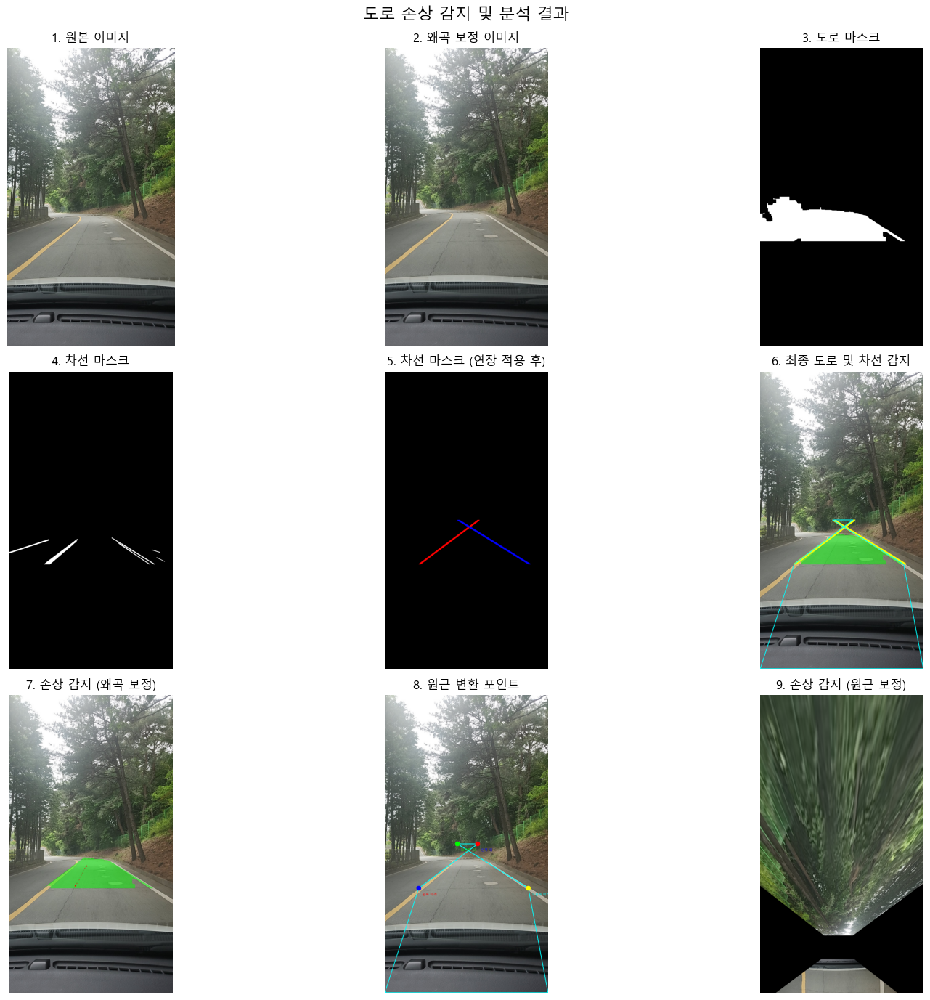

In [ ]:
import cv2
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO
import matplotlib.font_manager as fm
import platform

def setup_matplotlib_font():
    """
    운영체제 별로 matplotlib에서 한글을 표시하기 위한 폰트 설정 함수

    Process:
    1. 현재 운영체제(Windows, macOS, Linux)를 확인
    2. 운영체제에 맞는 한글 폰트 경로 설정
    3. 폰트 속성 설정 및 matplotlib 폰트 패밀리 변경
    4. 마이너스 기호 깨짐 방지 설정

    Parameters: None
    Returns: None
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    이미지에 한글 텍스트를 표시하는 함수

    Process:
    1. NumPy 배열을 PIL 이미지로 변환
    2. 그리기 객체 생성
    3. 운영체제에 맞는 폰트 설정
    4. 이미지에 텍스트 그리기
    5. PIL 이미지를 NumPy 배열로 다시 변환

    Parameters:
        - img (numpy.ndarray) : 텍스트를 추가할 이미지
        - text (str) : 추가할 텍스트
        - position (tuple) : 텍스트를 표시할 위치 (x, y)
        - font_size (float) : 폰트 크기 조절 계수
        - color (tuple) : BGR 형식의 텍스트 색상
        - thickness (int) : 텍스트 두께

    Returns:
        - np.array(pil_img) (numpy.ndarray) : 텍스트가 추가된 이미지
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def undistort_image(img, calibration_file):
    """
    카메라 캘리브레이션 결과를 사용하여 이미지의 왜곡을 보정하는 함수

    Process:
    1. 캘리브레이션 파일 로드
    2. 카메라 행렬 및 왜곡 계수 추출
    3. 새 카메라 행렬 계산
    4. 이미지 왜곡 보정 적용
    5. ROI 영역 추출

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - calibration_file (str) : 캘리브레이션 결과가 저장된 파일 경로

    Returns:
        - numpy.ndarray : 왜곡 보정된 이미지
        - tuple : (mtx, dist, roi) 카메라 행렬, 왜곡 계수, ROI 정보
    """
    try:
        # 캘리브레이션 결과 로드
        calibration_data = np.load(calibration_file, allow_pickle=True).item()
        
        # 키 이름 확인 및 수정 부분
        mtx = calibration_data.get('camera_matrix')  # 'mtx' 대신 'camera_matrix'
        dist = calibration_data.get('dist_coeffs')   # 'dist' 대신 'dist_coeffs'
        
        if mtx is None or dist is None:
            raise ValueError("캘리브레이션 데이터에 카메라 행렬 또는 왜곡 계수가 없습니다.")
        
        # 원본 이미지 크기
        h, w = img.shape[:2]
        
        # 왜곡 보정 후 이미지 크기 계산을 위한 새로운 카메라 행렬 얻기
        newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w, h), 1, (w, h))
        
        # 왜곡 보정 적용
        undistorted = cv2.undistort(img, mtx, dist, None, newcameramtx)
        
        # ROI 잘라내기
        if roi[2] > 0 and roi[3] > 0:  # 유효한 ROI 영역이 있는 경우
            x, y, w, h = roi
            undistorted = undistorted[y:y+h, x:x+w]
        
        return undistorted, (mtx, dist, roi)
    except Exception as e:
        print(f"이미지 왜곡 보정 중 오류 발생: {e}")
        return img, (None, None, None)

def create_roi_mask(img, use_roi=True, roi_type="trapezoid"):
    """
    이미지에서 관심 영역(ROI) 마스크를 생성하는 함수

    Process:
    1. 이미지 크기 확인
    2. use_roi가 False면 전체 영역 마스크 반환
    3. roi_type에 따라 사다리꼴, 하단 절삭, 중간 띠 형태의 마스크 중 하나 생성

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_type (str) : "trapezoid", "middle_strip"

    Returns:
        - numpy.ndarray : 생성된 ROI 마스크
    """
    height, width = img.shape[:2]
    roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    if not use_roi:
        return roi_mask
    
    if roi_type == "trapezoid":
        # 사다리꼴 ROI - 일반적인 도로 영역
        roi_points = np.array([
            [width * 0.1, height],              # 좌하단
            [width * 0.9, height],              # 우하단
            [width * 0.7, height * 0.4],        # 우상단
            [width * 0.3, height * 0.4]         # 좌상단
        ], dtype=np.int32)
        
        # 빈 마스크 생성 및 ROI 영역만 255로 채우기
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        cv2.fillPoly(roi_mask, [roi_points], 255)
    
    elif roi_type == "middle_strip":
        # 상단 n%와 하단 m%를 삭제하고 중간 (100 - n - m)%만 사용
        top = 0.4
        bottom = 0.45
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        top_boundary = int(height * top)
        bottom_boundary = int(height * (1 - bottom))
        roi_mask[top_boundary:bottom_boundary, :] = 255
    
    return roi_mask

def extract_road_mask(img, use_roi=True, roi_mask=None):
    """
    이미지에서 도로 영역을 추출하는 함수

    Process:
    1. 이미지 전처리 (가우시안 블러)
    2. HSV 색상 공간으로 변환
    3. 다양한 도로 색상 범위에 대한 마스크 생성 (회색, 어두운, 밝은 도로)
    4. 모든 마스크 결합
    5. ROI 적용 (선택적)
    6. 모폴로지 연산으로 노이즈 제거 및 도로 영역 연결
    7. 연결 요소 분석으로 유의미한 도로 영역만 선택
    8. 홍수 채우기 알고리즘으로 가장 가능성 높은 도로 영역 선택

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_mask (numpy.ndarray) : 사전에 정의된 ROI 마스크 (없으면 생성)

    Returns:
        - numpy.ndarray : 도로 영역 마스크
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위
    # 일반 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 70])
    upper_gray_road = np.array([180, 30, 170])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 40])
    upper_dark_road = np.array([180, 25, 100])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 140])
    upper_light_road = np.array([180, 35, 220])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # ROI 적용
    if use_roi:
        road_mask = cv2.bitwise_and(road_mask, roi_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

def detect_lane_lines(img, use_roi=True, roi_mask=None):
    """
    이미지에서 차선을 감지하고 마스크를 생성하는 함수

    Process:
    1. 이미지 전처리 (그레이스케일 변환, 블러, 캐니 엣지 검출)
    2. ROI 마스크 적용
    3. 색상 기반 차선 추출 (흰색/노란색)
    4. 최종 마스크 생성 (엣지 + 색상)
    5. 호프 변환으로 직선 검출
    6. 차선 필터링 및 왼쪽/오른쪽 차선 분류
    7. 각 차선의 가장 긴 선분 선택 및 연장
    8. 연장된 차선 마스크 생성

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_mask (numpy.ndarray) : 사전에 정의된 ROI 마스크 (없으면 생성)

    Returns:
        - extended_lane_mask (numpy.ndarray) : 연장된 차선 마스크
        - left_line_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_line_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - masked_edges (numpy.ndarray) : 엣지 마스크 (ROI 적용)
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # ROI 마스크가 비어있는지 확인
    if use_roi and np.count_nonzero(roi_mask) == 0:
        print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 사용합니다.")
        roi_mask = create_roi_mask(img, use_roi=True, roi_type="trapezoid")
    
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    if use_roi:
        color_mask = cv2.bitwise_and(color_mask, roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # RANSAC 적용 전 차선 마스크 (시각화 용도)
    original_lane_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_lines = []
    right_lines = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                # 원본 마스크에 모든 유효한 선분 추가
                cv2.line(original_lane_mask, (x1, y1), (x2, y2), 255, 2)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    left_lines.append((x1, y1, x2, y2, slope, line_length))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    right_lines.append((x1, y1, x2, y2, slope, line_length))
    
    # 확장된 차선 마스크 생성 (이 마스크만 최종 결과로 사용)
    extended_lane_mask = np.zeros_like(gray)
    
    # ROI 영역의 y 좌표 범위 계산
    if use_roi:
        roi_indices = np.where(roi_mask > 0)
        if len(roi_indices[0]) > 0:  # ROI 영역이 비어있지 않은 경우
            min_y_roi = np.min(roi_indices[0])
            max_y_roi = np.max(roi_indices[0])
        else:  # ROI 영역이 비어있는 경우
            min_y_roi = 0
            max_y_roi = height - 1
    else:
        min_y_roi = 0
        max_y_roi = height - 1
    
    # 왼쪽 차선 처리 - 가장 긴 선분 선택
    if left_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_left = sorted(left_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_left
        
        # 차선 연장을 위한 직선 방정식 계산
        # y = m*x + b, b = y - m*x
        b = y1 - slope * x1
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 왼쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            left_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            left_line_mask = left_line_mask_roi
        else:
            left_line_mask = temp_mask
    
    # 오른쪽 차선 처리 - 가장 긴 선분 선택
    if right_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_right = sorted(right_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_right
        
        # 차선 연장을 위한 직선 방정식 계산
        b = y1 - slope * x1
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 오른쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            right_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            right_line_mask = right_line_mask_roi
        else:
            right_line_mask = temp_mask
    
    # 전체 차선 마스크 통합
    extended_lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 확장된 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    extended_lane_mask = cv2.dilate(extended_lane_mask, kernel, iterations=1)
    
    # ROI 내에서만 원본 차선 마스크 적용
    if use_roi:
        original_lane_mask = cv2.bitwise_and(original_lane_mask, roi_mask)
    
    # 연장된 가장 긴 선분만을 차선으로 인식하여 반환
    return extended_lane_mask, left_line_mask, right_line_mask, original_lane_mask, masked_edges

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역을 추출하는 함수

    Process:
    1. 왼쪽과 오른쪽 차선의 윤곽선 찾기
    2. 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    3. 왼쪽/오른쪽 차선의 외곽점 찾기
    4. 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    5. 도로 영역 마스크 생성
    6. 원래 도로 마스크와 교차

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크

    Returns:
        - final_road_mask (numpy.ndarray) : 차선 내부의 도로 마스크
        - road_polygon (numpy.ndarray or None) : 도로 폴리곤 좌표 배열
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def extract_road_corners(road_mask, roi_mask=None, use_roi=True):
    """
    도로 마스크에서 코너 포인트를 직접 추출하는 함수

    Process:
    1. 마스크가 비어있는지 확인
    2. 마스크 픽셀 좌표 가져오기
    3. y값으로 상위 1%와 하위 1% 지점 선택
    4. 상위 지점들 중에서 x 좌표로 좌/우 결정
    5. 하위 지점들 중에서 x 좌표로 좌/우 결정
    6. ROI 마스크가 제공된 경우, 코너 포인트가 ROI 내에 있는지 확인

    Parameters:
        - road_lane_mask (numpy.ndarray) : 차선 내 도로 마스크
        - roi_mask (numpy.ndarray) : ROI 마스크 (선택적)

    Returns:
        - numpy.ndarray : 변환에 사용할 4개의 포인트 (좌상단, 우상단, 좌하단, 우하단)
    """
    height, width = road_mask.shape
    
    # ROI 적용
    if use_roi and roi_mask is not None:
        road_mask_roi = cv2.bitwise_and(road_mask, roi_mask)
    else:
        road_mask_roi = road_mask
    
    # 마스크에서 경계 찾기
    contours, _ = cv2.findContours(road_mask_roi, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if not contours:
        # 기본 값 (전체 이미지 코너)
        return np.float32([
            [0, 0],               # 좌상단
            [width-1, 0],         # 우상단
            [0, height-1],        # 좌하단
            [width-1, height-1]   # 우하단
        ])
    
    # 가장 큰 윤곽선 선택
    main_contour = max(contours, key=cv2.contourArea)
    
    # 윤곽선의 경계 상자(Bounding Box) 구하기
    x, y, w, h = cv2.boundingRect(main_contour)
    
    # ROI 영역 내에서의 도로 마스크 높이가 충분하지 않은 경우
    if h < height * 0.5:
        # 경계 상자를 ROI 하단까지 확장
        if use_roi and roi_mask is not None:
            roi_indices = np.where(roi_mask > 0)
            if len(roi_indices[0]) > 0:
                max_y_roi = np.max(roi_indices[0])
                h = max_y_roi - y
            else:
                h = height - y
        else:
            h = height - y
    
    # 경계 상자의 코너 포인트 (좌상, 우상, 좌하, 우하)
    left_top = np.array([x, y], dtype=np.float32)
    right_top = np.array([x + w, y], dtype=np.float32)
    left_bottom = np.array([x, y + h], dtype=np.float32)
    right_bottom = np.array([x + w, y + h], dtype=np.float32)
    
    # 도로 마스크의 콘벡스 헐(Convex Hull)을 이용하여 더 정확한 코너 찾기 시도
    hull = cv2.convexHull(main_contour)
    
    # 사다리꼴 또는 사각형 모양으로 근사화 시도
    epsilon = 0.02 * cv2.arcLength(hull, True)
    approx = cv2.approxPolyDP(hull, epsilon, True)
    
    # 근사화된 다각형의 점 개수가 4개 이상인 경우
    if len(approx) >= 4:
        # 근사화된 다각형에서 상하좌우 극단 포인트 찾기
        all_points = approx.reshape(-1, 2)
        
        # x, y 좌표의 최소/최대값
        min_x = np.min(all_points[:, 0])
        max_x = np.max(all_points[:, 0])
        min_y = np.min(all_points[:, 1])
        max_y = np.max(all_points[:, 1])
        
        # 각 코너 주변의 포인트 찾기 - ROI 영역 내에서
        lt_points = [p for p in all_points if p[0] < (min_x + width * 0.2) and p[1] < (min_y + height * 0.2)]
        rt_points = [p for p in all_points if p[0] > (max_x - width * 0.2) and p[1] < (min_y + height * 0.2)]
        lb_points = [p for p in all_points if p[0] < (min_x + width * 0.2) and p[1] > (max_y - height * 0.2)]
        rb_points = [p for p in all_points if p[0] > (max_x - width * 0.2) and p[1] > (max_y - height * 0.2)]
        
        # 각 코너 영역에 포인트가 있으면 평균값 계산하여 할당
        if lt_points:
            left_top = np.mean(lt_points, axis=0).astype(np.float32)
        if rt_points:
            right_top = np.mean(rt_points, axis=0).astype(np.float32)
        if lb_points:
            left_bottom = np.mean(lb_points, axis=0).astype(np.float32)
        if rb_points:
            right_bottom = np.mean(rb_points, axis=0).astype(np.float32)
    
    # ROI 영역 내에서의 하단 경계 확인
    if use_roi and roi_mask is not None:
        roi_indices = np.where(roi_mask > 0)
        if len(roi_indices[0]) > 0:
            max_y_roi = np.min([np.max(roi_indices[0]), height - 1])
            left_bottom[1] = min(max_y_roi, left_bottom[1])
            right_bottom[1] = min(max_y_roi, right_bottom[1])
        else:
            left_bottom[1] = min(height - 1, left_bottom[1])
            right_bottom[1] = min(height - 1, right_bottom[1])
    else:
        left_bottom[1] = min(height - 1, left_bottom[1])
        right_bottom[1] = min(height - 1, right_bottom[1])
    
    # ROI 내 하단 너비 조정
    if left_bottom[0] > width * 0.2:
        left_bottom[0] = max(0, left_bottom[0] - width * 0.1)
    if right_bottom[0] < width * 0.8:
        right_bottom[0] = min(width - 1, right_bottom[0] + width * 0.1)
    
    return np.float32([left_top, right_top, left_bottom, right_bottom])

def perspective_transform(img, mask, road_polygon=None, roi_mask=None, use_roi=True):
    """
    도로 마스크에서 직접 추출한 코너 포인트를 사용하여 원근 변환을 수행하는 함수

    Process:
    1. 도로 마스크에서 직접 코너 포인트 추출
    2. 변환 대상 포인트 설정 (직사각형)
    3. 원근 변환 행렬 계산
    4. 이미지와 마스크에 원근 변환 적용

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - road_lane_mask (numpy.ndarray) : 차선 내 도로 마스크
        - roi_mask (numpy.ndarray) : ROI 마스크 (선택적)

    Returns:
        - warped_img (numpy.ndarray) : 원근 변환된 이미지
        - warped_mask (numpy.ndarray) : 원근 변환된 마스크
        - M (numpy.ndarray) : 원근 변환 행렬
        - src_points (numpy.ndarray) : 원본 이미지에서의 소스 포인트
    """
    height, width = mask.shape
    
    # 도로 마스크에서 코너 포인트 추출 (우선 적용) - ROI 고려
    src_points = extract_road_corners(mask, roi_mask, use_roi)
    
    # 도로 폴리곤이 제공되었고, 도로 마스크 기반 포인트가 적절하지 않은 경우 고려
    if road_polygon is not None and len(road_polygon) >= 6:
        # 마스크 기반 추출 포인트 검증
        mask_points_valid = True
        
        # 포인트들이 너무 가깝거나 한 선 위에 있는 경우는 유효하지 않음
        points_too_close = False
        for i in range(4):
            for j in range(i+1, 4):
                dist = np.linalg.norm(src_points[i] - src_points[j])
                if dist < width * 0.05:  # 포인트 간 거리가 이미지 너비의 5% 미만인 경우
                    points_too_close = True
                    break
        
        # 모든 점이 한 선 위에 있는지 확인 (면적이 거의 0인 경우)
        area = cv2.contourArea(src_points.astype(np.int32))
        if area < (width * height * 0.01) or points_too_close:  # 면적이 너무 작은 경우
            mask_points_valid = False
        
        # 마스크 기반 포인트가 유효하지 않은 경우, 도로 폴리곤 활용
        if not mask_points_valid:
            left_bottom = road_polygon[1]  # 왼쪽 차선 하단
            right_bottom = road_polygon[4]  # 오른쪽 차선 하단
            left_top = road_polygon[2]  # 왼쪽 차선 상단
            right_top = road_polygon[3]  # 오른쪽 차선 상단
            
            # 유효한 포인트인지 확인
            is_valid = (
                0 <= left_bottom[0] < width and 0 <= left_bottom[1] < height and
                0 <= right_bottom[0] < width and 0 <= right_bottom[1] < height and
                0 <= left_top[0] < width and 0 <= left_top[1] < height and
                0 <= right_top[0] < width and 0 <= right_top[1] < height
            )
            
            if is_valid:
                temp_src_points = np.float32([left_top, right_top, left_bottom, right_bottom])
                
                # ROI 적용 (하지만 이 부분은 복잡할 수 있으므로 생략)
                src_points = temp_src_points
    
    # 변환 대상 포인트 설정 (직사각형)
    dst_points = np.float32([
        [width / 4, 0],                 # 왼쪽 상단
        [width / 4 * 3, 0],             # 오른쪽 상단
        [width / 4, height],            # 왼쪽 하단
        [width / 4 * 3, height]         # 오른쪽 하단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def apply_yolo_on_masked_area(model, img, mask):
    """
    마스크된 영역에서 YOLO 모델을 사용하여 도로 손상을 감지하는 함수

    Process:
    1. 마스크를 3채널로 확장
    2. 마스크 적용된 이미지 생성
    3. YOLO 모델로 추론 수행
    4. 클래스별 마스크 생성 (균열, 포트홀)

    Parameters:
        - model : 로드된 YOLO 모델
        - img (numpy.ndarray) : 원본 이미지
        - mask (numpy.ndarray) : 도로 영역 마스크

    Returns:
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
    """
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

def calculate_lrpci(crack_ratio, pothole_ratio, crack_severity, crack_type, pothole_info):
    """
    도로 포장 상태를 평가하는 LrPCI(Local road Pavement Condition Index) 계산 함수

    Process:
    1. 기본값 설정 (완벽한 상태의 도로는 100점에서 시작)
    2. 포트홀 감점 계산 (개수, 크기, 면적 비율에 따라)
    3. 균열 감점 계산 (유형, 면적 비율, 심각도에 따라)
    4. 총 감점 계산 및 최종 LrPCI 산출

    Parameters:
        - crack_ratio (float) : 0~1 사이의 균열율
        - pothole_ratio (float) : 0~1 사이의 포트홀 비율
        - crack_severity (float) : 0~1 사이의 균열 심각도
        - crack_type (str) : 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_info (dict) : 포트홀 정보 (개수, 최대 직경 등)

    Returns:
        - lrpci (float) : 0~100 사이의 LrPCI 값
    """
    # 기본값 설정: 완벽한 상태의 도로는 100점에서 시작
    base_score = 100
    
    # 포트홀 감점 계산 (포트홀이 있으면 더 많은 감점)
    pothole_deduction = 0
    if pothole_ratio > 0:
        pothole_count = pothole_info.get('potholes_count', 0)
        max_diameter_cm = pothole_info.get('max_diameter_cm', 0)
        
        # 포트홀 직경에 따른 심각도 분류
        if max_diameter_cm >= 30:  # 심각: 30cm 이상은 심각한 포트홀
            pothole_deduction = 30 + (pothole_count * 2.5)  # 기본 30점 감점, 추가 포트홀당 2.5점 추가 감점
        elif max_diameter_cm >= 15:  # 중간: 15~30cm는 중간 수준
            pothole_deduction = 15 + (pothole_count * 2)    # 기본 15점 감점, 추가 포트홀당 2점 추가 감점
        else:  # 경미: 15cm 미만은 경미한 수준
            pothole_deduction = 5 + (pothole_count * 1.5)   # 기본 5점 감점, 추가 포트홀당 1.5점 추가 감점
            
        # 포트홀 면적 비율이 높으면 추가 감점
        pothole_deduction += pothole_ratio * 100 * 0.3
        
        # 최대 감점은 40점으로 제한
        pothole_deduction = min(pothole_deduction, 40)
    
    # 균열 감점 계산
    crack_deduction = 0
    if crack_ratio > 0:
        # 균열 유형에 따른 가중치 설정
        crack_type_weights = {
            "선형 균열": 1.0,       # 선형 균열은 기본 가중치
            "블록형 균열": 1.5,     # 블록형 균열은 더 심각
            "악어 균열": 2.0,       # 악어 균열은 가장 심각
            "없음": 0
        }
        
        crack_type_weight = crack_type_weights.get(crack_type, 1.0)
        
        # 균열 면적 비율과 심각도, 유형에 따른 감점
        if crack_ratio >= 0.5:  # 50% 이상은 심각
            crack_deduction = 25 * crack_type_weight
        elif crack_ratio >= 0.2:  # 20~50%는 중간
            crack_deduction = 15 * crack_type_weight
        else:  # 20% 미만은 경미
            crack_deduction = 5 * crack_type_weight
            
        # 균열 면적과 심각도에 따른 추가 감점
        crack_deduction += (crack_ratio * 100 * 0.2) + (crack_severity * 10)
        
        # 최대 감점은 25점으로 제한
        crack_deduction = min(crack_deduction, 25)
    
    # 총 감점 계산
    total_deduction = pothole_deduction + crack_deduction
    
    # 최종 LrPCI 계산 (최소값은 0)
    lrpci = max(0, base_score - total_deduction)
    
    return round(lrpci, 2)

def get_lrpci_grade(lrpci):
    """
    LrPCI 점수에 따른 도로 상태 등급을 반환하는 함수

    Process:
    1. LrPCI 점수 범위에 따라 등급 및 설명 결정

    Parameters:
        - lrpci (float) : 0~100 사이의 LrPCI 값

    Returns:
        - grade (str) : 등급 (심각, 위험, 주의, 안전)
        - description (str) : 상세 설명
    """
    if lrpci < 40:
        return "심각", "도로기능 상실, 심한 파손"
    elif lrpci < 60:
        return "위험", "중간 수준 이상 손상, 포트홀 시작, 균열 확산"
    elif lrpci < 80:
        return "주의", "경미한 손상 다수, 초기에 균열/요철 발견됨"
    else:
        return "안전", "양호 상태, 기능 이상 없음"

def determine_repair_method(lrpci, crack_ratio, crack_type, pothole_has_emergency):
    """
    도로 상태 평가를 바탕으로 보수 방법과 우선순위를 결정하는 함수

    Process:
    1. LrPCI 등급 계산
    2. 응급 포트홀 존재 여부 확인
    3. 등급, 균열 유형, 균열 비율에 따른 보수 방법 결정
    4. 우선순위 설정

    Parameters:
        - lrpci (float) : 0~100 사이의 LrPCI 값
        - crack_ratio (float) : 0~1 사이의 균열율
        - crack_type (str) : 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_has_emergency (bool) : 응급 보수가 필요한 포트홀 존재 여부

    Returns:
        - method (str) : 권장 보수 방법
        - priority (str) : 보수 우선순위
    """
    # 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    
    # 응급 포트홀이 있는 경우 최우선 처리
    if pothole_has_emergency:
        return "포트홀 응급 보수 후 추가 조사 필요", "최우선(응급)"
    
    # LrPCI 등급 기반 보수 방법
    if grade == "심각":  # 0~39점
        priority = "긴급"
        if crack_type == "악어 균열" or crack_ratio >= 0.5:
            method = "기층까지 20cm 절삭 후 재포장 (구조적 손상 의심)"
        else:
            method = "기층까지 20cm 절삭 후 재포장"
            
    elif grade == "위험":  # 40~59점
        priority = "단기"
        if crack_type == "블록형 균열" or (crack_ratio >= 0.2 and crack_ratio < 0.5):
            method = "중간층 10cm 절삭 후 재포장 (균열 확산 방지 필요)"
        else:
            method = "부분 패치 및 포장 보수"
            
    elif grade == "주의":  # 60~79점
        priority = "정기"
        if crack_type == "선형 균열" and crack_ratio < 0.2:
            method = "균열 실링 및 표층 5cm 절삭 덧씌우기"
        else:
            method = "예방적 유지관리 및 표층 보수"
            
    else:  # 안전, 80~100점
        priority = "모니터링"
        method = "정기 점검 및 모니터링 (현재 보수 불필요)"
    
    return method, priority

def check_pothole_emergency(pothole_mask, pixel_to_cm_ratio=1.0):
    """
    포트홀 마스크를 분석하여 응급 보수 필요성을 판단하는 함수

    Process:
    1. 포트홀 존재 여부 확인
    2. 연결 요소 레이블링으로 개별 포트홀 식별
    3. 각 포트홀의 크기, 면적 등 특성 분석
    4. 픽셀 단위를 실제 거리(cm)로 변환
    5. 직경 30cm 이상 또는 면적 700cm² 이상인 경우 응급 상황으로 판단

    Parameters:
        - pothole_mask (numpy.ndarray) : 포트홀 마스크
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율

    Returns:
        - is_emergency (bool) : 응급 보수 필요 여부
        - pothole_info (dict) : 포트홀 정보 (최대 직경, 총 면적, 개수, 심각도 등)
    """
    # 포트홀이 없는 경우
    if np.count_nonzero(pothole_mask) == 0:
        return False, {"max_diameter_cm": 0, "potholes_count": 0, "total_area_cm2": 0}
    
    # 연결 요소 레이블링
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(pothole_mask)
    
    # 배경을 제외한 각 포트홀 분석
    max_diameter_pixels = 0
    total_area_pixels = 0
    potholes_count = num_labels - 1  # 배경 제외
    potholes_data = []
    
    for i in range(1, num_labels):  # 0은 배경
        # 포트홀 너비와 높이
        width = stats[i, cv2.CC_STAT_WIDTH]
        height = stats[i, cv2.CC_STAT_HEIGHT]
        area = stats[i, cv2.CC_STAT_AREA]
        
        # 대략적인 직경 계산 (타원 형태 가정)
        diameter = max(width, height)
        max_diameter_pixels = max(max_diameter_pixels, diameter)
        total_area_pixels += area
        
        # 개별 포트홀 정보 저장
        potholes_data.append({
            "center_x": centroids[i][0],
            "center_y": centroids[i][1],
            "width": width,
            "height": height,
            "area": area,
            "diameter": diameter
        })
    
    # 픽셀을 센티미터로 변환
    max_diameter_cm = max_diameter_pixels * pixel_to_cm_ratio
    total_area_cm2 = total_area_pixels * (pixel_to_cm_ratio ** 2)
    
    # 응급 보수 조건: 직경 30cm 이상 또는 면적이 매우 큰 경우
    is_emergency = max_diameter_cm >= 30 or total_area_cm2 >= 700
    
    # 포트홀 심각도 추정
    if max_diameter_cm >= 30:
        severity = "심각"
    elif max_diameter_cm >= 15:
        severity = "중간"
    else:
        severity = "경미"
    
    return is_emergency, {
        "max_diameter_cm": round(max_diameter_cm, 1),
        "potholes_count": potholes_count,
        "total_area_cm2": round(total_area_cm2, 1),
        "severity": severity,
        "potholes_data": potholes_data
    }

def analyze_crack_severity(crack_mask, pixel_to_cm_ratio=1.0):
    """
    균열 마스크를 분석하여 심각도와 유형을 평가하는 함수

    Process:
    1. 균열 존재 여부 확인
    2. 연결 요소 레이블링으로 개별 균열 식별
    3. 균열 길이, 폭, 면적, 종횡비 등 특성 분석
    4. 균열 유형 결정 (선형, 블록형, 악어 균열)
    5. 유형별 심각도 계산

    Parameters:
        - crack_mask (numpy.ndarray) : 균열 마스크
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율

    Returns:
        - severity (float) : 심각도 점수 (0~1)
        - crack_type (str) : 균열 유형
        - crack_info (dict) : 균열 상세 정보 (길이, 폭, 개수, 심각도 등급 등)
    """
    # 균열이 없는 경우
    if np.count_nonzero(crack_mask) == 0:
        return 0, "없음", {"total_length_cm": 0, "avg_width_cm": 0, "crack_count": 0}
    
    # 연결 요소 레이블링
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(crack_mask)
    
    # 균열 형태 분석을 위한 변수 초기화
    total_area_pixels = 0
    max_length_pixels = 0
    total_max_length_pixels = 0
    crack_widths_pixels = []
    aspect_ratios = []
    crack_count = num_labels - 1  # 배경 제외
    
    for i in range(1, num_labels):  # 0은 배경
        area = stats[i, cv2.CC_STAT_AREA]
        width = stats[i, cv2.CC_STAT_WIDTH]
        height = stats[i, cv2.CC_STAT_HEIGHT]
        
        total_area_pixels += area
        
        # 균열의 실제 길이 추정 (단순 근사: 긴 쪽이 길이)
        length = max(width, height)
        max_length_pixels = max(max_length_pixels, length)
        total_max_length_pixels += length
        
        # 균열 폭 추정
        aspect_ratio = max(width, height) / (min(width, height) if min(width, height) > 0 else 1)
        aspect_ratios.append(aspect_ratio)
        
        # 선형 균열로 판단되는 경우 폭 추정
        if aspect_ratio > 3:  # 선형 균열로 판단
            est_width = min(width, height)
            crack_widths_pixels.append(est_width)
    
    # 균열의 평균 폭 계산
    avg_width_pixels = np.mean(crack_widths_pixels) if crack_widths_pixels else 1
    
    # 픽셀 단위를 센티미터 단위로 변환
    total_length_cm = total_max_length_pixels * pixel_to_cm_ratio
    max_length_cm = max_length_pixels * pixel_to_cm_ratio
    avg_width_cm = avg_width_pixels * pixel_to_cm_ratio
    
    # 균열 유형 결정
    if len(aspect_ratios) == 0:
        crack_type = "없음"
        severity = 0
    elif np.mean(aspect_ratios) > 5:
        crack_type = "선형 균열"
        # 선형 균열의 심각도는 길이와 폭에 비례
        severity = min(1.0, (max_length_cm / 100) * (avg_width_cm / 2))
    elif np.std(aspect_ratios) < 1.5 and len(aspect_ratios) > 5:
        crack_type = "악어 균열"
        # 악어 균열은 일반적으로 심각도가 높음
        severity = min(1.0, 0.7 + (total_area_pixels * (pixel_to_cm_ratio ** 2) / 2000) * 0.3)
    else:
        crack_type = "블록형 균열"
        # 블록형 균열의 심각도는 균열 간 연결성과 전체 면적에 비례
        severity = min(1.0, 0.4 + (total_area_pixels * (pixel_to_cm_ratio ** 2) / 1000) * 0.6)
    
    # 심각도 등급 분류
    if severity >= 0.7:
        severity_grade = "심각"
    elif severity >= 0.4:
        severity_grade = "중간"
    else:
        severity_grade = "경미"
    
    return severity, crack_type, {
        "total_length_cm": round(total_length_cm, 1),
        "max_length_cm": round(max_length_cm, 1),
        "avg_width_cm": round(avg_width_cm, 2),
        "crack_count": crack_count,
        "severity_grade": severity_grade
    }

def estimate_pixel_to_cm_ratio(left_lane_mask, right_lane_mask, standard_lane_width_cm=350):
    """
    차선 폭을 기반으로 픽셀 대 센티미터 비율을 추정하는 함수

    Process:
    1. 차선 마스크 유효성 확인
    2. 각 차선의 중심선 계산
    3. 차선 간 거리(픽셀) 측정
    4. 표준 차선 폭(cm)을 기준으로 비율 계산

    Parameters:
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - standard_lane_width_cm (float) : 표준 차선 폭(cm), 기본값 350cm (3.5m)

    Returns:
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율
    """
    # 차선 마스크가 유효하지 않은 경우
    if np.count_nonzero(left_lane_mask) == 0 or np.count_nonzero(right_lane_mask) == 0:
        return 1.0  # 기본값 반환
    
    # 각 차선의 중심선 추출
    left_indices = np.where(left_lane_mask > 0)
    right_indices = np.where(right_lane_mask > 0)
    
    if len(left_indices[1]) == 0 or len(right_indices[1]) == 0:
        return 1.0
    
    # 각 차선의 중심 좌표 계산
    left_center_x = np.mean(left_indices[1])
    right_center_x = np.mean(right_indices[1])
    
    # 차선 간 거리 계산 (픽셀)
    lane_width_pixels = right_center_x - left_center_x
    
    if lane_width_pixels <= 0:
        return 1.0  # 유효하지 않은 경우 기본값 반환
    
    # 픽셀 대 센티미터 비율 계산
    pixel_to_cm_ratio = standard_lane_width_cm / lane_width_pixels
    
    return pixel_to_cm_ratio

def save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
                         lrpci, crack_info, pothole_info, repair_method, priority, img_num, is_warped_based=True):
    """
    도로 손상 분석 결과를 텍스트 파일로 저장하는 함수

    Process:
    1. 결과 저장 디렉토리 생성
    2. 원본 이미지와 원근 보정 이미지의 손상 비율 계산
    3. LrPCI 등급 획득
    4. 분석 결과 텍스트 파일 작성

    Parameters:
        - road_area (int) : 원본 이미지의 도로 면적(픽셀)
        - crack_area (int) : 원본 이미지의 균열 면적(픽셀)
        - pothole_area (int) : 원본 이미지의 포트홀 면적(픽셀)
        - warped_road_area (int) : 원근 보정 이미지의 도로 면적(픽셀)
        - warped_crack_area (int) : 원근 보정 이미지의 균열 면적(픽셀)
        - warped_pothole_area (int) : 원근 보정 이미지의 포트홀 면적(픽셀)
        - lrpci (float) : LrPCI 점수
        - crack_info (dict) : 균열 상세 정보
        - pothole_info (dict) : 포트홀 상세 정보
        - repair_method (str) : 권장 보수 방법
        - priority (str) : 보수 우선순위
        - img_num (str) : 이미지 번호
        - is_warped_based (bool) : 원근 보정 이미지 기반 분석 여부

    Returns: None
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'analysis_result_{img_num}.txt')
    
    # 균열률과 포트홀 비율 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    
    # 원근 보정된 이미지의 손상 비율 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    
    # LrPCI 등급 획득
    grade, description = get_lrpci_grade(lrpci)
    
    # 결과 작성
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(f"도로 영역 분석 결과 (원본 이미지):\n")
        f.write(f"도로 면적: {road_area} 픽셀\n")
        f.write(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)\n")
        f.write(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)\n")
        f.write(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_ratio + pothole_ratio)*100:.2f}%)\n\n")
        
        f.write(f"도로 영역 분석 결과 (원근 보정된 이미지):\n")
        f.write(f"도로 면적: {warped_road_area} 픽셀\n")
        f.write(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)\n")
        f.write(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)\n")
        f.write(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_ratio + warped_pothole_ratio)*100:.2f}%)\n\n")
        
        f.write(f"평가 결과 - {'원근 보정된 이미지 기반' if is_warped_based else '원본 이미지 기반'}:\n")
        f.write(f"LrPCI 평가 점수: {lrpci}/100.00\n")
        f.write(f"LrPCI 등급: {grade} ({description})\n")
        
        # 균열 정보 출력
        if crack_info:
            f.write(f"균열 길이: {crack_info.get('total_length_cm', 0):.1f}cm\n")
            f.write(f"균열 최대 길이: {crack_info.get('max_length_cm', 0):.1f}cm\n")
            f.write(f"균열 평균 폭: {crack_info.get('avg_width_cm', 0):.2f}cm\n")
            f.write(f"균열 개수: {crack_info.get('crack_count', 0)}개\n")
            f.write(f"균열 심각도 등급: {crack_info.get('severity_grade', '알 수 없음')}\n")
        
        # 포트홀 정보 출력
        f.write(f"최대 포트홀 직경: {pothole_info.get('max_diameter_cm', 0):.1f}cm\n")
        f.write(f"포트홀 개수: {pothole_info.get('potholes_count', 0)}개\n")
        f.write(f"포트홀 총 면적: {pothole_info.get('total_area_cm2', 0):.1f}cm²\n")
        f.write(f"포트홀 심각도: {pothole_info.get('severity', '알 수 없음')}\n\n")
        
        f.write(f"권장 보수 방법: {repair_method}\n")
        f.write(f"보수 우선순위: {priority}\n")
    
    print(f"분석 결과가 {file_path}에 저장되었습니다.")

def visualize_results(original_img, undistorted_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     original_lane_mask, img_num=None, pixel_to_cm_ratio=1.0):
    """
    도로 손상 감지 및 분석 결과를 시각화하는 함수

    Process:
    1. 3x3 그리드로 9개 이미지 구성
    2. 원본/왜곡 보정/도로 마스크/차선 마스크/연장된 차선/최종 도로+차선 감지/손상 감지/원근 변환 포인트/원근 보정 손상 감지 이미지 표시
    3. 도로 및 손상 면적 계산 (원본 및 원근 보정 이미지)
    4. 균열 심각도 분석
    5. 포트홀 응급 상황 확인
    6. LrPCI 계산
    7. 보수 방법 결정
    8. 분석 결과 출력 및 저장

    Parameters:
        - original_img (numpy.ndarray) : 원본 이미지
        - undistorted_img (numpy.ndarray) : 왜곡 보정된 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - lane_mask (numpy.ndarray) : 차선 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - road_lane_mask (numpy.ndarray) : 차선 내부 도로 마스크
        - road_polygon (numpy.ndarray) : 도로 폴리곤 좌표
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
        - warped_img (numpy.ndarray) : 원근 변환된 이미지
        - warped_mask (numpy.ndarray) : 원근 변환된 도로 마스크
        - warped_crack (numpy.ndarray) : 원근 변환된 균열 마스크
        - warped_pothole (numpy.ndarray) : 원근 변환된 포트홀 마스크
        - corner_points (numpy.ndarray) : 원근 변환 코너 포인트
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - img_num (str) : 이미지 번호 (저장 시 사용)
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율

    Returns:
        - lrpci (float) : LrPCI 점수
        - warped_crack_ratio (float) : 원근 보정된 이미지의 균열 비율
        - warped_pothole_ratio (float) : 원근 보정된 이미지의 포트홀 비율
        - crack_severity (float) : 균열 심각도
        - crack_type (str) : 균열 유형
        - crack_info (dict) : 균열 상세 정보
        - pothole_info (dict) : 포트홀 상세 정보
        - repair_method (str) : 권장 보수 방법
        - priority (str) : 보수 우선순위
    """
    plt.figure(figsize=(18, 14))
   
    # 1. 원본 이미지
    plt.subplot(3, 3, 1)
    plt.imshow(original_img)
    plt.title('1. 원본 이미지')
    plt.axis('off')

    # 2. 왜곡 보정 이미지
    plt.subplot(3, 3, 2)
    plt.imshow(undistorted_img)
    plt.title('2. 왜곡 보정 이미지')
    plt.axis('off')
    
    # 3. 도로 마스크
    plt.subplot(3, 3, 3)
    plt.imshow(road_mask, cmap='gray')
    plt.title('3. 도로 마스크')
    plt.axis('off')
    
    # 4. 차선 마스크 (RANSAC 적용 전)
    plt.subplot(3, 3, 4)
    plt.imshow(original_lane_mask, cmap='gray')  # RANSAC 적용 전 차선 마스크
    plt.title('4. 차선 마스크')
    plt.axis('off')
    
    # 5. 차선 마스크 (RANSAC 적용 후)
    plt.subplot(3, 3, 5)
    lane_combined = np.zeros((undistorted_img.shape[0], undistorted_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('5. 차선 마스크 (연장 적용 후)')
    plt.axis('off')
    
    # 6. 최종 도로 및 차선 감지
    plt.subplot(3, 3, 6)
    road_overlay = undistorted_img.copy()
    alpha = 0.5
    
    # 도로 영역 반투명 초록색으로 표시
    road_highlight = road_overlay.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    road_overlay = cv2.addWeighted(road_highlight, alpha, road_overlay, 1-alpha, 0)
    
    # 차선 표시
    road_overlay[lane_mask == 255] = [255, 255, 0]  # 차선: 노란색
    
    # 도로 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(road_overlay, [road_polygon], True, (0, 255, 255), 2)
    
    plt.imshow(road_overlay)
    plt.title('6. 최종 도로 및 차선 감지')
    plt.axis('off')
    
    # 7. 손상 감지 (왜곡 보정)
    plt.subplot(3, 3, 7)
    overlay_undistorted = undistorted_img.copy()
    alpha = 0.5
    road_highlight = overlay_undistorted.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_undistorted = cv2.addWeighted(road_highlight, alpha, overlay_undistorted, 1-alpha, 0)
    overlay_undistorted[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_undistorted[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.imshow(overlay_undistorted)
    plt.title('7. 손상 감지 (왜곡 보정)')
    plt.axis('off')
    
    # 8. 원근 변환 포인트
    plt.subplot(3, 3, 8)
    img_with_points = undistorted_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 위', '오른쪽 위', '왼쪽 아래', '오른쪽 아래']
    
    # 도로 영역 윤곽선
    if road_polygon is not None:
        cv2.polylines(img_with_points, [road_polygon], True, (0, 255, 255), 2)
    
    # 변환 포인트 표시
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    
    plt.imshow(img_with_points)
    plt.title('8. 원근 변환 포인트')
    plt.axis('off')
    
    # 9. 손상 감지 (원근 보정)
    plt.subplot(3, 3, 9)
    overlay_warped = warped_img.copy()
    alpha = 0.5
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_warped[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_warped)
    plt.title('9. 손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 결과", fontsize=16)
    plt.subplots_adjust(top=0.94)
    
    # 원본 이미지에서의 손상 면적 계산
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    # 원본 이미지의 손상률 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    total_damage_ratio = crack_ratio + pothole_ratio
    
    # 원근 보정된 이미지에서의 손상 면적 계산
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    # 원근 보정된 이미지의 손상률 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    warped_total_damage_ratio = warped_crack_ratio + warped_pothole_ratio
    
    # 균열 심각도 분석 - 원근 보정된 이미지 사용
    crack_severity, crack_type, crack_info = analyze_crack_severity(
        cv2.bitwise_and(warped_crack, warped_mask), pixel_to_cm_ratio
    )
    
    # 포트홀 응급 상황 확인 - 원근 보정된 이미지 사용
    is_emergency, pothole_info = check_pothole_emergency(
        cv2.bitwise_and(warped_pothole, warped_mask), 
        pixel_to_cm_ratio
    )
    
    # 원근 보정된 이미지 기반으로 LrPCI 계산
    lrpci = calculate_lrpci(warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, pothole_info)
    
    # 보수 방법 결정 - 원근 보정된 이미지 기반 결과 사용
    repair_method, priority = determine_repair_method(lrpci, warped_crack_ratio, crack_type, is_emergency)
    
    # 원본 이미지 분석 결과 출력
    print(f"\n도로 영역 분석 결과 (왜곡 보정 이미지):")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({total_damage_ratio*100:.2f}%)")
    
    # 원근 보정된 이미지 분석 결과 출력 (LrPCI 포함)
    print(f"\n도로 영역 분석 결과 (원근 보정된 이미지):")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({warped_total_damage_ratio*100:.2f}%)")
    
    # LrPCI 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    print(f"LrPCI 평가 점수: {lrpci}/100.00 ({grade}: {description})")
    print(f"최대 포트홀 직경: {pothole_info['max_diameter_cm']:.1f}cm (응급보수 필요: {'예' if is_emergency else '아니오'})")
    print(f"권장 보수 방법: {repair_method}")
    print(f"보수 우선순위: {priority}")

    # 이미지 번호가 제공된 경우 저장
    if img_num is not None:
        result_dir = '../result/'
        os.makedirs(result_dir, exist_ok=True)
        plt.savefig(os.path.join(result_dir, f'visualization_{img_num}.jpg'), dpi=300, bbox_inches='tight')
        
        # 분석 결과 텍스트 파일로 저장
        save_analysis_results(
            road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
            lrpci, crack_info, pothole_info, repair_method, priority, img_num, 
            is_warped_based=True  # 원근 보정 기반 분석임을 표시
        )
    
    plt.show()
    
    return lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, crack_info, pothole_info, repair_method, priority

def main():
    """
    도로 손상 감지 파이프라인을 실행하는 메인 함수

    Process:
    1. matplotlib 한글 폰트 설정
    2. YOLO 모델 로드
    3. 캘리브레이션 파일 확인 및 로드
    4. 이미지 로드 및 왜곡 보정
    5. ROI 설정
    6. 픽셀 대 센티미터 비율 설정 또는 추정
    7. 도로 마스크 생성
    8. 차선 마스크 생성
    9. 차선 내부 도로 마스크 생성
    10. YOLO 모델을 사용한 도로 손상 감지
    11. 원근 변환 적용
    12. 결과 시각화 및 분석

    Parameters: None
    Returns: None
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = '../model/epoch85.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 캘리브레이션 파일 경로
    calibration_file = '../model/camera_calibration_result.npy'
    if not os.path.exists(calibration_file):
        print(f"캘리브레이션 파일이 존재하지 않습니다: {calibration_file}")
        print("원본 이미지를 사용합니다.")
        undistorted_bgr = img_bgr
    else:
        print(f"카메라 캘리브레이션 데이터 '{calibration_file}'을(를) 사용합니다.")
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    
    img_bgr = cv2.imread(img_path)
    if img_bgr is None:
        print(f"이미지를 로드할 수 없습니다: {img_path}")
        return
    
    # 이미지 왜곡 보정 적용
    undistorted_bgr, calibration_info = undistort_image(img_bgr, calibration_file)
    mtx, dist, roi = calibration_info
    
    if mtx is None:
        print("캘리브레이션 파일을 로드할 수 없거나 잘못된 형식입니다. 원본 이미지를 사용합니다.")
        undistorted_bgr = img_bgr
    else:
        print("카메라 캘리브레이션을 적용하여 이미지 왜곡을 보정했습니다.")
    
    # BGR -> RGB 변환
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    undistorted_rgb = cv2.cvtColor(undistorted_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = undistorted_rgb.shape[:2]
    
    # ROI 사용 여부 설정
    use_roi = input("ROI를 사용하시겠습니까? (y/n): ").lower() == 'y'
    
    # ROI 마스크 생성
    roi_mask = None
    if use_roi:
        roi_type = input("ROI 타입을 선택하세요 (1: trapezoid, 2: lower_cut, 3: middle_strip): ")
        if roi_type == "1":
            roi_type = "trapezoid"
        elif roi_type == "2":
            roi_type = "lower_cut"
        elif roi_type == "3":
            roi_type = "middle_strip"
        else:
            roi_type = "trapezoid"  # 기본값
        
        roi_mask = create_roi_mask(undistorted_bgr, use_roi=True, roi_type=roi_type)
        print(f"ROI 타입 '{roi_type}'을(를) 적용했습니다.")
        
        # ROI가 비어있는지 확인
        if np.count_nonzero(roi_mask) == 0:
            print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 대신 사용합니다.")
            roi_mask = create_roi_mask(undistorted_bgr, use_roi=True, roi_type="trapezoid")
    else:
        print("ROI를 적용하지 않습니다.")
    
    # 픽셀 대 센티미터 비율 설정 또는 추정
    use_custom_ratio = input("픽셀 대 센티미터 비율을 직접 설정하시겠습니까? (y/n): ").lower() == 'y'
    pixel_to_cm_ratio = 1.0  # 기본값
    
    if use_custom_ratio:
        try:
            custom_ratio = float(input("픽셀 대 센티미터 비율을 입력하세요 (1.0 = 1픽셀당 1cm): "))
            if custom_ratio > 0:
                pixel_to_cm_ratio = custom_ratio
                print(f"사용자 정의 비율 {pixel_to_cm_ratio:.4f} cm/pixel이 설정되었습니다.")
            else:
                print("비율은 양수여야 합니다. 기본값 1.0을 사용합니다.")
        except ValueError:
            print("유효한 숫자가 아닙니다. 기본값 1.0을 사용합니다.")
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(undistorted_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, original_lane_mask, masked_edges = detect_lane_lines(undistorted_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(undistorted_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 도로 마스크나 차선 마스크가 비어 있는지 확인
    if np.count_nonzero(road_lane_mask) == 0:
        print("경고: 도로 차선 마스크가 비어 있습니다. ROI 설정을 다시 확인하세요.")
        # 기본 마스크 사용
        road_lane_mask = np.ones((img_height, img_width), dtype=np.uint8) * 255
        if use_roi and roi_mask is not None:
            road_lane_mask = cv2.bitwise_and(road_lane_mask, roi_mask)
    
    # 사용자 정의 비율을 설정하지 않은 경우 차선 폭 기반으로 추정
    if not use_custom_ratio:
        estimated_ratio = estimate_pixel_to_cm_ratio(left_lane_mask, right_lane_mask)
        if estimated_ratio != 1.0:  # 추정 성공 시
            pixel_to_cm_ratio = estimated_ratio
            print(f"추정된 픽셀 대 센티미터 비율: {pixel_to_cm_ratio:.4f} cm/pixel")
        else:
            print("픽셀 대 센티미터 비율을 추정할 수 없습니다. 기본값 1.0을 사용합니다.")
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, undistorted_rgb, road_lane_mask)
    
    # 원근 변환을 위한 코너 포인트 추출 (도로 폴리곤 기반 또는 도로 마스크 기반)
    if road_polygon is not None and len(road_polygon) >= 6:
        # 도로 폴리곤 기반으로 변환 포인트 추출
        left_bottom = road_polygon[1]  # 왼쪽 차선 하단
        right_bottom = road_polygon[4]  # 오른쪽 차선 하단
        left_top = road_polygon[2]  # 왼쪽 차선 상단
        right_top = road_polygon[3]  # 오른쪽 차선 상단
        
        corner_points = np.float32([left_top, right_top, left_bottom, right_bottom])
    else:
        # 도로 마스크 기반으로 코너 포인트 추출
        corner_points = extract_road_corners(road_lane_mask)
    
    # 원근 변환 적용
    try:
        warped_img, warped_mask, perspective_matrix, src_points = perspective_transform(
            undistorted_rgb, road_lane_mask, road_polygon, roi_mask, use_roi)
        
        # 손상 마스크에도 원근 변환 적용
        warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
        warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
    except Exception as e:
        print(f"원근 변환 중 오류 발생: {e}")
        # 원근 변환 실패 시 원본 이미지 및 마스크 사용
        warped_img = undistorted_rgb.copy()
        warped_mask = road_lane_mask.copy()
        warped_crack = mask_crack.copy()
        warped_pothole = mask_pothole.copy()
        src_points = corner_points
    
    # 결과 시각화
    visualize_results(
        img_rgb, undistorted_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, 
        corner_points, original_lane_mask, img_num, pixel_to_cm_ratio
    )
    
if __name__ == "__main__":
    main()

## 최종 코드

YOLOv11-seg 모델 '../model/last.pt'을(를) 로드했습니다.
카메라 캘리브레이션 데이터 '../model/camera_calibration_result.npy'을(를) 사용합니다.
이미지 '../image/test_image_31.jpg'을(를) 로드했습니다.
카메라 캘리브레이션을 적용하여 이미지 왜곡을 보정했습니다.
ROI 타입 'middle_strip'을(를) 적용했습니다.
추정된 픽셀 대 센티미터 비율: 0.5406 cm/pixel

0: 512x896 2 cracks, 1990.4ms
Speed: 16.8ms preprocess, 1990.4ms inference, 23.9ms postprocess per image at shape (1, 3, 512, 896)

도로 영역 분석 결과 (왜곡 보정 이미지):
도로 면적: 311313 픽셀
균열 면적: 1415 픽셀 (0.45%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 1415 픽셀 (0.45%)

도로 영역 분석 결과 (원근 보정된 이미지):
도로 면적: 436064 픽셀
균열 면적: 3008 픽셀 (0.69%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 3008 픽셀 (0.69%)
LrPCI 평가 점수: 81.54/100.00 (안전: 양호 상태, 기능 이상 없음)
최대 포트홀 직경: 0.0cm (응급보수 필요: 아니오)
권장 보수 방법: 정기 점검 및 모니터링 (현재 보수 불필요)
보수 우선순위: 모니터링
분석 결과가 ../result/analysis_result_31.txt에 저장되었습니다.


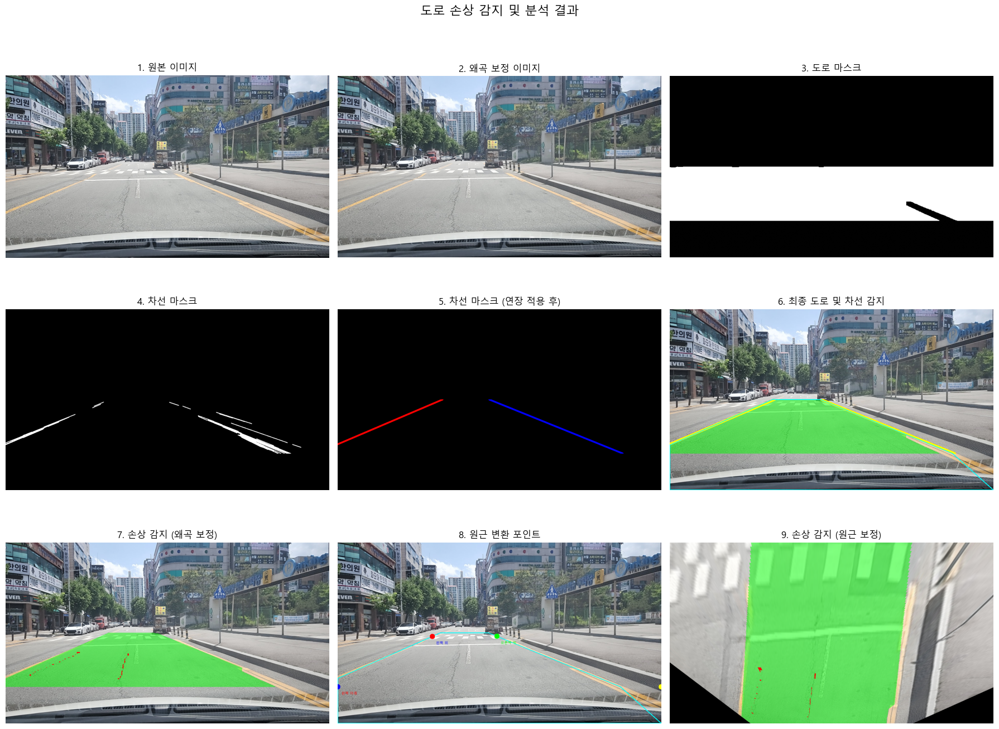

In [18]:
import cv2
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO
import matplotlib.font_manager as fm
import platform

def setup_matplotlib_font():
    """
    운영체제별 matplotlib 한글 기본 폰트 설정 함수

    Process:
    1. 현재 운영체제(Windows, macOS, Linux) 확인
    2. 운영체제에 맞는 한글 폰트 경로 설정
    3. 설정된 폰트를 matplotlib에 적용
    4. 그래프에서 마이너스 기호 깨짐 방지 설정

    Parameters: None
    Returns: None
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    이미지에 한글 텍스트를 표시하는 함수

    Process:
    1. NumPy 배열을 PIL 이미지로 변환
    2. 그리기 객체 생성
    3. 운영체제에 맞는 폰트 설정 및 로드
    4. 텍스트를 이미지에 그리기
    5. PIL 이미지를 NumPy 배열로 변환하여 반환

    Parameters:
        - img (numpy.ndarray) : 텍스트를 추가할 이미지
        - text (str) : 추가할 텍스트
        - position (tuple) : 텍스트를 표시할 위치 (x, y)
        - font_size (float) : 폰트 크기 조절 계수
        - color (tuple) : BGR 형식의 텍스트 색상
        - thickness (int) : 텍스트 두께

    Returns:
        - numpy.ndarray : 텍스트가 추가된 이미지
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def undistort_image(img, calibration_file):
    """
    카메라 캘리브레이션 결과를 사용하여 이미지 왜곡을 보정하는 함수

    Process:
    1. 캘리브레이션 파일에서 카메라 매트릭스와 왜곡 계수 로드
    2. 왜곡 보정에 사용할 새로운 카메라 매트릭스 계산
    3. 이미지 왜곡 보정 적용
    4. ROI 영역 잘라내기
    5. 예외 처리를 통한 오류 관리

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - calibration_file (str) : 캘리브레이션 결과가 저장된 파일 경로

    Returns:
        - undistorted (numpy.ndarray) : 왜곡 보정된 이미지
        - (mtx, dist, roi) (tuple) : 카메라 행렬, 왜곡 계수, ROI 정보
    """
    try:
        # 캘리브레이션 결과 로드
        calibration_data = np.load(calibration_file, allow_pickle=True).item()
        
        # 키 이름 확인 및 수정 부분
        mtx = calibration_data.get('camera_matrix')  # 'mtx' 대신 'camera_matrix'
        dist = calibration_data.get('dist_coeffs')   # 'dist' 대신 'dist_coeffs'
        
        if mtx is None or dist is None:
            raise ValueError("캘리브레이션 데이터에 카메라 행렬 또는 왜곡 계수가 없습니다.")
        
        # 원본 이미지 크기
        h, w = img.shape[:2]
        
        # 왜곡 보정 후 이미지 크기 계산을 위한 새로운 카메라 행렬 얻기
        newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w, h), 1, (w, h))
        
        # 왜곡 보정 적용
        undistorted = cv2.undistort(img, mtx, dist, None, newcameramtx)
        
        # ROI 잘라내기
        if roi[2] > 0 and roi[3] > 0:  # 유효한 ROI 영역이 있는 경우
            x, y, w, h = roi
            undistorted = undistorted[y:y+h, x:x+w]
        
        return undistorted, (mtx, dist, roi)
    except Exception as e:
        print(f"이미지 왜곡 보정 중 오류 발생: {e}")
        return img, (None, None, None)

def create_roi_mask(img, use_roi=True, roi_type="trapezoid"):
    """
    관심 영역(ROI) 마스크를 생성하는 함수

    Process:
    1. 이미지 크기 확인
    2. use_roi 매개변수 확인
    3. roi_type에 따라 다른 형태의 마스크 생성
        - trapezoid: 사다리꼴 모양 (기본값)
        - middle_strip: 이미지 중간 영역만 선택

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_type (str) : ROI 마스크 타입 ("trapezoid", "middle_strip")

    Returns:
        - roi_mask (numpy.ndarray) : 생성된 ROI 마스크
    """
    height, width = img.shape[:2]
    roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    if not use_roi:
        return roi_mask
    
    if roi_type == "trapezoid":
        # 사다리꼴 ROI - 일반적인 도로 영역
        roi_points = np.array([
            [width * 0.1, height],              # 좌하단
            [width * 0.9, height],              # 우하단
            [width * 0.7, height * 0.4],        # 우상단
            [width * 0.3, height * 0.4]         # 좌상단
        ], dtype=np.int32)
        
        # 빈 마스크 생성 및 ROI 영역만 255로 채우기
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        cv2.fillPoly(roi_mask, [roi_points], 255)
    
    elif roi_type == "middle_strip":
        # 상단 n%와 하단 m%를 삭제하고 중간 (100 - m - n)%만 사용
        top = 0.5
        bottom = 0.2
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        top_boundary = int(height * top)
        bottom_boundary = int(height * (1 - bottom))
        roi_mask[top_boundary:bottom_boundary, :] = 255
    
    return roi_mask

def extract_road_mask(img, use_roi=True, roi_mask=None):
    """
    이미지에서 도로 영역을 추출하는 함수

    Process:
    1. ROI 마스크 확인 및 생성
    2. 가우시안 블러로 노이즈 제거
    3. HSV 색상 공간으로 변환 (색상(Hue), 채도(Saturation), 명도(Value)) : 색상 분할에 효과적
    4. 다양한 도로 색상 범위에 대한 마스크 생성 (회색, 어두운, 밝은 도로)
    5. 모든 마스크 결합 및 ROI 적용
    6. 모폴로지 연산으로 노이즈 제거 및 도로 영역 연결
    7. 유의미한 크기의 연결 요소만 선택
    8. 홍수 채우기 알고리즘으로 가장 가능성 높은 도로 영역 선택

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_mask (numpy.ndarray) : 사전에 정의된 ROI 마스크

    Returns:
        - road_mask (numpy.ndarray) : 도로 영역 마스크
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위
    # 일반 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 70])
    upper_gray_road = np.array([180, 30, 170])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 40])
    upper_dark_road = np.array([180, 25, 100])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 140])
    upper_light_road = np.array([180, 35, 220])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # ROI 적용
    if use_roi:
        road_mask = cv2.bitwise_and(road_mask, roi_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

def detect_lane_lines(img, use_roi=True, roi_mask=None):
    """
    이미지에서 차선을 감지하고 마스크를 생성하는 함수

    Process:
    1. 이미지 전처리 (그레이스케일 변환, 블러, 캐니 엣지 검출)
    2. ROI 마스크 적용
    3. 색상 기반 차선 추출 (흰색/노란색)
    4. 엣지와 색상 마스크 결합
    5. 호프 변환으로 직선 검출
    6. 기울기 기반으로 왼쪽/오른쪽 차선 분류
    7. 각 차선의 가장 긴 선분 선택 및 연장
    8. 차선 마스크 생성 및 병합

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_mask (numpy.ndarray) : 사전에 정의된 ROI 마스크

    Returns:
        - extended_lane_mask (numpy.ndarray) : 연장된 차선 마스크
        - left_line_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_line_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - masked_edges (numpy.ndarray) : 엣지 마스크 (ROI 적용)
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # ROI 마스크가 비어있는지 확인
    if use_roi and np.count_nonzero(roi_mask) == 0:
        print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 사용합니다.")
        roi_mask = create_roi_mask(img, use_roi=True, roi_type="trapezoid")
    
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    if use_roi:
        color_mask = cv2.bitwise_and(color_mask, roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # RANSAC 적용 전 차선 마스크 (시각화 용도)
    original_lane_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_lines = []
    right_lines = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                # 원본 마스크에 모든 유효한 선분 추가
                cv2.line(original_lane_mask, (x1, y1), (x2, y2), 255, 2)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    left_lines.append((x1, y1, x2, y2, slope, line_length))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    right_lines.append((x1, y1, x2, y2, slope, line_length))
    
    # 확장된 차선 마스크 생성 (이 마스크만 최종 결과로 사용)
    extended_lane_mask = np.zeros_like(gray)
    
    # ROI 영역의 y 좌표 범위 계산
    if use_roi:
        roi_indices = np.where(roi_mask > 0)
        if len(roi_indices[0]) > 0:  # ROI 영역이 비어있지 않은 경우
            min_y_roi = np.min(roi_indices[0])
            max_y_roi = np.max(roi_indices[0])
        else:  # ROI 영역이 비어있는 경우
            min_y_roi = 0
            max_y_roi = height - 1
    else:
        min_y_roi = 0
        max_y_roi = height - 1
    
    # 왼쪽 차선 처리 - 가장 긴 선분 선택
    if left_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_left = sorted(left_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_left
        
        # 차선 연장을 위한 직선 방정식 계산
        # y = m*x + b, b = y - m*x
        b = y1 - slope * x1
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 왼쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            left_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            left_line_mask = left_line_mask_roi
        else:
            left_line_mask = temp_mask
    
    # 오른쪽 차선 처리 - 가장 긴 선분 선택
    if right_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_right = sorted(right_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_right
        
        # 차선 연장을 위한 직선 방정식 계산
        b = y1 - slope * x1
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 오른쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            right_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            right_line_mask = right_line_mask_roi
        else:
            right_line_mask = temp_mask
    
    # 전체 차선 마스크 통합
    extended_lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 확장된 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    extended_lane_mask = cv2.dilate(extended_lane_mask, kernel, iterations=1)
    
    # ROI 내에서만 원본 차선 마스크 적용
    if use_roi:
        original_lane_mask = cv2.bitwise_and(original_lane_mask, roi_mask)
    
    # 연장된 가장 긴 선분만을 차선으로 인식하여 반환
    return extended_lane_mask, left_line_mask, right_line_mask, original_lane_mask, masked_edges

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역을 추출하는 함수

    Process:
    1. 왼쪽과 오른쪽 차선의 윤곽선 검출
    2. 차선 마스크 유효성 검사
    3. 각 차선의 외곽점 계산 (상단/하단)
    4. 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    5. 폴리곤 기반 도로 영역 마스크 생성
    6. 원래 도로 마스크와 교차 연산

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크

    Returns:
        - final_road_mask (numpy.ndarray) : 차선 내부의 도로 마스크
        - road_polygon (numpy.ndarray) : 도로 폴리곤 좌표 배열
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def extract_road_corners_direct(road_lane_mask, roi_mask=None):
    """
    도로 마스크에서 코너 포인트를 직접 추출하는 함수

    Process:
    1. 마스크 유효성 검사
    2. 마스크의 픽셀 좌표 추출
    3. y값 기준으로 상위 1%와 하위 1%의 픽셀 선택
    4. 선택된 픽셀 중 x 좌표 기준으로 좌/우 지점 결정
    5. ROI 영역 내로 코너 포인트 조정
    6. 최종 코너 포인트 반환

    Parameters:
        - road_lane_mask (numpy.ndarray) : 차선 내 도로 마스크
        - roi_mask (numpy.ndarray) : ROI 마스크 (선택적)

    Returns:
        - numpy.ndarray : 변환에 사용할 4개의 포인트 (좌상, 우상, 좌하, 우하)
    """
    height, width = road_lane_mask.shape
    
    # 1. 마스크가 비어있는지 확인
    if np.count_nonzero(road_lane_mask) < 10:  # 최소 10픽셀 이상은 필요
        # 기본 사각형 반환 (ROI가 있다면 ROI 기반, 없다면 이미지 전체)
        if roi_mask is not None and np.count_nonzero(roi_mask) > 0:
            roi_y, roi_x = np.where(roi_mask > 0)
            roi_min_x = np.min(roi_x)
            roi_max_x = np.max(roi_x)
            roi_min_y = np.min(roi_y)
            roi_max_y = np.max(roi_y)
            
            return np.float32([
                [roi_min_x, roi_min_y],  # 좌상단
                [roi_max_x, roi_min_y],  # 우상단
                [roi_min_x, roi_max_y],  # 좌하단
                [roi_max_x, roi_max_y]   # 우하단
            ])
        else:
            return np.float32([
                [0, 0],               # 좌상단
                [width-1, 0],         # 우상단
                [0, height-1],        # 좌하단
                [width-1, height-1]   # 우하단
            ])
    
    # 2. 마스크 픽셀 좌표 가져오기
    y_indices, x_indices = np.where(road_lane_mask > 0)
    
    if len(y_indices) == 0:
        return np.float32([
            [0, 0],               # 좌상단
            [width-1, 0],         # 우상단
            [0, height-1],        # 좌하단
            [width-1, height-1]   # 우하단
        ])
    
    # 3. y값으로 상위 1%와 하위 1% 지점 선택
    y_sorted_indices = np.argsort(y_indices)
    
    # 상단 1% 인덱스
    top_count = max(1, int(len(y_indices) * 0.01))
    top_indices = y_sorted_indices[:top_count]
    
    # 하단 1% 인덱스
    bottom_indices = y_sorted_indices[-top_count:]
    
    # 4. 상위 지점들 중에서 x 좌표로 좌/우 결정
    top_x_values = x_indices[top_indices]
    top_y_values = y_indices[top_indices]
    
    if len(top_x_values) > 0:
        # 상단 지점 중 가장 왼쪽 지점
        top_left_idx = np.argmin(top_x_values)
        left_top = np.array([top_x_values[top_left_idx], top_y_values[top_left_idx]], dtype=np.float32)
        
        # 상단 지점 중 가장 오른쪽 지점
        top_right_idx = np.argmax(top_x_values)
        right_top = np.array([top_x_values[top_right_idx], top_y_values[top_right_idx]], dtype=np.float32)
    else:
        left_top = np.array([0, 0], dtype=np.float32)
        right_top = np.array([width-1, 0], dtype=np.float32)
    
    # 5. 하위 지점들 중에서 x 좌표로 좌/우 결정
    bottom_x_values = x_indices[bottom_indices]
    bottom_y_values = y_indices[bottom_indices]
    
    if len(bottom_x_values) > 0:
        # 하단 지점 중 가장 왼쪽 지점
        bottom_left_idx = np.argmin(bottom_x_values)
        left_bottom = np.array([bottom_x_values[bottom_left_idx], bottom_y_values[bottom_left_idx]], dtype=np.float32)
        
        # 하단 지점 중 가장 오른쪽 지점
        bottom_right_idx = np.argmax(bottom_x_values)
        right_bottom = np.array([bottom_x_values[bottom_right_idx], bottom_y_values[bottom_right_idx]], dtype=np.float32)
    else:
        left_bottom = np.array([0, height-1], dtype=np.float32)
        right_bottom = np.array([width-1, height-1], dtype=np.float32)
    
    # 6. ROI 마스크가 제공된 경우, 코너 포인트가 ROI 내에 있는지 확인
    if roi_mask is not None:
        roi_y_indices, roi_x_indices = np.where(roi_mask > 0)
        
        if len(roi_y_indices) > 0:
            # ROI의 경계 구하기
            roi_min_x = np.min(roi_x_indices)
            roi_max_x = np.max(roi_x_indices)
            roi_min_y = np.min(roi_y_indices)
            roi_max_y = np.max(roi_y_indices)
            
            # 코너 포인트가 ROI 내에 있도록 조정
            left_top[0] = max(roi_min_x, min(roi_max_x, left_top[0]))
            left_top[1] = max(roi_min_y, min(roi_max_y, left_top[1]))
            right_top[0] = max(roi_min_x, min(roi_max_x, right_top[0]))
            right_top[1] = max(roi_min_y, min(roi_max_y, right_top[1]))
            left_bottom[0] = max(roi_min_x, min(roi_max_x, left_bottom[0]))
            left_bottom[1] = max(roi_min_y, min(roi_max_y, left_bottom[1]))
            right_bottom[0] = max(roi_min_x, min(roi_max_x, right_bottom[0]))
            right_bottom[1] = max(roi_min_y, min(roi_max_y, right_bottom[1]))
    
    # 최종 코너 포인트 반환
    return np.float32([left_top, right_top, left_bottom, right_bottom])

def perspective_transform_direct(img, road_lane_mask, roi_mask=None):
    """
    도로 마스크에서 추출한 코너 포인트로 원근 변환을 수행하는 함수

    Process:
    1. 도로 마스크에서 코너 포인트 추출
    2. 변환 대상 포인트 설정 (직사각형)
    3. 원근 변환 행렬 계산
    4. 이미지와 마스크에 원근 변환 적용

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - road_lane_mask (numpy.ndarray) : 차선 내 도로 마스크
        - roi_mask (numpy.ndarray) : ROI 마스크 (선택적)

    Returns:
        - warped_img (numpy.ndarray) : 원근 변환된 이미지
        - warped_mask (numpy.ndarray) : 원근 변환된 마스크
        - M (numpy.ndarray) : 원근 변환 행렬
        - src_points (numpy.ndarray) : 원본 이미지에서의 소스 포인트
    """
    height, width = road_lane_mask.shape
    
    # 도로 마스크에서 직접 코너 포인트 추출
    src_points = extract_road_corners_direct(road_lane_mask, roi_mask)
    
    # 변환 대상 포인트 설정 (직사각형)
    dst_points = np.float32([
        [width / 4, 0],                 # 왼쪽 상단
        [width / 4 * 3, 0],             # 오른쪽 상단
        [width / 4, height],            # 왼쪽 하단
        [width / 4 * 3, height]         # 오른쪽 하단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(road_lane_mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def apply_yolo_on_masked_area(model, img, mask):
    """
    마스크된 영역에서 YOLO 모델로 도로 손상을 감지하는 함수

    Process:
    1. 마스크를 3채널 이미지로 변환
    2. 원본 이미지에 마스크 적용
    3. YOLO 모델로 객체 감지 수행
    4. 감지된 객체별로 마스크 생성 (균열, 포트홀)
    5. 클래스별 마스크 반환

    Parameters:
        - model : 로드된 YOLO 모델
        - img (numpy.ndarray) : 원본 이미지
        - mask (numpy.ndarray) : 도로 영역 마스크

    Returns:
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
    """
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

def calculate_lrpci(crack_ratio, pothole_ratio, crack_severity, crack_type, pothole_info):
    """
    도로 포장 상태를 평가하는 LrPCI(Local road Pavement Condition Index) 계산 함수

    Process:
    1. 기본 점수 설정 (완벽한 상태 = 100)
    2. 포트홀 감점 계산 (직경, 개수, 면적에 따른 감점)
    3. 균열 감점 계산 (유형, 면적, 심각도에 따른 감점)
    4. 총 감점 계산 및 최종 점수 도출

    Parameters:
        - crack_ratio (float) : 0~1 사이의 균열율
        - pothole_ratio (float) : 0~1 사이의 포트홀 비율
        - crack_severity (float) : 0~1 사이의 균열 심각도
        - crack_type (str) : 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_info (dict) : 포트홀 정보 (개수, 최대 직경 등)

    Returns:
        - lrpci (float) : 0~100 사이의 LrPCI 값
    """
    # 기본값 설정: 완벽한 상태의 도로는 100점에서 시작
    base_score = 100
    
    # 포트홀 감점 계산 (포트홀이 있으면 더 많은 감점)
    pothole_deduction = 0
    if pothole_ratio > 0:
        pothole_count = pothole_info.get('potholes_count', 0)
        max_diameter_cm = pothole_info.get('max_diameter_cm', 0)
        
        # 포트홀 직경에 따른 심각도 분류
        if max_diameter_cm >= 30:  # 심각: 30cm 이상은 심각한 포트홀
            pothole_deduction = 30 + (pothole_count * 2.5)  # 기본 30점 감점, 추가 포트홀당 2.5점 추가 감점
        elif max_diameter_cm >= 15:  # 중간: 15~30cm는 중간 수준
            pothole_deduction = 15 + (pothole_count * 2)    # 기본 15점 감점, 추가 포트홀당 2점 추가 감점
        else:  # 경미: 15cm 미만은 경미한 수준
            pothole_deduction = 5 + (pothole_count * 1.5)   # 기본 5점 감점, 추가 포트홀당 1.5점 추가 감점
            
        # 포트홀 면적 비율이 높으면 추가 감점
        pothole_deduction += pothole_ratio * 100 * 0.3
        
        # 최대 감점은 40점으로 제한
        pothole_deduction = min(pothole_deduction, 40)
    
    # 균열 감점 계산
    crack_deduction = 0
    if crack_ratio > 0:
        # 균열 유형에 따른 가중치 설정
        crack_type_weights = {
            "선형 균열": 1.0,       # 선형 균열은 기본 가중치
            "블록형 균열": 1.5,     # 블록형 균열은 더 심각
            "악어 균열": 2.0,       # 악어 균열은 가장 심각
            "없음": 0
        }
        
        crack_type_weight = crack_type_weights.get(crack_type, 1.0)
        
        # 균열 면적 비율과 심각도, 유형에 따른 감점
        if crack_ratio >= 0.5:  # 50% 이상은 심각
            crack_deduction = 25 * crack_type_weight
        elif crack_ratio >= 0.2:  # 20~50%는 중간
            crack_deduction = 15 * crack_type_weight
        else:  # 20% 미만은 경미
            crack_deduction = 5 * crack_type_weight
            
        # 균열 면적과 심각도에 따른 추가 감점
        crack_deduction += (crack_ratio * 100 * 0.2) + (crack_severity * 10)
        
        # 최대 감점은 25점으로 제한
        crack_deduction = min(crack_deduction, 25)
    
    # 총 감점 계산
    total_deduction = pothole_deduction + crack_deduction
    
    # 최종 LrPCI 계산 (최소값은 0)
    lrpci = max(0, base_score - total_deduction)
    
    return round(lrpci, 2)

def get_lrpci_grade(lrpci):
    """
    LrPCI 점수에 따른 도로 상태 등급을 반환하는 함수

    Process:
    1. LrPCI 값에 따라 등급 구분
        - 0~39: 심각
        - 40~59: 위험
        - 60~79: 주의
        - 80~100: 안전
    2. 각 등급에 맞는 상세 설명 반환

    Parameters:
        - lrpci (float) : 0~100 사이의 LrPCI 값

    Returns:
        - grade (str) : 등급 (심각, 위험, 주의, 안전)
        - description (str) : 상세 설명
    """
    if lrpci < 40:
        return "심각", "도로기능 상실, 심한 파손"
    elif lrpci < 60:
        return "위험", "중간 수준 이상 손상, 포트홀 시작, 균열 확산"
    elif lrpci < 80:
        return "주의", "경미한 손상 다수, 초기에 균열/요철 발견됨"
    else:
        return "안전", "양호 상태, 기능 이상 없음"

def determine_repair_method(lrpci, crack_ratio, crack_type, pothole_has_emergency):
    """
    도로 상태 평가를 바탕으로 보수 방법과 우선순위를 결정하는 함수

    Process:
    1. LrPCI 등급 확인
    2. 응급 포트홀 상황 확인 (최우선 처리)
    3. 등급, 균열 비율, 균열 유형에 따른 보수 방법 결정
    4. 우선순위 설정 (긴급, 단기, 정기, 모니터링)

    Parameters:
        - lrpci (float) : 0~100 사이의 LrPCI 값
        - crack_ratio (float) : 0~1 사이의 균열율
        - crack_type (str) : 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_has_emergency (bool) : 응급 보수가 필요한 포트홀 존재 여부

    Returns:
        - method (str) : 권장 보수 방법
        - priority (str) : 보수 우선순위
    """
    # 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    
    # 응급 포트홀이 있는 경우 최우선 처리
    if pothole_has_emergency:
        return "포트홀 응급 보수 후 추가 조사 필요", "최우선(응급)"
    
    # LrPCI 등급 기반 보수 방법
    if grade == "심각":  # 0~39점
        priority = "긴급"
        if crack_type == "악어 균열" or crack_ratio >= 0.5:
            method = "기층까지 20cm 절삭 후 재포장 (구조적 손상 의심)"
        else:
            method = "기층까지 20cm 절삭 후 재포장"
            
    elif grade == "위험":  # 40~59점
        priority = "단기"
        if crack_type == "블록형 균열" or (crack_ratio >= 0.2 and crack_ratio < 0.5):
            method = "중간층 10cm 절삭 후 재포장 (균열 확산 방지 필요)"
        else:
            method = "부분 패치 및 포장 보수"
            
    elif grade == "주의":  # 60~79점
        priority = "정기"
        if crack_type == "선형 균열" and crack_ratio < 0.2:
            method = "균열 실링 및 표층 5cm 절삭 덧씌우기"
        else:
            method = "예방적 유지관리 및 표층 보수"
            
    else:  # 안전, 80~100점
        priority = "모니터링"
        method = "정기 점검 및 모니터링 (현재 보수 불필요)"
    
    return method, priority

def check_pothole_emergency(pothole_mask, pixel_to_cm_ratio=1.0):
    """
    포트홀 마스크를 분석하여 응급 보수 필요성을 판단하는 함수

    Process:
    1. 포트홀 존재 여부 확인
    2. 연결 요소 레이블링으로 개별 포트홀 분석
    3. 포트홀의 직경, 면적 등 계산
    4. 픽셀 단위를 실제 거리(cm)로 변환
    5. 직경 30cm 이상 또는 면적 700cm² 이상인 경우 응급 상황으로 판단

    Parameters:
        - pothole_mask (numpy.ndarray) : 포트홀 마스크
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율

    Returns:
        - is_emergency (bool) : 응급 보수 필요 여부
        - pothole_info (dict) : 포트홀 정보 (최대 직경, 총 면적, 개수, 심각도 등)
    """
    # 포트홀이 없는 경우
    if np.count_nonzero(pothole_mask) == 0:
        return False, {"max_diameter_cm": 0, "potholes_count": 0, "total_area_cm2": 0}
    
    # 연결 요소 레이블링
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(pothole_mask)
    
    # 배경을 제외한 각 포트홀 분석
    max_diameter_pixels = 0
    total_area_pixels = 0
    potholes_count = num_labels - 1  # 배경 제외
    potholes_data = []
    
    for i in range(1, num_labels):  # 0은 배경
        # 포트홀 너비와 높이
        width = stats[i, cv2.CC_STAT_WIDTH]
        height = stats[i, cv2.CC_STAT_HEIGHT]
        area = stats[i, cv2.CC_STAT_AREA]
        
        # 대략적인 직경 계산 (타원 형태 가정)
        diameter = max(width, height)
        max_diameter_pixels = max(max_diameter_pixels, diameter)
        total_area_pixels += area
        
        # 개별 포트홀 정보 저장
        potholes_data.append({
            "center_x": centroids[i][0],
            "center_y": centroids[i][1],
            "width": width,
            "height": height,
            "area": area,
            "diameter": diameter
        })
    
    # 픽셀을 센티미터로 변환
    max_diameter_cm = max_diameter_pixels * pixel_to_cm_ratio
    total_area_cm2 = total_area_pixels * (pixel_to_cm_ratio ** 2)
    
    # 응급 보수 조건: 직경 30cm 이상 또는 면적이 매우 큰 경우
    is_emergency = max_diameter_cm >= 30 or total_area_cm2 >= 700
    
    # 포트홀 심각도 추정
    if max_diameter_cm >= 30:
        severity = "심각"
    elif max_diameter_cm >= 15:
        severity = "중간"
    else:
        severity = "경미"
    
    return is_emergency, {
        "max_diameter_cm": round(max_diameter_cm, 1),
        "potholes_count": potholes_count,
        "total_area_cm2": round(total_area_cm2, 1),
        "severity": severity,
        "potholes_data": potholes_data
    }

def analyze_crack_severity(crack_mask, pixel_to_cm_ratio=1.0):
    """
    균열 마스크를 분석하여 심각도와 유형을 평가하는 함수

    Process:
    1. 균열 존재 여부 확인
    2. 연결 요소 레이블링으로 개별 균열 분석
    3. 균열의 길이, 폭, 종횡비 등 계산
    4. 종횡비를 기반으로 균열 유형 결정 (선형, 블록형, 악어 균열)
    5. 유형별 심각도 계산 및 등급 분류

    Parameters:
        - crack_mask (numpy.ndarray) : 균열 마스크
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율

    Returns:
        - severity (float) : 심각도 점수 (0~1)
        - crack_type (str) : 균열 유형
        - crack_info (dict) : 균열 상세 정보 (길이, 폭, 개수, 심각도 등급 등)
    """
    # 균열이 없는 경우
    if np.count_nonzero(crack_mask) == 0:
        return 0, "없음", {"total_length_cm": 0, "avg_width_cm": 0, "crack_count": 0}
    
    # 연결 요소 레이블링
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(crack_mask)
    
    # 균열 형태 분석을 위한 변수 초기화
    total_area_pixels = 0
    max_length_pixels = 0
    total_max_length_pixels = 0
    crack_widths_pixels = []
    aspect_ratios = []
    crack_count = num_labels - 1  # 배경 제외
    
    for i in range(1, num_labels):  # 0은 배경
        area = stats[i, cv2.CC_STAT_AREA]
        width = stats[i, cv2.CC_STAT_WIDTH]
        height = stats[i, cv2.CC_STAT_HEIGHT]
        
        total_area_pixels += area
        
        # 균열의 실제 길이 추정 (단순 근사: 긴 쪽이 길이)
        length = max(width, height)
        max_length_pixels = max(max_length_pixels, length)
        total_max_length_pixels += length
        
        # 균열 폭 추정
        aspect_ratio = max(width, height) / (min(width, height) if min(width, height) > 0 else 1)
        aspect_ratios.append(aspect_ratio)
        
        # 선형 균열로 판단되는 경우 폭 추정
        if aspect_ratio > 3:  # 선형 균열로 판단
            est_width = min(width, height)
            crack_widths_pixels.append(est_width)
    
    # 균열의 평균 폭 계산
    avg_width_pixels = np.mean(crack_widths_pixels) if crack_widths_pixels else 1
    
    # 픽셀 단위를 센티미터 단위로 변환
    total_length_cm = total_max_length_pixels * pixel_to_cm_ratio
    max_length_cm = max_length_pixels * pixel_to_cm_ratio
    avg_width_cm = avg_width_pixels * pixel_to_cm_ratio
    
    # 균열 유형 결정
    if len(aspect_ratios) == 0:
        crack_type = "없음"
        severity = 0
    elif np.mean(aspect_ratios) > 5:
        crack_type = "선형 균열"
        # 선형 균열의 심각도는 길이와 폭에 비례
        severity = min(1.0, (max_length_cm / 100) * (avg_width_cm / 2))
    elif np.std(aspect_ratios) < 1.5 and len(aspect_ratios) > 5:
        crack_type = "악어 균열"
        # 악어 균열은 일반적으로 심각도가 높음
        severity = min(1.0, 0.7 + (total_area_pixels * (pixel_to_cm_ratio ** 2) / 2000) * 0.3)
    else:
        crack_type = "블록형 균열"
        # 블록형 균열의 심각도는 균열 간 연결성과 전체 면적에 비례
        severity = min(1.0, 0.4 + (total_area_pixels * (pixel_to_cm_ratio ** 2) / 1000) * 0.6)
    
    # 심각도 등급 분류
    if severity >= 0.7:
        severity_grade = "심각"
    elif severity >= 0.4:
        severity_grade = "중간"
    else:
        severity_grade = "경미"
    
    return severity, crack_type, {
        "total_length_cm": round(total_length_cm, 1),
        "max_length_cm": round(max_length_cm, 1),
        "avg_width_cm": round(avg_width_cm, 2),
        "crack_count": crack_count,
        "severity_grade": severity_grade
    }

def estimate_pixel_to_cm_ratio(left_lane_mask, right_lane_mask, standard_lane_width_cm=350):
    """
    차선 폭을 기반으로 픽셀 대 센티미터 비율을 추정하는 함수

    Process:
    1. 차선 마스크 유효성 확인
    2. 각 차선의 중심점 계산
    3. 차선 간 거리(픽셀) 계산
    4. 표준 차선 폭을 사용하여 비율 계산

    Parameters:
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - standard_lane_width_cm (float) : 표준 차선 폭(cm), 기본값 350cm (3.5m)

    Returns:
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율
    """
    # 차선 마스크가 유효하지 않은 경우
    if np.count_nonzero(left_lane_mask) == 0 or np.count_nonzero(right_lane_mask) == 0:
        return 1.0  # 기본값 반환
    
    # 각 차선의 중심선 추출
    left_indices = np.where(left_lane_mask > 0)
    right_indices = np.where(right_lane_mask > 0)
    
    if len(left_indices[1]) == 0 or len(right_indices[1]) == 0:
        return 1.0
    
    # 각 차선의 중심 좌표 계산
    left_center_x = np.mean(left_indices[1])
    right_center_x = np.mean(right_indices[1])
    
    # 차선 간 거리 계산 (픽셀)
    lane_width_pixels = right_center_x - left_center_x
    
    if lane_width_pixels <= 0:
        return 1.0  # 유효하지 않은 경우 기본값 반환
    
    # 픽셀 대 센티미터 비율 계산
    pixel_to_cm_ratio = standard_lane_width_cm / lane_width_pixels
    
    return pixel_to_cm_ratio

def save_analysis_results(road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
                         lrpci, crack_info, pothole_info, repair_method, priority, img_num, is_warped_based=True):
    """
    도로 손상 분석 결과를 텍스트 파일로 저장하는 함수

    Process:
    1. 결과 디렉토리 생성
    2. 원본 및 원근 변환 이미지의 손상 비율 계산
    3. LrPCI 등급 확인
    4. 균열 및 포트홀 정보, 보수 방법 등 결과 텍스트 파일 작성

    Parameters:
        - road_area (int) : 원본 이미지의 도로 면적(픽셀)
        - crack_area (int) : 원본 이미지의 균열 면적(픽셀)
        - pothole_area (int) : 원본 이미지의 포트홀 면적(픽셀)
        - warped_road_area (int) : 원근 보정 이미지의 도로 면적(픽셀)
        - warped_crack_area (int) : 원근 보정 이미지의 균열 면적(픽셀)
        - warped_pothole_area (int) : 원근 보정 이미지의 포트홀 면적(픽셀)
        - lrpci (float) : LrPCI 점수
        - crack_info (dict) : 균열 상세 정보
        - pothole_info (dict) : 포트홀 상세 정보
        - repair_method (str) : 권장 보수 방법
        - priority (str) : 보수 우선순위
        - img_num (str) : 이미지 번호
        - is_warped_based (bool) : 원근 보정 이미지 기반 분석 여부

    Returns: None
    """
    # 결과 저장 경로
    result_dir = '../result/'
    
    # 디렉토리가 없으면 생성
    os.makedirs(result_dir, exist_ok=True)
    
    # 파일 경로 설정
    file_path = os.path.join(result_dir, f'analysis_result_{img_num}.txt')
    
    # 균열률과 포트홀 비율 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    
    # 원근 보정된 이미지의 손상 비율 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    
    # LrPCI 등급 획득
    grade, description = get_lrpci_grade(lrpci)
    
    # 결과 작성
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(f"도로 영역 분석 결과 (원본 이미지):\n")
        f.write(f"도로 면적: {road_area} 픽셀\n")
        f.write(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)\n")
        f.write(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)\n")
        f.write(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_ratio + pothole_ratio)*100:.2f}%)\n\n")
        
        f.write(f"도로 영역 분석 결과 (원근 보정된 이미지):\n")
        f.write(f"도로 면적: {warped_road_area} 픽셀\n")
        f.write(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)\n")
        f.write(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)\n")
        f.write(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_ratio + warped_pothole_ratio)*100:.2f}%)\n\n")
        
        f.write(f"평가 결과 - {'원근 보정된 이미지 기반' if is_warped_based else '원본 이미지 기반'}:\n")
        f.write(f"LrPCI 평가 점수: {lrpci}/100.00\n")
        f.write(f"LrPCI 등급: {grade} ({description})\n")
        
        # 균열 정보 출력
        if crack_info:
            f.write(f"균열 길이: {crack_info.get('total_length_cm', 0):.1f}cm\n")
            f.write(f"균열 최대 길이: {crack_info.get('max_length_cm', 0):.1f}cm\n")
            f.write(f"균열 평균 폭: {crack_info.get('avg_width_cm', 0):.2f}cm\n")
            f.write(f"균열 개수: {crack_info.get('crack_count', 0)}개\n")
            f.write(f"균열 심각도 등급: {crack_info.get('severity_grade', '알 수 없음')}\n")
        
        # 포트홀 정보 출력
        f.write(f"최대 포트홀 직경: {pothole_info.get('max_diameter_cm', 0):.1f}cm\n")
        f.write(f"포트홀 개수: {pothole_info.get('potholes_count', 0)}개\n")
        f.write(f"포트홀 총 면적: {pothole_info.get('total_area_cm2', 0):.1f}cm²\n")
        f.write(f"포트홀 심각도: {pothole_info.get('severity', '알 수 없음')}\n\n")
        
        f.write(f"권장 보수 방법: {repair_method}\n")
        f.write(f"보수 우선순위: {priority}\n")
    
    print(f"분석 결과가 {file_path}에 저장되었습니다.")

def visualize_results(original_img, undistorted_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     original_lane_mask, img_num=None, pixel_to_cm_ratio=1.0):
    """
    도로 손상 감지 및 분석 결과를 시각화하는 함수

    Process:
    1. 3x3 그리드로 9개 이미지 구성 (원본, 왜곡 보정, 도로 마스크 등)
    2. 도로 및 손상 영역 시각화
    3. 손상 면적 및 비율 계산
    4. 균열 심각도 및 포트홀 응급 상황 분석
    5. LrPCI 계산 및 보수 방법 결정
    6. 분석 결과 출력 및 저장

    Parameters:
        - original_img (numpy.ndarray) : 원본 이미지
        - undistorted_img (numpy.ndarray) : 왜곡 보정된 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - lane_mask (numpy.ndarray) : 차선 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - road_lane_mask (numpy.ndarray) : 차선 내부 도로 마스크
        - road_polygon (numpy.ndarray) : 도로 폴리곤 좌표
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
        - warped_img (numpy.ndarray) : 원근 변환된 이미지
        - warped_mask (numpy.ndarray) : 원근 변환된 도로 마스크
        - warped_crack (numpy.ndarray) : 원근 변환된 균열 마스크
        - warped_pothole (numpy.ndarray) : 원근 변환된 포트홀 마스크
        - corner_points (numpy.ndarray) : 원근 변환 코너 포인트
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - img_num (str) : 이미지 번호 (저장 시 사용)
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율

    Returns:
        - lrpci (float) : LrPCI 점수
        - warped_crack_ratio (float) : 원근 보정된 이미지의 균열 비율
        - warped_pothole_ratio (float) : 원근 보정된 이미지의 포트홀 비율
        - crack_severity (float) : 균열 심각도
        - crack_type (str) : 균열 유형
        - crack_info (dict) : 균열 상세 정보
        - pothole_info (dict) : 포트홀 상세 정보
        - repair_method (str) : 권장 보수 방법
        - priority (str) : 보수 우선순위
    """
    plt.figure(figsize=(18, 14))
   
    # 1. 원본 이미지
    plt.subplot(3, 3, 1)
    plt.imshow(original_img)
    plt.title('1. 원본 이미지')
    plt.axis('off')

    # 2. 왜곡 보정 이미지
    plt.subplot(3, 3, 2)
    plt.imshow(undistorted_img)
    plt.title('2. 왜곡 보정 이미지')
    plt.axis('off')
    
    # 3. 도로 마스크
    plt.subplot(3, 3, 3)
    plt.imshow(road_mask, cmap='gray')
    plt.title('3. 도로 마스크')
    plt.axis('off')
    
    # 4. 차선 마스크 (RANSAC 적용 전)
    plt.subplot(3, 3, 4)
    plt.imshow(original_lane_mask, cmap='gray')  # RANSAC 적용 전 차선 마스크
    plt.title('4. 차선 마스크')
    plt.axis('off')
    
    # 5. 차선 마스크 (RANSAC 적용 후)
    plt.subplot(3, 3, 5)
    lane_combined = np.zeros((undistorted_img.shape[0], undistorted_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('5. 차선 마스크 (연장 적용 후)')
    plt.axis('off')
    
    # 6. 최종 도로 및 차선 감지
    plt.subplot(3, 3, 6)
    road_overlay = undistorted_img.copy()
    alpha = 0.5
    
    # 도로 영역 반투명 초록색으로 표시
    road_highlight = road_overlay.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    road_overlay = cv2.addWeighted(road_highlight, alpha, road_overlay, 1-alpha, 0)
    
    # 차선 표시
    road_overlay[lane_mask == 255] = [255, 255, 0]  # 차선: 노란색
    
    # 도로 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(road_overlay, [road_polygon], True, (0, 255, 255), 2)
    
    plt.imshow(road_overlay)
    plt.title('6. 최종 도로 및 차선 감지')
    plt.axis('off')
    
    # 7. 손상 감지 (왜곡 보정)
    plt.subplot(3, 3, 7)
    overlay_undistorted = undistorted_img.copy()
    alpha = 0.5
    road_highlight = overlay_undistorted.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_undistorted = cv2.addWeighted(road_highlight, alpha, overlay_undistorted, 1-alpha, 0)
    overlay_undistorted[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_undistorted[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.imshow(overlay_undistorted)
    plt.title('7. 손상 감지 (왜곡 보정)')
    plt.axis('off')
    
    # 8. 원근 변환 포인트
    plt.subplot(3, 3, 8)
    img_with_points = undistorted_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 위', '오른쪽 위', '왼쪽 아래', '오른쪽 아래']
    
    # 도로 영역 윤곽선
    if road_polygon is not None:
        cv2.polylines(img_with_points, [road_polygon], True, (0, 255, 255), 2)
    
    # 변환 포인트 표시
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    
    plt.imshow(img_with_points)
    plt.title('8. 원근 변환 포인트')
    plt.axis('off')
    
    # 9. 손상 감지 (원근 보정)
    plt.subplot(3, 3, 9)
    overlay_warped = warped_img.copy()
    alpha = 0.5
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_warped[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_warped)
    plt.title('9. 손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 결과", fontsize=16)
    plt.subplots_adjust(top=0.94)
    
    # 원본 이미지에서의 손상 면적 계산
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    # 원본 이미지의 손상률 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    total_damage_ratio = crack_ratio + pothole_ratio
    
    # 원근 보정된 이미지에서의 손상 면적 계산
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    # 원근 보정된 이미지의 손상률 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    warped_total_damage_ratio = warped_crack_ratio + warped_pothole_ratio
    
    # 균열 심각도 분석 - 원근 보정된 이미지 사용
    crack_severity, crack_type, crack_info = analyze_crack_severity(
        cv2.bitwise_and(warped_crack, warped_mask), pixel_to_cm_ratio
    )
    
    # 포트홀 응급 상황 확인 - 원근 보정된 이미지 사용
    is_emergency, pothole_info = check_pothole_emergency(
        cv2.bitwise_and(warped_pothole, warped_mask), 
        pixel_to_cm_ratio
    )
    
    # 원근 보정된 이미지 기반으로 LrPCI 계산
    lrpci = calculate_lrpci(warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, pothole_info)
    
    # 보수 방법 결정 - 원근 보정된 이미지 기반 결과 사용
    repair_method, priority = determine_repair_method(lrpci, warped_crack_ratio, crack_type, is_emergency)
    
    # 원본 이미지 분석 결과 출력
    print(f"\n도로 영역 분석 결과 (왜곡 보정 이미지):")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({total_damage_ratio*100:.2f}%)")
    
    # 원근 보정된 이미지 분석 결과 출력 (LrPCI 포함)
    print(f"\n도로 영역 분석 결과 (원근 보정된 이미지):")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({warped_total_damage_ratio*100:.2f}%)")
    
    # LrPCI 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    print(f"LrPCI 평가 점수: {lrpci}/100.00 ({grade}: {description})")
    print(f"최대 포트홀 직경: {pothole_info['max_diameter_cm']:.1f}cm (응급보수 필요: {'예' if is_emergency else '아니오'})")
    print(f"권장 보수 방법: {repair_method}")
    print(f"보수 우선순위: {priority}")

    # 이미지 번호가 제공된 경우 저장
    if img_num is not None:
        result_dir = '../result/'
        os.makedirs(result_dir, exist_ok=True)
        plt.savefig(os.path.join(result_dir, f'visualization_{img_num}.jpg'), dpi=300, bbox_inches='tight')
        
        # 분석 결과 텍스트 파일로 저장
        save_analysis_results(
            road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
            lrpci, crack_info, pothole_info, repair_method, priority, img_num, 
            is_warped_based=True  # 원근 보정 기반 분석임을 표시
        )
    
    plt.show()
    
    return lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, crack_info, pothole_info, repair_method, priority

def main():
    """
    전체 도로 손상 감지 파이프라인을 실행하는 메인 함수

    Process:
    1. matplotlib 한글 폰트 설정
    2. YOLO 모델 로드
    3. 캘리브레이션 파일 확인 및 이미지 로드
    4. 이미지 왜곡 보정
    5. ROI 설정 및 마스크 생성
    6. 픽셀 대 센티미터 비율 설정 또는 추정
    7. 도로 및 차선 마스크 생성
    8. 마스크된 영역에서 YOLO 모델로 손상 감지
    9. 원근 변환 적용
    10. 결과 시각화 및 분석

    Parameters: None
    Returns: None
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = '../model/last.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 캘리브레이션 파일 경로
    calibration_file = '../model/camera_calibration_result.npy'
    if not os.path.exists(calibration_file):
        print(f"캘리브레이션 파일이 존재하지 않습니다: {calibration_file}")
        print("원본 이미지를 사용합니다.")
        undistorted_bgr = img_bgr
    else:
        print(f"카메라 캘리브레이션 데이터 '{calibration_file}'을(를) 사용합니다.")
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    
    img_bgr = cv2.imread(img_path)
    if img_bgr is None:
        print(f"이미지를 로드할 수 없습니다: {img_path}")
        return
    
    # 이미지 왜곡 보정 적용
    undistorted_bgr, calibration_info = undistort_image(img_bgr, calibration_file)
    mtx, dist, roi = calibration_info
    
    if mtx is None:
        print("캘리브레이션 파일을 로드할 수 없거나 잘못된 형식입니다. 원본 이미지를 사용합니다.")
        undistorted_bgr = img_bgr
    else:
        print("카메라 캘리브레이션을 적용하여 이미지 왜곡을 보정했습니다.")
    
    # BGR -> RGB 변환
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    undistorted_rgb = cv2.cvtColor(undistorted_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = undistorted_rgb.shape[:2]
    
    # ROI 사용 여부 설정
    use_roi = input("ROI를 사용하시겠습니까? (y/n): ").lower() == 'y'
    
    # ROI 마스크 생성
    roi_mask = None
    if use_roi:
        roi_type = input("ROI 타입을 선택하세요 (1: trapezoid, 2: middle_strip): ")
        if roi_type == "1":
            roi_type = "trapezoid"
        elif roi_type == "2":
            roi_type = "middle_strip"
        else:
            roi_type = "trapezoid"  # 기본값
        
        roi_mask = create_roi_mask(undistorted_bgr, use_roi=True, roi_type=roi_type)
        print(f"ROI 타입 '{roi_type}'을(를) 적용했습니다.")
        
        # ROI가 비어있는지 확인
        if np.count_nonzero(roi_mask) == 0:
            print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 대신 사용합니다.")
            roi_mask = create_roi_mask(undistorted_bgr, use_roi=True, roi_type="trapezoid")
    else:
        print("ROI를 적용하지 않습니다.")
    
    # 픽셀 대 센티미터 비율 설정 또는 추정
    use_custom_ratio = input("픽셀 대 센티미터 비율을 직접 설정하시겠습니까? (y/n): ").lower() == 'y'
    pixel_to_cm_ratio = 1.0  # 기본값
    
    if use_custom_ratio:
        try:
            custom_ratio = float(input("픽셀 대 센티미터 비율을 입력하세요 (1.0 = 1픽셀당 1cm): "))
            if custom_ratio > 0:
                pixel_to_cm_ratio = custom_ratio
                print(f"사용자 정의 비율 {pixel_to_cm_ratio:.4f} cm/pixel이 설정되었습니다.")
            else:
                print("비율은 양수여야 합니다. 기본값 1.0을 사용합니다.")
        except ValueError:
            print("유효한 숫자가 아닙니다. 기본값 1.0을 사용합니다.")
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(undistorted_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, original_lane_mask, masked_edges = detect_lane_lines(undistorted_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(undistorted_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 도로 마스크나 차선 마스크가 비어 있는지 확인
    if np.count_nonzero(road_lane_mask) == 0:
        print("경고: 도로 차선 마스크가 비어 있습니다. ROI 설정을 다시 확인하세요.")
        # 기본 마스크 사용
        road_lane_mask = np.ones((img_height, img_width), dtype=np.uint8) * 255
        if use_roi and roi_mask is not None:
            road_lane_mask = cv2.bitwise_and(road_lane_mask, roi_mask)
    
    # 사용자 정의 비율을 설정하지 않은 경우 차선 폭 기반으로 추정
    if not use_custom_ratio:
        estimated_ratio = estimate_pixel_to_cm_ratio(left_lane_mask, right_lane_mask)
        if estimated_ratio != 1.0:  # 추정 성공 시
            pixel_to_cm_ratio = estimated_ratio
            print(f"추정된 픽셀 대 센티미터 비율: {pixel_to_cm_ratio:.4f} cm/pixel")
        else:
            print("픽셀 대 센티미터 비율을 추정할 수 없습니다. 기본값 1.0을 사용합니다.")
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, undistorted_rgb, road_lane_mask)
    
    # 원근 변환을 위한 코드
    try:
        # 도로 마스크에서 직접 코너 포인트 추출
        corner_points = extract_road_corners_direct(road_lane_mask, roi_mask)
        
        # 디버깅용 이미지 생성 및 코너 포인트 시각화
        debug_img = undistorted_rgb.copy()
        colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]  # 각 코너 포인트의 색상
        point_names = ['좌상단', '우상단', '좌하단', '우하단']  # 각 코너 포인트의 이름
        
        for i, point in enumerate(corner_points):
            cv2.circle(debug_img, (int(point[0]), int(point[1])), 10, colors[i], -1)
            debug_img = put_text_on_image(
                debug_img, 
                point_names[i], 
                (int(point[0]) + 15, int(point[1]) + 15), 
                font_size=0.7, 
                color=colors[i]
            )
        
        # 원근 변환 적용
        warped_img, warped_mask, perspective_matrix, src_points = perspective_transform_direct(
            undistorted_rgb, road_lane_mask, roi_mask)
        
        # 손상 마스크에도 원근 변환 적용
        warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
        warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
        
    except Exception as e:
        print(f"원근 변환 중 오류 발생: {e}")
        # 원근 변환 실패 시 원본 이미지 및 마스크 사용
        warped_img = undistorted_rgb.copy()
        warped_mask = road_lane_mask.copy()
        warped_crack = mask_crack.copy()
        warped_pothole = mask_pothole.copy()
        
        # 기본 코너 포인트 (이미지 전체)
        src_points = np.float32([
            [0, 0], [img_width-1, 0], [0, img_height-1], [img_width-1, img_height-1]
        ])
        corner_points = src_points
    
    # 결과 시각화
    visualize_results(
        img_rgb, undistorted_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, 
        corner_points, original_lane_mask, img_num, pixel_to_cm_ratio
    )
    
if __name__ == "__main__":
    main()

## 최종 코드 리팩토링

### 확정된 코드

In [ ]:
import cv2
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO
import matplotlib.font_manager as fm
import platform

def setup_matplotlib_font():
    """
    운영체제별 matplotlib 한글 기본 폰트 설정 함수

    Process:
    1. 현재 운영체제(Windows, macOS, Linux) 확인
    2. 운영체제에 맞는 한글 폰트 경로 설정
    3. 설정된 폰트를 matplotlib에 적용
    4. 그래프에서 마이너스 기호 깨짐 방지 설정

    Parameters: None
    Returns: None
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    이미지에 한글 텍스트를 표시하는 함수

    Process:
    1. NumPy 배열을 PIL 이미지로 변환
    2. 그리기 객체 생성
    3. 운영체제에 맞는 폰트 설정 및 로드
    4. 텍스트를 이미지에 그리기
    5. PIL 이미지를 NumPy 배열로 변환하여 반환

    Parameters:
        - img (numpy.ndarray) : 텍스트를 추가할 이미지
        - text (str) : 추가할 텍스트
        - position (tuple) : 텍스트를 표시할 위치 (x, y)
        - font_size (float) : 폰트 크기 조절 계수
        - color (tuple) : BGR 형식의 텍스트 색상
        - thickness (int) : 텍스트 두께

    Returns:
        - numpy.ndarray : 텍스트가 추가된 이미지
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def undistort_image(img, calibration_file):
    """
    카메라 캘리브레이션 결과를 사용하여 이미지 왜곡을 보정하는 함수

    Process:
    1. 캘리브레이션 파일에서 카메라 매트릭스와 왜곡 계수 로드
    2. 왜곡 보정에 사용할 새로운 카메라 매트릭스 계산
    3. 이미지 왜곡 보정 적용
    4. ROI 영역 잘라내기
    5. 예외 처리를 통한 오류 관리

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - calibration_file (str) : 캘리브레이션 결과가 저장된 파일 경로

    Returns:
        - undistorted (numpy.ndarray) : 왜곡 보정된 이미지
        - (mtx, dist, roi) (tuple) : 카메라 행렬, 왜곡 계수, ROI 정보
    """
    try:
        # 캘리브레이션 결과 로드
        calibration_data = np.load(calibration_file, allow_pickle=True).item()
        
        # 키 이름 확인 및 수정 부분
        mtx = calibration_data.get('camera_matrix')  # 'mtx' 대신 'camera_matrix'
        dist = calibration_data.get('dist_coeffs')   # 'dist' 대신 'dist_coeffs'
        
        if mtx is None or dist is None:
            raise ValueError("캘리브레이션 데이터에 카메라 행렬 또는 왜곡 계수가 없습니다.")
        
        # 원본 이미지 크기
        h, w = img.shape[:2]
        
        # 왜곡 보정 후 이미지 크기 계산을 위한 새로운 카메라 행렬 얻기
        newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w, h), 1, (w, h))
        
        # 왜곡 보정 적용
        undistorted = cv2.undistort(img, mtx, dist, None, newcameramtx)
        
        # ROI 잘라내기
        if roi[2] > 0 and roi[3] > 0:  # 유효한 ROI 영역이 있는 경우
            x, y, w, h = roi
            undistorted = undistorted[y:y+h, x:x+w]
        
        return undistorted, (mtx, dist, roi)
    except Exception as e:
        print(f"이미지 왜곡 보정 중 오류 발생: {e}")
        return img, (None, None, None)
    
def create_roi_mask(img, use_roi=True, roi_type="trapezoid"):
    """
    관심 영역(ROI) 마스크를 생성하는 함수

    Process:
    1. 이미지 크기 확인
    2. use_roi 매개변수 확인
    3. roi_type에 따라 다른 형태의 마스크 생성
        - trapezoid: 사다리꼴 모양 (기본값)
        - middle_strip: 이미지 중간 영역만 선택

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_type (str) : ROI 마스크 타입 ("trapezoid", "middle_strip")

    Returns:
        - roi_mask (numpy.ndarray) : 생성된 ROI 마스크
    """
    height, width = img.shape[:2]
    roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    if not use_roi:
        return roi_mask
    
    if roi_type == "trapezoid":
        # 사다리꼴 ROI - 일반적인 도로 영역
        roi_points = np.array([
            [width * 0.1, height],              # 좌하단
            [width * 0.9, height],              # 우하단
            [width * 0.7, height * 0.4],        # 우상단
            [width * 0.3, height * 0.4]         # 좌상단
        ], dtype=np.int32)
        
        # 빈 마스크 생성 및 ROI 영역만 255로 채우기
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        cv2.fillPoly(roi_mask, [roi_points], 255)
    
    elif roi_type == "middle_strip":
        # 상단 n%와 하단 m%를 삭제하고 중간 (100 - m - n)%만 사용
        top = 0.5
        bottom = 0.2
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        top_boundary = int(height * top)
        bottom_boundary = int(height * (1 - bottom))
        roi_mask[top_boundary:bottom_boundary, :] = 255
    
    return roi_mask

def extract_road_mask(img, use_roi=True, roi_mask=None):
    """
    이미지에서 도로 영역을 추출하는 함수

    Process:
    1. ROI 마스크 확인 및 생성
    2. 가우시안 블러로 노이즈 제거
    3. HSV 색상 공간으로 변환 (색상(Hue), 채도(Saturation), 명도(Value)) : 색상 분할에 효과적
    4. 다양한 도로 색상 범위에 대한 마스크 생성 (회색, 어두운, 밝은 도로)
    5. 모든 마스크 결합 및 ROI 적용
    6. 모폴로지 연산으로 노이즈 제거 및 도로 영역 연결
    7. 유의미한 크기의 연결 요소만 선택
    8. 홍수 채우기 알고리즘으로 가장 가능성 높은 도로 영역 선택

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_mask (numpy.ndarray) : 사전에 정의된 ROI 마스크

    Returns:
        - road_mask (numpy.ndarray) : 도로 영역 마스크
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위
    # 일반 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 70])
    upper_gray_road = np.array([180, 30, 170])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 40])
    upper_dark_road = np.array([180, 25, 100])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 140])
    upper_light_road = np.array([180, 35, 220])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # ROI 적용
    if use_roi:
        road_mask = cv2.bitwise_and(road_mask, roi_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역을 추출하는 함수

    Process:
    1. 왼쪽과 오른쪽 차선의 윤곽선 검출
    2. 차선 마스크 유효성 검사
    3. 각 차선의 외곽점 계산 (상단/하단)
    4. 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    5. 폴리곤 기반 도로 영역 마스크 생성
    6. 원래 도로 마스크와 교차 연산

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크

    Returns:
        - final_road_mask (numpy.ndarray) : 차선 내부의 도로 마스크
        - road_polygon (numpy.ndarray) : 도로 폴리곤 좌표 배열
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def apply_yolo_on_masked_area(model, img, mask):
    """
    마스크된 영역에서 YOLO 모델로 도로 손상을 감지하는 함수

    Process:
    1. 마스크를 3채널 이미지로 변환
    2. 원본 이미지에 마스크 적용
    3. YOLO 모델로 객체 감지 수행
    4. 감지된 객체별로 마스크 생성 (균열, 포트홀)
    5. 클래스별 마스크 반환

    Parameters:
        - model : 로드된 YOLO 모델
        - img (numpy.ndarray) : 원본 이미지
        - mask (numpy.ndarray) : 도로 영역 마스크

    Returns:
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
    """
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

def calculate_lrpci(crack_ratio, pothole_ratio, crack_severity, crack_type, pothole_info):
    """
    도로 포장 상태를 평가하는 LrPCI(Local road Pavement Condition Index) 계산 함수

    Process:
    1. 기본 점수 설정 (완벽한 상태 = 100)
    2. 포트홀 감점 계산 (직경, 개수, 면적에 따른 감점)
    3. 균열 감점 계산 (유형, 면적, 심각도에 따른 감점)
    4. 총 감점 계산 및 최종 점수 도출

    Parameters:
        - crack_ratio (float) : 0~1 사이의 균열율
        - pothole_ratio (float) : 0~1 사이의 포트홀 비율
        - crack_severity (float) : 0~1 사이의 균열 심각도
        - crack_type (str) : 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_info (dict) : 포트홀 정보 (개수, 최대 직경 등)

    Returns:
        - lrpci (float) : 0~100 사이의 LrPCI 값
    """
    # 기본값 설정: 완벽한 상태의 도로는 100점에서 시작
    base_score = 100
    
    # 포트홀 감점 계산 (포트홀이 있으면 더 많은 감점)
    pothole_deduction = 0
    if pothole_ratio > 0:
        pothole_count = pothole_info.get('potholes_count', 0)
        max_diameter_cm = pothole_info.get('max_diameter_cm', 0)
        
        # 포트홀 직경에 따른 심각도 분류
        if max_diameter_cm >= 30:  # 심각: 30cm 이상은 심각한 포트홀
            pothole_deduction = 30 + (pothole_count * 2.5)  # 기본 30점 감점, 추가 포트홀당 2.5점 추가 감점
        elif max_diameter_cm >= 15:  # 중간: 15~30cm는 중간 수준
            pothole_deduction = 15 + (pothole_count * 2)    # 기본 15점 감점, 추가 포트홀당 2점 추가 감점
        else:  # 경미: 15cm 미만은 경미한 수준
            pothole_deduction = 5 + (pothole_count * 1.5)   # 기본 5점 감점, 추가 포트홀당 1.5점 추가 감점
            
        # 포트홀 면적 비율이 높으면 추가 감점
        pothole_deduction += pothole_ratio * 100 * 0.3
        
        # 최대 감점은 40점으로 제한
        pothole_deduction = min(pothole_deduction, 40)
    
    # 균열 감점 계산
    crack_deduction = 0
    if crack_ratio > 0:
        # 균열 유형에 따른 가중치 설정
        crack_type_weights = {
            "선형 균열": 1.0,       # 선형 균열은 기본 가중치
            "블록형 균열": 1.5,     # 블록형 균열은 더 심각
            "악어 균열": 2.0,       # 악어 균열은 가장 심각
            "없음": 0
        }
        
        crack_type_weight = crack_type_weights.get(crack_type, 1.0)
        
        # 균열 면적 비율과 심각도, 유형에 따른 감점
        if crack_ratio >= 0.5:  # 50% 이상은 심각
            crack_deduction = 25 * crack_type_weight
        elif crack_ratio >= 0.2:  # 20~50%는 중간
            crack_deduction = 15 * crack_type_weight
        else:  # 20% 미만은 경미
            crack_deduction = 5 * crack_type_weight
            
        # 균열 면적과 심각도에 따른 추가 감점
        crack_deduction += (crack_ratio * 100 * 0.2) + (crack_severity * 10)
        
        # 최대 감점은 25점으로 제한
        crack_deduction = min(crack_deduction, 25)
    
    # 총 감점 계산
    total_deduction = pothole_deduction + crack_deduction
    
    # 최종 LrPCI 계산 (최소값은 0)
    lrpci = max(0, base_score - total_deduction)
    
    return round(lrpci, 2)

def visualize_results(original_img, undistorted_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     original_lane_mask, img_num=None, pixel_to_cm_ratio=1.0):
    """
    도로 손상 감지 및 분석 결과를 시각화하는 함수

    Process:
    1. 3x3 그리드로 9개 이미지 구성 (원본, 왜곡 보정, 도로 마스크 등)
    2. 도로 및 손상 영역 시각화
    3. 손상 면적 및 비율 계산
    4. 균열 심각도 및 포트홀 응급 상황 분석
    5. LrPCI 계산 및 보수 방법 결정
    6. 분석 결과 출력 및 저장

    Parameters:
        - original_img (numpy.ndarray) : 원본 이미지
        - undistorted_img (numpy.ndarray) : 왜곡 보정된 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - lane_mask (numpy.ndarray) : 차선 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - road_lane_mask (numpy.ndarray) : 차선 내부 도로 마스크
        - road_polygon (numpy.ndarray) : 도로 폴리곤 좌표
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
        - warped_img (numpy.ndarray) : 원근 변환된 이미지
        - warped_mask (numpy.ndarray) : 원근 변환된 도로 마스크
        - warped_crack (numpy.ndarray) : 원근 변환된 균열 마스크
        - warped_pothole (numpy.ndarray) : 원근 변환된 포트홀 마스크
        - corner_points (numpy.ndarray) : 원근 변환 코너 포인트
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - img_num (str) : 이미지 번호 (저장 시 사용)
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율

    Returns:
        - lrpci (float) : LrPCI 점수
        - warped_crack_ratio (float) : 원근 보정된 이미지의 균열 비율
        - warped_pothole_ratio (float) : 원근 보정된 이미지의 포트홀 비율
        - crack_severity (float) : 균열 심각도
        - crack_type (str) : 균열 유형
        - crack_info (dict) : 균열 상세 정보
        - pothole_info (dict) : 포트홀 상세 정보
        - repair_method (str) : 권장 보수 방법
        - priority (str) : 보수 우선순위
    """
    plt.figure(figsize=(18, 14))
   
    # 1. 원본 이미지
    plt.subplot(3, 3, 1)
    plt.imshow(original_img)
    plt.title('1. 원본 이미지')
    plt.axis('off')

    # 2. 왜곡 보정 이미지
    plt.subplot(3, 3, 2)
    plt.imshow(undistorted_img)
    plt.title('2. 왜곡 보정 이미지')
    plt.axis('off')
    
    # 3. 도로 마스크
    plt.subplot(3, 3, 3)
    plt.imshow(road_mask, cmap='gray')
    plt.title('3. 도로 마스크')
    plt.axis('off')
    
    # 4. 차선 마스크 (RANSAC 적용 전)
    plt.subplot(3, 3, 4)
    plt.imshow(original_lane_mask, cmap='gray')  # RANSAC 적용 전 차선 마스크
    plt.title('4. 차선 마스크')
    plt.axis('off')
    
    # 5. 차선 마스크 (RANSAC 적용 후)
    plt.subplot(3, 3, 5)
    lane_combined = np.zeros((undistorted_img.shape[0], undistorted_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('5. 차선 마스크 (연장 적용 후)')
    plt.axis('off')
    
    # 6. 최종 도로 및 차선 감지
    plt.subplot(3, 3, 6)
    road_overlay = undistorted_img.copy()
    alpha = 0.5
    
    # 도로 영역 반투명 초록색으로 표시
    road_highlight = road_overlay.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    road_overlay = cv2.addWeighted(road_highlight, alpha, road_overlay, 1-alpha, 0)
    
    # 차선 표시
    road_overlay[lane_mask == 255] = [255, 255, 0]  # 차선: 노란색
    
    # 도로 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(road_overlay, [road_polygon], True, (0, 255, 255), 2)
    
    plt.imshow(road_overlay)
    plt.title('6. 최종 도로 및 차선 감지')
    plt.axis('off')
    
    # 7. 손상 감지 (왜곡 보정)
    plt.subplot(3, 3, 7)
    overlay_undistorted = undistorted_img.copy()
    alpha = 0.5
    road_highlight = overlay_undistorted.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_undistorted = cv2.addWeighted(road_highlight, alpha, overlay_undistorted, 1-alpha, 0)
    overlay_undistorted[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_undistorted[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.imshow(overlay_undistorted)
    plt.title('7. 손상 감지 (왜곡 보정)')
    plt.axis('off')

    # 8. 원근 변환 포인트
    plt.subplot(3, 3, 8)
    img_with_points = undistorted_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 위', '오른쪽 위', '왼쪽 아래', '오른쪽 아래']
    
    # 도로 영역 윤곽선
    if road_polygon is not None:
        cv2.polylines(img_with_points, [road_polygon], True, (0, 255, 255), 2)
    
    # 변환 포인트 표시
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    
    plt.imshow(img_with_points)
    plt.title('8. 원근 변환 포인트')
    plt.axis('off')

    # 9. 손상 감지 (원근 보정)
    plt.subplot(3, 3, 9)
    overlay_warped = warped_img.copy()
    alpha = 0.5
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_warped[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_warped)
    plt.title('9. 손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 결과", fontsize=16)
    plt.subplots_adjust(top=0.94)
    
    # 원본 이미지에서의 손상 면적 계산
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    # 원본 이미지의 손상률 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    total_damage_ratio = crack_ratio + pothole_ratio
    
    # 원근 보정된 이미지에서의 손상 면적 계산
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    # 원근 보정된 이미지의 손상률 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    warped_total_damage_ratio = warped_crack_ratio + warped_pothole_ratio
    
    # 균열 심각도 분석 - 원근 보정된 이미지 사용
    crack_severity, crack_type, crack_info = analyze_crack_severity(
        cv2.bitwise_and(warped_crack, warped_mask), pixel_to_cm_ratio
    )
    
    # 포트홀 응급 상황 확인 - 원근 보정된 이미지 사용
    is_emergency, pothole_info = check_pothole_emergency(
        cv2.bitwise_and(warped_pothole, warped_mask), 
        pixel_to_cm_ratio
    )
    
    # 원근 보정된 이미지 기반으로 LrPCI 계산
    lrpci = calculate_lrpci(warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, pothole_info)
    
    # 보수 방법 결정 - 원근 보정된 이미지 기반 결과 사용
    repair_method, priority = determine_repair_method(lrpci, warped_crack_ratio, crack_type, is_emergency)
    
    # 원본 이미지 분석 결과 출력
    print(f"\n도로 영역 분석 결과 (왜곡 보정 이미지):")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({total_damage_ratio*100:.2f}%)")
    
    # 원근 보정된 이미지 분석 결과 출력 (LrPCI 포함)
    print(f"\n도로 영역 분석 결과 (원근 보정된 이미지):")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({warped_total_damage_ratio*100:.2f}%)")
    
    # LrPCI 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    print(f"LrPCI 평가 점수: {lrpci}/100.00 ({grade}: {description})")

    # 이미지 번호가 제공된 경우 저장
    if img_num is not None:
        result_dir = '../result/'
        os.makedirs(result_dir, exist_ok=True)
        plt.savefig(os.path.join(result_dir, f'visualization_{img_num}.jpg'), dpi=300, bbox_inches='tight')
        
        # 분석 결과 텍스트 파일로 저장
        save_analysis_results(
            road_area, crack_area, pothole_area, warped_road_area, warped_crack_area, warped_pothole_area, 
            lrpci, crack_info, pothole_info, repair_method, priority, img_num, 
            is_warped_based=True  # 원근 보정 기반 분석임을 표시
        )
    
    plt.show()
    
    return lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, crack_info, pothole_info, repair_method, priority

def visualize_results(original_img, undistorted_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     original_lane_mask, img_num=None):
    """
    도로 손상 감지 및 분석 결과를 시각화하는 함수

    Parameters:
        - original_img (numpy.ndarray) : 원본 이미지
        - undistorted_img (numpy.ndarray) : 왜곡 보정된 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - lane_mask (numpy.ndarray) : 차선 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - road_lane_mask (numpy.ndarray) : 차선 내부 도로 마스크
        - road_polygon (numpy.ndarray) : 도로 폴리곤 좌표
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
        - warped_img (numpy.ndarray) : 원근 변환된 이미지
        - warped_mask (numpy.ndarray) : 원근 변환된 도로 마스크
        - warped_crack (numpy.ndarray) : 원근 변환된 균열 마스크
        - warped_pothole (numpy.ndarray) : 원근 변환된 포트홀 마스크
        - corner_points (numpy.ndarray) : 원근 변환 코너 포인트
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - img_num (str) : 이미지 번호 (저장 시 사용)

    Returns:
        - LrPCI 점수 (float): 0~100 사이의 값
    """
    plt.figure(figsize=(18, 14))
   
    # 1. 원본 이미지
    plt.subplot(3, 3, 1)
    plt.imshow(original_img)
    plt.title('1. 원본 이미지')
    plt.axis('off')

    # 2. 왜곡 보정 이미지
    plt.subplot(3, 3, 2)
    plt.imshow(undistorted_img)
    plt.title('2. 왜곡 보정 이미지')
    plt.axis('off')
    
    # 3. 도로 마스크
    plt.subplot(3, 3, 3)
    plt.imshow(road_mask, cmap='gray')
    plt.title('3. 도로 마스크')
    plt.axis('off')
    
    # 4. 차선 마스크 (연장 적용 전)
    plt.subplot(3, 3, 4)
    plt.imshow(original_lane_mask, cmap='gray')
    plt.title('4. 차선 마스크')
    plt.axis('off')
    
    # 5. 차선 마스크 (연장 적용 후)
    plt.subplot(3, 3, 5)
    lane_combined = np.zeros((undistorted_img.shape[0], undistorted_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('5. 차선 마스크 (연장 적용 후)')
    plt.axis('off')
    
    # 6. 최종 도로 및 차선 감지
    plt.subplot(3, 3, 6)
    road_overlay = undistorted_img.copy()
    alpha = 0.5
    
    # 도로 영역 반투명 초록색으로 표시
    road_highlight = road_overlay.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    road_overlay = cv2.addWeighted(road_highlight, alpha, road_overlay, 1-alpha, 0)
    
    # 차선 표시
    road_overlay[lane_mask == 255] = [255, 255, 0]  # 차선: 노란색
    
    # 도로 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(road_overlay, [road_polygon], True, (0, 255, 255), 2)
    
    plt.imshow(road_overlay)
    plt.title('6. 최종 도로 및 차선 감지')
    plt.axis('off')
    
    # 7. 손상 감지 (왜곡 보정)
    plt.subplot(3, 3, 7)
    overlay_undistorted = undistorted_img.copy()
    alpha = 0.5
    road_highlight = overlay_undistorted.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_undistorted = cv2.addWeighted(road_highlight, alpha, overlay_undistorted, 1-alpha, 0)
    overlay_undistorted[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_undistorted[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.imshow(overlay_undistorted)
    plt.title('7. 손상 감지 (왜곡 보정)')
    plt.axis('off')

    # 8. 원근 변환 포인트
    plt.subplot(3, 3, 8)
    img_with_points = undistorted_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 위', '오른쪽 위', '왼쪽 아래', '오른쪽 아래']
    
    # 도로 영역 윤곽선
    if road_polygon is not None:
        cv2.polylines(img_with_points, [road_polygon], True, (0, 255, 255), 2)
    
    # 변환 포인트 표시
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    
    plt.imshow(img_with_points)
    plt.title('8. 원근 변환 포인트')
    plt.axis('off')

    # 9. 손상 감지 (원근 보정)
    plt.subplot(3, 3, 9)
    overlay_warped = warped_img.copy()
    alpha = 0.5
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_warped[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_warped)
    plt.title('9. 손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 결과", fontsize=16)
    plt.subplots_adjust(top=0.94)
    
    # 원본 이미지에서의 손상 면적 계산
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    # 원본 이미지의 손상률 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    total_damage_ratio = crack_ratio + pothole_ratio
    
    # 원근 보정된 이미지에서의 손상 면적 계산
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    # 원근 보정된 이미지의 손상률 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    warped_total_damage_ratio = warped_crack_ratio + warped_pothole_ratio
    
    # LrPCI 점수 계산 - calculate_lrpci 함수 사용
    crack_severity = 0.5  # 기본값
    crack_type = "선형 균열"  # 기본값
    pothole_info = {
        "potholes_count": 1 if warped_pothole_area > 0 else 0,
        "max_diameter_cm": 20 if warped_pothole_area > 0 else 0
    }
    
    lrpci = calculate_lrpci(warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, pothole_info)
    
    # 분석 결과 출력
    print(f"\n도로 영역 분석 결과 (왜곡 보정 이미지):")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({total_damage_ratio*100:.2f}%)")
    
    # 원근 보정된 이미지 분석 결과 출력
    print(f"\n도로 영역 분석 결과 (원근 보정된 이미지):")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({warped_total_damage_ratio*100:.2f}%)")
    
    # LrPCI 점수 출력
    print(f"LrPCI 평가 점수: {lrpci}/100.00")
    
    # 이미지 번호가 제공된 경우 저장
    if img_num is not None:
        result_dir = '../result/'
        os.makedirs(result_dir, exist_ok=True)
        plt.savefig(os.path.join(result_dir, f'visualization_{img_num}.jpg'), dpi=300, bbox_inches='tight')
    
    plt.show()
    
    return lrpci

def main():
    """
    전체 도로 손상 감지 파이프라인을 실행하는 메인 함수

    Process:
    1. matplotlib 한글 폰트 설정
    2. YOLO 모델 로드
    3. 캘리브레이션 파일 확인 및 이미지 로드
    4. 이미지 왜곡 보정
    5. ROI 설정 및 마스크 생성
    6. 도로 및 차선 마스크 생성
    7. 마스크된 영역에서 YOLO 모델로 손상 감지
    8. 원근 변환 적용
    9. 결과 시각화 및 분석

    Parameters: None
    Returns: None
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = '../model/last.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 캘리브레이션 파일 경로
    calibration_file = '../model/camera_calibration_result.npy'
    if not os.path.exists(calibration_file):
        print(f"캘리브레이션 파일이 존재하지 않습니다: {calibration_file}")
        print("원본 이미지를 사용합니다.")
    else:
        print(f"카메라 캘리브레이션 데이터 '{calibration_file}'을(를) 사용합니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    
    img_bgr = cv2.imread(img_path)
    if img_bgr is None:
        print(f"이미지를 로드할 수 없습니다: {img_path}")
        return
    
    # 이미지 왜곡 보정 적용
    undistorted_bgr, calibration_info = undistort_image(img_bgr, calibration_file)
    mtx, dist, roi = calibration_info
    
    if mtx is None:
        print("캘리브레이션 파일을 로드할 수 없거나 잘못된 형식입니다. 원본 이미지를 사용합니다.")
        undistorted_bgr = img_bgr
    else:
        print("카메라 캘리브레이션을 적용하여 이미지 왜곡을 보정했습니다.")
    
    # BGR -> RGB 변환
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    undistorted_rgb = cv2.cvtColor(undistorted_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = undistorted_rgb.shape[:2]
    
    # ROI 사용 여부 설정
    use_roi = input("ROI를 사용하시겠습니까? (y/n): ").lower() == 'y'
    
    # ROI 마스크 생성
    roi_mask = None
    if use_roi:
        roi_type = input("ROI 타입을 선택하세요 (1: trapezoid, 2: middle_strip): ")
        if roi_type == "1":
            roi_type = "trapezoid"
        elif roi_type == "2":
            roi_type = "middle_strip"
        else:
            roi_type = "trapezoid"  # 기본값
        
        roi_mask = create_roi_mask(undistorted_bgr, use_roi=True, roi_type=roi_type)
        print(f"ROI 타입 '{roi_type}'을(를) 적용했습니다.")
        
        # ROI가 비어있는지 확인
        if np.count_nonzero(roi_mask) == 0:
            print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 대신 사용합니다.")
            roi_mask = create_roi_mask(undistorted_bgr, use_roi=True, roi_type="trapezoid")
    else:
        print("ROI를 적용하지 않습니다.")
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(undistorted_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, original_lane_mask, masked_edges = detect_lane_lines(undistorted_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(undistorted_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 도로 마스크나 차선 마스크가 비어 있는지 확인
    if np.count_nonzero(road_lane_mask) == 0:
        print("경고: 도로 차선 마스크가 비어 있습니다. ROI 설정을 다시 확인하세요.")
        # 기본 마스크 사용
        road_lane_mask = np.ones((img_height, img_width), dtype=np.uint8) * 255
        if use_roi and roi_mask is not None:
            road_lane_mask = cv2.bitwise_and(road_lane_mask, roi_mask)
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, undistorted_rgb, road_lane_mask)
    
    # 원근 변환을 위한 코드
    try:
        # 도로 마스크에서 직접 코너 포인트 추출
        corner_points = extract_road_corners_direct(road_lane_mask, roi_mask)
        
        # 원근 변환 적용
        warped_img, warped_mask, perspective_matrix, src_points = perspective_transform_direct(
            undistorted_rgb, road_lane_mask, roi_mask)
        
        # 손상 마스크에도 원근 변환 적용
        warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
        warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
        
    except Exception as e:
        print(f"원근 변환 중 오류 발생: {e}")
        # 원근 변환 실패 시 원본 이미지 및 마스크 사용
        warped_img = undistorted_rgb.copy()
        warped_mask = road_lane_mask.copy()
        warped_crack = mask_crack.copy()
        warped_pothole = mask_pothole.copy()
        
        # 기본 코너 포인트 (이미지 전체)
        src_points = np.float32([
            [0, 0], [img_width-1, 0], [0, img_height-1], [img_width-1, img_height-1]
        ])
        corner_points = src_points
    
    # 결과 시각화
    lrpci = visualize_results(
        img_rgb, undistorted_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, 
        corner_points, original_lane_mask, img_num
    )
    
    print(f"최종 LrPCI 점수: {lrpci:.2f}/100.00")
    
if __name__ == "__main__":
    main()

### 수정해야하거나 확인해야 하는 코드

In [ ]:
def detect_lane_lines(img, use_roi=True, roi_mask=None):
    """
    이미지에서 차선을 감지하고 마스크를 생성하는 함수

    Process:
    1. 이미지 전처리 (그레이스케일 변환, 블러, 캐니 엣지 검출)
    2. ROI 마스크 적용
    3. 색상 기반 차선 추출 (흰색/노란색)
    4. 엣지와 색상 마스크 결합
    5. 호프 변환으로 직선 검출
    6. 기울기 기반으로 왼쪽/오른쪽 차선 분류
    7. 각 차선의 가장 긴 선분 선택 및 연장
    8. 차선 마스크 생성 및 병합
    9. 교차되는 차선을 처리하여 교차점 아래 부분만 유지

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_mask (numpy.ndarray) : 사전에 정의된 ROI 마스크

    Returns:
        - extended_lane_mask (numpy.ndarray) : 연장된 차선 마스크
        - left_line_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_line_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - masked_edges (numpy.ndarray) : 엣지 마스크 (ROI 적용)
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # ROI 마스크가 비어있는지 확인
    if use_roi and np.count_nonzero(roi_mask) == 0:
        print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 사용합니다.")
        roi_mask = create_roi_mask(img, use_roi=True, roi_type="trapezoid")
    
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    if use_roi:
        color_mask = cv2.bitwise_and(color_mask, roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=2
    )
    
    # 차선 마스크 초기화
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    original_lane_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_lines = []
    right_lines = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                # 원본 마스크에 모든 유효한 선분 추가
                cv2.line(original_lane_mask, (x1, y1), (x2, y2), 255, 2)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    left_lines.append((x1, y1, x2, y2, slope, line_length))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    right_lines.append((x1, y1, x2, y2, slope, line_length))
    
    # 확장된 차선 마스크 생성 (이 마스크만 최종 결과로 사용)
    extended_lane_mask = np.zeros_like(gray)
    
    # ROI 영역의 y 좌표 범위 계산
    if use_roi:
        roi_indices = np.where(roi_mask > 0)
        if len(roi_indices[0]) > 0:  # ROI 영역이 비어있지 않은 경우
            min_y_roi = np.min(roi_indices[0])
            max_y_roi = np.max(roi_indices[0])
        else:  # ROI 영역이 비어있는 경우
            min_y_roi = 0
            max_y_roi = height - 1
    else:
        min_y_roi = 0
        max_y_roi = height - 1
    
    # 왼쪽 차선의 직선 파라미터 (기본값은 None)
    left_line_params = None
    
    # 왼쪽 차선 처리 - 가장 긴 선분 선택
    if left_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_left = sorted(left_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_left
        
        # 차선 연장을 위한 직선 방정식 계산
        # y = m*x + b, b = y - m*x
        b = y1 - slope * x1
        left_line_params = (slope, b)  # 차선 파라미터 저장
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 왼쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            left_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            left_line_mask = left_line_mask_roi
        else:
            left_line_mask = temp_mask
    
    # 오른쪽 차선의 직선 파라미터 (기본값은 None)
    right_line_params = None
    
    # 오른쪽 차선 처리 - 가장 긴 선분 선택
    if right_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_right = sorted(right_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_right
        
        # 차선 연장을 위한 직선 방정식 계산
        b = y1 - slope * x1
        right_line_params = (slope, b)  # 차선 파라미터 저장
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 오른쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            right_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            right_line_mask = right_line_mask_roi
        else:
            right_line_mask = temp_mask
    
    # 차선 교차점 계산 및 처리
    intersection_point = None
    if left_line_params is not None and right_line_params is not None:
        left_slope, left_b = left_line_params
        right_slope, right_b = right_line_params
        
        # 기울기가 서로 충분히 다른 경우에만 교차점 계산
        if abs(left_slope - right_slope) > 0.1:
            # 두 직선의 교차점 계산
            # y = m1*x + b1 = m2*x + b2
            # x = (b2 - b1) / (m1 - m2)
            intersect_x = (right_b - left_b) / (left_slope - right_slope)
            intersect_y = left_slope * intersect_x + left_b
            
            # 교차점이 이미지 범위 내에 있는지 확인
            if 0 <= intersect_x < width and min_y_roi <= intersect_y < max_y_roi:
                intersection_point = (int(intersect_x), int(intersect_y))
                
                # 교차점 아래 부분만 유지하도록 마스크 수정
                if intersection_point:
                    x_intersect, y_intersect = intersection_point
                    
                    # 새로운 마스크 생성 (교차점 아래 부분만)
                    below_intersection_mask = np.zeros_like(gray)
                    below_intersection_mask[y_intersect:, :] = 255
                    
                    # 각 차선 마스크에 적용
                    left_line_mask = cv2.bitwise_and(left_line_mask, below_intersection_mask)
                    right_line_mask = cv2.bitwise_and(right_line_mask, below_intersection_mask)
    
    # 전체 차선 마스크 통합
    extended_lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 확장된 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    extended_lane_mask = cv2.dilate(extended_lane_mask, kernel, iterations=1)
    
    # ROI 내에서만 원본 차선 마스크 적용
    if use_roi:
        original_lane_mask = cv2.bitwise_and(original_lane_mask, roi_mask)
    
    # 연장된 가장 긴 선분만을 차선으로 인식하여 반환
    return extended_lane_mask, left_line_mask, right_line_mask, original_lane_mask, masked_edges

def extract_road_corners_direct(road_lane_mask, roi_mask=None):
    """
    도로 마스크에서 코너 포인트를 직접 추출하는 함수

    Process:
    1. 마스크 유효성 검사
    2. ROI 마스크가 있으면 도로 마스크에 적용
    3. 마스크의 픽셀 좌표 추출
    4. y값 기준으로 상위 1%와 하위 1%의 픽셀 선택 
    5. 선택된 픽셀 중 x 좌표 기준으로 좌/우 지점 결정
    6. 이상치 제거 및 코너 포인트 유효성 검사
    7. 최종 코너 포인트 반환

    Parameters:
        - road_lane_mask (numpy.ndarray) : 차선 내 도로 마스크
        - roi_mask (numpy.ndarray) : ROI 마스크 (선택적)

    Returns:
        - numpy.ndarray : 변환에 사용할 4개의 포인트 (좌상, 우상, 좌하, 우하)
    """
    height, width = road_lane_mask.shape
    
    # ROI 정보 추출 (있는 경우)
    roi_bounds = None
    if roi_mask is not None and np.count_nonzero(roi_mask) > 0:
        roi_y, roi_x = np.where(roi_mask > 0)
        roi_bounds = {
            'min_x': np.min(roi_x),
            'max_x': np.max(roi_x),
            'min_y': np.min(roi_y),
            'max_y': np.max(roi_y)
        }
    
    # ROI 마스크를 도로 마스크에 적용 (ROI 내부 영역만 고려)
    masked_road = road_lane_mask.copy()
    if roi_mask is not None:
        masked_road = cv2.bitwise_and(masked_road, roi_mask)
    
    # 1. 마스크가 비어있는지 확인
    if np.count_nonzero(masked_road) < 10:  # 최소 10픽셀 이상은 필요
        # 기본 사각형 반환 (ROI가 있다면 ROI 기반, 없다면 이미지 전체)
        if roi_bounds is not None:
            return np.float32([
                [roi_bounds['min_x'], roi_bounds['min_y']],  # 좌상단
                [roi_bounds['max_x'], roi_bounds['min_y']],  # 우상단
                [roi_bounds['min_x'], roi_bounds['max_y']],  # 좌하단
                [roi_bounds['max_x'], roi_bounds['max_y']]   # 우하단
            ])
        else:
            return np.float32([
                [0, 0],               # 좌상단
                [width-1, 0],         # 우상단
                [0, height-1],        # 좌하단
                [width-1, height-1]   # 우하단
            ])
    
    # 2. 마스크 픽셀 좌표 가져오기 (이미 ROI로 제한됨)
    y_indices, x_indices = np.where(masked_road > 0)
    
    if len(y_indices) == 0:
        # 마스크가 비어있으면 기본 사각형 반환
        if roi_bounds is not None:
            return np.float32([
                [roi_bounds['min_x'], roi_bounds['min_y']],
                [roi_bounds['max_x'], roi_bounds['min_y']],
                [roi_bounds['min_x'], roi_bounds['max_y']],
                [roi_bounds['max_x'], roi_bounds['max_y']]
            ])
        else:
            return np.float32([
                [0, 0],
                [width-1, 0],
                [0, height-1],
                [width-1, height-1]
            ])
    
    # 3. y값으로 상위 1%와 하위 1% 지점 선택
    y_sorted_indices = np.argsort(y_indices)
    
    # 상단 1% 인덱스
    top_percent = 0.01
    top_count = max(1, int(len(y_indices) * top_percent))
    top_indices = y_sorted_indices[:top_count]
    
    # 하단 1% 인덱스
    bottom_indices = y_sorted_indices[-top_count:]
    
    # 4. 상위 지점들 중에서 x 좌표로 좌/우 결정
    top_x_values = x_indices[top_indices]
    top_y_values = y_indices[top_indices]
    
    # 상단 점들의 중간 y값 계산 (이상치 제거를 위해)
    median_top_y = np.median(top_y_values)
    
    # 상단 점들 중 y값이 중간값에서 너무 떨어진 점 제외
    valid_top_indices = np.abs(top_y_values - median_top_y) < (height * 0.1)  # 10% 차이 이내
    filtered_top_x = top_x_values[valid_top_indices]
    filtered_top_y = top_y_values[valid_top_indices]
    
    if len(filtered_top_x) > 0:
        # 상단 지점 중 가장 왼쪽 지점
        top_left_idx = np.argmin(filtered_top_x)
        left_top = np.array([filtered_top_x[top_left_idx], filtered_top_y[top_left_idx]], dtype=np.float32)
        
        # 상단 지점 중 가장 오른쪽 지점
        top_right_idx = np.argmax(filtered_top_x)
        right_top = np.array([filtered_top_x[top_right_idx], filtered_top_y[top_right_idx]], dtype=np.float32)
    else:
        # ROI가 있으면 ROI 상단 가장자리 사용
        if roi_bounds is not None:
            left_top = np.array([roi_bounds['min_x'], roi_bounds['min_y']], dtype=np.float32)
            right_top = np.array([roi_bounds['max_x'], roi_bounds['min_y']], dtype=np.float32)
        else:
            left_top = np.array([0, 0], dtype=np.float32)
            right_top = np.array([width-1, 0], dtype=np.float32)
    
    # 5. 하위 지점들 중에서 x 좌표로 좌/우 결정
    bottom_x_values = x_indices[bottom_indices]
    bottom_y_values = y_indices[bottom_indices]
    
    # 하단 점들의 중간 y값 계산 (이상치 제거를 위해)
    median_bottom_y = np.median(bottom_y_values)
    
    # 하단 점들 중 y값이 중간값에서 너무 떨어진 점 제외
    valid_bottom_indices = np.abs(bottom_y_values - median_bottom_y) < (height * 0.1)  # 10% 차이 이내
    filtered_bottom_x = bottom_x_values[valid_bottom_indices]
    filtered_bottom_y = bottom_y_values[valid_bottom_indices]
    
    if len(filtered_bottom_x) > 0:
        # 하단 지점 중 가장 왼쪽 지점
        bottom_left_idx = np.argmin(filtered_bottom_x)
        left_bottom = np.array([filtered_bottom_x[bottom_left_idx], filtered_bottom_y[bottom_left_idx]], dtype=np.float32)
        
        # 하단 지점 중 가장 오른쪽 지점
        bottom_right_idx = np.argmax(filtered_bottom_x)
        right_bottom = np.array([filtered_bottom_x[bottom_right_idx], filtered_bottom_y[bottom_right_idx]], dtype=np.float32)
    else:
        # ROI가 있으면 ROI 하단 가장자리 사용
        if roi_bounds is not None:
            left_bottom = np.array([roi_bounds['min_x'], roi_bounds['max_y']], dtype=np.float32)
            right_bottom = np.array([roi_bounds['max_x'], roi_bounds['max_y']], dtype=np.float32)
        else:
            left_bottom = np.array([0, height-1], dtype=np.float32)
            right_bottom = np.array([width-1, height-1], dtype=np.float32)
    
    # 6. 코너 포인트가 ROI 내에 있는지 강제로 확인 및 조정
    if roi_bounds is not None:
        # 코너 포인트가 ROI 내에 있도록 조정
        left_top[0] = max(roi_bounds['min_x'], min(roi_bounds['max_x'], left_top[0]))
        left_top[1] = max(roi_bounds['min_y'], min(roi_bounds['max_y'], left_top[1]))
        right_top[0] = max(roi_bounds['min_x'], min(roi_bounds['max_x'], right_top[0]))
        right_top[1] = max(roi_bounds['min_y'], min(roi_bounds['max_y'], right_top[1]))
        left_bottom[0] = max(roi_bounds['min_x'], min(roi_bounds['max_x'], left_bottom[0]))
        left_bottom[1] = max(roi_bounds['min_y'], min(roi_bounds['max_y'], left_bottom[1]))
        right_bottom[0] = max(roi_bounds['min_x'], min(roi_bounds['max_x'], right_bottom[0]))
        right_bottom[1] = max(roi_bounds['min_y'], min(roi_bounds['max_y'], right_bottom[1]))
    
    # 7. 코너 포인트가 이상하게 교차하지 않는지 확인
    # 왼쪽 상단은 오른쪽 상단보다 x좌표가 작아야 함
    if left_top[0] >= right_top[0]:
        mid_x = (left_top[0] + right_top[0]) / 2
        left_top[0] = mid_x - (width * 0.1)
        right_top[0] = mid_x + (width * 0.1)
    
    # 왼쪽 하단은 오른쪽 하단보다 x좌표가 작아야 함
    if left_bottom[0] >= right_bottom[0]:
        mid_x = (left_bottom[0] + right_bottom[0]) / 2
        left_bottom[0] = mid_x - (width * 0.1)
        right_bottom[0] = mid_x + (width * 0.1)
    
    # 상단 y값은 하단 y값보다 작아야 함
    if left_top[1] >= left_bottom[1]:
        left_top[1] = min(left_top[1], left_bottom[1] - (height * 0.1))
    
    if right_top[1] >= right_bottom[1]:
        right_top[1] = min(right_top[1], right_bottom[1] - (height * 0.1))
    
    # 최종 코너 포인트 반환
    return np.float32([left_top, right_top, left_bottom, right_bottom])

def perspective_transform_direct(img, road_lane_mask, roi_mask=None, road_width_m=3.0, road_length_m=30.0):
    """
    도로 마스크에서 추출한 코너 포인트로 원근 변환을 수행하는 함수
    도로의 실제 물리적 비율(너비:길이)에 맞게 변환

    Process:
    1. 도로 마스크에서 코너 포인트 추출
    2. 도로의 물리적 비율에 맞게 변환 대상 포인트 설정
    3. 원근 변환 행렬 계산
    4. 이미지와 마스크에 원근 변환 적용

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - road_lane_mask (numpy.ndarray) : 차선 내 도로 마스크
        - roi_mask (numpy.ndarray) : ROI 마스크 (선택적)
        - road_width_m (float) : 도로 너비(간격)의 실제 미터 값 (기본값: 3.0m)
        - road_length_m (float) : 도로 길이의 실제 미터 값 (기본값: 30.0m)

    Returns:
        - warped_img (numpy.ndarray) : 원근 변환된 이미지
        - warped_mask (numpy.ndarray) : 원근 변환된 마스크
        - M (numpy.ndarray) : 원근 변환 행렬
        - src_points (numpy.ndarray) : 원본 이미지에서의 소스 포인트
    """
    height, width = road_lane_mask.shape
    
    # 도로 마스크에서 직접 코너 포인트 추출
    src_points = extract_road_corners_direct(road_lane_mask, roi_mask)
    
    # 도로의 물리적 비율 계산
    aspect_ratio = road_length_m / road_width_m  # 길이/너비 비율 (예: 30m/3m = 10)
    
    # 출력 이미지의 크기를 유지하면서 비율 적용
    # 이미지 너비에 맞춰 도로 너비를 정하고, 길이는 비율대로 계산
    road_width_pixels = width / 2  # 이미지 너비의 절반을 도로 너비로 사용
    road_length_pixels = road_width_pixels * aspect_ratio  # 비율에 맞게 길이 계산
    
    # 만약 계산된 길이가 이미지 높이를 초과하면 조정
    if road_length_pixels > height:
        # 이미지 높이에 맞추고 너비를 비율대로 줄임
        road_length_pixels = height
        road_width_pixels = road_length_pixels / aspect_ratio
    
    # 이미지 중앙에 도로가 위치하도록 설정
    left_margin = (width - road_width_pixels) / 2
    right_margin = left_margin + road_width_pixels
    
    # 변환 대상 포인트 설정 (물리적 비율에 맞는 직사각형)
    dst_points = np.float32([
        [left_margin, 0],                  # 왼쪽 상단
        [right_margin, 0],                 # 오른쪽 상단
        [left_margin, road_length_pixels], # 왼쪽 하단
        [right_margin, road_length_pixels] # 오른쪽 하단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(road_lane_mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

### 테스트

YOLOv11-seg 모델 '../model/last.pt'을(를) 로드했습니다.
카메라 캘리브레이션 데이터 '../model/camera_calibration_result.npy'을(를) 사용합니다.
이미지 '../image/test_image_07.jpg'을(를) 로드했습니다.
카메라 캘리브레이션을 적용하여 이미지 왜곡을 보정했습니다.
ROI를 적용하지 않습니다.

0: 672x896 5 cracks, 1 pothole, 1415.7ms
Speed: 7.9ms preprocess, 1415.7ms inference, 31.6ms postprocess per image at shape (1, 3, 672, 896)

도로 영역 분석 결과 (왜곡 보정 이미지):
도로 면적: 1007236 픽셀
균열 면적: 14700 픽셀 (1.46%)
포트홀 면적: 3292 픽셀 (0.33%)
총 손상 면적: 17992 픽셀 (1.79%)

도로 영역 분석 결과 (원근 보정된 이미지):
도로 면적: 265224 픽셀
균열 면적: 5347 픽셀 (2.02%)
포트홀 면적: 497 픽셀 (0.19%)
총 손상 면적: 5844 픽셀 (2.20%)
LrPCI 평가 점수: 67.54/100.00 (주의: 경미한 손상 다수, 초기에 균열/요철 발견됨)


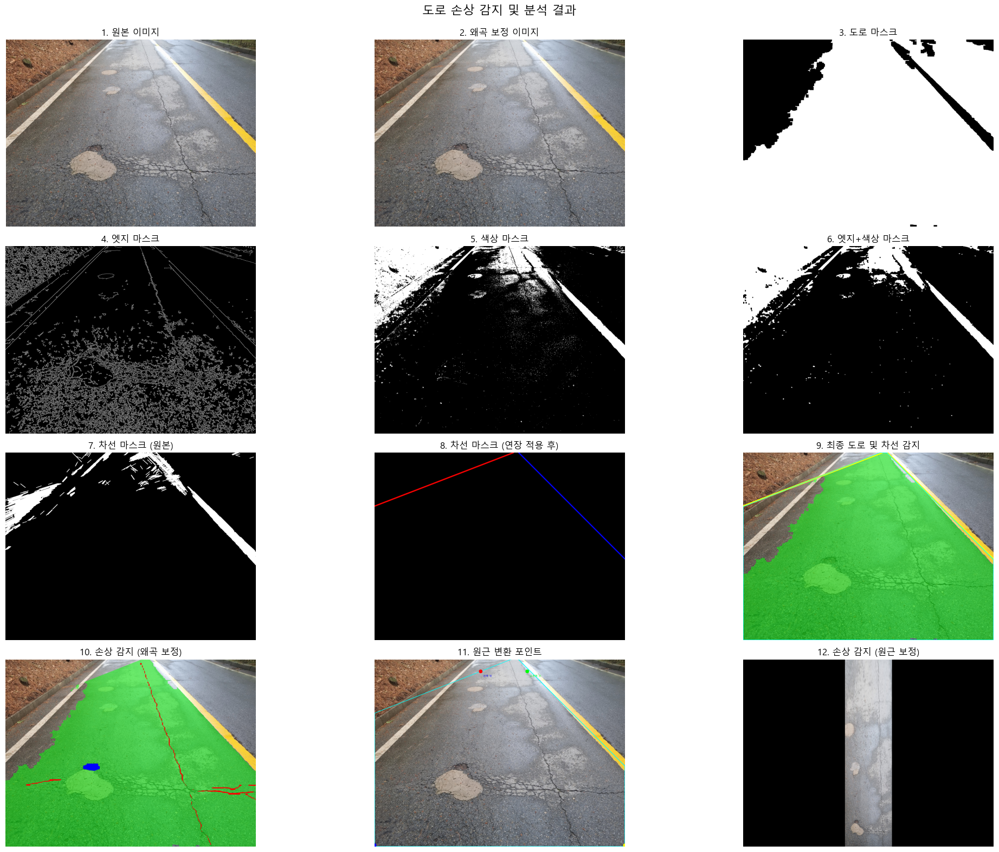

In [ ]:
import cv2
import numpy as np
import os
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO
import matplotlib.font_manager as fm
import platform

def setup_matplotlib_font():
    """
    운영체제별 matplotlib 한글 기본 폰트 설정 함수

    Process:
    1. 현재 운영체제(Windows, macOS, Linux) 확인
    2. 운영체제에 맞는 한글 폰트 경로 설정
    3. 설정된 폰트를 matplotlib에 적용
    4. 그래프에서 마이너스 기호 깨짐 방지 설정

    Parameters: None
    Returns: None
    """
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """
    이미지에 한글 텍스트를 표시하는 함수

    Process:
    1. NumPy 배열을 PIL 이미지로 변환
    2. 그리기 객체 생성
    3. 운영체제에 맞는 폰트 설정 및 로드
    4. 텍스트를 이미지에 그리기
    5. PIL 이미지를 NumPy 배열로 변환하여 반환

    Parameters:
        - img (numpy.ndarray) : 텍스트를 추가할 이미지
        - text (str) : 추가할 텍스트
        - position (tuple) : 텍스트를 표시할 위치 (x, y)
        - font_size (float) : 폰트 크기 조절 계수
        - color (tuple) : BGR 형식의 텍스트 색상
        - thickness (int) : 텍스트 두께

    Returns:
        - numpy.ndarray : 텍스트가 추가된 이미지
    """
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def undistort_image(img, calibration_file):
    """
    카메라 캘리브레이션 결과를 사용하여 이미지 왜곡을 보정하는 함수

    Process:
    1. 캘리브레이션 파일에서 카메라 매트릭스와 왜곡 계수 로드
    2. 왜곡 보정에 사용할 새로운 카메라 매트릭스 계산
    3. 이미지 왜곡 보정 적용
    4. ROI 영역 잘라내기
    5. 예외 처리를 통한 오류 관리

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - calibration_file (str) : 캘리브레이션 결과가 저장된 파일 경로

    Returns:
        - undistorted (numpy.ndarray) : 왜곡 보정된 이미지
        - (mtx, dist, roi) (tuple) : 카메라 행렬, 왜곡 계수, ROI 정보
    """
    try:
        # 캘리브레이션 결과 로드
        calibration_data = np.load(calibration_file, allow_pickle=True).item()
        
        # 키 이름 확인 및 수정 부분
        mtx = calibration_data.get('camera_matrix')  # 'mtx' 대신 'camera_matrix'
        dist = calibration_data.get('dist_coeffs')   # 'dist' 대신 'dist_coeffs'
        
        if mtx is None or dist is None:
            raise ValueError("캘리브레이션 데이터에 카메라 행렬 또는 왜곡 계수가 없습니다.")
        
        # 원본 이미지 크기
        h, w = img.shape[:2]
        
        # 왜곡 보정 후 이미지 크기 계산을 위한 새로운 카메라 행렬 얻기
        newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w, h), 1, (w, h))
        
        # 왜곡 보정 적용
        undistorted = cv2.undistort(img, mtx, dist, None, newcameramtx)
        
        # ROI 잘라내기
        if roi[2] > 0 and roi[3] > 0:  # 유효한 ROI 영역이 있는 경우
            x, y, w, h = roi
            undistorted = undistorted[y:y+h, x:x+w]
        
        return undistorted, (mtx, dist, roi)
    except Exception as e:
        print(f"이미지 왜곡 보정 중 오류 발생: {e}")
        return img, (None, None, None)
    
def create_roi_mask(img, use_roi=True, roi_type="trapezoid"):
    """
    관심 영역(ROI) 마스크를 생성하는 함수

    Process:
    1. 이미지 크기 확인
    2. use_roi 매개변수 확인
    3. roi_type에 따라 다른 형태의 마스크 생성
        - trapezoid: 사다리꼴 모양 (기본값)
        - middle_strip: 이미지 중간 영역만 선택

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_type (str) : ROI 마스크 타입 ("trapezoid", "middle_strip")

    Returns:
        - roi_mask (numpy.ndarray) : 생성된 ROI 마스크
    """
    height, width = img.shape[:2]
    roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    if not use_roi:
        return roi_mask
    
    if roi_type == "trapezoid":
        # 사다리꼴 ROI - 일반적인 도로 영역
        roi_points = np.array([
            [width * 0, height * 0.85],        # 좌하단
            [width * 1, height * 0.85],        # 우하단
            [width * 0.75, height * 0.45],         # 우상단
            [width * 0.25, height * 0.45]          # 좌상단
        ], dtype=np.int32)
        
        # 빈 마스크 생성 및 ROI 영역만 255로 채우기
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        cv2.fillPoly(roi_mask, [roi_points], 255)
    
    elif roi_type == "middle_strip":
        # 상단 n%와 하단 m%를 삭제하고 중간 (100 - m - n)%만 사용
        top = 0.45
        bottom = 0.15
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        top_boundary = int(height * top)
        bottom_boundary = int(height * (1 - bottom))
        roi_mask[top_boundary:bottom_boundary, :] = 255
    
    return roi_mask

def extract_road_mask(img, use_roi=True, roi_mask=None):
    """
    이미지에서 도로 영역을 추출하는 함수

    Process:
    1. ROI 마스크 확인 및 생성
    2. 가우시안 블러로 노이즈 제거
    3. HSV 색상 공간으로 변환 (색상(Hue), 채도(Saturation), 명도(Value)) : 색상 분할에 효과적
    4. 다양한 도로 색상 범위에 대한 마스크 생성 (회색, 어두운, 밝은 도로)
    5. 모든 마스크 결합 및 ROI 적용
    6. 모폴로지 연산으로 노이즈 제거 및 도로 영역 연결
    7. 유의미한 크기의 연결 요소만 선택
    8. 홍수 채우기 알고리즘으로 가장 가능성 높은 도로 영역 선택

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_mask (numpy.ndarray) : 사전에 정의된 ROI 마스크

    Returns:
        - road_mask (numpy.ndarray) : 도로 영역 마스크
    """
    # 이미지 복사 및 크기 가져오기
    height, width = img.shape[:2]
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # 이미지 전처리: 가우시안 블러로 노이즈 제거
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    
    # HSV 변환
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위
    # 일반 범위의 도로 색상 감지
    lower_gray_road = np.array([0, 0, 70])
    upper_gray_road = np.array([180, 30, 170])
    
    # 아스팔트 도로 (어두운 색상)
    lower_dark_road = np.array([0, 0, 40])
    upper_dark_road = np.array([180, 25, 100])
    
    # 콘크리트 도로 (밝은 색상)
    lower_light_road = np.array([0, 0, 140])
    upper_light_road = np.array([180, 35, 220])
    
    # 각 범위에 대한 마스크 생성
    gray_mask = cv2.inRange(hsv, lower_gray_road, upper_gray_road)
    dark_mask = cv2.inRange(hsv, lower_dark_road, upper_dark_road)
    light_mask = cv2.inRange(hsv, lower_light_road, upper_light_road)
    
    # 모든 마스크 결합
    road_mask = cv2.bitwise_or(gray_mask, dark_mask)
    road_mask = cv2.bitwise_or(road_mask, light_mask)
    
    # ROI 적용
    if use_roi:
        road_mask = cv2.bitwise_and(road_mask, roi_mask)
    
    # 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 도로 영역 연결
    kernel_close = np.ones((7, 7), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 넓은 영역 닫기 연산으로 도로 틈새 메우기
    kernel_close_large = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel_close_large)
    
    # 연결 요소 찾기
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours:
        # 면적 기준으로 정렬된 상위 3개 연결 요소 선택
        sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)
        refined_mask = np.zeros_like(road_mask)
        
        # 이미지 전체 면적
        total_area = height * width
        
        # 상위 연결 요소 중 유의미한 크기인 것만 선택
        for contour in sorted_contours[:3]:
            area = cv2.contourArea(contour)
            if area > (total_area * 0.05):  # 전체 이미지의 5% 이상인 연결 요소만 고려
                cv2.drawContours(refined_mask, [contour], 0, 255, -1)
        
        # 최종 마스크가 비어있지 않은 경우에만 갱신
        if np.any(refined_mask):
            road_mask = refined_mask
            
        # 마스크의 하단 중앙에서 시작하여 홍수 채우기(Flood Fill)로 가장 가능성 높은 도로 영역 선택
        seed_point = (width // 2, int(height * 0.9))
        flood_mask = np.zeros((height+2, width+2), np.uint8)
        cv2.floodFill(road_mask.copy(), flood_mask, seed_point, 255, 0, 0, cv2.FLOODFILL_FIXED_RANGE)
        flood_mask = flood_mask[1:-1, 1:-1]  # 경계 제거
        
        # 가장 큰 연결 요소와 홍수 채우기 결과를 결합
        combined_mask = cv2.bitwise_or(road_mask, flood_mask)
        road_mask = combined_mask
    
    return road_mask

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """
    차선 내부의 도로 영역을 추출하는 함수

    Process:
    1. 왼쪽과 오른쪽 차선의 윤곽선 검출
    2. 차선 마스크 유효성 검사
    3. 각 차선의 외곽점 계산 (상단/하단)
    4. 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    5. 폴리곤 기반 도로 영역 마스크 생성
    6. 원래 도로 마스크와 교차 연산

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크

    Returns:
        - final_road_mask (numpy.ndarray) : 차선 내부의 도로 마스크
        - road_polygon (numpy.ndarray) : 도로 폴리곤 좌표 배열
    """
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def apply_yolo_on_masked_area(model, img, mask):
    """
    마스크된 영역에서 YOLO 모델로 도로 손상을 감지하는 함수

    Process:
    1. 마스크를 3채널 이미지로 변환
    2. 원본 이미지에 마스크 적용
    3. YOLO 모델로 객체 감지 수행
    4. 감지된 객체별로 마스크 생성 (균열, 포트홀)
    5. 클래스별 마스크 반환

    Parameters:
        - model : 로드된 YOLO 모델
        - img (numpy.ndarray) : 원본 이미지
        - mask (numpy.ndarray) : 도로 영역 마스크

    Returns:
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
    """
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

def detect_lane_lines(img, use_roi=True, roi_mask=None):
    """
    이미지에서 차선을 감지하고 마스크를 생성하는 함수

    Process:
    1. 이미지 전처리 (그레이스케일 변환, 블러, 캐니 엣지 검출)
    2. ROI 마스크 적용
    3. 색상 기반 차선 추출 (흰색/노란색)
    4. 엣지와 색상 마스크 결합
    5. 호프 변환으로 직선 검출
    6. 기울기 기반으로 왼쪽/오른쪽 차선 분류
    7. 각 차선의 가장 긴 선분 선택 및 연장
    8. 차선 마스크 생성 및 병합
    9. 교차되는 차선을 처리하여 교차점 아래 부분만 유지

    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - use_roi (bool) : ROI 사용 여부
        - roi_mask (numpy.ndarray) : 사전에 정의된 ROI 마스크

    Returns:
        - extended_lane_mask (numpy.ndarray) : 연장된 차선 마스크
        - left_line_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_line_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - masked_edges (numpy.ndarray) : 엣지 마스크 (ROI 적용)
        - color_mask (numpy.ndarray) : 색상 기반 마스크
        - final_mask (numpy.ndarray) : 엣지와 색상 마스크 결합
    """
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # ROI 마스크가 비어있는지 확인
    if use_roi and np.count_nonzero(roi_mask) == 0:
        print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 사용합니다.")
        roi_mask = create_roi_mask(img, use_roi=True, roi_type="trapezoid")
    
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    # 흰색 범위는 그대로 유지
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    if use_roi:
        color_mask = cv2.bitwise_and(color_mask, roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 여기서 모폴로지 연산을 적용하여 비워진 부분 채우기 (도로 감지와 유사한 방식)
    # 1. 작은 노이즈 제거
    kernel_open = np.ones((3, 3), np.uint8)
    final_mask = cv2.morphologyEx(final_mask, cv2.MORPH_OPEN, kernel_open)
    
    # 2. 차선 영역 연결 (가까운 간격 메우기)
    kernel_close = np.ones((5, 5), np.uint8)
    final_mask = cv2.morphologyEx(final_mask, cv2.MORPH_CLOSE, kernel_close)
    
    # 3. 주행 방향으로 차선을 연결하기 위한 수직방향 모폴로지 연산 (선택적)
    # 수직 방향으로 길쭉한 커널 생성
    # vertical_kernel = np.ones((7, 1), np.uint8)
    # final_mask_vertical = cv2.morphologyEx(final_mask, cv2.MORPH_CLOSE, vertical_kernel)
    # final_mask = cv2.bitwise_or(final_mask, final_mask_vertical)

    # 호프 변환으로 직선 검출 - "완화된 호프 파라미터" 설정 적용
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=20,     
        minLineLength=10, 
        maxLineGap=1      
    )
    
    # 차선 마스크 초기화
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    original_lane_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_lines = []
    right_lines = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시 - 완화된 길이 적용
            if line_length < 20:  # 30에서 20으로 낮춤
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 - 유지
            if 0.3 < abs(slope) < 2:  
                # 원본 마스크에 모든 유효한 선분 추가
                cv2.line(original_lane_mask, (x1, y1), (x2, y2), 255, 2)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    left_lines.append((x1, y1, x2, y2, slope, line_length))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    right_lines.append((x1, y1, x2, y2, slope, line_length))
    
    # 확장된 차선 마스크 생성 (이 마스크만 최종 결과로 사용)
    extended_lane_mask = np.zeros_like(gray)
    
    # ROI 영역의 y 좌표 범위 계산
    if use_roi:
        roi_indices = np.where(roi_mask > 0)
        if len(roi_indices[0]) > 0:  # ROI 영역이 비어있지 않은 경우
            min_y_roi = np.min(roi_indices[0])
            max_y_roi = np.max(roi_indices[0])
        else:  # ROI 영역이 비어있는 경우
            min_y_roi = 0
            max_y_roi = height - 1
    else:
        min_y_roi = 0
        max_y_roi = height - 1
    
    # 왼쪽 차선의 직선 파라미터 (기본값은 None)
    left_line_params = None
    
    # 왼쪽 차선 처리 - 가장 긴 선분 선택
    if left_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_left = sorted(left_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_left
        
        # 차선 연장을 위한 직선 방정식 계산
        # y = m*x + b, b = y - m*x
        b = y1 - slope * x1
        left_line_params = (slope, b)  # 차선 파라미터 저장
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 왼쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            left_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            left_line_mask = left_line_mask_roi
        else:
            left_line_mask = temp_mask
    
    # 오른쪽 차선의 직선 파라미터 (기본값은 None)
    right_line_params = None
    
    # 오른쪽 차선 처리 - 가장 긴 선분 선택
    if right_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_right = sorted(right_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_right
        
        # 차선 연장을 위한 직선 방정식 계산
        b = y1 - slope * x1
        right_line_params = (slope, b)  # 차선 파라미터 저장
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 오른쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            right_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            right_line_mask = right_line_mask_roi
        else:
            right_line_mask = temp_mask
    
    # 차선 교차점 계산 및 처리
    intersection_point = None
    if left_line_params is not None and right_line_params is not None:
        left_slope, left_b = left_line_params
        right_slope, right_b = right_line_params
        
        # 기울기가 서로 충분히 다른 경우에만 교차점 계산
        if abs(left_slope - right_slope) > 0.1:
            # 두 직선의 교차점 계산
            # y = m1*x + b1 = m2*x + b2
            # x = (b2 - b1) / (m1 - m2)
            intersect_x = (right_b - left_b) / (left_slope - right_slope)
            intersect_y = left_slope * intersect_x + left_b
            
            # 교차점이 이미지 범위 내에 있는지 확인
            if 0 <= intersect_x < width and min_y_roi <= intersect_y < max_y_roi:
                intersection_point = (int(intersect_x), int(intersect_y))
                
                # 교차점 아래 부분만 유지하도록 마스크 수정
                if intersection_point:
                    x_intersect, y_intersect = intersection_point
                    
                    # 새로운 마스크 생성 (교차점 아래 부분만)
                    below_intersection_mask = np.zeros_like(gray)
                    below_intersection_mask[y_intersect:, :] = 255
                    
                    # 각 차선 마스크에 적용
                    left_line_mask = cv2.bitwise_and(left_line_mask, below_intersection_mask)
                    right_line_mask = cv2.bitwise_and(right_line_mask, below_intersection_mask)
    
    # 전체 차선 마스크 통합
    extended_lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 확장된 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    extended_lane_mask = cv2.dilate(extended_lane_mask, kernel, iterations=1)
    
    # ROI 내에서만 원본 차선 마스크 적용
    if use_roi:
        original_lane_mask = cv2.bitwise_and(original_lane_mask, roi_mask)
    
    # 연장된 가장 긴 선분만을 차선으로 인식하여 반환
    return extended_lane_mask, left_line_mask, right_line_mask, original_lane_mask, masked_edges, color_mask, final_mask

def extract_road_corners_direct(road_lane_mask, roi_mask=None):
    """
    도로 마스크에서 코너 포인트를 직접 추출하는 함수

    Process:
    1. 마스크 유효성 검사
    2. ROI 마스크가 있으면 도로 마스크에 적용
    3. 마스크의 픽셀 좌표 추출
    4. y값 기준으로 상위 1%와 하위 1%의 픽셀 선택 
    5. 선택된 픽셀 중 x 좌표 기준으로 좌/우 지점 결정
    6. 이상치 제거 및 코너 포인트 유효성 검사
    7. 최종 코너 포인트 반환

    Parameters:
        - road_lane_mask (numpy.ndarray) : 차선 내 도로 마스크
        - roi_mask (numpy.ndarray) : ROI 마스크 (선택적)

    Returns:
        - numpy.ndarray : 변환에 사용할 4개의 포인트 (좌상, 우상, 좌하, 우하)
    """
    height, width = road_lane_mask.shape
    
    # ROI 정보 추출 (있는 경우)
    roi_bounds = None
    if roi_mask is not None and np.count_nonzero(roi_mask) > 0:
        roi_y, roi_x = np.where(roi_mask > 0)
        roi_bounds = {
            'min_x': np.min(roi_x),
            'max_x': np.max(roi_x),
            'min_y': np.min(roi_y),
            'max_y': np.max(roi_y)
        }
    
    # ROI 마스크를 도로 마스크에 적용 (ROI 내부 영역만 고려)
    masked_road = road_lane_mask.copy()
    if roi_mask is not None:
        masked_road = cv2.bitwise_and(masked_road, roi_mask)
    
    # 1. 마스크가 비어있는지 확인
    if np.count_nonzero(masked_road) < 10:  # 최소 10픽셀 이상은 필요
        # 기본 사각형 반환 (ROI가 있다면 ROI 기반, 없다면 이미지 전체)
        if roi_bounds is not None:
            return np.float32([
                [roi_bounds['min_x'], roi_bounds['min_y']],  # 좌상단
                [roi_bounds['max_x'], roi_bounds['min_y']],  # 우상단
                [roi_bounds['min_x'], roi_bounds['max_y']],  # 좌하단
                [roi_bounds['max_x'], roi_bounds['max_y']]   # 우하단
            ])
        else:
            return np.float32([
                [0, 0],               # 좌상단
                [width-1, 0],         # 우상단
                [0, height-1],        # 좌하단
                [width-1, height-1]   # 우하단
            ])
    
    # 2. 마스크 픽셀 좌표 가져오기 (이미 ROI로 제한됨)
    y_indices, x_indices = np.where(masked_road > 0)
    
    if len(y_indices) == 0:
        # 마스크가 비어있으면 기본 사각형 반환
        if roi_bounds is not None:
            return np.float32([
                [roi_bounds['min_x'], roi_bounds['min_y']],
                [roi_bounds['max_x'], roi_bounds['min_y']],
                [roi_bounds['min_x'], roi_bounds['max_y']],
                [roi_bounds['max_x'], roi_bounds['max_y']]
            ])
        else:
            return np.float32([
                [0, 0],
                [width-1, 0],
                [0, height-1],
                [width-1, height-1]
            ])
    
    # 3. y값으로 상위 1%와 하위 1% 지점 선택
    y_sorted_indices = np.argsort(y_indices)
    
    # 상단 1% 인덱스
    top_percent = 0.01
    top_count = max(1, int(len(y_indices) * top_percent))
    top_indices = y_sorted_indices[:top_count]
    
    # 하단 1% 인덱스
    bottom_indices = y_sorted_indices[-top_count:]
    
    # 4. 상위 지점들 중에서 x 좌표로 좌/우 결정
    top_x_values = x_indices[top_indices]
    top_y_values = y_indices[top_indices]
    
    # 상단 점들의 중간 y값 계산 (이상치 제거를 위해)
    median_top_y = np.median(top_y_values)
    
    # 상단 점들 중 y값이 중간값에서 너무 떨어진 점 제외
    valid_top_indices = np.abs(top_y_values - median_top_y) < (height * 0.1)  # 10% 차이 이내
    filtered_top_x = top_x_values[valid_top_indices]
    filtered_top_y = top_y_values[valid_top_indices]
    
    if len(filtered_top_x) > 0:
        # 상단 지점 중 가장 왼쪽 지점
        top_left_idx = np.argmin(filtered_top_x)
        left_top = np.array([filtered_top_x[top_left_idx], filtered_top_y[top_left_idx]], dtype=np.float32)
        
        # 상단 지점 중 가장 오른쪽 지점
        top_right_idx = np.argmax(filtered_top_x)
        right_top = np.array([filtered_top_x[top_right_idx], filtered_top_y[top_right_idx]], dtype=np.float32)
    else:
        # ROI가 있으면 ROI 상단 가장자리 사용
        if roi_bounds is not None:
            left_top = np.array([roi_bounds['min_x'], roi_bounds['min_y']], dtype=np.float32)
            right_top = np.array([roi_bounds['max_x'], roi_bounds['min_y']], dtype=np.float32)
        else:
            left_top = np.array([0, 0], dtype=np.float32)
            right_top = np.array([width-1, 0], dtype=np.float32)
    
    # 5. 하위 지점들 중에서 x 좌표로 좌/우 결정
    bottom_x_values = x_indices[bottom_indices]
    bottom_y_values = y_indices[bottom_indices]
    
    # 하단 점들의 중간 y값 계산 (이상치 제거를 위해)
    median_bottom_y = np.median(bottom_y_values)
    
    # 하단 점들 중 y값이 중간값에서 너무 떨어진 점 제외
    valid_bottom_indices = np.abs(bottom_y_values - median_bottom_y) < (height * 0.1)  # 10% 차이 이내
    filtered_bottom_x = bottom_x_values[valid_bottom_indices]
    filtered_bottom_y = bottom_y_values[valid_bottom_indices]
    
    if len(filtered_bottom_x) > 0:
        # 하단 지점 중 가장 왼쪽 지점
        bottom_left_idx = np.argmin(filtered_bottom_x)
        left_bottom = np.array([filtered_bottom_x[bottom_left_idx], filtered_bottom_y[bottom_left_idx]], dtype=np.float32)
        
        # 하단 지점 중 가장 오른쪽 지점
        bottom_right_idx = np.argmax(filtered_bottom_x)
        right_bottom = np.array([filtered_bottom_x[bottom_right_idx], filtered_bottom_y[bottom_right_idx]], dtype=np.float32)
    else:
        # ROI가 있으면 ROI 하단 가장자리 사용
        if roi_bounds is not None:
            left_bottom = np.array([roi_bounds['min_x'], roi_bounds['max_y']], dtype=np.float32)
            right_bottom = np.array([roi_bounds['max_x'], roi_bounds['max_y']], dtype=np.float32)
        else:
            left_bottom = np.array([0, height-1], dtype=np.float32)
            right_bottom = np.array([width-1, height-1], dtype=np.float32)
    
    # 6. 코너 포인트가 ROI 내에 있는지 강제로 확인 및 조정
    if roi_bounds is not None:
        # 코너 포인트가 ROI 내에 있도록 조정
        left_top[0] = max(roi_bounds['min_x'], min(roi_bounds['max_x'], left_top[0]))
        left_top[1] = max(roi_bounds['min_y'], min(roi_bounds['max_y'], left_top[1]))
        right_top[0] = max(roi_bounds['min_x'], min(roi_bounds['max_x'], right_top[0]))
        right_top[1] = max(roi_bounds['min_y'], min(roi_bounds['max_y'], right_top[1]))
        left_bottom[0] = max(roi_bounds['min_x'], min(roi_bounds['max_x'], left_bottom[0]))
        left_bottom[1] = max(roi_bounds['min_y'], min(roi_bounds['max_y'], left_bottom[1]))
        right_bottom[0] = max(roi_bounds['min_x'], min(roi_bounds['max_x'], right_bottom[0]))
        right_bottom[1] = max(roi_bounds['min_y'], min(roi_bounds['max_y'], right_bottom[1]))
    
    # 7. 코너 포인트가 이상하게 교차하지 않는지 확인
    # 왼쪽 상단은 오른쪽 상단보다 x좌표가 작아야 함
    if left_top[0] >= right_top[0]:
        mid_x = (left_top[0] + right_top[0]) / 2
        left_top[0] = mid_x - (width * 0.1)
        right_top[0] = mid_x + (width * 0.1)
    
    # 왼쪽 하단은 오른쪽 하단보다 x좌표가 작아야 함
    if left_bottom[0] >= right_bottom[0]:
        mid_x = (left_bottom[0] + right_bottom[0]) / 2
        left_bottom[0] = mid_x - (width * 0.1)
        right_bottom[0] = mid_x + (width * 0.1)
    
    # 상단 y값은 하단 y값보다 작아야 함
    if left_top[1] >= left_bottom[1]:
        left_top[1] = min(left_top[1], left_bottom[1] - (height * 0.1))
    
    if right_top[1] >= right_bottom[1]:
        right_top[1] = min(right_top[1], right_bottom[1] - (height * 0.1))
    
    # 최종 코너 포인트 반환
    return np.float32([left_top, right_top, left_bottom, right_bottom])


def perspective_transform_direct_masked(img, road_lane_mask, roi_mask=None, road_width_m=3.0, road_length_m=12.0):
    """
    도로 마스크에서 추출한 코너 포인트로 원근 변환을 수행하고, 
    코너 포인트 외부 영역을 마스킹하는 함수
    
    Parameters:
        - img (numpy.ndarray) : 원본 이미지
        - road_lane_mask (numpy.ndarray) : 차선 내 도로 마스크
        - roi_mask (numpy.ndarray) : ROI 마스크 (선택적)
        - road_width_m (float) : 도로 너비의 실제 미터 값 (기본값: 3.0m)
        - road_length_m (float) : 도로 길이의 실제 미터 값 (기본값: 30.0m)

    Returns:
        - warped_img (numpy.ndarray) : 원근 변환된 이미지 (코너 포인트 외부는 검은색)
        - warped_mask (numpy.ndarray) : 원근 변환된 마스크
        - M (numpy.ndarray) : 원근 변환 행렬
        - src_points (numpy.ndarray) : 원본 이미지에서의 소스 포인트
    """
    height, width = road_lane_mask.shape
    
    # 도로 마스크에서 직접 코너 포인트 추출
    src_points = extract_road_corners_direct(road_lane_mask, roi_mask)
    
    # 도로의 물리적 비율 계산
    aspect_ratio = road_length_m / road_width_m  # 길이/너비 비율 (예: 30m/3m = 10)
    
    # 출력 이미지의 크기를 유지하면서 비율 적용
    # 이미지 너비에 맞춰 도로 너비를 정하고, 길이는 비율대로 계산
    road_width_pixels = width / 2  # 이미지 너비의 절반을 도로 너비로 사용
    road_length_pixels = road_width_pixels * aspect_ratio  # 비율에 맞게 길이 계산
    
    # 만약 계산된 길이가 이미지 높이를 초과하면 조정
    if road_length_pixels > height:
        # 이미지 높이에 맞추고 너비를 비율대로 줄임
        road_length_pixels = height
        road_width_pixels = road_length_pixels / aspect_ratio
    
    # 이미지 중앙에 도로가 위치하도록 설정
    left_margin = (width - road_width_pixels) / 2
    right_margin = left_margin + road_width_pixels
    
    # 변환 대상 포인트 설정 (물리적 비율에 맞는 직사각형)
    dst_points = np.float32([
        [left_margin, 0],                  # 왼쪽 상단
        [right_margin, 0],                 # 오른쪽 상단
        [left_margin, road_length_pixels], # 왼쪽 하단
        [right_margin, road_length_pixels] # 오른쪽 하단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(road_lane_mask, M, (width, height))
    
    # 코너 포인트 외부 영역 마스킹
    # 1. 원근 변환된 코너 포인트 영역 마스크 생성
    transformed_mask = np.zeros((height, width), dtype=np.uint8)
    
    # 변환된 사각형 영역 채우기
    transformed_rect = np.int32([
        [left_margin, 0],                  # 왼쪽 상단
        [right_margin, 0],                 # 오른쪽 상단
        [right_margin, road_length_pixels], # 오른쪽 하단
        [left_margin, road_length_pixels]  # 왼쪽 하단
    ])
    cv2.fillPoly(transformed_mask, [transformed_rect], 255)
    
    # 2. 원근 변환된 이미지에 마스크 적용
    masked_warped_img = cv2.bitwise_and(warped_img, warped_img, mask=transformed_mask)
    
    # 3. 원근 변환된 마스크도 동일하게 마스킹
    warped_mask = cv2.bitwise_and(warped_mask, transformed_mask)
    
    return masked_warped_img, warped_mask, M, src_points

def calculate_lrpci(crack_ratio, pothole_ratio, crack_severity, crack_type, pothole_info):
    """
    도로 포장 상태를 평가하는 LrPCI(Local road Pavement Condition Index) 계산 함수

    Process:
    1. 기본 점수 설정 (완벽한 상태 = 100)
    2. 포트홀 감점 계산 (직경, 개수, 면적에 따른 감점)
    3. 균열 감점 계산 (유형, 면적, 심각도에 따른 감점)
    4. 총 감점 계산 및 최종 점수 도출

    Parameters:
        - crack_ratio (float) : 0~1 사이의 균열율
        - pothole_ratio (float) : 0~1 사이의 포트홀 비율
        - crack_severity (float) : 0~1 사이의 균열 심각도
        - crack_type (str) : 균열 유형 (선형 균열, 블록형 균열, 악어 균열 등)
        - pothole_info (dict) : 포트홀 정보 (개수, 최대 직경 등)

    Returns:
        - lrpci (float) : 0~100 사이의 LrPCI 값
    """
    # 기본값 설정: 완벽한 상태의 도로는 100점에서 시작
    base_score = 100
    
    # 포트홀 감점 계산 (포트홀이 있으면 더 많은 감점)
    pothole_deduction = 0
    if pothole_ratio > 0:
        pothole_count = pothole_info.get('potholes_count', 0)
        max_diameter_cm = pothole_info.get('max_diameter_cm', 0)
        
        # 포트홀 직경에 따른 심각도 분류
        if max_diameter_cm >= 30:  # 심각: 30cm 이상은 심각한 포트홀
            pothole_deduction = 30 + (pothole_count * 2.5)  # 기본 30점 감점, 추가 포트홀당 2.5점 추가 감점
        elif max_diameter_cm >= 15:  # 중간: 15~30cm는 중간 수준
            pothole_deduction = 15 + (pothole_count * 2)    # 기본 15점 감점, 추가 포트홀당 2점 추가 감점
        else:  # 경미: 15cm 미만은 경미한 수준
            pothole_deduction = 5 + (pothole_count * 1.5)   # 기본 5점 감점, 추가 포트홀당 1.5점 추가 감점
            
        # 포트홀 면적 비율이 높으면 추가 감점
        pothole_deduction += pothole_ratio * 100 * 0.3
        
        # 최대 감점은 40점으로 제한
        pothole_deduction = min(pothole_deduction, 40)
    
    # 균열 감점 계산
    crack_deduction = 0
    if crack_ratio > 0:
        # 균열 유형에 따른 가중치 설정
        crack_type_weights = {
            "선형 균열": 1.0,       # 선형 균열은 기본 가중치
            "블록형 균열": 1.5,     # 블록형 균열은 더 심각
            "악어 균열": 2.0,       # 악어 균열은 가장 심각
            "없음": 0
        }
        
        crack_type_weight = crack_type_weights.get(crack_type, 1.0)
        
        # 균열 면적 비율과 심각도, 유형에 따른 감점
        if crack_ratio >= 0.5:  # 50% 이상은 심각
            crack_deduction = 25 * crack_type_weight
        elif crack_ratio >= 0.2:  # 20~50%는 중간
            crack_deduction = 15 * crack_type_weight
        else:  # 20% 미만은 경미
            crack_deduction = 5 * crack_type_weight
            
        # 균열 면적과 심각도에 따른 추가 감점
        crack_deduction += (crack_ratio * 100 * 0.2) + (crack_severity * 10)
        
        # 최대 감점은 25점으로 제한
        crack_deduction = min(crack_deduction, 25)
    
    # 총 감점 계산
    total_deduction = pothole_deduction + crack_deduction
    
    # 최종 LrPCI 계산 (최소값은 0)
    lrpci = max(0, base_score - total_deduction)
    
    return round(lrpci, 2)

def visualize_results_masked(original_img, undistorted_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     original_lane_mask, masked_edges, color_mask, final_mask,
                     img_num=None, pixel_to_cm_ratio=1.0):
    """
    도로 손상 감지 및 분석 결과를 시각화하는 함수

    Process:
    1. 4x3 그리드로 12개 이미지 구성 (원본, 왜곡 보정, 도로 마스크, 엣지 마스크, 색상 마스크 등)
    2. 도로 및 손상 영역 시각화
    3. 손상 면적 및 비율 계산
    4. 균열 심각도 및 포트홀 응급 상황 분석
    5. LrPCI 계산 및 보수 방법 결정
    6. 분석 결과 출력 및 저장

    Parameters:
        - original_img (numpy.ndarray) : 원본 이미지
        - undistorted_img (numpy.ndarray) : 왜곡 보정된 이미지
        - road_mask (numpy.ndarray) : 도로 마스크
        - lane_mask (numpy.ndarray) : 차선 마스크
        - left_lane_mask (numpy.ndarray) : 왼쪽 차선 마스크
        - right_lane_mask (numpy.ndarray) : 오른쪽 차선 마스크
        - road_lane_mask (numpy.ndarray) : 차선 내부 도로 마스크
        - road_polygon (numpy.ndarray) : 도로 폴리곤 좌표
        - mask_crack (numpy.ndarray) : 균열 마스크
        - mask_pothole (numpy.ndarray) : 포트홀 마스크
        - warped_img (numpy.ndarray) : 원근 변환된 이미지
        - warped_mask (numpy.ndarray) : 원근 변환된 도로 마스크
        - warped_crack (numpy.ndarray) : 원근 변환된 균열 마스크
        - warped_pothole (numpy.ndarray) : 원근 변환된 포트홀 마스크
        - corner_points (numpy.ndarray) : 원근 변환 코너 포인트
        - original_lane_mask (numpy.ndarray) : 원본 차선 마스크 (연장 전)
        - masked_edges (numpy.ndarray) : 엣지 마스크 (ROI 적용)
        - color_mask (numpy.ndarray) : 색상 기반 마스크
        - final_mask (numpy.ndarray) : 엣지와 색상 마스크 결합
        - img_num (str) : 이미지 번호 (저장 시 사용)
        - pixel_to_cm_ratio (float) : 픽셀 대 센티미터 비율

    Returns:
        - lrpci (float) : LrPCI 점수
        - warped_crack_ratio (float) : 원근 보정된 이미지의 균열 비율
        - warped_pothole_ratio (float) : 원근 보정된 이미지의 포트홀 비율
        - crack_severity (float) : 균열 심각도
        - crack_type (str) : 균열 유형
        - crack_info (dict) : 균열 상세 정보
        - pothole_info (dict) : 포트홀 상세 정보
        - repair_method (str) : 권장 보수 방법
        - priority (str) : 보수 우선순위
    """
    plt.figure(figsize=(22, 16))
   
    # 1. 원본 이미지
    plt.subplot(4, 3, 1)
    plt.imshow(original_img)
    plt.title('1. 원본 이미지')
    plt.axis('off')

    # 2. 왜곡 보정 이미지
    plt.subplot(4, 3, 2)
    plt.imshow(undistorted_img)
    plt.title('2. 왜곡 보정 이미지')
    plt.axis('off')
    
    # 3. 도로 마스크
    plt.subplot(4, 3, 3)
    plt.imshow(road_mask, cmap='gray')
    plt.title('3. 도로 마스크')
    plt.axis('off')
    
    # 4. 엣지 마스크
    plt.subplot(4, 3, 4)
    plt.imshow(masked_edges, cmap='gray')
    plt.title('4. 엣지 마스크')
    plt.axis('off')
    
    # 5. 색상 마스크
    plt.subplot(4, 3, 5)
    plt.imshow(color_mask, cmap='gray')
    plt.title('5. 색상 마스크')
    plt.axis('off')
    
    # 6. 엣지+색상 마스크
    plt.subplot(4, 3, 6)
    plt.imshow(final_mask, cmap='gray')
    plt.title('6. 엣지+색상 마스크')
    plt.axis('off')
    
    # 7. 차선 마스크 (RANSAC 적용 전)
    plt.subplot(4, 3, 7)
    plt.imshow(original_lane_mask, cmap='gray')  # RANSAC 적용 전 차선 마스크
    plt.title('7. 차선 마스크 (원본)')
    plt.axis('off')
    
    # 8. 차선 마스크 (RANSAC 적용 후)
    plt.subplot(4, 3, 8)
    lane_combined = np.zeros((undistorted_img.shape[0], undistorted_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('8. 차선 마스크 (연장 적용 후)')
    plt.axis('off')
    
    # 9. 최종 도로 및 차선 감지
    plt.subplot(4, 3, 9)
    road_overlay = undistorted_img.copy()
    alpha = 0.5
    
    # 도로 영역 반투명 초록색으로 표시
    road_highlight = road_overlay.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    road_overlay = cv2.addWeighted(road_highlight, alpha, road_overlay, 1-alpha, 0)
    
    # 차선 표시
    road_overlay[lane_mask == 255] = [255, 255, 0]  # 차선: 노란색
    
    # 도로 폴리곤 표시
    if road_polygon is not None:
        cv2.polylines(road_overlay, [road_polygon], True, (0, 255, 255), 2)
    
    plt.imshow(road_overlay)
    plt.title('9. 최종 도로 및 차선 감지')
    plt.axis('off')
    
    # 10. 손상 감지 (왜곡 보정)
    plt.subplot(4, 3, 10)
    overlay_undistorted = undistorted_img.copy()
    alpha = 0.5
    road_highlight = overlay_undistorted.copy()
    road_highlight[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_undistorted = cv2.addWeighted(road_highlight, alpha, overlay_undistorted, 1-alpha, 0)
    overlay_undistorted[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_undistorted[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.imshow(overlay_undistorted)
    plt.title('10. 손상 감지 (왜곡 보정)')
    plt.axis('off')

    # 11. 원근 변환 포인트
    plt.subplot(4, 3, 11)
    img_with_points = undistorted_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 위', '오른쪽 위', '왼쪽 아래', '오른쪽 아래']
    
    # 도로 영역 윤곽선
    if road_polygon is not None:
        cv2.polylines(img_with_points, [road_polygon], True, (0, 255, 255), 2)
    
    # 변환 포인트 표시
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    
    plt.imshow(img_with_points)
    plt.title('11. 원근 변환 포인트')
    plt.axis('off')

    # 12. 손상 감지 (원근 보정) - 코너 포인트 외부 영역 제거
    plt.subplot(4, 3, 12)
    plt.imshow(warped_img)  # 이미 마스킹된 이미지 사용
    plt.title('12. 손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 결과", fontsize=16)
    plt.subplots_adjust(top=0.94)
    
    # 원본 이미지에서의 손상 면적 계산
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    # 원본 이미지의 손상률 계산
    crack_ratio = crack_area / road_area if road_area > 0 else 0
    pothole_ratio = pothole_area / road_area if road_area > 0 else 0
    total_damage_ratio = crack_ratio + pothole_ratio
    
    # 원근 보정된 이미지에서의 손상 면적 계산
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    # 원근 보정된 이미지의 손상률 계산
    warped_crack_ratio = warped_crack_area / warped_road_area if warped_road_area > 0 else 0
    warped_pothole_ratio = warped_pothole_area / warped_road_area if warped_road_area > 0 else 0
    warped_total_damage_ratio = warped_crack_ratio + warped_pothole_ratio
    
    # 균열 심각도 분석 - 원근 보정된 이미지 사용
    crack_severity, crack_type, crack_info = analyze_crack_severity(
        cv2.bitwise_and(warped_crack, warped_mask), pixel_to_cm_ratio
    )
    
    # 포트홀 응급 상황 확인 - 원근 보정된 이미지 사용
    is_emergency, pothole_info = check_pothole_emergency(
        cv2.bitwise_and(warped_pothole, warped_mask), 
        pixel_to_cm_ratio
    )
    
    # 원근 보정된 이미지 기반으로 LrPCI 계산
    lrpci = calculate_lrpci(warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, pothole_info)
    
    # 보수 방법 결정 - 원근 보정된 이미지 기반 결과 사용
    repair_method, priority = determine_repair_method(lrpci, warped_crack_ratio, crack_type, is_emergency)
    
    # 원본 이미지 분석 결과 출력
    print(f"\n도로 영역 분석 결과 (왜곡 보정 이미지):")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({total_damage_ratio*100:.2f}%)")
    
    # 원근 보정된 이미지 분석 결과 출력 (LrPCI 포함)
    print(f"\n도로 영역 분석 결과 (원근 보정된 이미지):")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_ratio*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_ratio*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({warped_total_damage_ratio*100:.2f}%)")
    
    # LrPCI 등급 계산
    grade, description = get_lrpci_grade(lrpci)
    print(f"LrPCI 평가 점수: {lrpci}/100.00 ({grade}: {description})")
    
    plt.show()
    
    return lrpci, warped_crack_ratio, warped_pothole_ratio, crack_severity, crack_type, crack_info, pothole_info, repair_method, priority

def main():
    """
    전체 도로 손상 감지 파이프라인을 실행하는 메인 함수
    """
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = '../model/yolo11-seg.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 캘리브레이션 파일 경로
    calibration_file = '../model/camera_calibration_result.npy'
    if not os.path.exists(calibration_file):
        print(f"캘리브레이션 파일이 존재하지 않습니다: {calibration_file}")
        print("원본 이미지를 사용합니다.")
    else:
        print(f"카메라 캘리브레이션 데이터 '{calibration_file}'을(를) 사용합니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'../image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    
    img_bgr = cv2.imread(img_path)
    if img_bgr is None:
        print(f"이미지를 로드할 수 없습니다: {img_path}")
        return
    
    # 이미지 왜곡 보정 적용
    undistorted_bgr, calibration_info = undistort_image(img_bgr, calibration_file)
    mtx, dist, roi = calibration_info
    
    if mtx is None:
        print("캘리브레이션 파일을 로드할 수 없거나 잘못된 형식입니다. 원본 이미지를 사용합니다.")
        undistorted_bgr = img_bgr
    else:
        print("카메라 캘리브레이션을 적용하여 이미지 왜곡을 보정했습니다.")
    
    # BGR -> RGB 변환
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    undistorted_rgb = cv2.cvtColor(undistorted_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = undistorted_rgb.shape[:2]
    
    # ROI 사용 여부 설정
    use_roi = input("ROI를 사용하시겠습니까? (y/n): ").lower() == 'y'
    
    # ROI 마스크 생성
    roi_mask = None
    if use_roi:
        roi_type = input("ROI 타입을 선택하세요 (1: trapezoid, 2: middle_strip): ")
        if roi_type == "1":
            roi_type = "trapezoid"
        elif roi_type == "2":
            roi_type = "middle_strip"
        else:
            roi_type = "trapezoid"  # 기본값
        
        roi_mask = create_roi_mask(undistorted_bgr, use_roi=True, roi_type=roi_type)
        print(f"ROI 타입 '{roi_type}'을(를) 적용했습니다.")
        
        # ROI가 비어있는지 확인
        if np.count_nonzero(roi_mask) == 0:
            print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 대신 사용합니다.")
            roi_mask = create_roi_mask(undistorted_bgr, use_roi=True, roi_type="trapezoid")
    else:
        print("ROI를 적용하지 않습니다.")
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(undistorted_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 마스크 생성 (추가된 반환값: color_mask, final_mask)
    lane_mask, left_lane_mask, right_lane_mask, original_lane_mask, masked_edges, color_mask, final_mask = detect_lane_lines(undistorted_bgr, use_roi=use_roi, roi_mask=roi_mask)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(undistorted_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 도로 마스크나 차선 마스크가 비어 있는지 확인
    if np.count_nonzero(road_lane_mask) == 0:
        print("경고: 도로 차선 마스크가 비어 있습니다. ROI 설정을 다시 확인하세요.")
        # 기본 마스크 사용
        road_lane_mask = np.ones((img_height, img_width), dtype=np.uint8) * 255
        if use_roi and roi_mask is not None:
            road_lane_mask = cv2.bitwise_and(road_lane_mask, roi_mask)
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, undistorted_rgb, road_lane_mask)
    
    # 원근 변환을 위한 코드
    try:
        # 도로 마스크에서 직접 코너 포인트 추출
        corner_points = extract_road_corners_direct(road_lane_mask, roi_mask)
        
        # 마스킹이 적용된 원근 변환 적용
        warped_img, warped_mask, perspective_matrix, src_points = perspective_transform_direct_masked(
            undistorted_rgb, road_lane_mask, roi_mask)
        
        # 손상 마스크에도 원근 변환 적용
        warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
        warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
        
        # 변환된 손상 마스크도 동일한 영역으로 마스킹
        # 변환된 코너 포인트 영역 마스크 생성
        height, width = img_height, img_width
        road_width_pixels = width / 2
        road_length_pixels = height  # 간단하게 이미지 높이로 설정
        
        left_margin = (width - road_width_pixels) / 2
        right_margin = left_margin + road_width_pixels
        
        transformed_mask = np.zeros((height, width), dtype=np.uint8)
        transformed_rect = np.int32([
            [left_margin, 0],                   # 왼쪽 상단
            [right_margin, 0],                  # 오른쪽 상단
            [right_margin, road_length_pixels], # 오른쪽 하단
            [left_margin, road_length_pixels]   # 왼쪽 하단
        ])
        cv2.fillPoly(transformed_mask, [transformed_rect], 255)
        
        # 손상 마스크 마스킹
        warped_crack = cv2.bitwise_and(warped_crack, transformed_mask)
        warped_pothole = cv2.bitwise_and(warped_pothole, transformed_mask)
    except Exception as e:
        print(f"원근 변환 중 오류 발생: {e}")
        # 원근 변환 실패 시 원본 이미지 및 마스크 사용
        warped_img = undistorted_rgb.copy()
        warped_mask = road_lane_mask.copy()
        warped_crack = mask_crack.copy()
        warped_pothole = mask_pothole.copy()
        
        # 기본 코너 포인트 (이미지 전체)
        src_points = np.float32([
            [0, 0], [img_width-1, 0], [0, img_height-1], [img_width-1, img_height-1]
        ])
        corner_points = src_points
    
    # 결과 시각화
    lrpci = visualize_results_masked(
        img_rgb, undistorted_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, 
        corner_points, original_lane_mask, masked_edges, color_mask, final_mask, img_num
    )
    
if __name__ == "__main__":
    main()

### 흰색 차선 검출

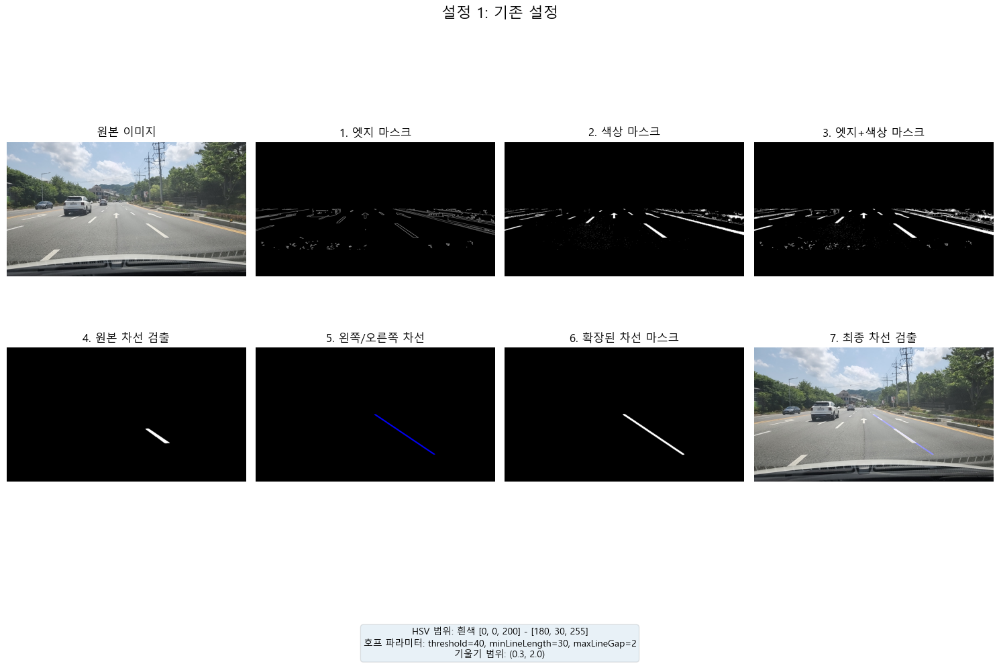

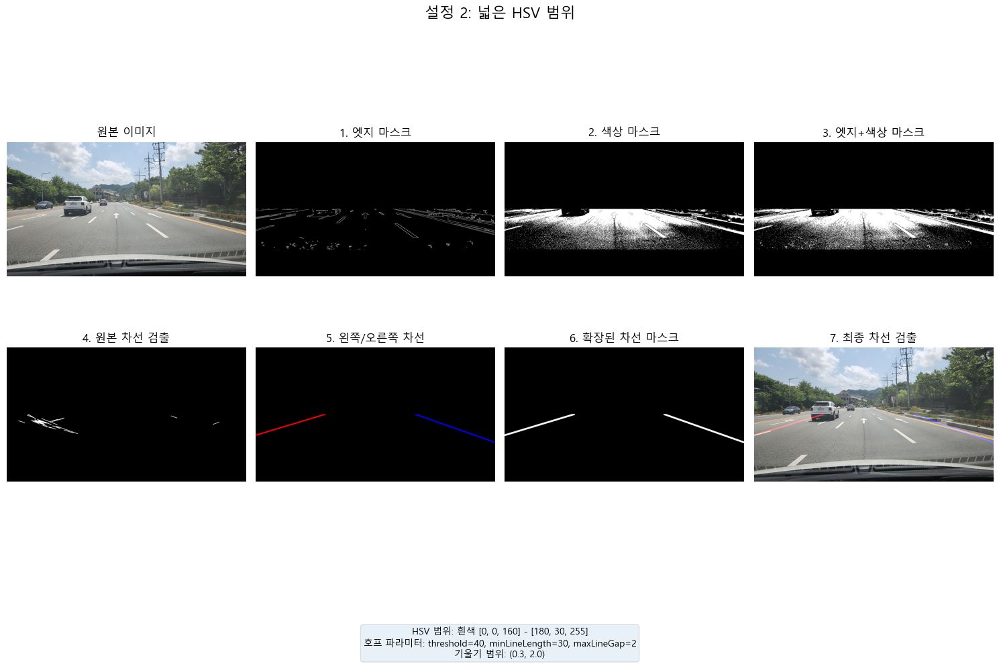

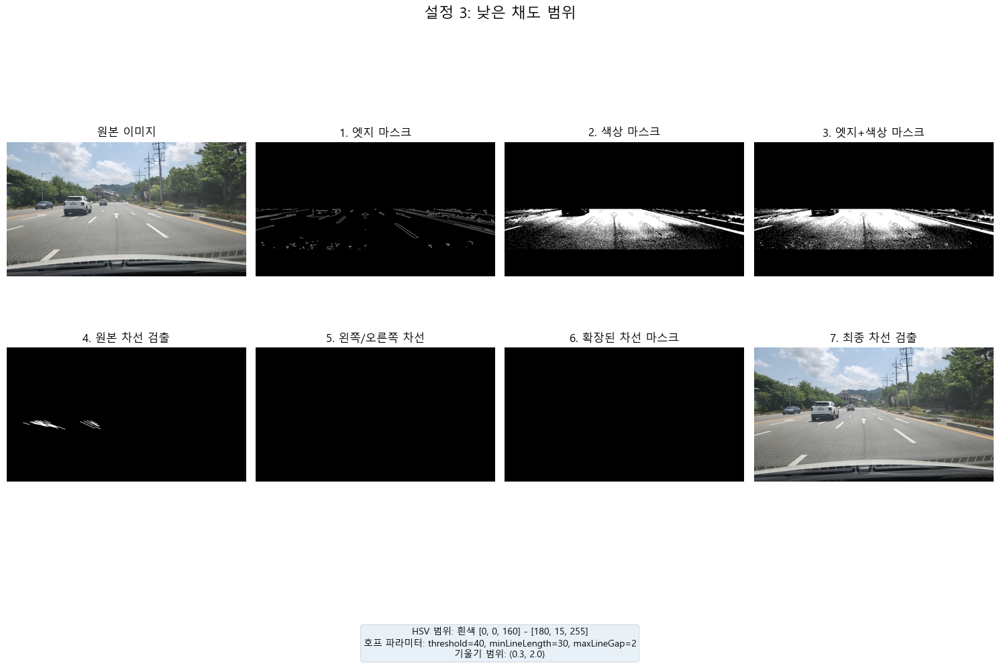

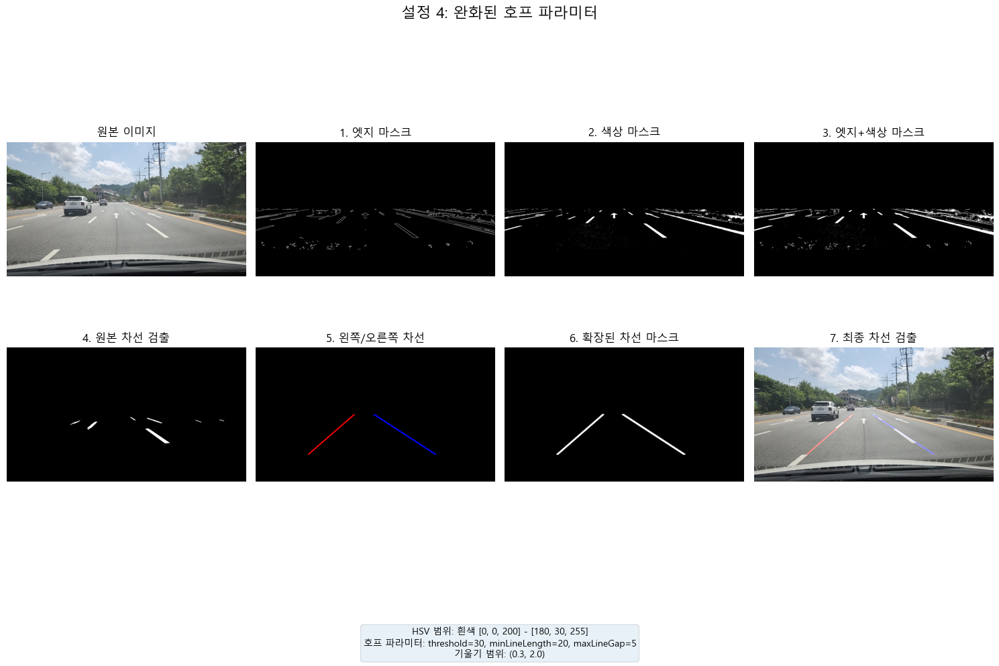

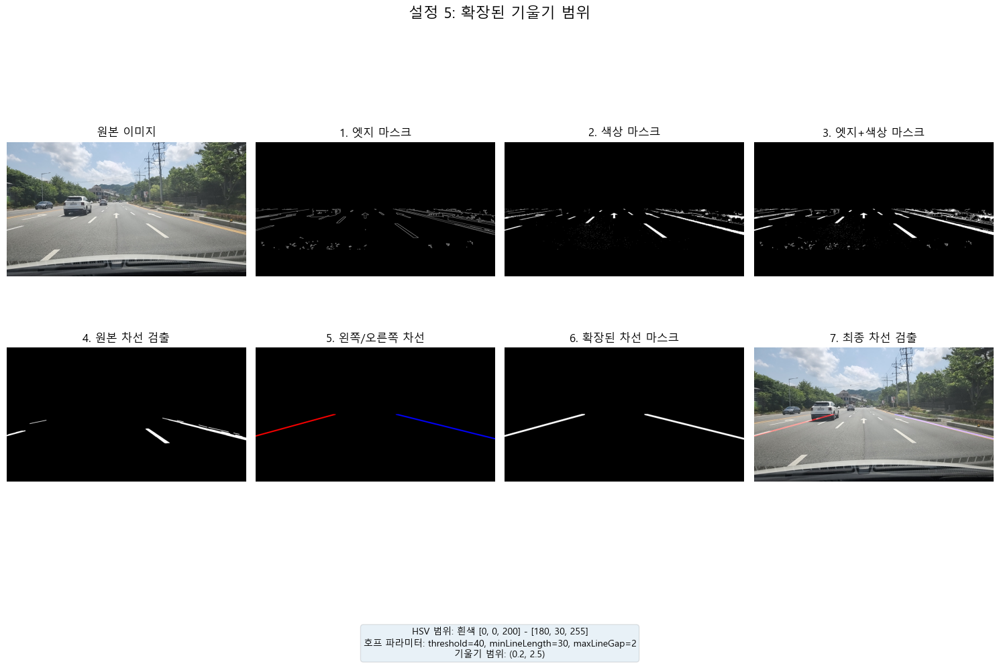

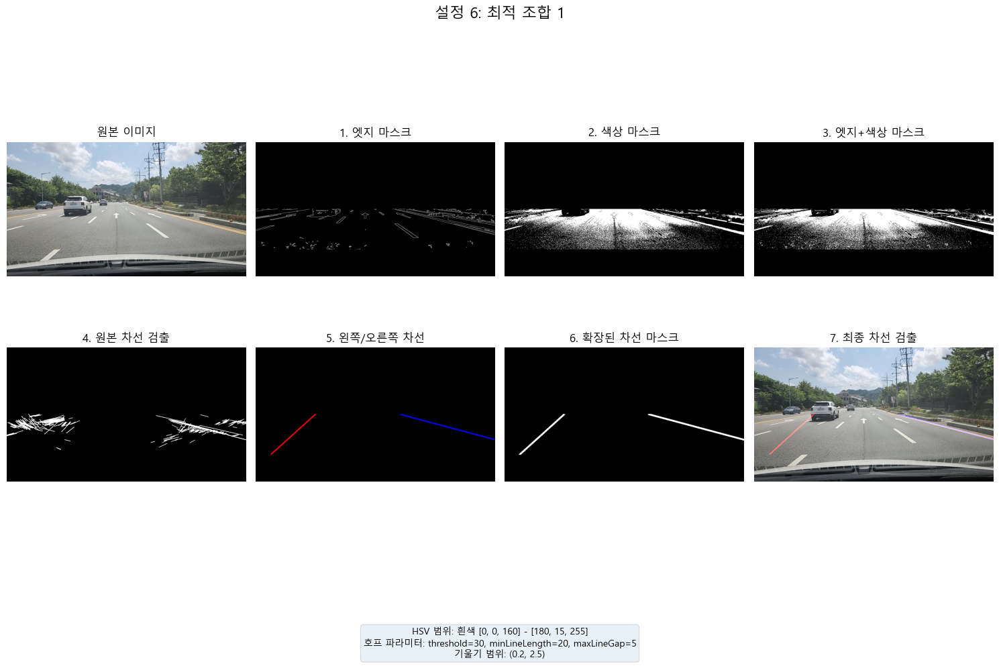

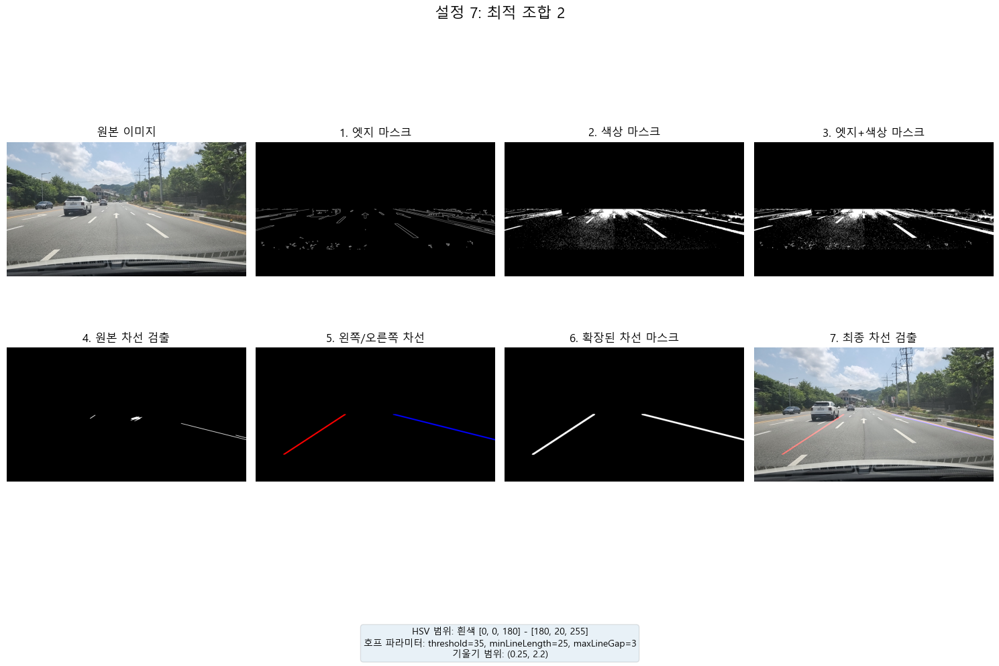

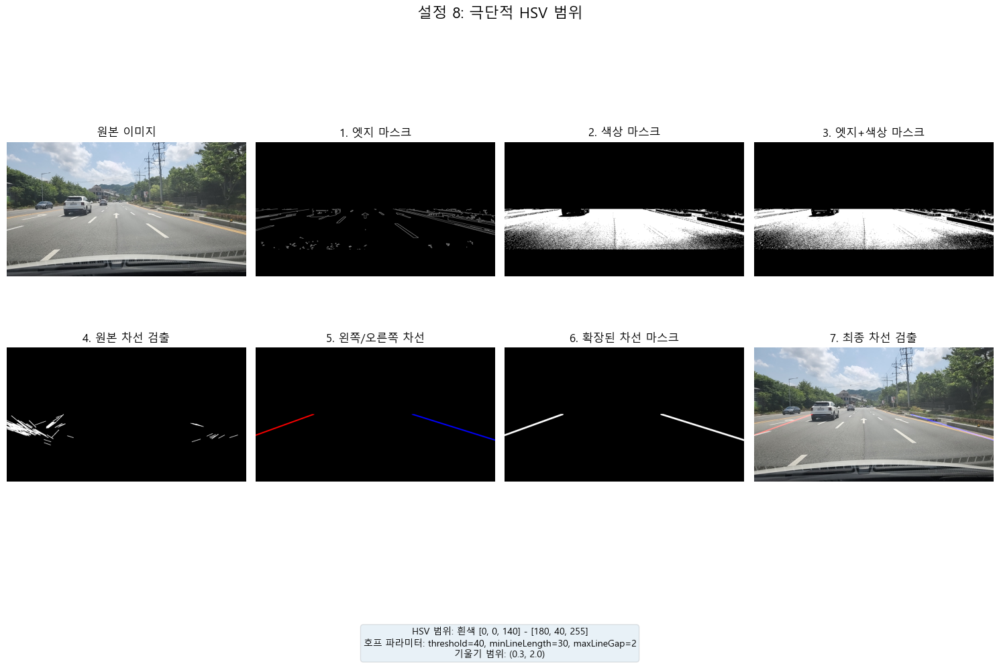

In [29]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import platform

def setup_matplotlib_font():
    """운영체제별 matplotlib 한글 기본 폰트 설정 함수"""
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        import matplotlib.font_manager as fm
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def create_roi_mask(img, use_roi=True, roi_type="trapezoid"):
    """관심 영역(ROI) 마스크를 생성하는 함수"""
    height, width = img.shape[:2]
    roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    if not use_roi:
        return roi_mask
    
    if roi_type == "trapezoid":
        # 사다리꼴 ROI - 일반적인 도로 영역
        roi_points = np.array([
            [width * 0.1, height],              # 좌하단
            [width * 0.9, height],              # 우하단
            [width * 0.7, height * 0.4],        # 우상단
            [width * 0.3, height * 0.4]         # 좌상단
        ], dtype=np.int32)
        
        # 빈 마스크 생성 및 ROI 영역만 255로 채우기
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        cv2.fillPoly(roi_mask, [roi_points], 255)
    
    elif roi_type == "middle_strip":
        # 상단 n%와 하단 m%를 삭제하고 중간 (100 - m - n)%만 사용
        top = 0.5
        bottom = 0.2
        roi_mask = np.zeros((height, width), dtype=np.uint8)
        top_boundary = int(height * top)
        bottom_boundary = int(height * (1 - bottom))
        roi_mask[top_boundary:bottom_boundary, :] = 255
    
    return roi_mask

def detect_lane_lines_with_hsv(img, white_hsv_range, use_roi=True, roi_mask=None, hough_params=None, slope_range=None):
    """
    기존 코드의 차선 감지 파이프라인을 재현하고 HSV 범위를 조정할 수 있는 함수
    
    Parameters:
        - img (numpy.ndarray): 원본 이미지
        - white_hsv_range (dict): 흰색 차선 HSV 범위 {'lower': [h, s, v], 'upper': [h, s, v]}
        - use_roi (bool): ROI 사용 여부
        - roi_mask (numpy.ndarray): 사전에 정의된 ROI 마스크
        - hough_params (dict): 호프 변환 파라미터
        - slope_range (tuple): 기울기 필터링 범위 (min, max)
        
    Returns:
        - lane_mask (numpy.ndarray): 최종 차선 마스크
        - left_line_mask (numpy.ndarray): 왼쪽 차선 마스크
        - right_line_mask (numpy.ndarray): 오른쪽 차선 마스크
        - original_lane_mask (numpy.ndarray): 원본 차선 마스크 (연장 전)
        - edge_mask (numpy.ndarray): 엣지 마스크
        - color_mask (numpy.ndarray): 색상 기반 마스크
        - final_mask (numpy.ndarray): 엣지와 색상 마스크 결합
    """
    # 기본 파라미터 설정
    if hough_params is None:
        hough_params = {
            'rho': 1,
            'theta': np.pi/180,
            'threshold': 40,
            'minLineLength': 30,
            'maxLineGap': 2
        }
    
    if slope_range is None:
        slope_range = (0.3, 2.0)  # 기본값: 약 15도 ~ 65도 범위
    
    # 기존 전처리 과정 유지
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정
    height, width = edges.shape
    
    # ROI 마스크가 제공되지 않았다면 생성
    if roi_mask is None and use_roi:
        roi_mask = create_roi_mask(img, use_roi=True)
    elif not use_roi:
        roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    # ROI 마스크가 비어있는지 확인
    if use_roi and np.count_nonzero(roi_mask) == 0:
        print("경고: ROI 마스크가 비어 있습니다. 기본 사다리꼴 ROI를 사용합니다.")
        roi_mask = create_roi_mask(img, use_roi=True, roi_type="trapezoid")
    
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array(white_hsv_range['lower'])
    upper_white = np.array(white_hsv_range['upper'])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    # 노란색 범위
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    if use_roi:
        color_mask = cv2.bitwise_and(color_mask, roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=hough_params['rho'], 
        theta=hough_params['theta'], 
        threshold=hough_params['threshold'],
        minLineLength=hough_params['minLineLength'],
        maxLineGap=hough_params['maxLineGap']
    )
    
    # 차선 마스크 초기화
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    original_lane_mask = np.zeros_like(gray)
    
    # 왼쪽/오른쪽 차선 정보 저장할 리스트
    left_lines = []
    right_lines = []
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이 계산
            line_length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
            
            # 선의 길이가 너무 짧으면 무시
            if line_length < hough_params['minLineLength']:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택
            min_slope, max_slope = slope_range
            if min_slope < abs(slope) < max_slope:  
                # 원본 마스크에 모든 유효한 선분 추가
                cv2.line(original_lane_mask, (x1, y1), (x2, y2), 255, 2)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    left_lines.append((x1, y1, x2, y2, slope, line_length))
                    
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    # 직접 마스크에 그리지 않고 리스트에만 저장
                    right_lines.append((x1, y1, x2, y2, slope, line_length))
    
    # 확장된 차선 마스크 생성 (이 마스크만 최종 결과로 사용)
    extended_lane_mask = np.zeros_like(gray)
    
    # ROI 영역의 y 좌표 범위 계산
    if use_roi:
        roi_indices = np.where(roi_mask > 0)
        if len(roi_indices[0]) > 0:  # ROI 영역이 비어있지 않은 경우
            min_y_roi = np.min(roi_indices[0])
            max_y_roi = np.max(roi_indices[0])
        else:  # ROI 영역이 비어있는 경우
            min_y_roi = 0
            max_y_roi = height - 1
    else:
        min_y_roi = 0
        max_y_roi = height - 1
    
    # 왼쪽 차선의 직선 파라미터 (기본값은 None)
    left_line_params = None
    
    # 왼쪽 차선 처리 - 가장 긴 선분 선택
    if left_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_left = sorted(left_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_left
        
        # 차선 연장을 위한 직선 방정식 계산
        b = y1 - slope * x1
        left_line_params = (slope, b)  # 차선 파라미터 저장
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 왼쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            left_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            left_line_mask = left_line_mask_roi
        else:
            left_line_mask = temp_mask
    
    # 오른쪽 차선의 직선 파라미터 (기본값은 None)
    right_line_params = None
    
    # 오른쪽 차선 처리 - 가장 긴 선분 선택
    if right_lines:
        # 길이 기준으로 정렬하여 가장 긴 선분 선택
        longest_right = sorted(right_lines, key=lambda x: x[5], reverse=True)[0]
        x1, y1, x2, y2, slope, _ = longest_right
        
        # 차선 연장을 위한 직선 방정식 계산
        b = y1 - slope * x1
        right_line_params = (slope, b)  # 차선 파라미터 저장
        
        # 차선 연장 - ROI 영역 내에서만
        top_y = min_y_roi
        bottom_y = max_y_roi
        
        # x 좌표 계산
        if slope != 0:
            top_x = int((top_y - b) / slope)
            bottom_x = int((bottom_y - b) / slope)
        else:
            top_x = x1
            bottom_x = x1
        
        # x 좌표가 화면 범위를 벗어나는지 확인
        if top_x < 0:
            # x가 0일 때의 y 계산
            top_y = int(slope * 0 + b)
            top_x = 0
        elif top_x >= width:
            # x가 width-1일 때의 y 계산
            top_y = int(slope * (width-1) + b)
            top_x = width - 1
            
        if bottom_x < 0:
            bottom_y = int(slope * 0 + b)
            bottom_x = 0
        elif bottom_x >= width:
            bottom_y = int(slope * (width-1) + b)
            bottom_x = width - 1
        
        # 연장된 오른쪽 차선 그리기
        temp_mask = np.zeros_like(gray)
        cv2.line(temp_mask, (top_x, top_y), (bottom_x, bottom_y), 255, 5)
        
        # ROI 내에서만 차선 표시
        if use_roi:
            right_line_mask_roi = cv2.bitwise_and(temp_mask, roi_mask)
            right_line_mask = right_line_mask_roi
        else:
            right_line_mask = temp_mask
    
    # 차선 교차점 계산 및 처리
    intersection_point = None
    if left_line_params is not None and right_line_params is not None:
        left_slope, left_b = left_line_params
        right_slope, right_b = right_line_params
        
        # 기울기가 서로 충분히 다른 경우에만 교차점 계산
        if abs(left_slope - right_slope) > 0.1:
            # 두 직선의 교차점 계산
            intersect_x = (right_b - left_b) / (left_slope - right_slope)
            intersect_y = left_slope * intersect_x + left_b
            
            # 교차점이 이미지 범위 내에 있는지 확인
            if 0 <= intersect_x < width and min_y_roi <= intersect_y < max_y_roi:
                intersection_point = (int(intersect_x), int(intersect_y))
                
                # 교차점 아래 부분만 유지하도록 마스크 수정
                if intersection_point:
                    x_intersect, y_intersect = intersection_point
                    
                    # 새로운 마스크 생성 (교차점 아래 부분만)
                    below_intersection_mask = np.zeros_like(gray)
                    below_intersection_mask[y_intersect:, :] = 255
                    
                    # 각 차선 마스크에 적용
                    left_line_mask = cv2.bitwise_and(left_line_mask, below_intersection_mask)
                    right_line_mask = cv2.bitwise_and(right_line_mask, below_intersection_mask)
    
    # 전체 차선 마스크 통합
    extended_lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 확장된 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    extended_lane_mask = cv2.dilate(extended_lane_mask, kernel, iterations=1)
    
    # ROI 내에서만 원본 차선 마스크 적용
    if use_roi:
        original_lane_mask = cv2.bitwise_and(original_lane_mask, roi_mask)
    
    # 반환값: 최종 마스크, 왼쪽 차선 마스크, 오른쪽 차선 마스크, 원본 차선 마스크, 엣지 마스크, 색상 마스크, 최종 필터 마스크
    return extended_lane_mask, left_line_mask, right_line_mask, original_lane_mask, masked_edges, color_mask, final_mask

def test_lane_detection_pipeline(img_path, use_roi=True, roi_type="trapezoid"):
    """차선 감지 파이프라인의 다양한 변형을 테스트하는 함수"""
    # 이미지 로드
    img = cv2.imread(img_path)
    if img is None:
        print(f"이미지를 불러올 수 없습니다: {img_path}")
        return
    
    # ROI 마스크 생성
    roi_mask = create_roi_mask(img, use_roi, roi_type)
    
    # 다양한 HSV 범위 및 파라미터 조합 정의
    test_configs = [
        {
            "name": "기존 설정",
            "white_hsv": {"lower": [0, 0, 200], "upper": [180, 30, 255]},
            "hough_params": {
                'rho': 1, 'theta': np.pi/180, 
                'threshold': 40, 'minLineLength': 30, 'maxLineGap': 2
            },
            "slope_range": (0.3, 2.0)
        },
        {
            "name": "넓은 HSV 범위",
            "white_hsv": {"lower": [0, 0, 160], "upper": [180, 30, 255]},
            "hough_params": {
                'rho': 1, 'theta': np.pi/180, 
                'threshold': 40, 'minLineLength': 30, 'maxLineGap': 2
            },
            "slope_range": (0.3, 2.0)
        },
        {
            "name": "낮은 채도 범위",
            "white_hsv": {"lower": [0, 0, 160], "upper": [180, 15, 255]},
            "hough_params": {
                'rho': 1, 'theta': np.pi/180, 
                'threshold': 40, 'minLineLength': 30, 'maxLineGap': 2
            },
            "slope_range": (0.3, 2.0)
        },
        {
            "name": "완화된 호프 파라미터",
            "white_hsv": {"lower": [0, 0, 200], "upper": [180, 30, 255]},
            "hough_params": {
                'rho': 1, 'theta': np.pi/180, 
                'threshold': 30, 'minLineLength': 20, 'maxLineGap': 5
            },
            "slope_range": (0.3, 2.0)
        },
        {
            "name": "확장된 기울기 범위",
            "white_hsv": {"lower": [0, 0, 200], "upper": [180, 30, 255]},
            "hough_params": {
                'rho': 1, 'theta': np.pi/180, 
                'threshold': 40, 'minLineLength': 30, 'maxLineGap': 2
            },
            "slope_range": (0.2, 2.5)
        },
        {
            "name": "최적 조합 1",
            "white_hsv": {"lower": [0, 0, 160], "upper": [180, 15, 255]},
            "hough_params": {
                'rho': 1, 'theta': np.pi/180, 
                'threshold': 30, 'minLineLength': 20, 'maxLineGap': 5
            },
            "slope_range": (0.2, 2.5)
        },
        {
            "name": "최적 조합 2",
            "white_hsv": {"lower": [0, 0, 180], "upper": [180, 20, 255]},
            "hough_params": {
                'rho': 1, 'theta': np.pi/180, 
                'threshold': 35, 'minLineLength': 25, 'maxLineGap': 3
            },
            "slope_range": (0.25, 2.2)
        },
        {
            "name": "극단적 HSV 범위",
            "white_hsv": {"lower": [0, 0, 140], "upper": [180, 40, 255]},
            "hough_params": {
                'rho': 1, 'theta': np.pi/180, 
                'threshold': 40, 'minLineLength': 30, 'maxLineGap': 2
            },
            "slope_range": (0.3, 2.0)
        }
    ]
    
    # 원본 이미지 RGB 변환
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # 각 설정에 대한 결과 생성
    results = []
    
    for i, config in enumerate(test_configs):
        # 차선 감지 실행
        extended_lane_mask, left_lane_mask, right_lane_mask, original_lane_mask, \
        edge_mask, color_mask, final_mask = detect_lane_lines_with_hsv(
            img, 
            config["white_hsv"], 
            use_roi, 
            roi_mask, 
            config["hough_params"],
            config["slope_range"]
        )
        
        # 결과 저장
        results.append({
            "config": config,
            "masks": {
                "extended_lane": extended_lane_mask,
                "left_lane": left_lane_mask,
                "right_lane": right_lane_mask,
                "original_lane": original_lane_mask,
                "edge": edge_mask,
                "color": color_mask,
                "final": final_mask
            }
        })
    
    # 각 설정별 시각화 (별도 창)
    for i, result in enumerate(results):
        config = result["config"]
        masks = result["masks"]
        
        # 결과 비교를 위한 컬러 오버레이 생성
        overlay_img = img_rgb.copy()
        lane_overlay = np.zeros_like(overlay_img)
        
        # 차선 마스크 컬러 오버레이 (빨간색: 왼쪽, 파란색: 오른쪽)
        lane_overlay[masks["left_lane"] > 0] = [255, 0, 0]
        lane_overlay[masks["right_lane"] > 0] = [0, 0, 255]
        
        # 원본 이미지와 오버레이 합치기
        alpha = 0.7
        cv2.addWeighted(lane_overlay, alpha, overlay_img, 1, 0, overlay_img)
        
        # 시각화
        plt.figure(figsize=(15, 10))
        plt.suptitle(f"설정 {i+1}: {config['name']}", fontsize=16)
        
        # 원본 이미지
        plt.subplot(2, 4, 1)
        plt.imshow(img_rgb)
        plt.title("원본 이미지")
        plt.axis('off')
        
        # 엣지 마스크
        plt.subplot(2, 4, 2)
        plt.imshow(masks["edge"], cmap='gray')
        plt.title("1. 엣지 마스크")
        plt.axis('off')
        
        # 색상 마스크
        plt.subplot(2, 4, 3)
        plt.imshow(masks["color"], cmap='gray')
        plt.title("2. 색상 마스크")
        plt.axis('off')
        
        # 최종 필터 마스크
        plt.subplot(2, 4, 4)
        plt.imshow(masks["final"], cmap='gray')
        plt.title("3. 엣지+색상 마스크")
        plt.axis('off')
        
        # 원본 차선 마스크
        plt.subplot(2, 4, 5)
        plt.imshow(masks["original_lane"], cmap='gray')
        plt.title("4. 원본 차선 검출")
        plt.axis('off')
        
        # 왼쪽/오른쪽 차선 마스크
        plt.subplot(2, 4, 6)
        lane_combined = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
        lane_combined[masks["left_lane"] > 0] = [255, 0, 0]
        lane_combined[masks["right_lane"] > 0] = [0, 0, 255]
        plt.imshow(lane_combined)
        plt.title("5. 왼쪽/오른쪽 차선")
        plt.axis('off')
        
        # 확장된 차선 마스크
        plt.subplot(2, 4, 7)
        plt.imshow(masks["extended_lane"], cmap='gray')
        plt.title("6. 확장된 차선 마스크")
        plt.axis('off')
        
        # 최종 결과 (차선 오버레이)
        plt.subplot(2, 4, 8)
        plt.imshow(overlay_img)
        plt.title("7. 최종 차선 검출")
        plt.axis('off')
        
        # 설정 정보 추가
        hsv_text = f"HSV 범위: 흰색 {config['white_hsv']['lower']} - {config['white_hsv']['upper']}"
        hough_text = f"호프 파라미터: threshold={config['hough_params']['threshold']}, " \
                    f"minLineLength={config['hough_params']['minLineLength']}, " \
                    f"maxLineGap={config['hough_params']['maxLineGap']}"
        slope_text = f"기울기 범위: {config['slope_range']}"
        
        plt.figtext(0.5, 0.01, f"{hsv_text}\n{hough_text}\n{slope_text}", 
                   ha="center", fontsize=10, bbox={"boxstyle": "round", "alpha": 0.1})
        
        plt.tight_layout()
        plt.subplots_adjust(top=0.9, bottom=0.15)
    
    plt.show()

def main():
    # 한글 폰트 설정
    setup_matplotlib_font()
    
    # 이미지 경로 입력
    img_num = input("테스트할 이미지 번호를 입력하세요 (예: 1): ")
    img_path = f'../image/test_image_{img_num}.jpg'
    
    if not os.path.exists(img_path):
        print(f"경로를 찾을 수 없습니다: {img_path}")
        img_path = input("이미지 경로를 직접 입력하세요: ")
    
    # ROI 사용 여부
    use_roi_input = input("ROI를 사용하시겠습니까? (y/n, 기본값: y): ").lower()
    use_roi = use_roi_input != 'n'
    
    # ROI 타입 선택
    roi_type = "trapezoid"
    if use_roi:
        roi_type_input = input("ROI 타입을 선택하세요 (1: trapezoid, 2: middle_strip, 기본값: 1): ")
        if roi_type_input == "2":
            roi_type = "middle_strip"
    
    # 파이프라인 테스트 실행
    test_lane_detection_pipeline(img_path, use_roi, roi_type)

if __name__ == "__main__":
    import os  # os 모듈 임포트
    main()


# 마지막 지점